# **ML for GW Astronomy: Data preparation**

Dr. Manuel David Morales (manueld.morales@academicos.udg.mx)<br/>
<i>CUCEI - Universidad de Guadalajara</i><br/>

This first code present a simplified version of one of the standard procedures for data generation in GW data analysis with Machine Learning. The goal is to generate window data samples (time series and/or spectograms), in which noise, and noise + GW, are present. We drawn on real noise from interferometric detectors (LIGO and Virgo), which is is non-Gaussian and non-stationary. This involves 5 methodological steps:

1.   **Noise exploration**: Download and explore real strain noise data from detectors.

2.   **Waveform exploration**: Load and explore data from a simulated CCSNe GW: Kuroda et al. 2017 s15.0 waveform.

3.   **Injection procedure**: Illustrate a simple injection method in which the simulated CCSNe GW is added to the noise; emulating a real GW embedded in noise data.

4.   **Pre-processing**: Apply data conditioning, in order to minimize the contribution of other frequencies different than those associated to the GW: whitening and band-pass filtering. This procedure "flat" the noise, such that it is easier to detect GW signals.

5.   **Dataset generation**: Once GW signals are located, we extract windows samples from the strain data segment. We will generate samples of noise alone, and noise plus GW.

In [ ]:
# ------> Library instalations

!pip install -q pycbc
!pip install -q fsspec
#!pip install -q gwpy

In [ ]:
# ------> Library imports

# Files/folders management
import h5py
import fsspec

# Data analysis
import numpy as np
import pandas as pd

# Visualization
import matplotlib.pyplot as plt

# Scientific computing
import scipy as sp
from scipy import interpolate, signal

# GW standard tools
import pycbc
import pycbc.psd
import pycbc.filter
#from pycbc import frame
#from gwpy.timeseries import TimeSeries

## **Part 1: Noise exploration**

In [ ]:
# ------> Download a data segment
# --------------------------------

def files_from_url(urls_detector):
  """
  Function to download a strain data noise segment (time series) and its metadata,
  based on its URL on the GW Open Science Center: https://gwosc.org/data.
  """

  # Open remote file in binary read mode
  remote_f = fsspec.open(urls_detector, mode="rb")

  if hasattr(remote_f, "open"):
    remote_f = remote_f.open()

  File = h5py.File(remote_f)

  # print("File Keys:", File.keys())

  # Extract strain and sampling time
  strain = File['strain']['Strain'][()]
  ts = File['strain']['Strain'].attrs['Xspacing']

  # Extract gpsStart, duration
  meta = File['meta']
  gpsStart = meta['GPSstart'][()]
  duration = meta['Duration'][()]

  return strain, gpsStart, duration, ts

In [ ]:
# O3b run, GPS time = 1256689664, sampling freq = 4096 Hz, three different detectors

# Select detector
IFO = "H1" # Options: H1 (Hanford), L1 (Livingston), V1 (Virgo)

if IFO == "H1":
  URL = "https://gwosc.org/archive/data/O3b_4KHZ_R1/1256194048/H-H1_GWOSC_O3b_4KHZ_R1-1256783872-4096.hdf5"

elif IFO == "L1":
  URL = "https://gwosc.org/archive/data/O3b_4KHZ_R1/1256194048/L-L1_GWOSC_O3b_4KHZ_R1-1256783872-4096.hdf5"

elif IFO == "V1":
  URL = "https://gwosc.org/archive/data/O3b_4KHZ_R1/1256194048/V-V1_GWOSC_O3b_4KHZ_R1-1256783872-4096.hdf5"

else:
  print("Error, input a suitable detector: H1, L1, or V1")

# Download data
strain_noise, gpsStart, duration, ts = files_from_url(URL)

In [ ]:
# ------> Show some prints

print("Noise sampling time (in seconds):", ts)
print("GPS start time:", gpsStart)
print("Segment duration (in seconds):", duration)
print("Number of samples in time series:", len(strain_noise))

Noise sampling time (in seconds): 0.000244140625
GPS start time: 1256783872
Segment duration (in seconds): 4096
Number of samples in time series: 16777216


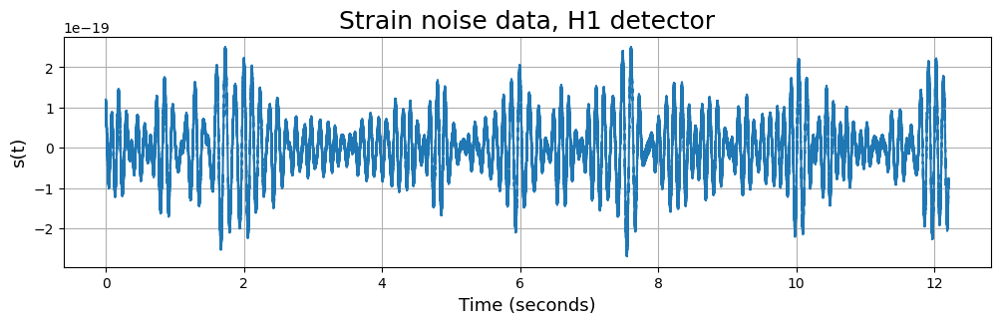

In [ ]:
# ------> Plot noise strain data
# -------------------------------

# Create time vector
time_noise = np.arange(0, duration, ts)

# Select No. of samples to plot
Nsamples = 50000

plt.figure(figsize=(12,3))
plt.plot(time_noise[:Nsamples], strain_noise[:Nsamples])
plt.title("Strain noise data, " + IFO + " detector", fontsize=18)
plt.ylabel("s(t)", fontsize=13)
plt.xlabel("Time (seconds)", fontsize=13)
plt.grid()
plt.show()

In [ ]:
# ------> Compute the Power Spectral Density (PSD)
# -------------------------------------------------

# Remark: For this, we apply the PyCBC standard library

# Convert numpy arrays to time series
Noise =  pycbc.types.TimeSeries(strain_noise, delta_t = ts)

# Input values

fs = 1 / ts # Sampling frequency

# Length of each Welch segment
segment_duration = 4                  # in seconds
seg_len = int(segment_duration * fs)   # in sample units

# Overlap between Welch segments in seconds
overlap_duration = 2                    #  in seconds
seg_stride = int(overlap_duration * fs)  # in sample units

# Welch's Power Spectral Density estimate
psd = pycbc.psd.welch(Noise, seg_len=seg_len, seg_stride=seg_stride)
fpsd = psd.sample_frequencies

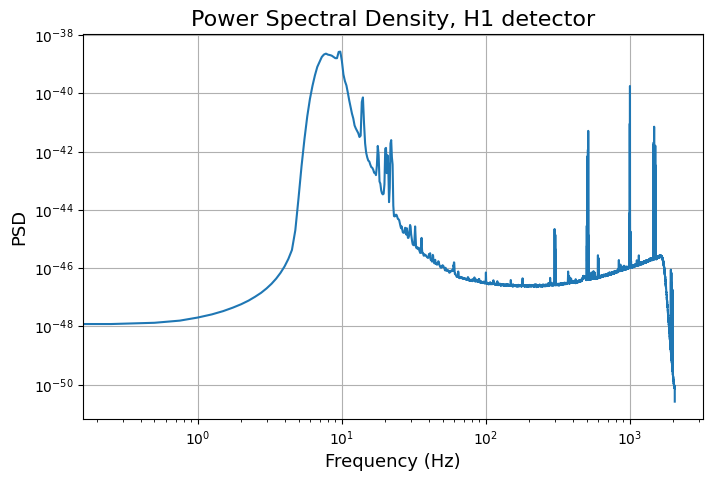

In [ ]:
# ------> Plot the PSD
# ---------------------

plt.figure(figsize=(8,5))
plt.plot(fpsd, psd)
plt.xscale('log')
plt.yscale('log')
plt.title("Power Spectral Density, " + IFO + " detector", fontsize=16)
plt.ylabel("PSD", fontsize=13)
plt.xlabel("Frequency (Hz)", fontsize=13)
plt.grid()
plt.show()

## **Part 2: Waveform exploration**

### **Kuroda 2017 s15.0 waveform**

In [ ]:
# Kuroda et al. 2017 (https://doi.org/10.3847/1538-4357/aa988d)

# ------> Download waveforms
# ---------------------------

url_waveform = "https://drive.google.com/uc?export=download&id=1pQ3JloXBwf6X61-YHIh5ZiLI7woMoP58"

remote_f = fsspec.open(url_waveform, mode="rb")

if hasattr(remote_f, "open"):
  remote_f = remote_f.open()
  File = h5py.File(remote_f)

File.keys()

<KeysViewHDF5 ['waveform']>

In [ ]:
# ------> Save time and waveform strain data

a_group_key = list(File.keys())[0]
waveform = np.array(File[a_group_key])

to = waveform[:,0]
hpo = waveform[:,1]
hco = waveform[:,2]

In [ ]:
# ------> Resample waveforms to 4096 Hz
# --------------------------------------

def resample(t,h,f):
    """
    Function to resample a strain data
    INPUT:
      t -> time array
      h -> strain array
      f -> sampling frequency
    OUTPUT:
      t1 -> time array after intepolation
      h1 -> strain array after interpolation
    """

    # Check
    if len(t)!=len(h):
        print("Error: t and h need to have equal sizes")
        return 0

    # Define new time with f
    t1 = np.arange(t[0],t[-1],1.0/f)

    # print(t1)

    # Interpolation
    tck = interpolate.splrep(t,h,s=0)
    h1  = interpolate.splev(t1,tck,der=0)

    return t1, h1

In [ ]:
time_wf, hp  = resample(to, hpo, fs)
time_wf, hc  = resample(to, hco, fs)

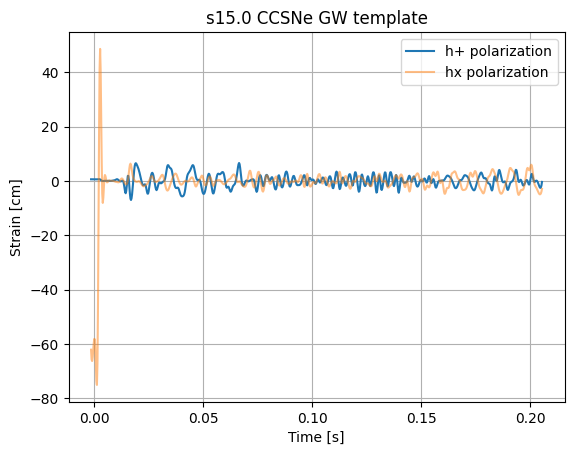

In [ ]:
# ------> Plot waveforms
# -----------------------

plt.figure()
plt.plot(time_wf,hp,label='h+ polarization')
plt.plot(time_wf,hc,label='hx polarization', alpha=0.5)
plt.title("s15.0 CCSNe GW template")
plt.xlabel('Time [s]')
plt.ylabel('Strain [cm]')
plt.grid()
plt.legend()
plt.show()

In [ ]:
# ------> Reescale waveforms
# ---------------------------

def rescale_wf(h,d):
  """
  Function to rescale a waveform depending on the emitting source D (in kpc)
    INPUT:
      h -> Dimensionless waveform
      d -> Distance in kilopasec
    OUTPUT:
      h1 -> Rescaled waveform at distance d
  """

  h1 = h*10/d

  return h1

In [ ]:
# Set constants
cm2kpc = 3.24078e-22

# Set strain data adimensional
hp = hp*cm2kpc
hc = hc*cm2kpc

# Rescale waveform at different distances
# (Kuroda et al 2017 waveforms assume a source at a distance 10 Kpc)

hp_5 = rescale_wf(hp,5)
hp_20 = rescale_wf(hp,20)

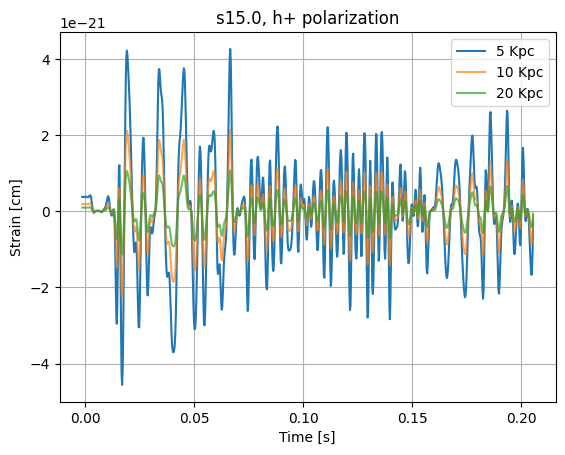

In [ ]:
# ------> Plot rescaled waveforms
# ---------------------------------

plt.figure()
plt.plot(time_wf,hp_5,label='5 Kpc')
plt.plot(time_wf,hp,label='10 Kpc',alpha=0.7)
plt.plot(time_wf,hp_20,label='20 Kpc',alpha=0.7)
plt.title("s15.0, h+ polarization")
plt.xlabel('Time [s]')
plt.ylabel('Strain [cm]')
plt.grid()
plt.legend()
plt.show()

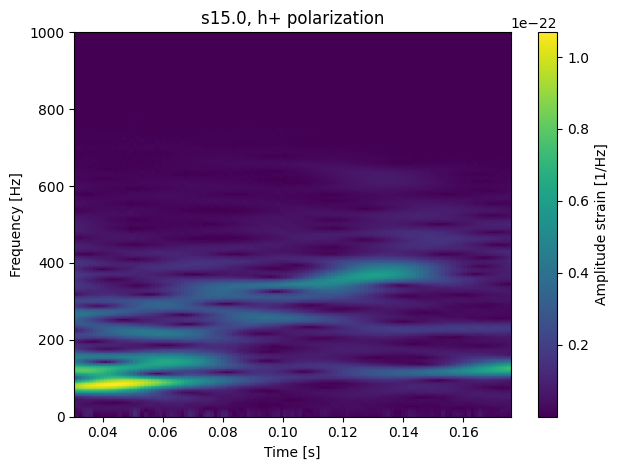

In [ ]:
# ------> Spectrogram
# ---------------------

wnd="hamming"; nfft=4*512; nperseg=256; noverlap=256-5
fxx, txx, Sxx = signal.spectrogram(hp, fs, window=wnd, nfft=nfft, nperseg=nperseg, noverlap=noverlap, mode='magnitude')

plt.figure()
plt.pcolormesh(txx, fxx, Sxx)
cbar = plt.colorbar()
cbar.set_label('Amplitude strain [1/Hz]')
plt.ylim([0,1000])
plt.title("s15.0, h+ polarization")
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [s]')
plt.tight_layout()
plt.show()

## **Part 3: Injection procedure**

In [ ]:
# ------> Input parameters
# -------------------------

# Time between injections (in seconds)
dt_inj = 8   # Options: 8, 12, 16, 32, 64, etc.

# Time segment for SNR calculation around injection (in seconds)
time_segment = 4   #  [ t_inj-t_segment/2 , t_inj+t_segment/2 ]

In [ ]:
##### Injections preparation
##############################

# ------> Backup original strain arrays
strain_noise_new = np.copy(strain_noise) # ---> Deep copy in numpy, to unbind arrays

# ------> Print useful input information

# Index of the strain noise sample (point) in which the first injection will be performed
N_lapse = int(dt_inj/(1./fs))
print("First noise sample to be injected with the waveform: ", N_lapse)
print("Its correspondent strain value:", strain_noise_new[N_lapse])

# Number of injections to be performed in the strain data
N_inj = int(len(strain_noise_new) / N_lapse * 0.5)
# Remark: We perfom injection only in the first half of the segment.

print("Number of injections to be performed: ", N_inj)

First noise sample to be injected with the waveform:  32768
Its correspondent strain value: 7.136150961698782e-20
Number of injections to be performed:  256


In [ ]:
##### Injections procedure
############################

# ------> Choose a waveform

strain_wf = hp

# ------> Compute waveform duration

wf_duration = time_wf[-1] - time_wf[0]

# ------> Create array to locate injections by indexes

locate_inj = np.arange(1,N_inj+1)
locate_inj = N_lapse*locate_inj

# ------> Define length of local noise segment for SNR calculation

epsilon = int(int(time_segment/ts)*0.5)

# ------> Initialize list for log file

log_data = []

# ------> Make injections

# FIRST LOOP, j index: injection count variable
# -----------------------------------------------

for j in range(N_inj): # Apply all injections
#for j in range(3): # Apply only a few injections

    print("Injection No.", j)
    print("----------------------")

    # ------> Injection location without jitter

    ind_noise = locate_inj[j] # Locate first point of the injection
    # print("Injection first point in the strain noise data:", ind_noise)

    time_inj = (1./fs)*ind_noise
    print("Time injection (in seconds):", time_inj)

    # SECOND LOOP, k index: Waveform's sample count variable
    # --------------------------------------------------------

    for k in range(len(strain_wf)): # Injection along waveform's ALL points

        #print("")
        #print("+++++ Point", k, " of the waveform")

        strain_wf_k = strain_wf[k]
        #print("------> strain waveform", strain_wf_k)

        strain_noise_k = strain_noise_new[locate_inj[j]+k]
        #print("------> strain BEFORE injection", strain_noise_k)

        # PERFORM THE INJECTION (k point in the waveform, locate_inj[j] + k point in the noise)
        strain_with_inj = strain_noise_k + strain_wf_k
        strain_noise_new[locate_inj[j]+k] = strain_with_inj

        #print("------> strain AFTER injection", strain_noise_new[ind_noise+k])
        #print("------> strain AFTER injection in copy", strain_n[ind_noise+k])

    print("")
    print("+++++ SNR calculation +++++")

    # ------> Define time segment for SNR calculation around the injection

    Llim_local_noise = ind_noise - epsilon
    Rlim_local_noise = ind_noise + len(strain_wf) + epsilon

    print("Left limit local noise = ", Llim_local_noise)
    print("Right limit local noise = ", Rlim_local_noise)

    #print("Strain noise length (in sample units):", len(strain_noise_new))

    # Define strain noise segment
    strain_segment = strain_noise_new[Llim_local_noise:Rlim_local_noise+1]

    #print("Strain noise segment length (in sample units):", len(strain_segment))

    # ------> Compute PSD with PyCBC

    # Convert numpy arrays to time series
    Noise =  pycbc.types.TimeSeries(strain_segment, delta_t = ts)
    Waveform = pycbc.types.TimeSeries(strain_wf, delta_t = ts)

    # Length of each Welch segment
    seg_len = int(4*fs)   # in sample units

    # Overlap between Welch segments in seconds
    seg_stride = int(2*fs)  # in sample units

    # Welch's Power Spectral Density estimate
    psd = pycbc.psd.welch(Noise, seg_len=seg_len, seg_stride=seg_stride)
    psd = pycbc.psd.interpolate(psd,1.0/len(Waveform)*fs)

    # ------> Compute SNR values with PyCBC

    SNR_value = SNR = pycbc.filter.sigma(Waveform, psd,low_frequency_cutoff=1.0)

    print("Injection SNR value: ", SNR_value)

    # ------> Save information in log_data list
    # Injection time, SNR value, waveform duration
    log_data.append([time_inj, SNR_value, wf_duration])

    print("****************************************************************")
    print("")

Injection No. 0
----------------------
Time injection (in seconds): 8.0

+++++ SNR calculation +++++
Left limit local noise =  24576
Right limit local noise =  41808
Injection SNR value:  33.920813773477306
****************************************************************

Injection No. 1
----------------------
Time injection (in seconds): 16.0

+++++ SNR calculation +++++
Left limit local noise =  57344
Right limit local noise =  74576
Injection SNR value:  34.565156632122466
****************************************************************

Injection No. 2
----------------------
Time injection (in seconds): 24.0

+++++ SNR calculation +++++
Left limit local noise =  90112
Right limit local noise =  107344
Injection SNR value:  37.11512388717477
****************************************************************

Injection No. 3
----------------------
Time injection (in seconds): 32.0

+++++ SNR calculation +++++
Left limit local noise =  122880
Right limit local noise =  140112
Injection 

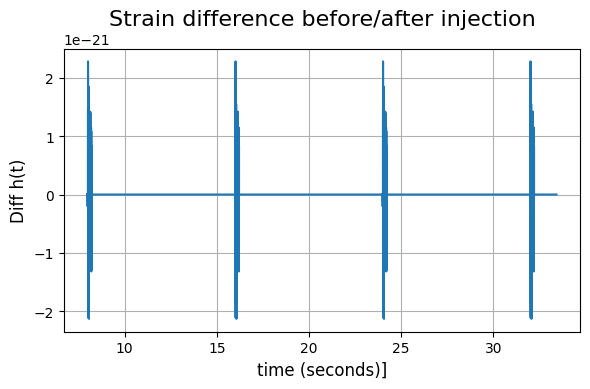

In [ ]:
# ------> Check plot for strain before/after injection

# Select an injection
inj_point_1 = locate_inj[0]
inj_point_2 = locate_inj[3]
min_index = inj_point_1-100
max_index = inj_point_2+len(strain_wf)+5000

# Subset of points
time_n_subset = time_noise[min_index:max_index]
strain_n_subset = strain_noise[min_index:max_index]
strain_n_new_subset = strain_noise_new[min_index:max_index]

plt.figure(1, figsize=(6,4))
#plt.plot(time_n_subset,strain_n_subset, label='Before injection')
#plt.plot(time_n_subset,strain_n_new_subset, label='After injection')
plt.plot(time_n_subset,strain_n_subset-strain_n_new_subset, label='difference')
#plt.yscale('log')
plt.title("Strain difference before/after injection", fontsize=16)
plt.xlabel('time (seconds)]', fontsize=12)
plt.ylabel('Diff h(t)', fontsize=12)
plt.grid()
#plt.legend()
plt.tight_layout()
plt.show()

## **Part 4: Pre-procesing**

In [ ]:
##### Whitening procedure
###########################

def whitening(L, cut, nw_samp, tsampling):

  L = pycbc.types.timeseries.TimeSeries(L,tsampling)

  L_w, psd_lw = L.whiten(nw_samp,cut, return_psd=True)

  # Estimate noise PSD
  seg_len    = int(4/tsampling)
  seg_stride = int(2/tsampling)

  psdL = pycbc.psd.welch(L, seg_len=seg_len, seg_stride=seg_stride )
  fpsdL = psdL.sample_frequencies

  # Scale the whitenning
  fL = min(psdL**0.5)
  Lw1 = L_w * fL

  # Estimate Whiten PSD
  psdLw1 = pycbc.psd.welch(Lw1, seg_len=seg_len, seg_stride=seg_stride)

  return Lw1, psdLw1, psdL, fpsdL


In [ ]:
# ------> Apply Whitening

Sw, Swpsd, psd, fpsd = whitening(strain_noise_new, 10, 0.5, ts)

In [ ]:
##### Band-pass filtering procedure
####################################

def bandpass(L, fmin, fmax, tsampling):

    L_filt = pycbc.filter.highpass(L, fmin, 8)
    # plt.plot(ts.sample_times, ts, label='Highpassed')

    # Suppress the high frequencies
    L_filt = pycbc.filter.lowpass_fir(L_filt, fmax, 8)
    # plt.plot(ts.sample_times, ts, label='Highpassed + Lowpassed')

    # Estimate Bandpass PSD
    seg_len    = int(4/tsampling)
    seg_stride = int(2/tsampling)
    psdLfilt = pycbc.psd.welch(L_filt, seg_len=seg_len, seg_stride=seg_stride)


    return L_filt, psdLfilt

In [ ]:
# ------> Apply Band-Pass filtering

Sf, Sfpsd = bandpass(Sw, 100, 1600, ts)

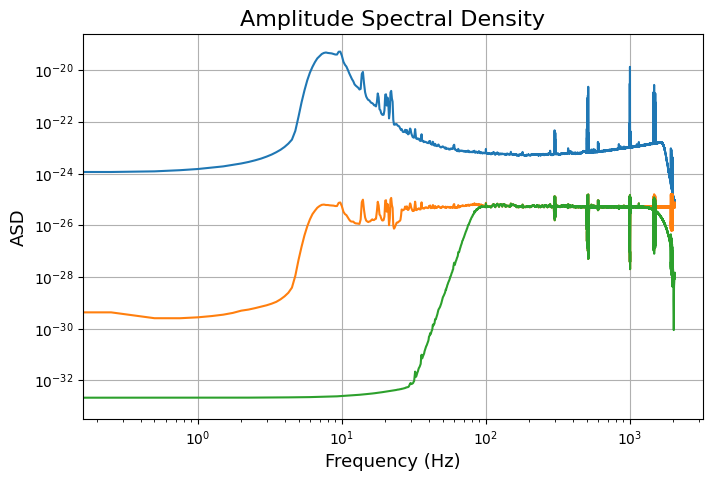

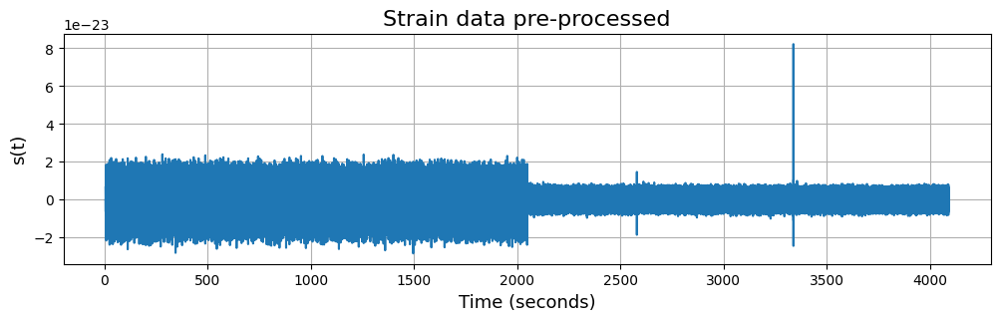

In [ ]:
##### Check: Plots
###################

# ------> Amplitude Spectral Density

plt.figure(1,figsize=(8,5))
plt.plot(fpsd, np.sqrt(psd))
plt.plot(fpsd, np.sqrt(Swpsd))
plt.plot(fpsd, np.sqrt(Sfpsd))
plt.xscale('log')
plt.yscale('log')
plt.title("Amplitude Spectral Density", fontsize=16)
plt.ylabel("ASD", fontsize=13)
plt.xlabel("Frequency (Hz)", fontsize=13)
plt.grid()
plt.show()

# ------> Pre-processed strain data

# Time after whitened cut
time_strain_cut = Sf.sample_times

# Select No. of samples to plot
Nsamples = len(time_strain_cut) #100000

plt.figure(2,figsize=(12,3))
plt.plot(time_strain_cut[:Nsamples], Sf[:Nsamples])
plt.title("Strain data pre-processed", fontsize=16)
plt.ylabel("s(t)", fontsize=13)
plt.xlabel("Time (seconds)", fontsize=13)
plt.grid()
plt.show()

## **Part 5: Dataset generation**

In [ ]:
# ------> Waveform duration
print("Waveform duration (in seconds):", wf_duration)

Waveform duration (in seconds): 0.206787109375


In [ ]:
# ------> log_data array contain information about injections
display(log_data[0:10]) # injection time, SNR value, waveform duration

[[8.0, 33.920813773477306, 0.206787109375],
 [16.0, 34.565156632122466, 0.206787109375],
 [24.0, 37.11512388717477, 0.206787109375],
 [32.0, 38.65120996966157, 0.206787109375],
 [40.0, 40.76892045952648, 0.206787109375],
 [48.0, 37.67066412519577, 0.206787109375],
 [56.0, 54.535949302866314, 0.206787109375],
 [64.0, 42.21981166504177, 0.206787109375],
 [72.0, 42.474888463510055, 0.206787109375],
 [80.0, 34.568402799819594, 0.206787109375]]

**Simple procedure**:<br/>
In the first half of the segment, extract consecutive sample time windows, such that each sample contains noise + a centered GW signal. On the second half of the segment, extract the same number of samples as the first one, with only noise. The length of the windows is unique.

###**Generation of samples of GW + Noise**

In [ ]:
# ------> Define a UNIQUE time window duration (in seconds)

Twin = 1.0

# ------> Initialize array for initial times of each sample window

Twin_ini = np.zeros(len(log_data))

# ------> Populate above array with time values

for i in range(len(log_data)): # Select all windows
#for i in range(10): # Select only a few windows

    # Remark: The following expression ensures beforehand that each
    # window sample is such that its injection is centered.

    Twin_ini[i] =  log_data[i][0] + 0.5 * ( log_data[i][2] - Twin )
    #print(Twin_ini[i])

In [ ]:
# ------> Check if edge (left) window sample is in the segment

# LEFT edge of data segment
for i in range(len(Twin_ini)):

    if Twin_ini[0] < time_strain_cut[0]:
        print("****** WARNING: Sample at LEFT edge is outside the data segment, it will be removed")
        Twin_ini = np.delete(Twin_ini,0)
        # We also remove the injection
        log_data_prueba = np.delete(log_data_prueba,0,0)
    else:
        print("End LEFT segment check")
        break

End LEFT segment check


In [ ]:
# ------> Convert Twin_ini values (in seconds) to locating indexes

locate_win = np.zeros(len(Twin_ini))

for i in range(len(Twin_ini)):
    locate_win[i] = int(Twin_ini[i]/ts) - int(time_strain_cut[0]/ts)

locate_win = locate_win.astype(int)

Window sample No. 0
----------------------
Waveform SNR:  33.920813773477306
Injection location:  8.0
Window initial time (in seconds):  7.603271484375
Window end time (in seconds):  8.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



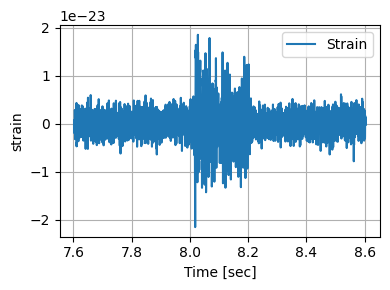

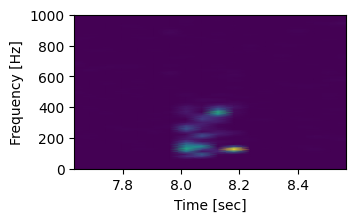

****************************************************************
Window sample No. 1
----------------------
Waveform SNR:  34.565156632122466
Injection location:  16.0
Window initial time (in seconds):  15.603271484375
Window end time (in seconds):  16.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



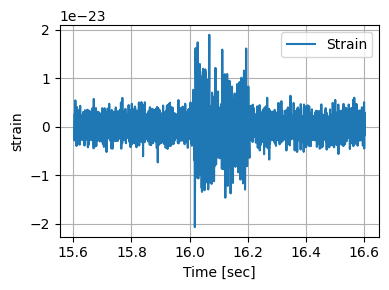

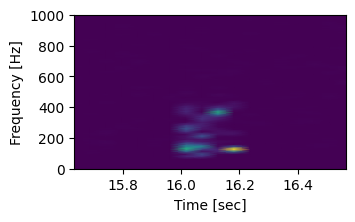

****************************************************************
Window sample No. 2
----------------------
Waveform SNR:  37.11512388717477
Injection location:  24.0
Window initial time (in seconds):  23.603271484375
Window end time (in seconds):  24.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



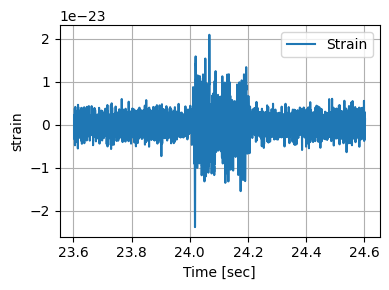

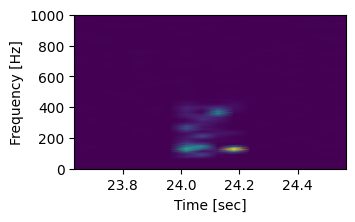

****************************************************************
Window sample No. 3
----------------------
Waveform SNR:  38.65120996966157
Injection location:  32.0
Window initial time (in seconds):  31.603271484375
Window end time (in seconds):  32.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



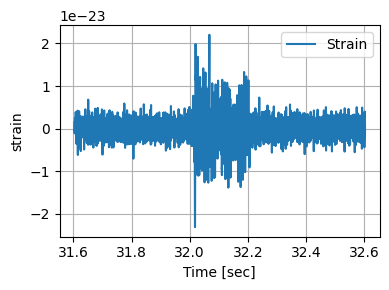

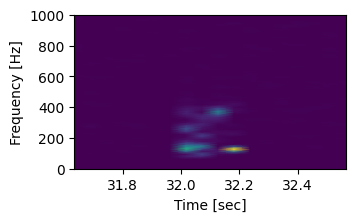

****************************************************************
Window sample No. 4
----------------------
Waveform SNR:  40.76892045952648
Injection location:  40.0
Window initial time (in seconds):  39.603271484375
Window end time (in seconds):  40.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



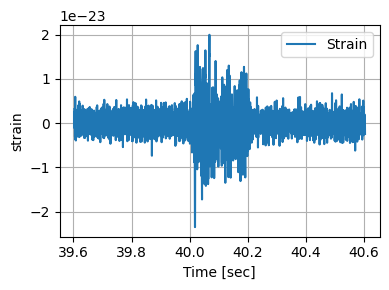

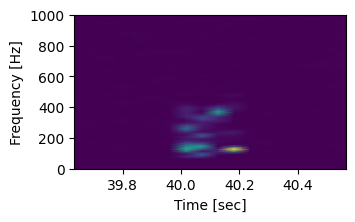

****************************************************************
Window sample No. 5
----------------------
Waveform SNR:  37.67066412519577
Injection location:  48.0
Window initial time (in seconds):  47.603271484375
Window end time (in seconds):  48.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



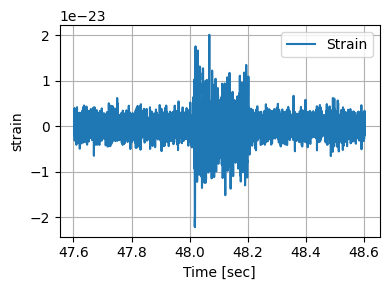

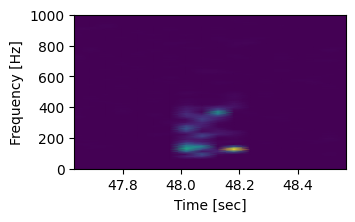

****************************************************************
Window sample No. 6
----------------------
Waveform SNR:  54.535949302866314
Injection location:  56.0
Window initial time (in seconds):  55.603271484375
Window end time (in seconds):  56.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



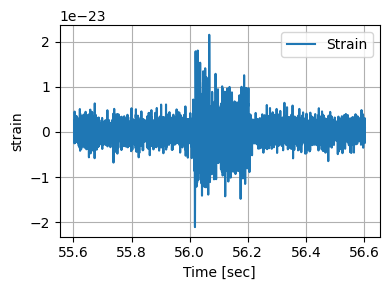

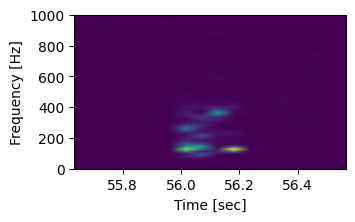

****************************************************************
Window sample No. 7
----------------------
Waveform SNR:  42.21981166504177
Injection location:  64.0
Window initial time (in seconds):  63.603271484375
Window end time (in seconds):  64.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



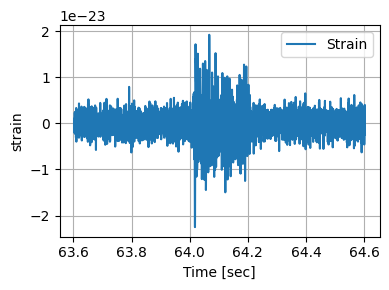

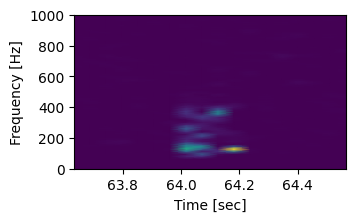

****************************************************************
Window sample No. 8
----------------------
Waveform SNR:  42.474888463510055
Injection location:  72.0
Window initial time (in seconds):  71.603271484375
Window end time (in seconds):  72.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



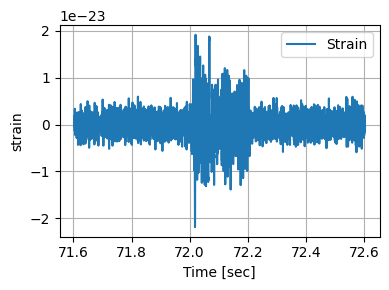

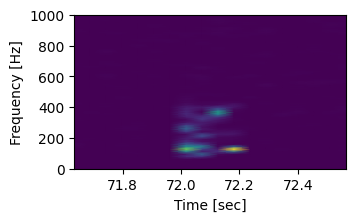

****************************************************************
Window sample No. 9
----------------------
Waveform SNR:  34.568402799819594
Injection location:  80.0
Window initial time (in seconds):  79.603271484375
Window end time (in seconds):  80.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



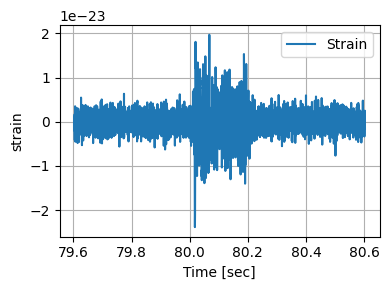

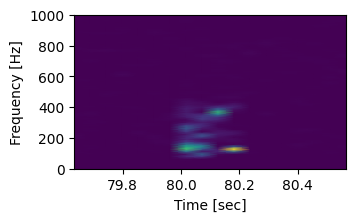

****************************************************************
Window sample No. 10
----------------------
Waveform SNR:  36.350728387640004
Injection location:  88.0
Window initial time (in seconds):  87.603271484375
Window end time (in seconds):  88.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



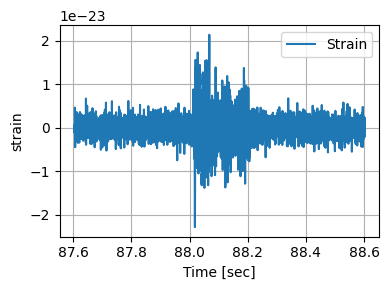

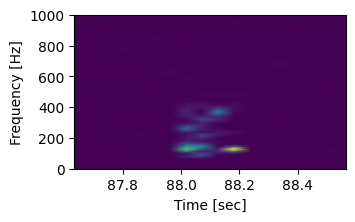

****************************************************************
Window sample No. 11
----------------------
Waveform SNR:  38.156900472134616
Injection location:  96.0
Window initial time (in seconds):  95.603271484375
Window end time (in seconds):  96.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



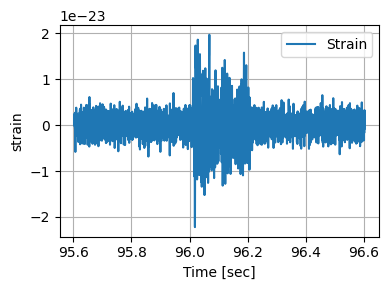

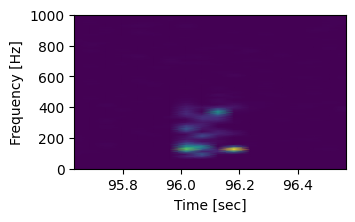

****************************************************************
Window sample No. 12
----------------------
Waveform SNR:  40.07778572367355
Injection location:  104.0
Window initial time (in seconds):  103.603271484375
Window end time (in seconds):  104.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



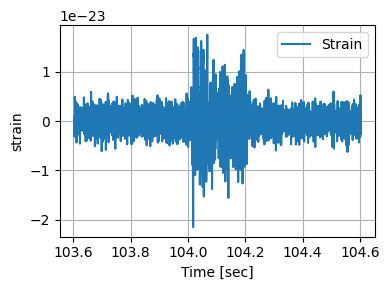

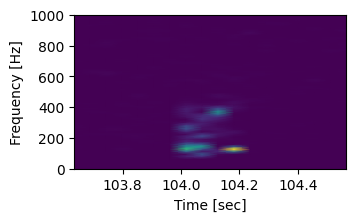

****************************************************************
Window sample No. 13
----------------------
Waveform SNR:  39.17280090721395
Injection location:  112.0
Window initial time (in seconds):  111.603271484375
Window end time (in seconds):  112.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



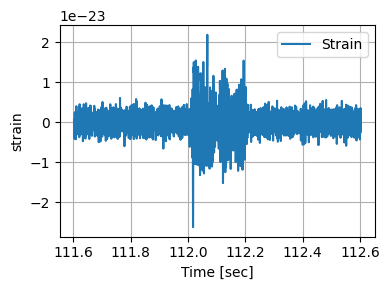

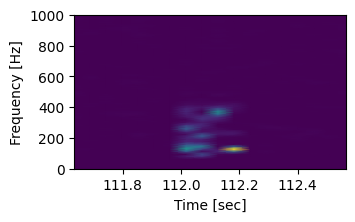

****************************************************************
Window sample No. 14
----------------------
Waveform SNR:  38.125638391517256
Injection location:  120.0
Window initial time (in seconds):  119.603271484375
Window end time (in seconds):  120.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



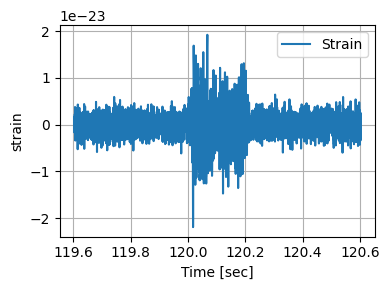

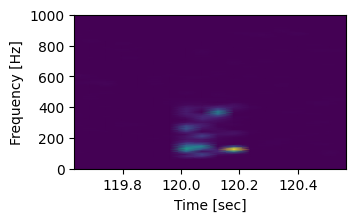

****************************************************************
Window sample No. 15
----------------------
Waveform SNR:  36.78426022133218
Injection location:  128.0
Window initial time (in seconds):  127.603271484375
Window end time (in seconds):  128.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



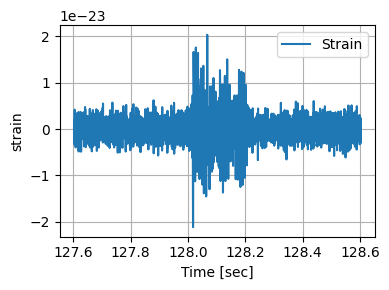

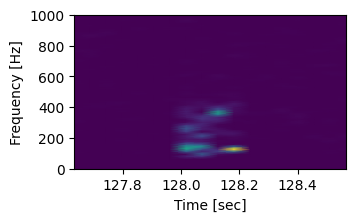

****************************************************************
Window sample No. 16
----------------------
Waveform SNR:  38.603438935839925
Injection location:  136.0
Window initial time (in seconds):  135.603271484375
Window end time (in seconds):  136.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



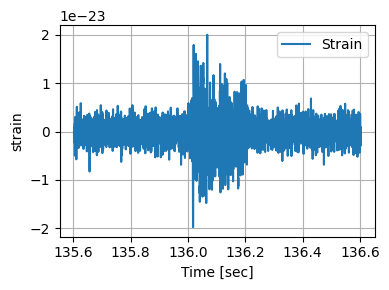

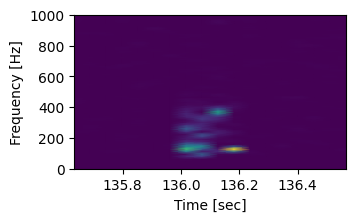

****************************************************************
Window sample No. 17
----------------------
Waveform SNR:  46.637504902920895
Injection location:  144.0
Window initial time (in seconds):  143.603271484375
Window end time (in seconds):  144.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



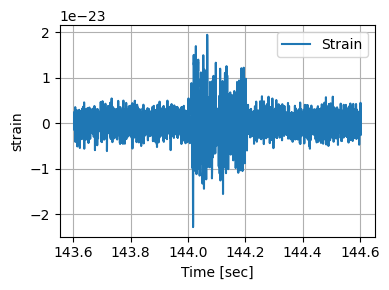

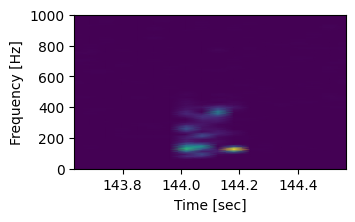

****************************************************************
Window sample No. 18
----------------------
Waveform SNR:  39.89505017600636
Injection location:  152.0
Window initial time (in seconds):  151.603271484375
Window end time (in seconds):  152.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



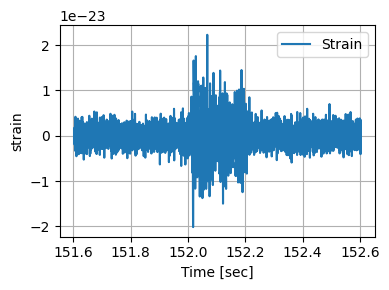

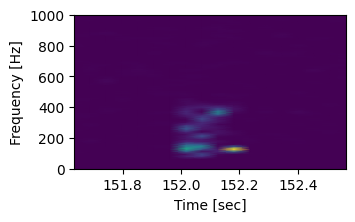

****************************************************************
Window sample No. 19
----------------------
Waveform SNR:  36.191953490257845
Injection location:  160.0
Window initial time (in seconds):  159.603271484375
Window end time (in seconds):  160.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



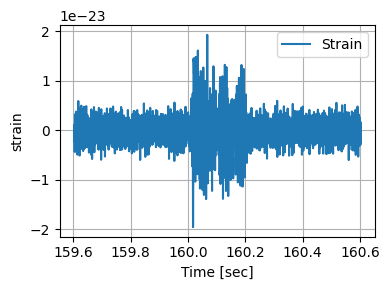

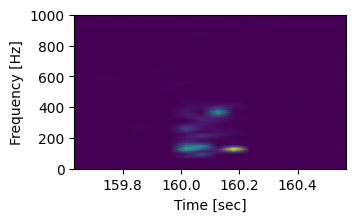

****************************************************************
Window sample No. 20
----------------------
Waveform SNR:  34.13102984159139
Injection location:  168.0
Window initial time (in seconds):  167.603271484375
Window end time (in seconds):  168.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



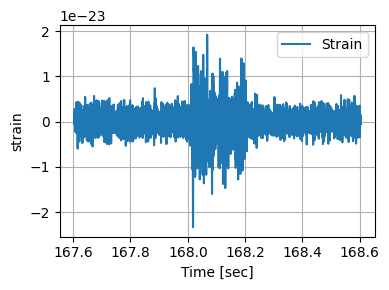

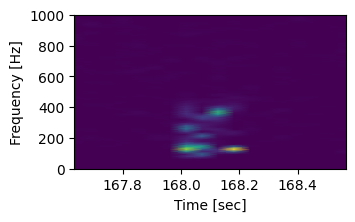

****************************************************************
Window sample No. 21
----------------------
Waveform SNR:  47.452442509765014
Injection location:  176.0
Window initial time (in seconds):  175.603271484375
Window end time (in seconds):  176.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



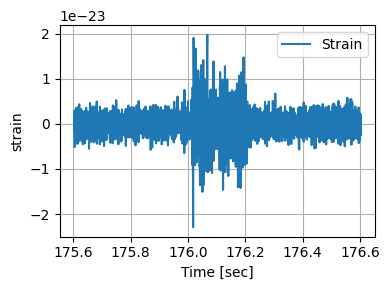

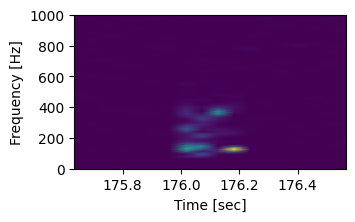

****************************************************************
Window sample No. 22
----------------------
Waveform SNR:  54.03777245172654
Injection location:  184.0
Window initial time (in seconds):  183.603271484375
Window end time (in seconds):  184.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



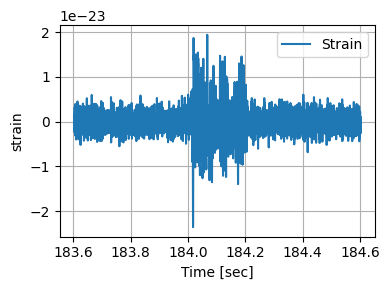

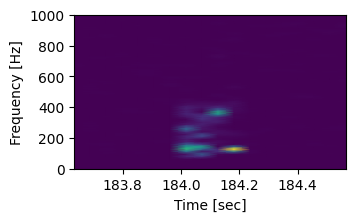

****************************************************************
Window sample No. 23
----------------------
Waveform SNR:  38.56176831432253
Injection location:  192.0
Window initial time (in seconds):  191.603271484375
Window end time (in seconds):  192.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



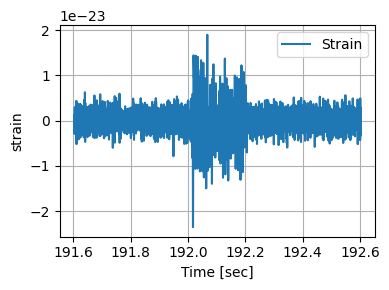

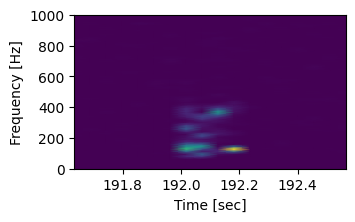

****************************************************************
Window sample No. 24
----------------------
Waveform SNR:  38.933243611063034
Injection location:  200.0
Window initial time (in seconds):  199.603271484375
Window end time (in seconds):  200.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



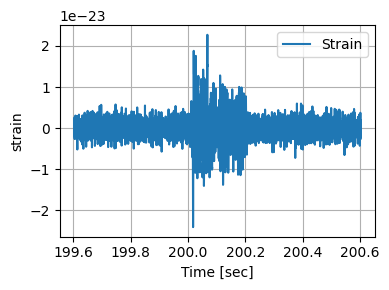

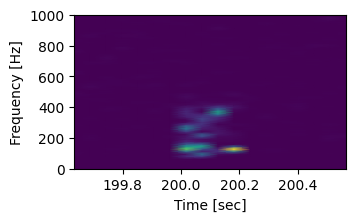

****************************************************************
Window sample No. 25
----------------------
Waveform SNR:  38.674403256693296
Injection location:  208.0
Window initial time (in seconds):  207.603271484375
Window end time (in seconds):  208.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



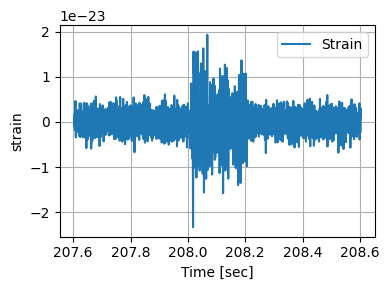

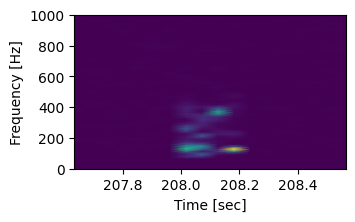

****************************************************************
Window sample No. 26
----------------------
Waveform SNR:  37.18530394802194
Injection location:  216.0
Window initial time (in seconds):  215.603271484375
Window end time (in seconds):  216.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



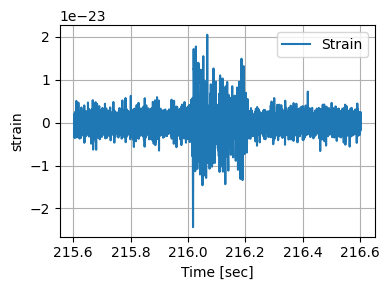

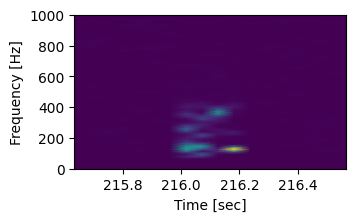

****************************************************************
Window sample No. 27
----------------------
Waveform SNR:  38.24994047010734
Injection location:  224.0
Window initial time (in seconds):  223.603271484375
Window end time (in seconds):  224.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



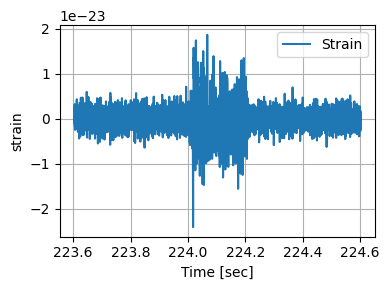

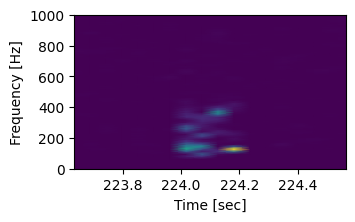

****************************************************************
Window sample No. 28
----------------------
Waveform SNR:  38.63494812589128
Injection location:  232.0
Window initial time (in seconds):  231.603271484375
Window end time (in seconds):  232.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



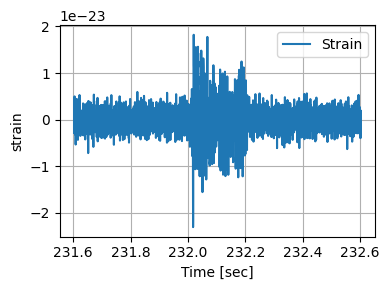

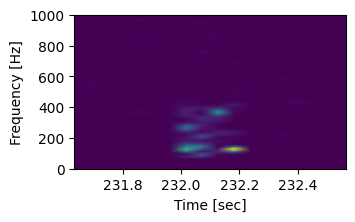

****************************************************************
Window sample No. 29
----------------------
Waveform SNR:  39.60212805040934
Injection location:  240.0
Window initial time (in seconds):  239.603271484375
Window end time (in seconds):  240.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



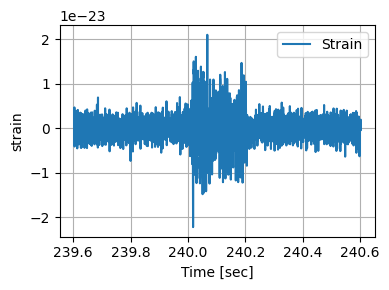

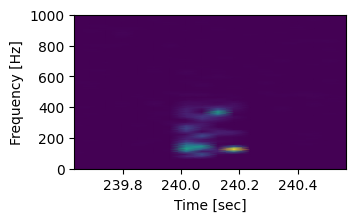

****************************************************************
Window sample No. 30
----------------------
Waveform SNR:  39.039705031438416
Injection location:  248.0
Window initial time (in seconds):  247.603271484375
Window end time (in seconds):  248.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



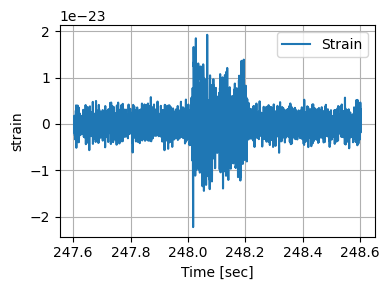

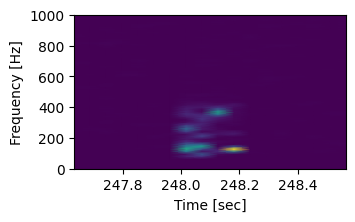

****************************************************************
Window sample No. 31
----------------------
Waveform SNR:  34.73392017187705
Injection location:  256.0
Window initial time (in seconds):  255.603271484375
Window end time (in seconds):  256.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



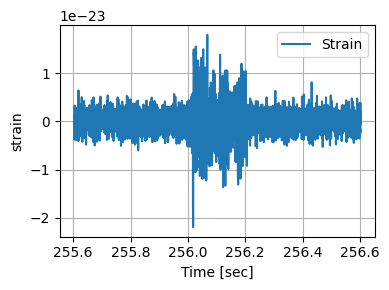

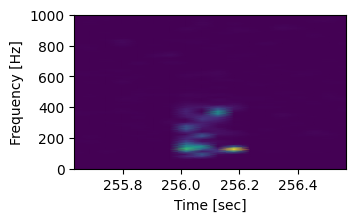

****************************************************************
Window sample No. 32
----------------------
Waveform SNR:  43.76196300658869
Injection location:  264.0
Window initial time (in seconds):  263.603271484375
Window end time (in seconds):  264.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



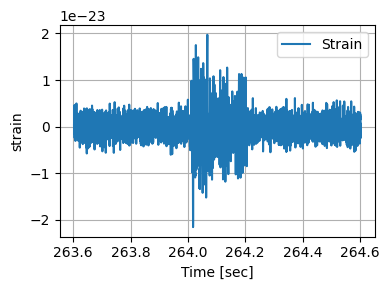

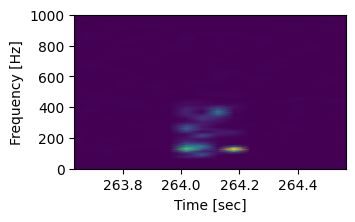

****************************************************************
Window sample No. 33
----------------------
Waveform SNR:  39.93268696331264
Injection location:  272.0
Window initial time (in seconds):  271.603271484375
Window end time (in seconds):  272.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



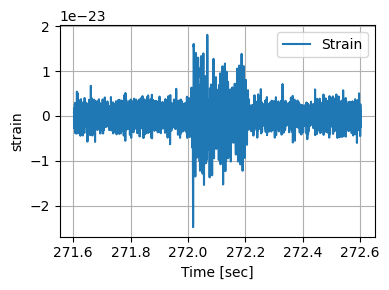

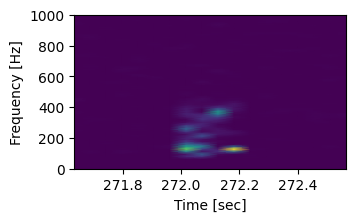

****************************************************************
Window sample No. 34
----------------------
Waveform SNR:  38.4372285442323
Injection location:  280.0
Window initial time (in seconds):  279.603271484375
Window end time (in seconds):  280.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



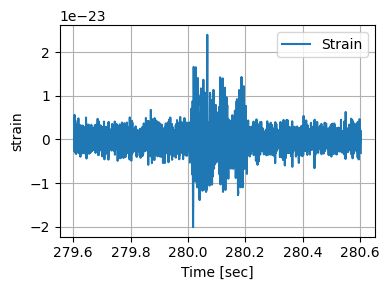

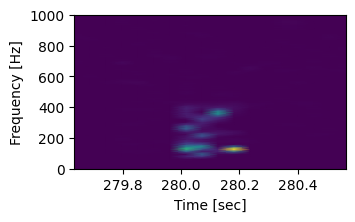

****************************************************************
Window sample No. 35
----------------------
Waveform SNR:  603.3351461774197
Injection location:  288.0
Window initial time (in seconds):  287.603271484375
Window end time (in seconds):  288.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



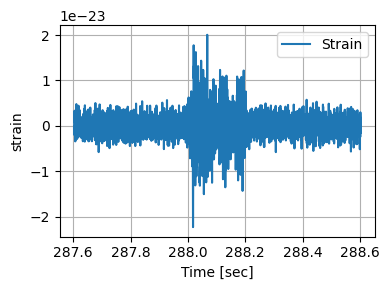

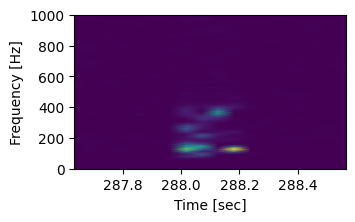

****************************************************************
Window sample No. 36
----------------------
Waveform SNR:  2078.8480339579387
Injection location:  296.0
Window initial time (in seconds):  295.603271484375
Window end time (in seconds):  296.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



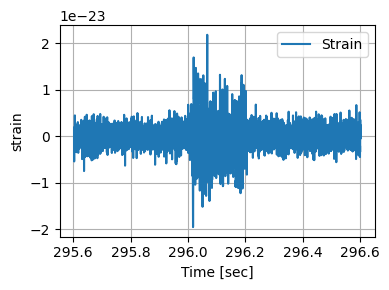

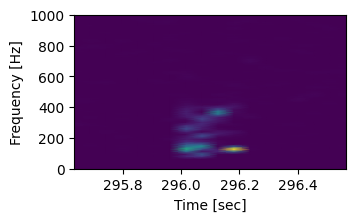

****************************************************************
Window sample No. 37
----------------------
Waveform SNR:  40.43913094052393
Injection location:  304.0
Window initial time (in seconds):  303.603271484375
Window end time (in seconds):  304.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



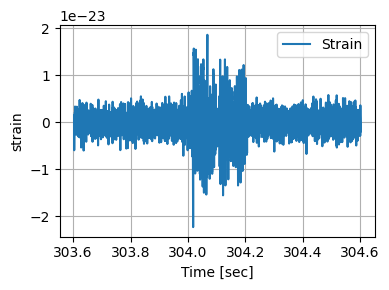

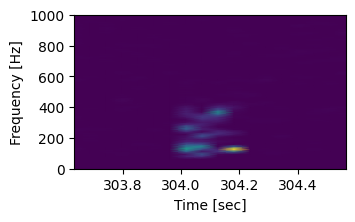

****************************************************************
Window sample No. 38
----------------------
Waveform SNR:  36.75010617585306
Injection location:  312.0
Window initial time (in seconds):  311.603271484375
Window end time (in seconds):  312.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



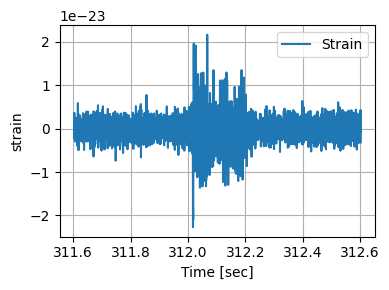

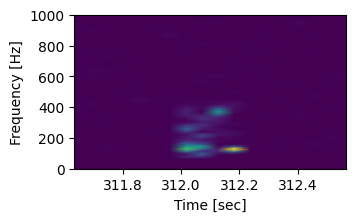

****************************************************************
Window sample No. 39
----------------------
Waveform SNR:  36.08167275997262
Injection location:  320.0
Window initial time (in seconds):  319.603271484375
Window end time (in seconds):  320.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



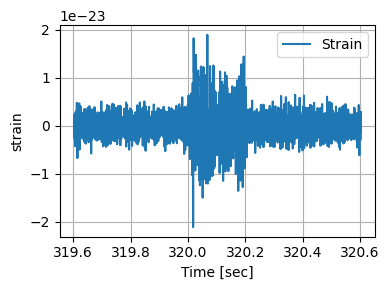

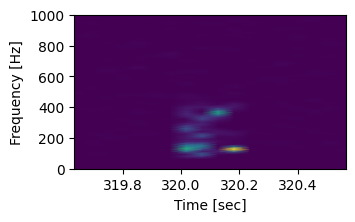

****************************************************************
Window sample No. 40
----------------------
Waveform SNR:  35.59317441145143
Injection location:  328.0
Window initial time (in seconds):  327.603271484375
Window end time (in seconds):  328.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



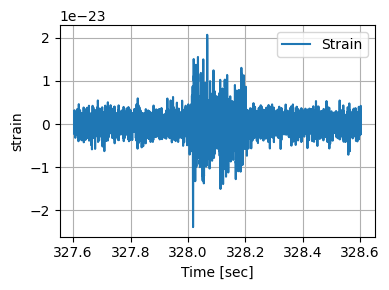

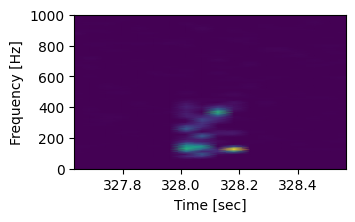

****************************************************************
Window sample No. 41
----------------------
Waveform SNR:  36.5725365518237
Injection location:  336.0
Window initial time (in seconds):  335.603271484375
Window end time (in seconds):  336.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



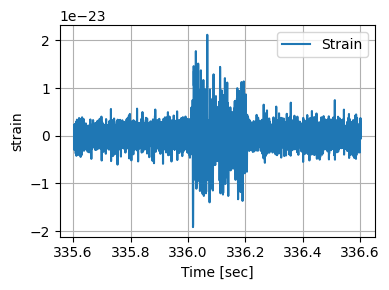

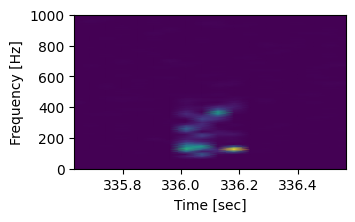

****************************************************************
Window sample No. 42
----------------------
Waveform SNR:  43.115524087433336
Injection location:  344.0
Window initial time (in seconds):  343.603271484375
Window end time (in seconds):  344.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



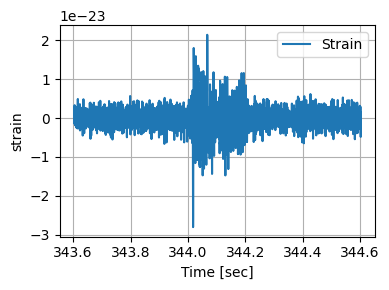

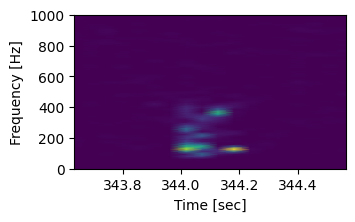

****************************************************************
Window sample No. 43
----------------------
Waveform SNR:  39.45032589028497
Injection location:  352.0
Window initial time (in seconds):  351.603271484375
Window end time (in seconds):  352.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



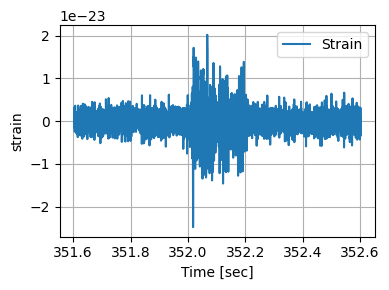

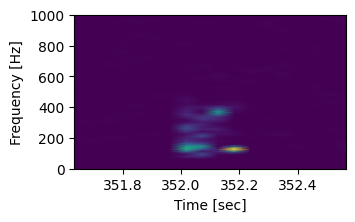

****************************************************************
Window sample No. 44
----------------------
Waveform SNR:  38.03624054980928
Injection location:  360.0
Window initial time (in seconds):  359.603271484375
Window end time (in seconds):  360.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



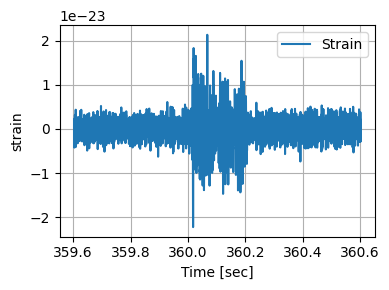

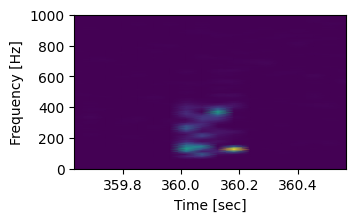

****************************************************************
Window sample No. 45
----------------------
Waveform SNR:  40.64703524182183
Injection location:  368.0
Window initial time (in seconds):  367.603271484375
Window end time (in seconds):  368.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



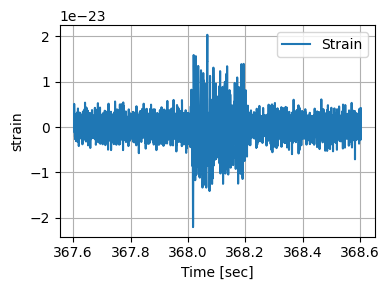

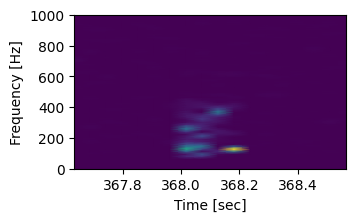

****************************************************************
Window sample No. 46
----------------------
Waveform SNR:  36.023960256782495
Injection location:  376.0
Window initial time (in seconds):  375.603271484375
Window end time (in seconds):  376.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



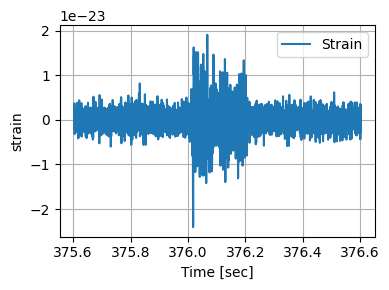

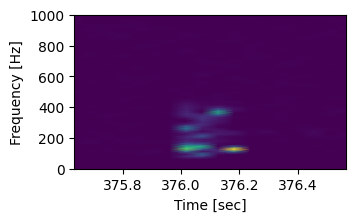

****************************************************************
Window sample No. 47
----------------------
Waveform SNR:  112.53193880013845
Injection location:  384.0
Window initial time (in seconds):  383.603271484375
Window end time (in seconds):  384.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



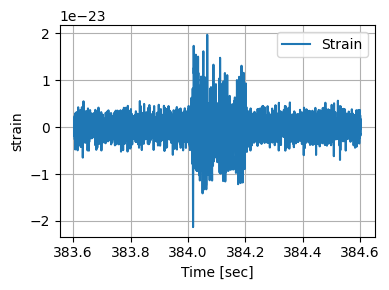

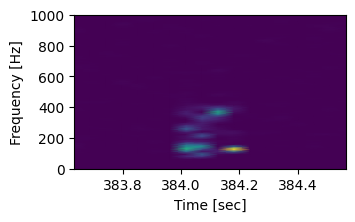

****************************************************************
Window sample No. 48
----------------------
Waveform SNR:  40.689601789754576
Injection location:  392.0
Window initial time (in seconds):  391.603271484375
Window end time (in seconds):  392.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



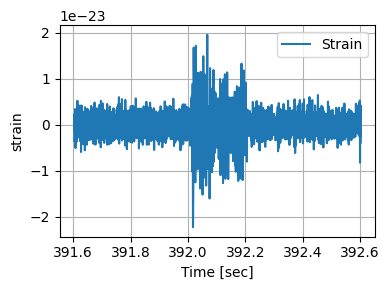

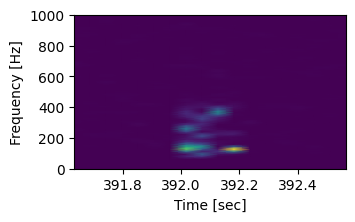

****************************************************************
Window sample No. 49
----------------------
Waveform SNR:  120.36365334917522
Injection location:  400.0
Window initial time (in seconds):  399.603271484375
Window end time (in seconds):  400.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



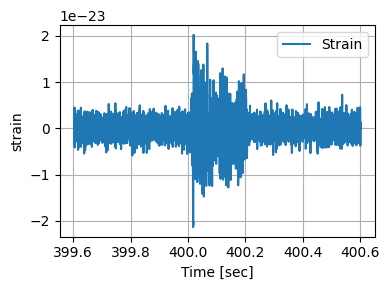

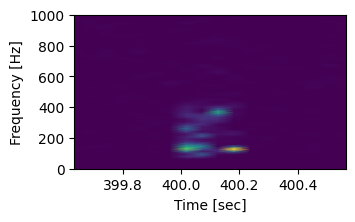

****************************************************************
Window sample No. 50
----------------------
Waveform SNR:  104.71767057767478
Injection location:  408.0
Window initial time (in seconds):  407.603271484375
Window end time (in seconds):  408.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



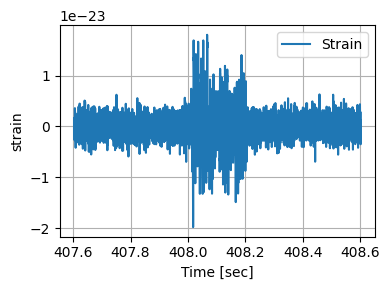

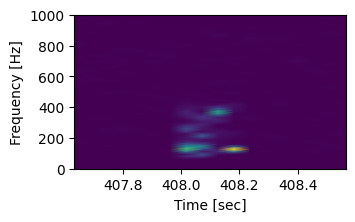

****************************************************************
Window sample No. 51
----------------------
Waveform SNR:  33.526091208448925
Injection location:  416.0
Window initial time (in seconds):  415.603271484375
Window end time (in seconds):  416.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



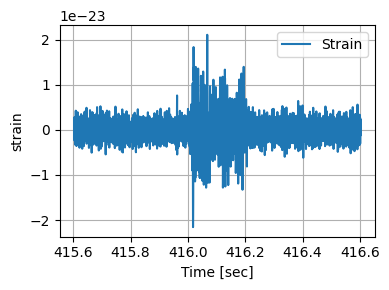

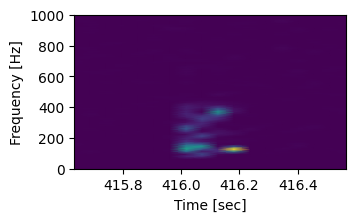

****************************************************************
Window sample No. 52
----------------------
Waveform SNR:  44.41606825372886
Injection location:  424.0
Window initial time (in seconds):  423.603271484375
Window end time (in seconds):  424.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



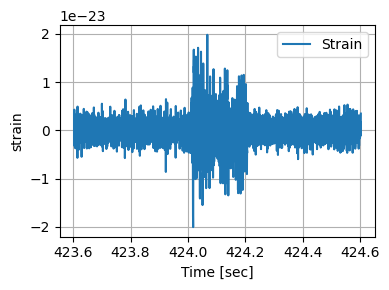

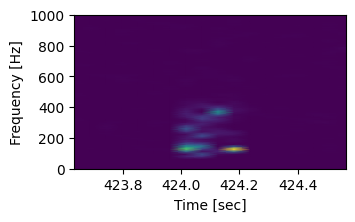

****************************************************************
Window sample No. 53
----------------------
Waveform SNR:  39.37155289174579
Injection location:  432.0
Window initial time (in seconds):  431.603271484375
Window end time (in seconds):  432.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



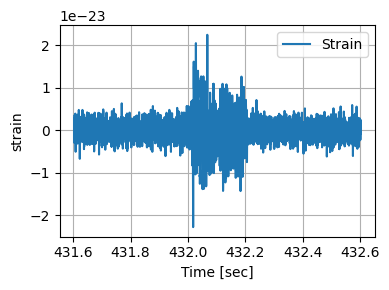

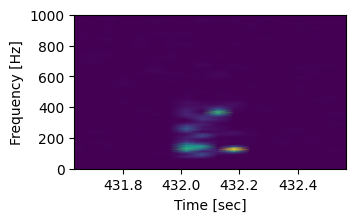

****************************************************************
Window sample No. 54
----------------------
Waveform SNR:  37.259375298592396
Injection location:  440.0
Window initial time (in seconds):  439.603271484375
Window end time (in seconds):  440.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



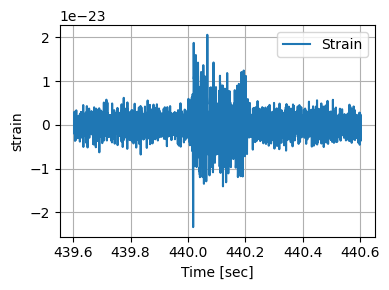

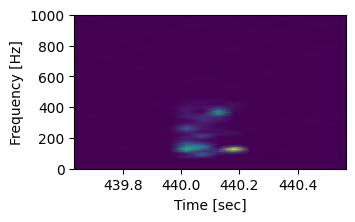

****************************************************************
Window sample No. 55
----------------------
Waveform SNR:  36.91318371246266
Injection location:  448.0
Window initial time (in seconds):  447.603271484375
Window end time (in seconds):  448.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



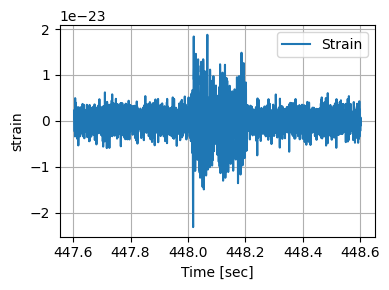

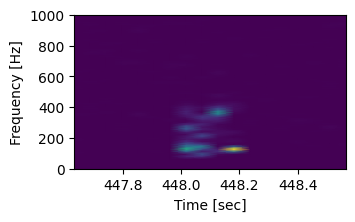

****************************************************************
Window sample No. 56
----------------------
Waveform SNR:  41.24556715809277
Injection location:  456.0
Window initial time (in seconds):  455.603271484375
Window end time (in seconds):  456.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



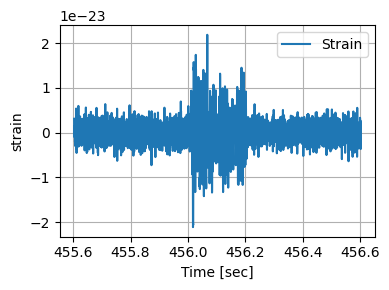

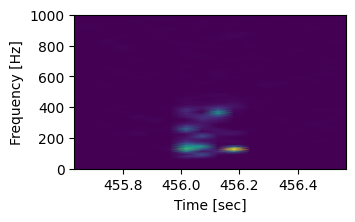

****************************************************************
Window sample No. 57
----------------------
Waveform SNR:  38.96663217220641
Injection location:  464.0
Window initial time (in seconds):  463.603271484375
Window end time (in seconds):  464.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



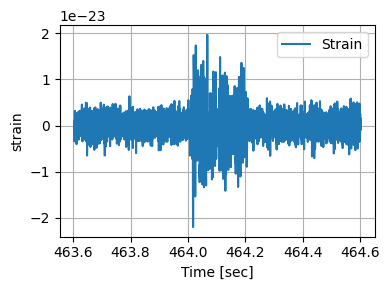

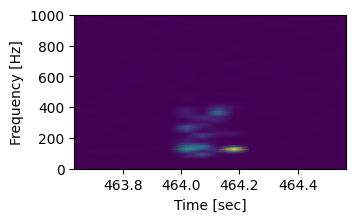

****************************************************************
Window sample No. 58
----------------------
Waveform SNR:  39.846982096562456
Injection location:  472.0
Window initial time (in seconds):  471.603271484375
Window end time (in seconds):  472.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



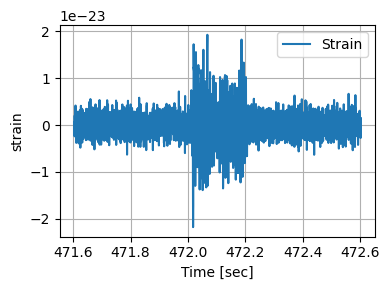

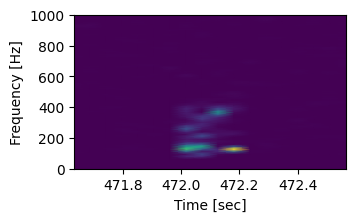

****************************************************************
Window sample No. 59
----------------------
Waveform SNR:  40.728878570582914
Injection location:  480.0
Window initial time (in seconds):  479.603271484375
Window end time (in seconds):  480.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



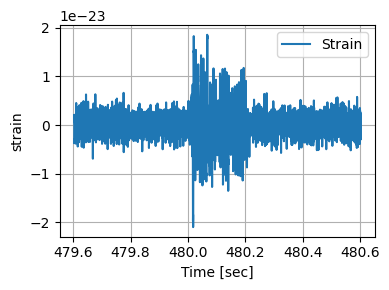

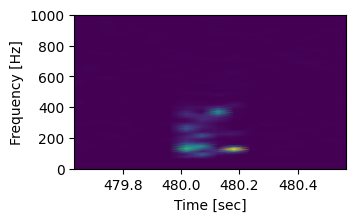

****************************************************************
Window sample No. 60
----------------------
Waveform SNR:  34.17833999035573
Injection location:  488.0
Window initial time (in seconds):  487.603271484375
Window end time (in seconds):  488.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



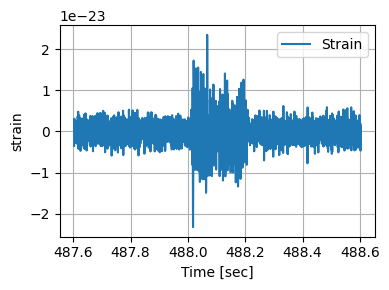

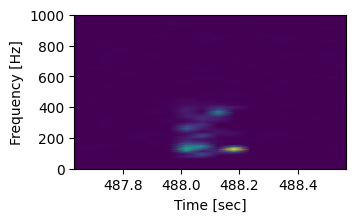

****************************************************************
Window sample No. 61
----------------------
Waveform SNR:  48.613603003448645
Injection location:  496.0
Window initial time (in seconds):  495.603271484375
Window end time (in seconds):  496.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



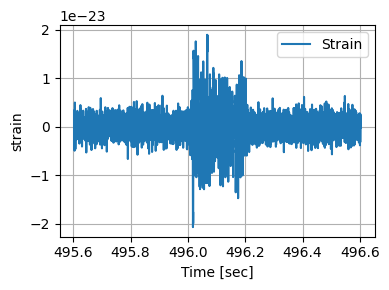

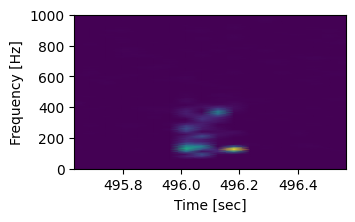

****************************************************************
Window sample No. 62
----------------------
Waveform SNR:  40.16410519911802
Injection location:  504.0
Window initial time (in seconds):  503.603271484375
Window end time (in seconds):  504.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



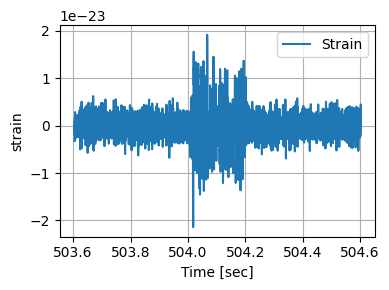

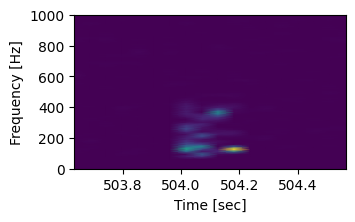

****************************************************************
Window sample No. 63
----------------------
Waveform SNR:  36.039607082524626
Injection location:  512.0
Window initial time (in seconds):  511.603271484375
Window end time (in seconds):  512.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



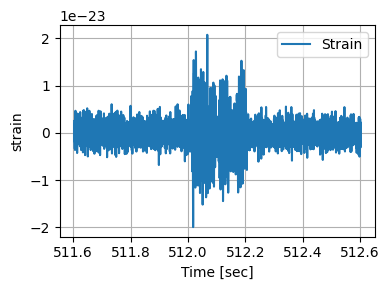

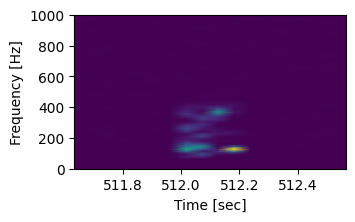

****************************************************************
Window sample No. 64
----------------------
Waveform SNR:  33.93160161151182
Injection location:  520.0
Window initial time (in seconds):  519.603271484375
Window end time (in seconds):  520.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



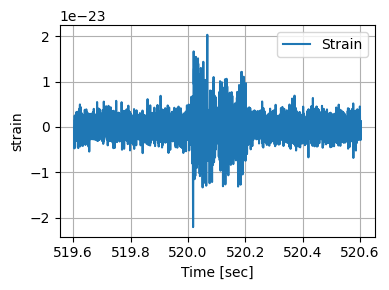

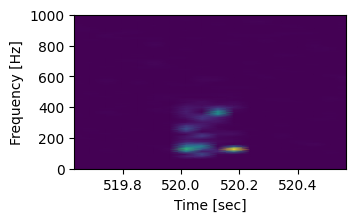

****************************************************************
Window sample No. 65
----------------------
Waveform SNR:  65.25065619235566
Injection location:  528.0
Window initial time (in seconds):  527.603271484375
Window end time (in seconds):  528.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



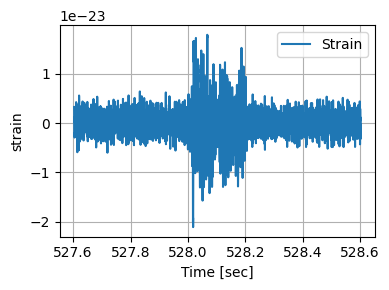

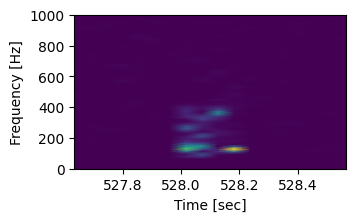

****************************************************************
Window sample No. 66
----------------------
Waveform SNR:  35.28258835176163
Injection location:  536.0
Window initial time (in seconds):  535.603271484375
Window end time (in seconds):  536.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



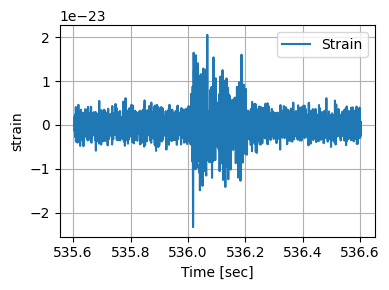

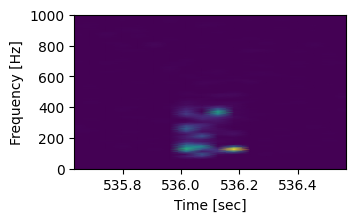

****************************************************************
Window sample No. 67
----------------------
Waveform SNR:  36.466530990819805
Injection location:  544.0
Window initial time (in seconds):  543.603271484375
Window end time (in seconds):  544.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



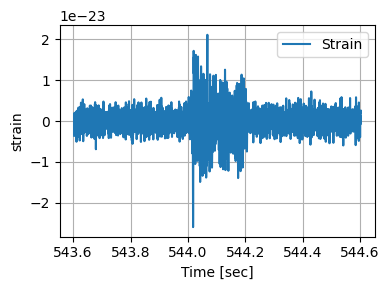

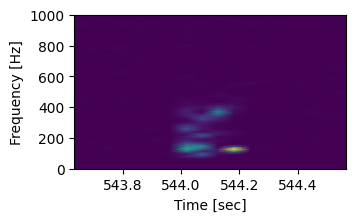

****************************************************************
Window sample No. 68
----------------------
Waveform SNR:  37.92279778814752
Injection location:  552.0
Window initial time (in seconds):  551.603271484375
Window end time (in seconds):  552.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



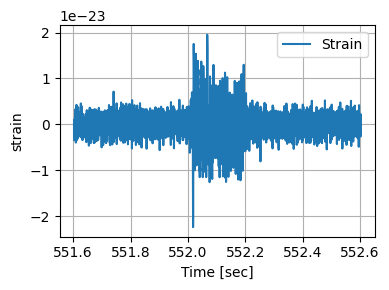

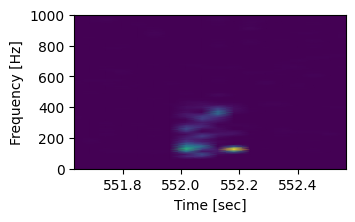

****************************************************************
Window sample No. 69
----------------------
Waveform SNR:  43.005454250660684
Injection location:  560.0
Window initial time (in seconds):  559.603271484375
Window end time (in seconds):  560.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



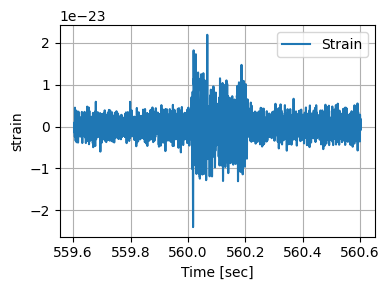

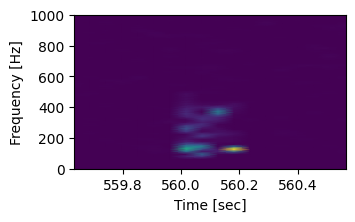

****************************************************************
Window sample No. 70
----------------------
Waveform SNR:  40.092592322908885
Injection location:  568.0
Window initial time (in seconds):  567.603271484375
Window end time (in seconds):  568.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



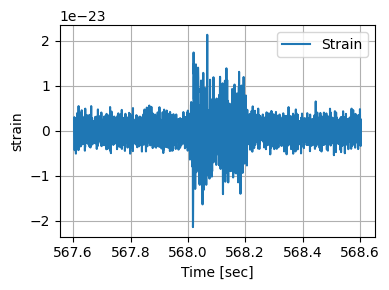

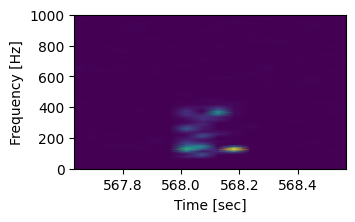

****************************************************************
Window sample No. 71
----------------------
Waveform SNR:  63.07003086111675
Injection location:  576.0
Window initial time (in seconds):  575.603271484375
Window end time (in seconds):  576.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



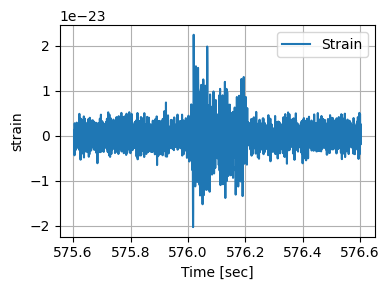

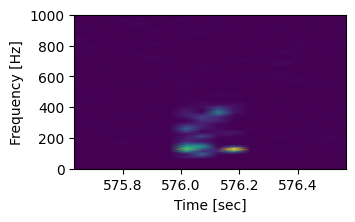

****************************************************************
Window sample No. 72
----------------------
Waveform SNR:  40.30119113908588
Injection location:  584.0
Window initial time (in seconds):  583.603271484375
Window end time (in seconds):  584.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



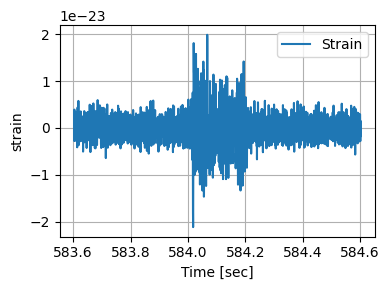

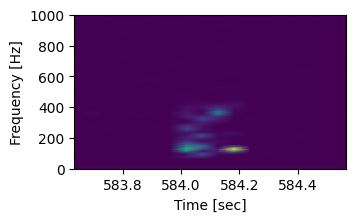

****************************************************************
Window sample No. 73
----------------------
Waveform SNR:  34.16370390088208
Injection location:  592.0
Window initial time (in seconds):  591.603271484375
Window end time (in seconds):  592.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



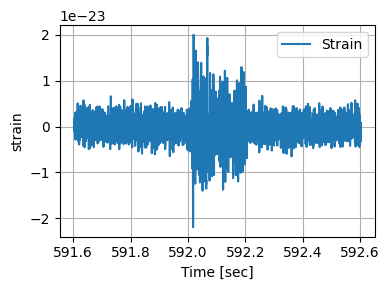

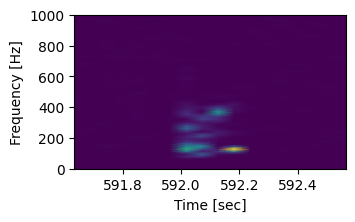

****************************************************************
Window sample No. 74
----------------------
Waveform SNR:  36.199068792585884
Injection location:  600.0
Window initial time (in seconds):  599.603271484375
Window end time (in seconds):  600.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



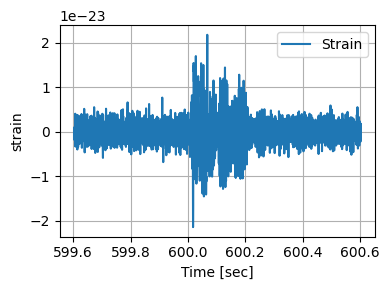

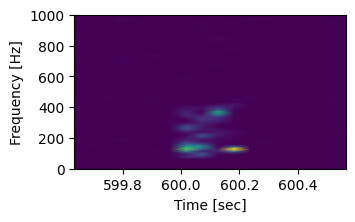

****************************************************************
Window sample No. 75
----------------------
Waveform SNR:  37.6996671667212
Injection location:  608.0
Window initial time (in seconds):  607.603271484375
Window end time (in seconds):  608.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



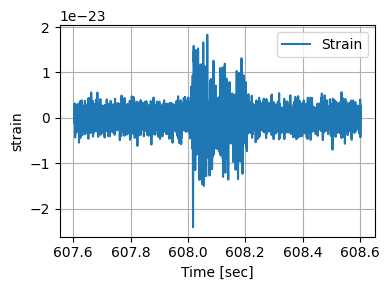

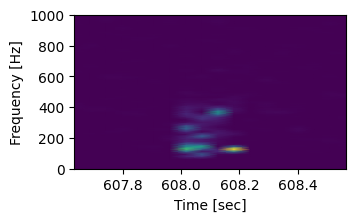

****************************************************************
Window sample No. 76
----------------------
Waveform SNR:  38.76248722236277
Injection location:  616.0
Window initial time (in seconds):  615.603271484375
Window end time (in seconds):  616.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



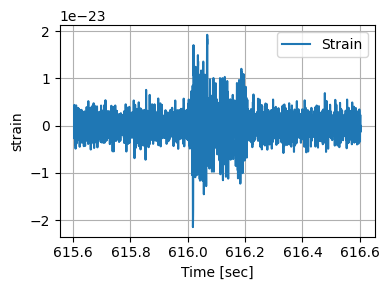

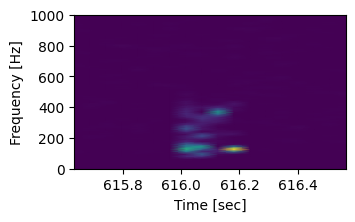

****************************************************************
Window sample No. 77
----------------------
Waveform SNR:  43.69618683775601
Injection location:  624.0
Window initial time (in seconds):  623.603271484375
Window end time (in seconds):  624.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



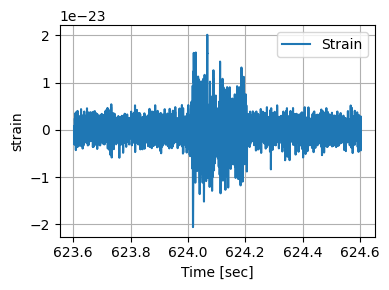

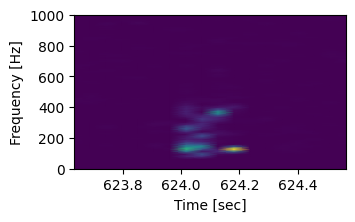

****************************************************************
Window sample No. 78
----------------------
Waveform SNR:  38.656161775253324
Injection location:  632.0
Window initial time (in seconds):  631.603271484375
Window end time (in seconds):  632.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



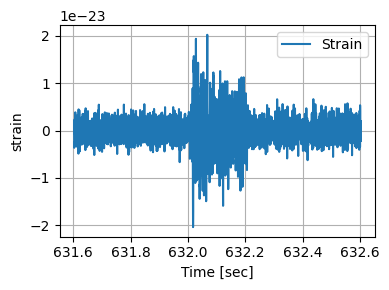

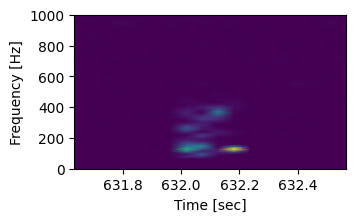

****************************************************************
Window sample No. 79
----------------------
Waveform SNR:  35.51921291781427
Injection location:  640.0
Window initial time (in seconds):  639.603271484375
Window end time (in seconds):  640.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



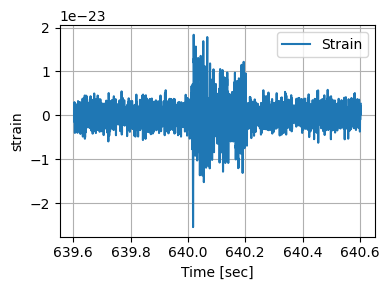

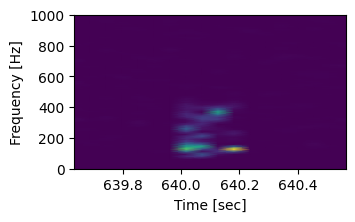

****************************************************************
Window sample No. 80
----------------------
Waveform SNR:  37.52185217880005
Injection location:  648.0
Window initial time (in seconds):  647.603271484375
Window end time (in seconds):  648.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



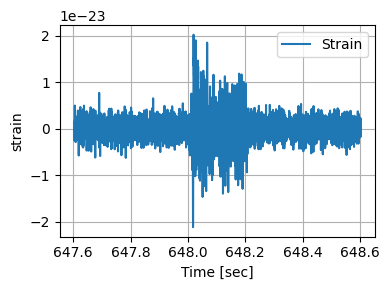

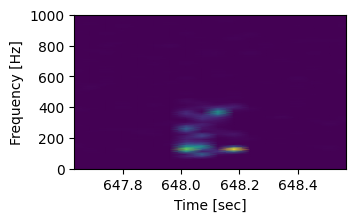

****************************************************************
Window sample No. 81
----------------------
Waveform SNR:  95.06107338405019
Injection location:  656.0
Window initial time (in seconds):  655.603271484375
Window end time (in seconds):  656.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



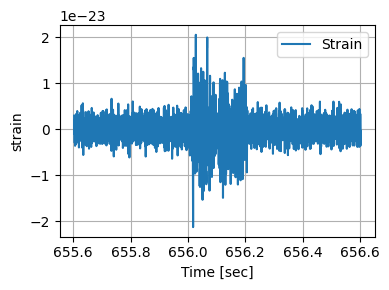

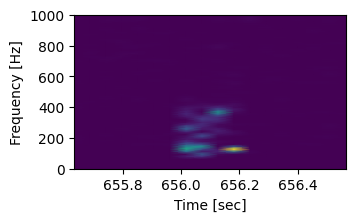

****************************************************************
Window sample No. 82
----------------------
Waveform SNR:  36.83263093294946
Injection location:  664.0
Window initial time (in seconds):  663.603271484375
Window end time (in seconds):  664.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



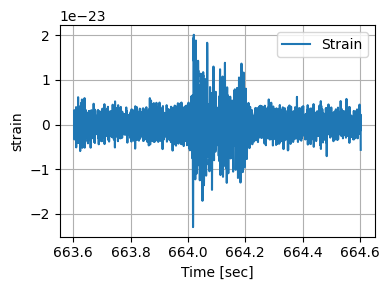

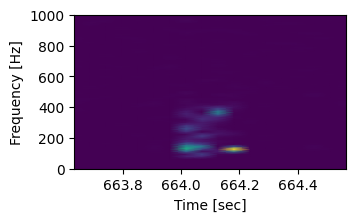

****************************************************************
Window sample No. 83
----------------------
Waveform SNR:  37.54624322704183
Injection location:  672.0
Window initial time (in seconds):  671.603271484375
Window end time (in seconds):  672.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



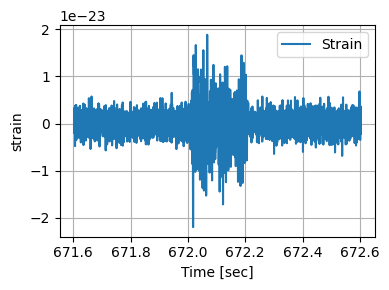

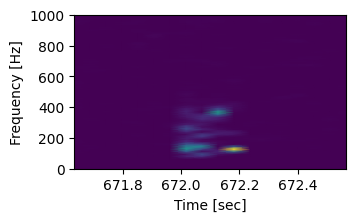

****************************************************************
Window sample No. 84
----------------------
Waveform SNR:  39.33608814462431
Injection location:  680.0
Window initial time (in seconds):  679.603271484375
Window end time (in seconds):  680.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



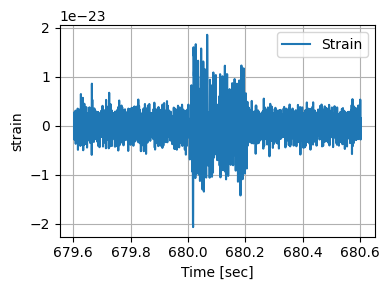

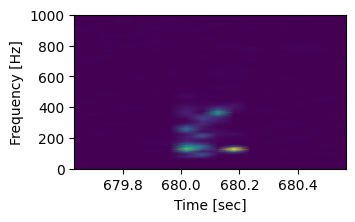

****************************************************************
Window sample No. 85
----------------------
Waveform SNR:  47.371260718621436
Injection location:  688.0
Window initial time (in seconds):  687.603271484375
Window end time (in seconds):  688.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



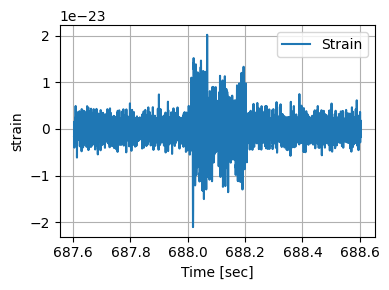

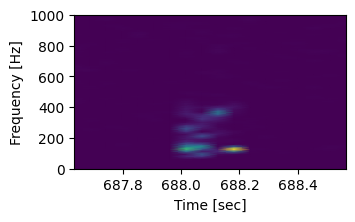

****************************************************************
Window sample No. 86
----------------------
Waveform SNR:  104.19940065565329
Injection location:  696.0
Window initial time (in seconds):  695.603271484375
Window end time (in seconds):  696.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



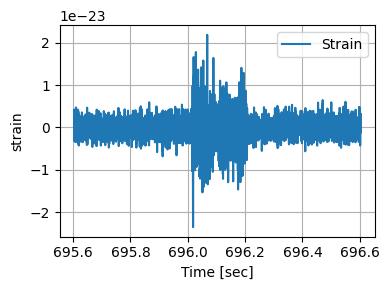

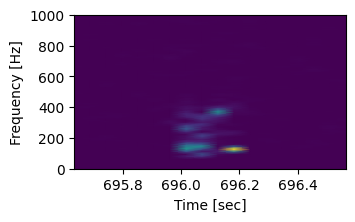

****************************************************************
Window sample No. 87
----------------------
Waveform SNR:  40.54120183251107
Injection location:  704.0
Window initial time (in seconds):  703.603271484375
Window end time (in seconds):  704.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



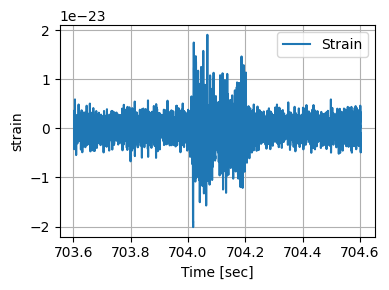

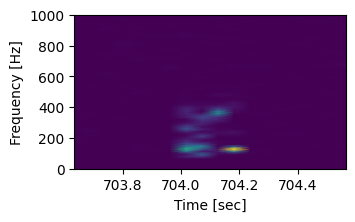

****************************************************************
Window sample No. 88
----------------------
Waveform SNR:  67.40567425436075
Injection location:  712.0
Window initial time (in seconds):  711.603271484375
Window end time (in seconds):  712.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



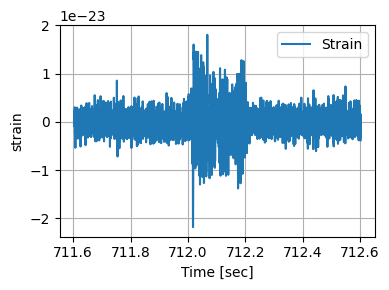

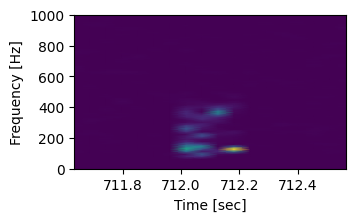

****************************************************************
Window sample No. 89
----------------------
Waveform SNR:  36.09215602360582
Injection location:  720.0
Window initial time (in seconds):  719.603271484375
Window end time (in seconds):  720.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



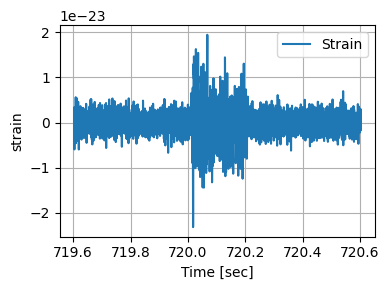

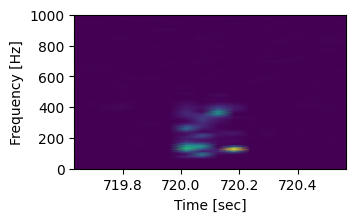

****************************************************************
Window sample No. 90
----------------------
Waveform SNR:  51.245730179723815
Injection location:  728.0
Window initial time (in seconds):  727.603271484375
Window end time (in seconds):  728.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



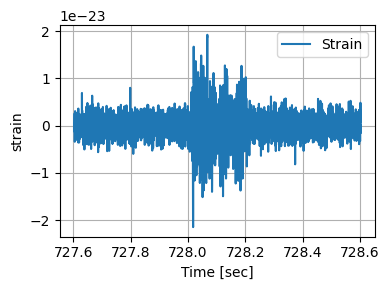

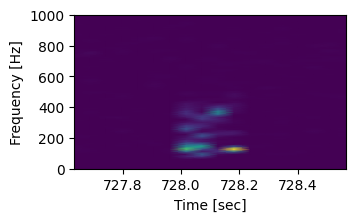

****************************************************************
Window sample No. 91
----------------------
Waveform SNR:  40.57518197732849
Injection location:  736.0
Window initial time (in seconds):  735.603271484375
Window end time (in seconds):  736.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



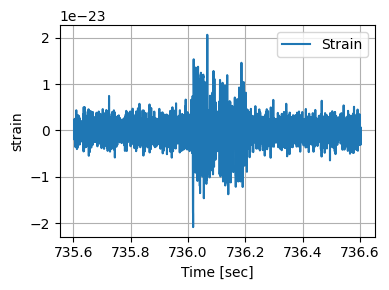

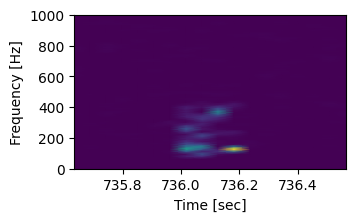

****************************************************************
Window sample No. 92
----------------------
Waveform SNR:  36.1207785354642
Injection location:  744.0
Window initial time (in seconds):  743.603271484375
Window end time (in seconds):  744.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



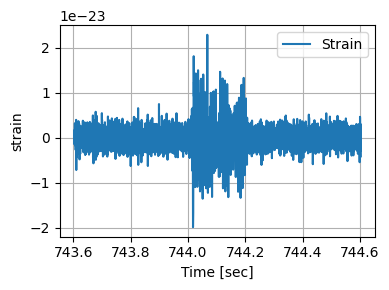

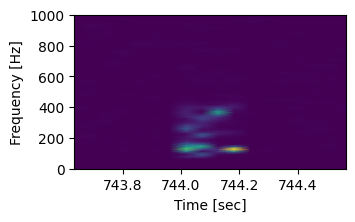

****************************************************************
Window sample No. 93
----------------------
Waveform SNR:  37.598433919470104
Injection location:  752.0
Window initial time (in seconds):  751.603271484375
Window end time (in seconds):  752.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



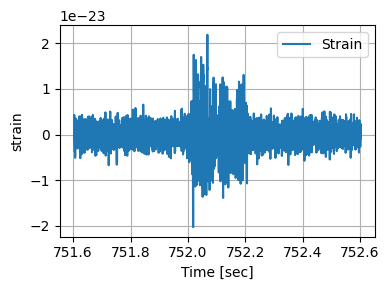

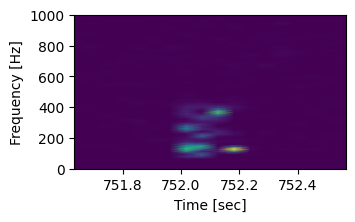

****************************************************************
Window sample No. 94
----------------------
Waveform SNR:  39.93294194634823
Injection location:  760.0
Window initial time (in seconds):  759.603271484375
Window end time (in seconds):  760.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



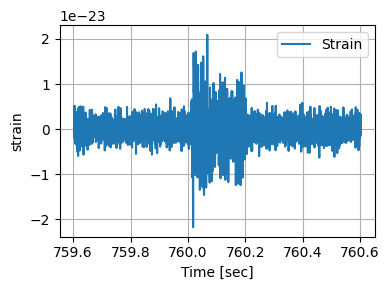

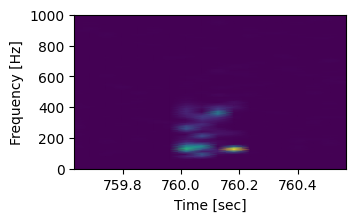

****************************************************************
Window sample No. 95
----------------------
Waveform SNR:  45.101773450910734
Injection location:  768.0
Window initial time (in seconds):  767.603271484375
Window end time (in seconds):  768.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



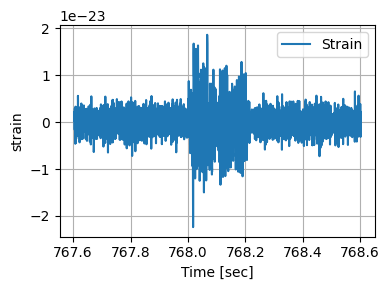

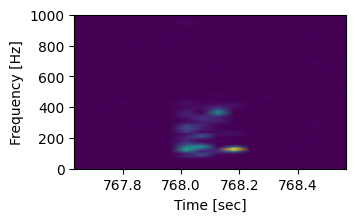

****************************************************************
Window sample No. 96
----------------------
Waveform SNR:  55.96748783880074
Injection location:  776.0
Window initial time (in seconds):  775.603271484375
Window end time (in seconds):  776.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



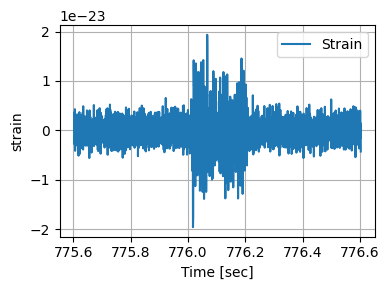

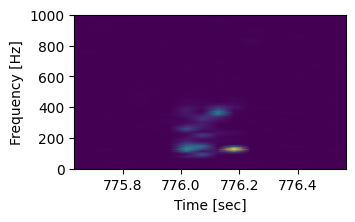

****************************************************************
Window sample No. 97
----------------------
Waveform SNR:  89.81485894691129
Injection location:  784.0
Window initial time (in seconds):  783.603271484375
Window end time (in seconds):  784.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



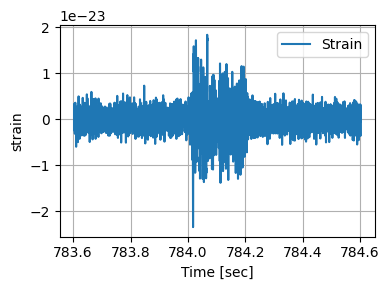

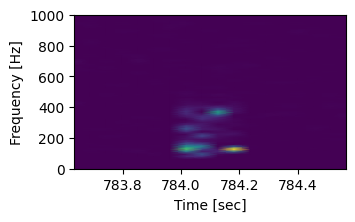

****************************************************************
Window sample No. 98
----------------------
Waveform SNR:  36.03365061580417
Injection location:  792.0
Window initial time (in seconds):  791.603271484375
Window end time (in seconds):  792.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



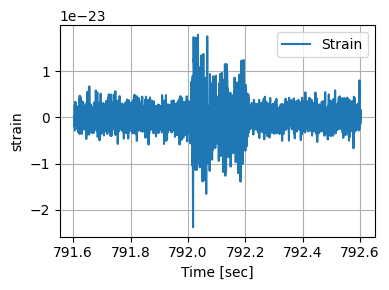

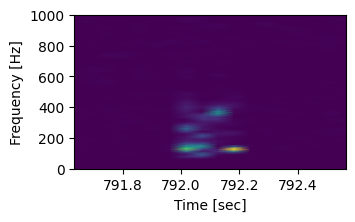

****************************************************************
Window sample No. 99
----------------------
Waveform SNR:  43.0933488382576
Injection location:  800.0
Window initial time (in seconds):  799.603271484375
Window end time (in seconds):  800.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



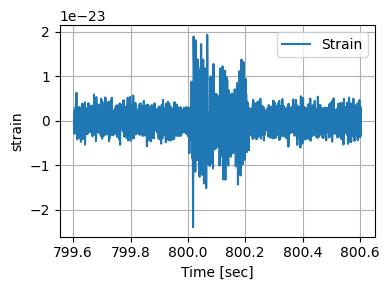

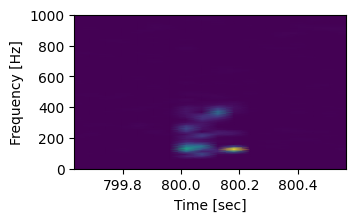

****************************************************************
Window sample No. 100
----------------------
Waveform SNR:  36.16108942515971
Injection location:  808.0
Window initial time (in seconds):  807.603271484375
Window end time (in seconds):  808.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



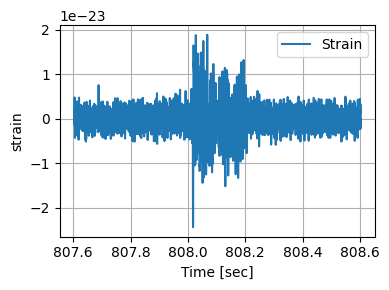

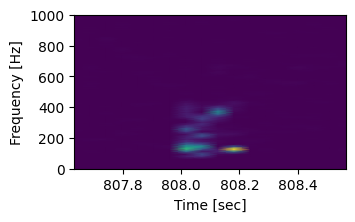

****************************************************************
Window sample No. 101
----------------------
Waveform SNR:  37.22661040299485
Injection location:  816.0
Window initial time (in seconds):  815.603271484375
Window end time (in seconds):  816.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



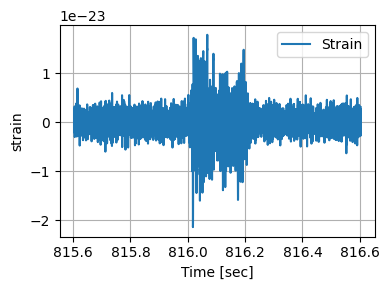

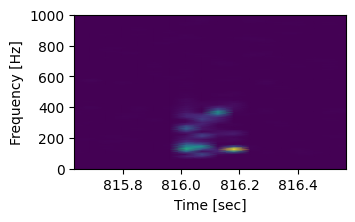

****************************************************************
Window sample No. 102
----------------------
Waveform SNR:  36.5738169647305
Injection location:  824.0
Window initial time (in seconds):  823.603271484375
Window end time (in seconds):  824.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



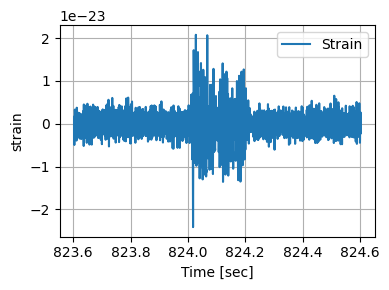

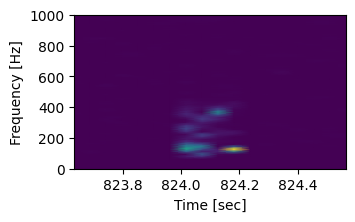

****************************************************************
Window sample No. 103
----------------------
Waveform SNR:  39.063032982950105
Injection location:  832.0
Window initial time (in seconds):  831.603271484375
Window end time (in seconds):  832.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



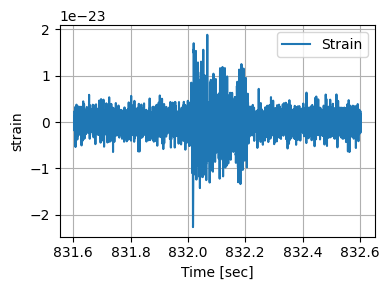

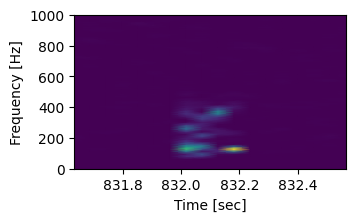

****************************************************************
Window sample No. 104
----------------------
Waveform SNR:  67.54356874406172
Injection location:  840.0
Window initial time (in seconds):  839.603271484375
Window end time (in seconds):  840.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



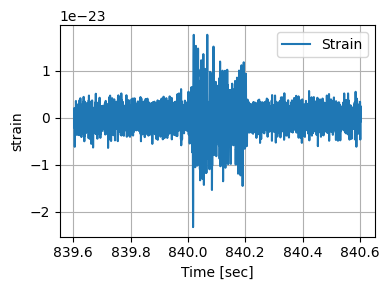

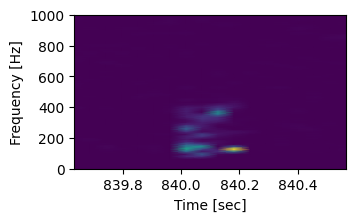

****************************************************************
Window sample No. 105
----------------------
Waveform SNR:  35.22067727346901
Injection location:  848.0
Window initial time (in seconds):  847.603271484375
Window end time (in seconds):  848.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



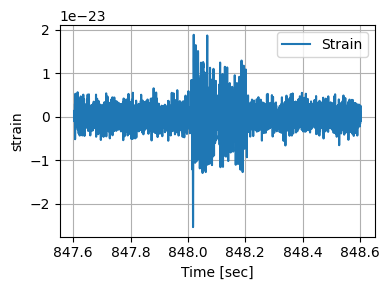

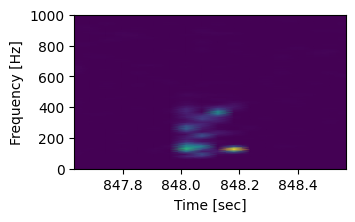

****************************************************************
Window sample No. 106
----------------------
Waveform SNR:  37.53367953046684
Injection location:  856.0
Window initial time (in seconds):  855.603271484375
Window end time (in seconds):  856.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



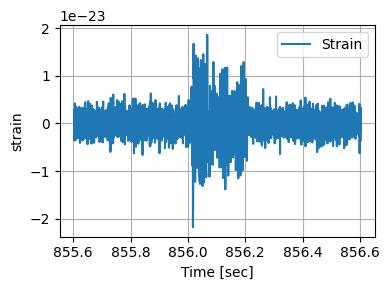

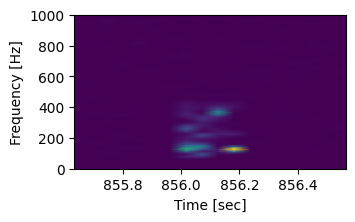

****************************************************************
Window sample No. 107
----------------------
Waveform SNR:  34.21498250792839
Injection location:  864.0
Window initial time (in seconds):  863.603271484375
Window end time (in seconds):  864.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



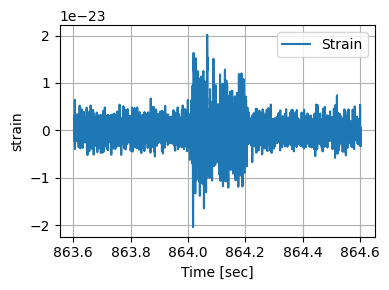

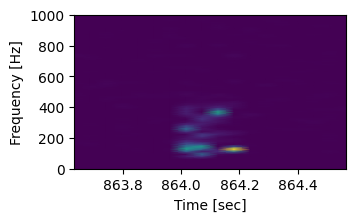

****************************************************************
Window sample No. 108
----------------------
Waveform SNR:  56.4156603724174
Injection location:  872.0
Window initial time (in seconds):  871.603271484375
Window end time (in seconds):  872.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



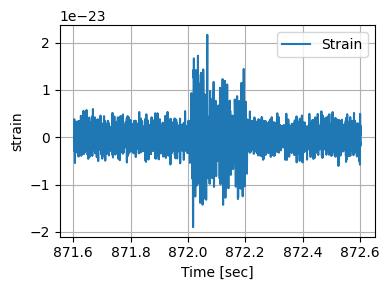

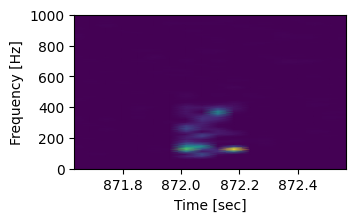

****************************************************************
Window sample No. 109
----------------------
Waveform SNR:  34.20742038019438
Injection location:  880.0
Window initial time (in seconds):  879.603271484375
Window end time (in seconds):  880.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



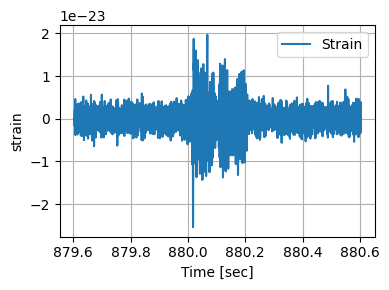

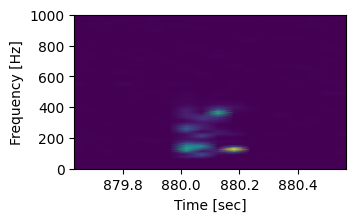

****************************************************************
Window sample No. 110
----------------------
Waveform SNR:  36.93866885783723
Injection location:  888.0
Window initial time (in seconds):  887.603271484375
Window end time (in seconds):  888.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



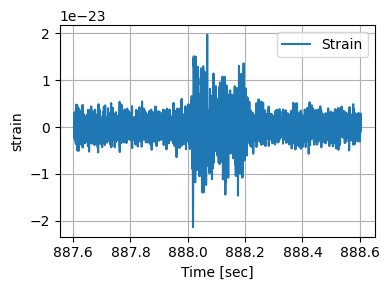

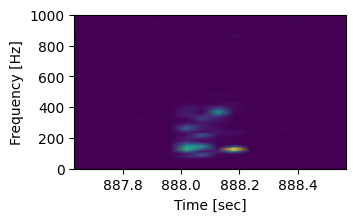

****************************************************************
Window sample No. 111
----------------------
Waveform SNR:  54.70497262495128
Injection location:  896.0
Window initial time (in seconds):  895.603271484375
Window end time (in seconds):  896.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



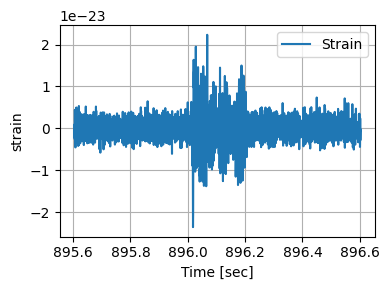

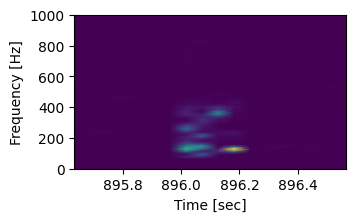

****************************************************************
Window sample No. 112
----------------------
Waveform SNR:  38.21559379636672
Injection location:  904.0
Window initial time (in seconds):  903.603271484375
Window end time (in seconds):  904.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



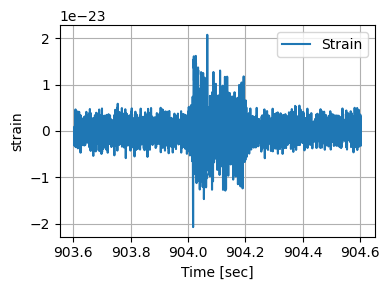

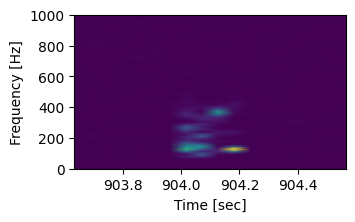

****************************************************************
Window sample No. 113
----------------------
Waveform SNR:  39.80547714334248
Injection location:  912.0
Window initial time (in seconds):  911.603271484375
Window end time (in seconds):  912.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



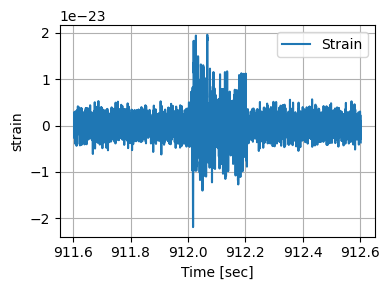

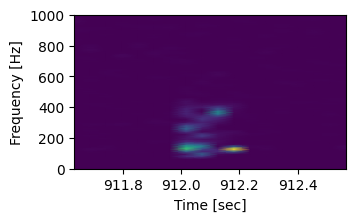

****************************************************************
Window sample No. 114
----------------------
Waveform SNR:  39.31753583938243
Injection location:  920.0
Window initial time (in seconds):  919.603271484375
Window end time (in seconds):  920.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



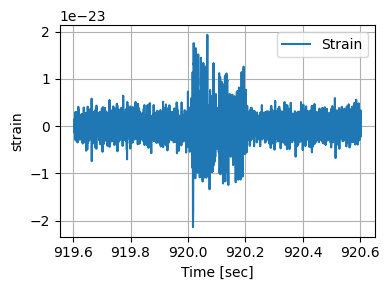

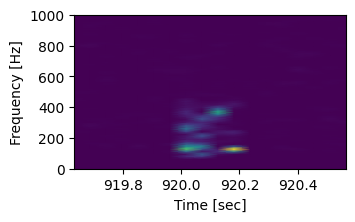

****************************************************************
Window sample No. 115
----------------------
Waveform SNR:  45.663447449044334
Injection location:  928.0
Window initial time (in seconds):  927.603271484375
Window end time (in seconds):  928.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



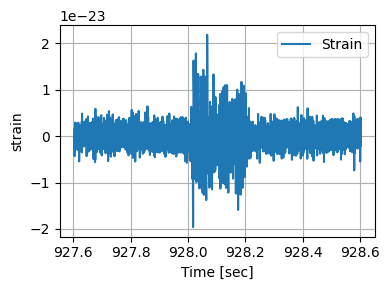

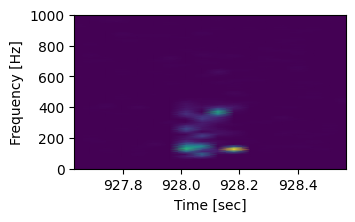

****************************************************************
Window sample No. 116
----------------------
Waveform SNR:  35.885229418243
Injection location:  936.0
Window initial time (in seconds):  935.603271484375
Window end time (in seconds):  936.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



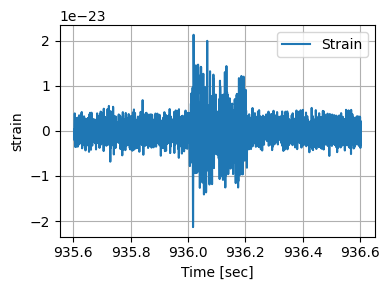

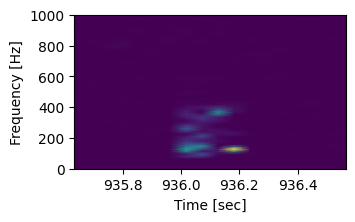

****************************************************************
Window sample No. 117
----------------------
Waveform SNR:  36.38172195333131
Injection location:  944.0
Window initial time (in seconds):  943.603271484375
Window end time (in seconds):  944.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



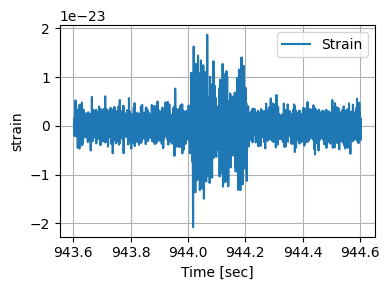

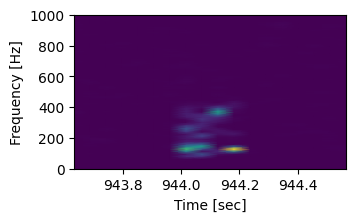

****************************************************************
Window sample No. 118
----------------------
Waveform SNR:  38.943410612685476
Injection location:  952.0
Window initial time (in seconds):  951.603271484375
Window end time (in seconds):  952.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



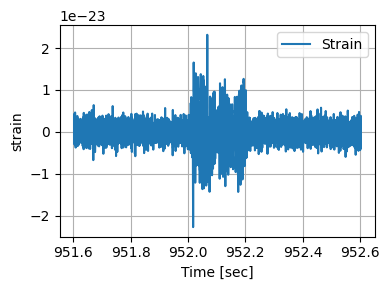

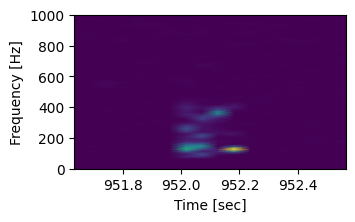

****************************************************************
Window sample No. 119
----------------------
Waveform SNR:  45.57790217144267
Injection location:  960.0
Window initial time (in seconds):  959.603271484375
Window end time (in seconds):  960.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



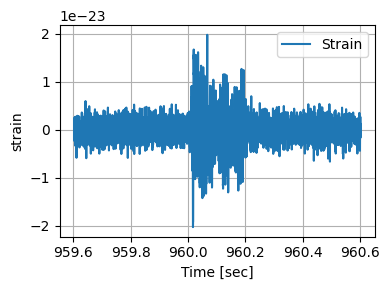

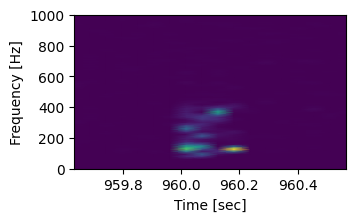

****************************************************************
Window sample No. 120
----------------------
Waveform SNR:  45.899655711429155
Injection location:  968.0
Window initial time (in seconds):  967.603271484375
Window end time (in seconds):  968.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



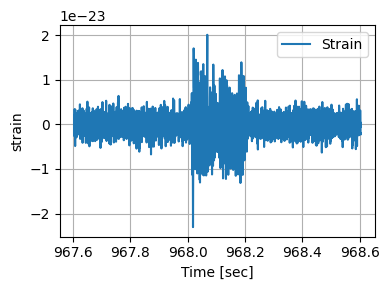

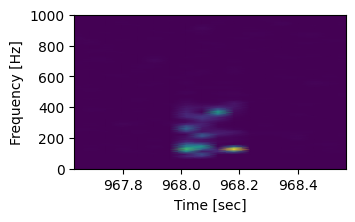

****************************************************************
Window sample No. 121
----------------------
Waveform SNR:  38.19942020206322
Injection location:  976.0
Window initial time (in seconds):  975.603271484375
Window end time (in seconds):  976.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



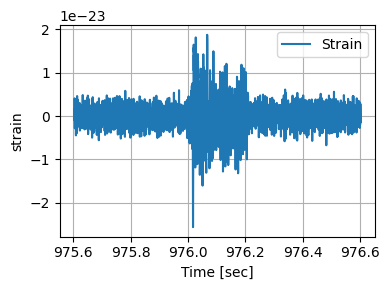

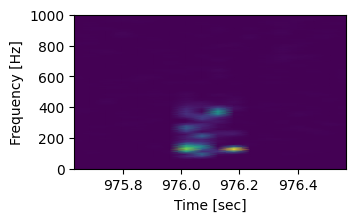

****************************************************************
Window sample No. 122
----------------------
Waveform SNR:  38.4796753429323
Injection location:  984.0
Window initial time (in seconds):  983.603271484375
Window end time (in seconds):  984.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



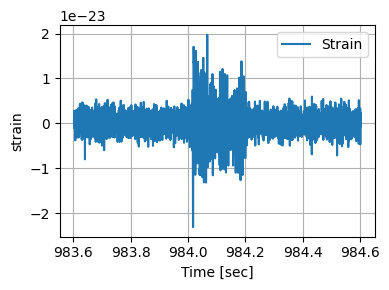

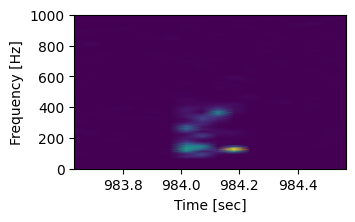

****************************************************************
Window sample No. 123
----------------------
Waveform SNR:  40.1040425566855
Injection location:  992.0
Window initial time (in seconds):  991.603271484375
Window end time (in seconds):  992.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



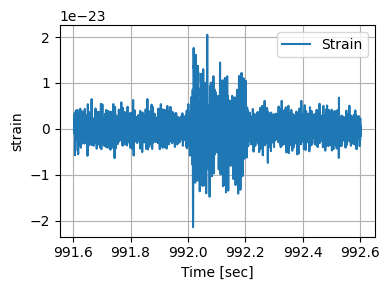

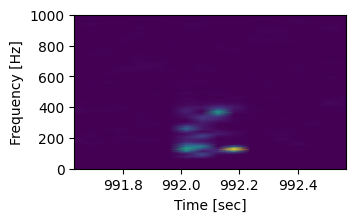

****************************************************************
Window sample No. 124
----------------------
Waveform SNR:  42.069401427124625
Injection location:  1000.0
Window initial time (in seconds):  999.603271484375
Window end time (in seconds):  1000.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



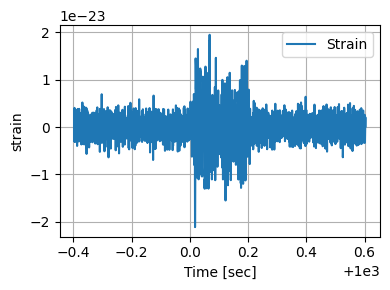

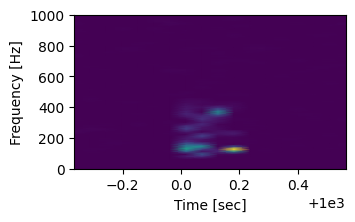

****************************************************************
Window sample No. 125
----------------------
Waveform SNR:  85.4227972764301
Injection location:  1008.0
Window initial time (in seconds):  1007.603271484375
Window end time (in seconds):  1008.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



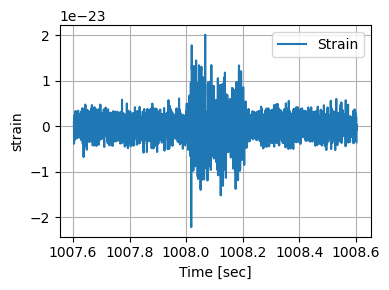

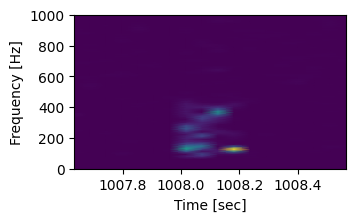

****************************************************************
Window sample No. 126
----------------------
Waveform SNR:  33.93953313362797
Injection location:  1016.0
Window initial time (in seconds):  1015.603271484375
Window end time (in seconds):  1016.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



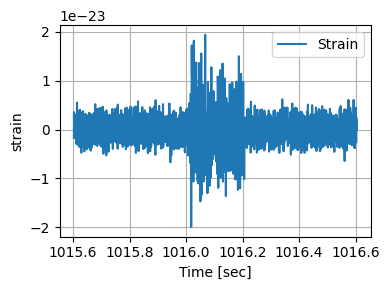

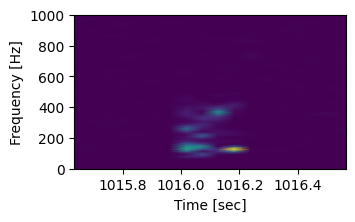

****************************************************************
Window sample No. 127
----------------------
Waveform SNR:  40.95694298526468
Injection location:  1024.0
Window initial time (in seconds):  1023.603271484375
Window end time (in seconds):  1024.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



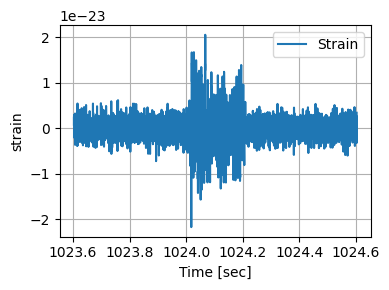

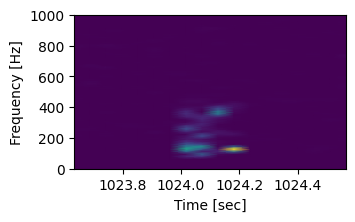

****************************************************************
Window sample No. 128
----------------------
Waveform SNR:  37.39043152392943
Injection location:  1032.0
Window initial time (in seconds):  1031.603271484375
Window end time (in seconds):  1032.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



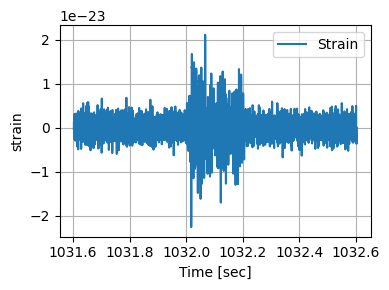

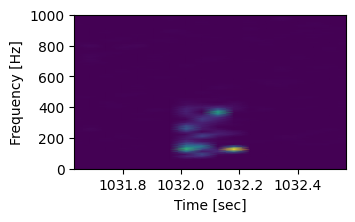

****************************************************************
Window sample No. 129
----------------------
Waveform SNR:  39.74811355527445
Injection location:  1040.0
Window initial time (in seconds):  1039.603271484375
Window end time (in seconds):  1040.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



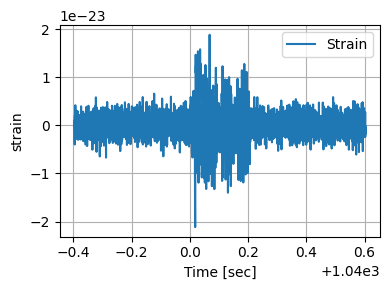

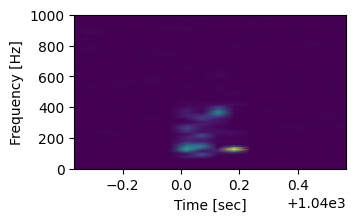

****************************************************************
Window sample No. 130
----------------------
Waveform SNR:  38.74367755863094
Injection location:  1048.0
Window initial time (in seconds):  1047.603271484375
Window end time (in seconds):  1048.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



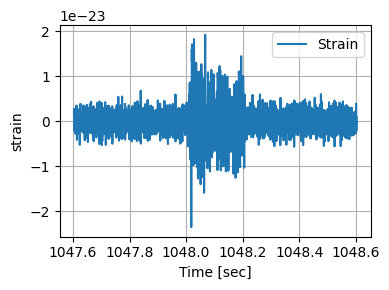

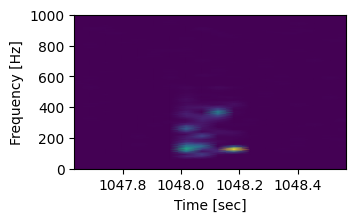

****************************************************************
Window sample No. 131
----------------------
Waveform SNR:  36.888507483352846
Injection location:  1056.0
Window initial time (in seconds):  1055.603271484375
Window end time (in seconds):  1056.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



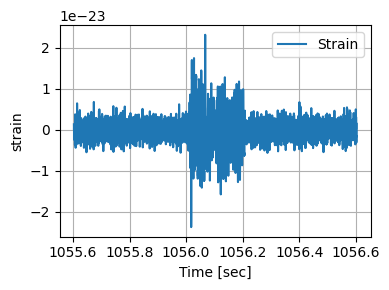

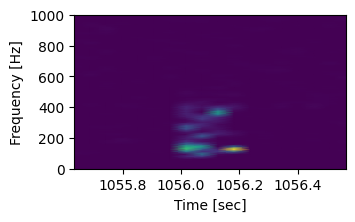

****************************************************************
Window sample No. 132
----------------------
Waveform SNR:  35.487273057650356
Injection location:  1064.0
Window initial time (in seconds):  1063.603271484375
Window end time (in seconds):  1064.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



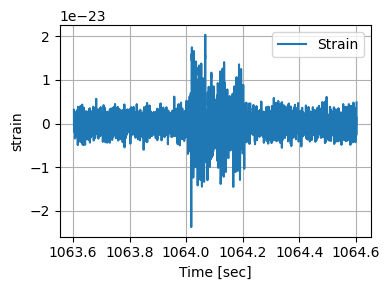

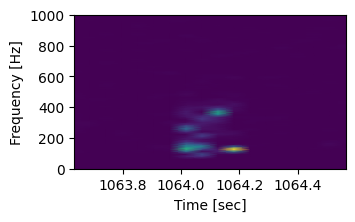

****************************************************************
Window sample No. 133
----------------------
Waveform SNR:  61.59657956036217
Injection location:  1072.0
Window initial time (in seconds):  1071.603271484375
Window end time (in seconds):  1072.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



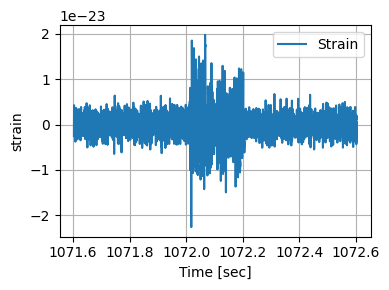

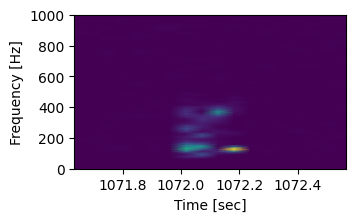

****************************************************************
Window sample No. 134
----------------------
Waveform SNR:  39.81421998651026
Injection location:  1080.0
Window initial time (in seconds):  1079.603271484375
Window end time (in seconds):  1080.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



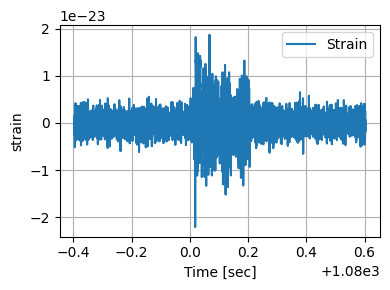

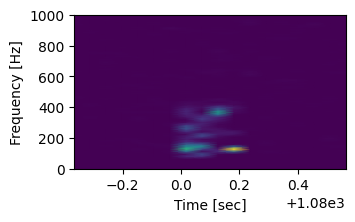

****************************************************************
Window sample No. 135
----------------------
Waveform SNR:  46.45007301368401
Injection location:  1088.0
Window initial time (in seconds):  1087.603271484375
Window end time (in seconds):  1088.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



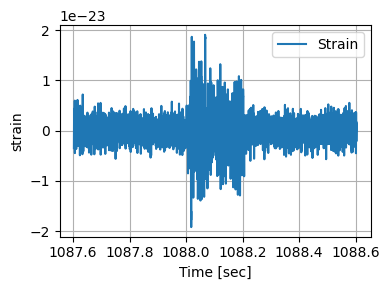

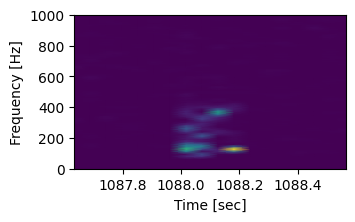

****************************************************************
Window sample No. 136
----------------------
Waveform SNR:  34.1632495664746
Injection location:  1096.0
Window initial time (in seconds):  1095.603271484375
Window end time (in seconds):  1096.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



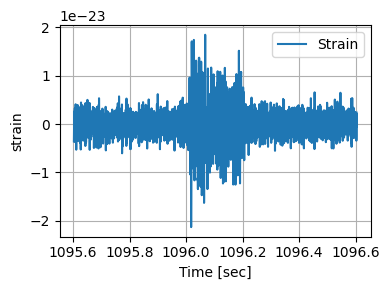

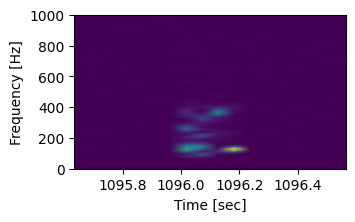

****************************************************************
Window sample No. 137
----------------------
Waveform SNR:  37.63166292542902
Injection location:  1104.0
Window initial time (in seconds):  1103.603271484375
Window end time (in seconds):  1104.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



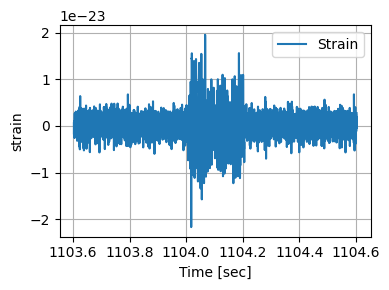

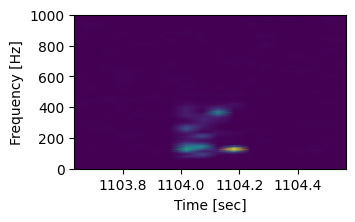

****************************************************************
Window sample No. 138
----------------------
Waveform SNR:  43.78477517813313
Injection location:  1112.0
Window initial time (in seconds):  1111.603271484375
Window end time (in seconds):  1112.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



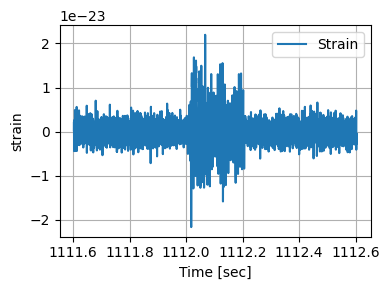

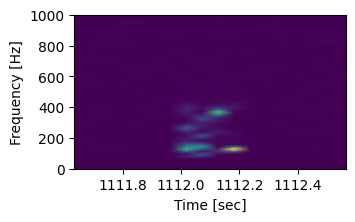

****************************************************************
Window sample No. 139
----------------------
Waveform SNR:  36.75806993001169
Injection location:  1120.0
Window initial time (in seconds):  1119.603271484375
Window end time (in seconds):  1120.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



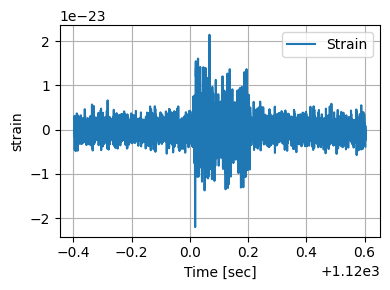

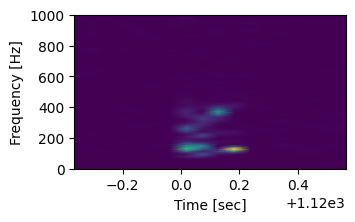

****************************************************************
Window sample No. 140
----------------------
Waveform SNR:  41.877756514510025
Injection location:  1128.0
Window initial time (in seconds):  1127.603271484375
Window end time (in seconds):  1128.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



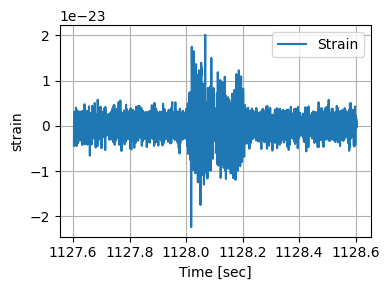

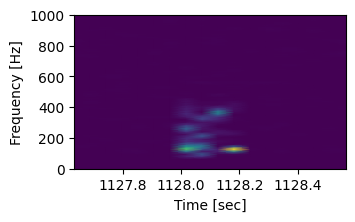

****************************************************************
Window sample No. 141
----------------------
Waveform SNR:  41.131287937545586
Injection location:  1136.0
Window initial time (in seconds):  1135.603271484375
Window end time (in seconds):  1136.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



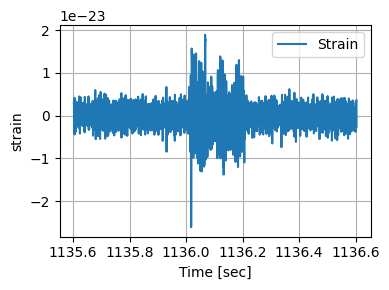

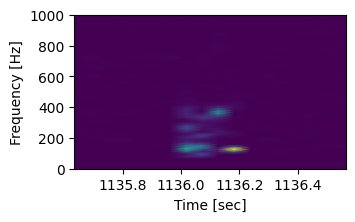

****************************************************************
Window sample No. 142
----------------------
Waveform SNR:  35.939668185960016
Injection location:  1144.0
Window initial time (in seconds):  1143.603271484375
Window end time (in seconds):  1144.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



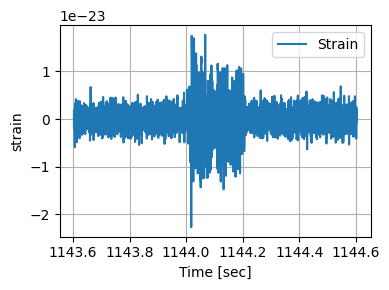

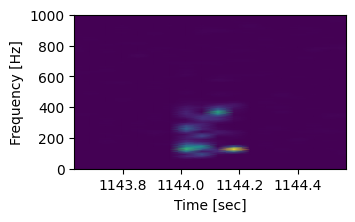

****************************************************************
Window sample No. 143
----------------------
Waveform SNR:  37.82569039389948
Injection location:  1152.0
Window initial time (in seconds):  1151.603271484375
Window end time (in seconds):  1152.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



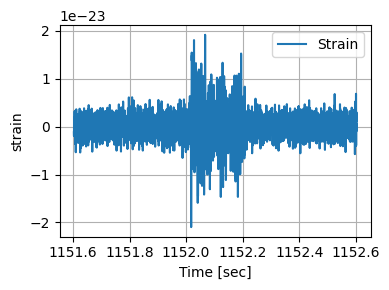

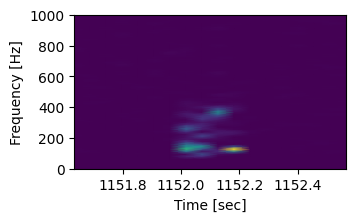

****************************************************************
Window sample No. 144
----------------------
Waveform SNR:  39.75070231868943
Injection location:  1160.0
Window initial time (in seconds):  1159.603271484375
Window end time (in seconds):  1160.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



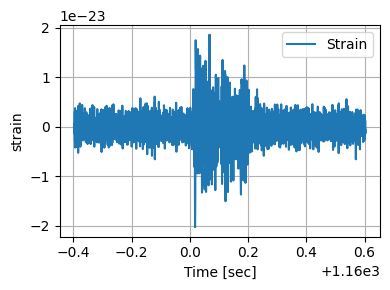

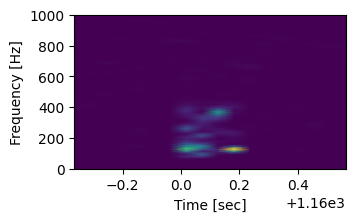

****************************************************************
Window sample No. 145
----------------------
Waveform SNR:  38.97437213080355
Injection location:  1168.0
Window initial time (in seconds):  1167.603271484375
Window end time (in seconds):  1168.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



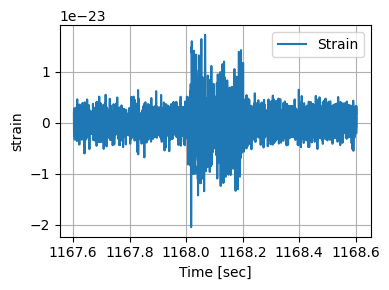

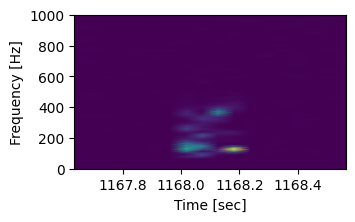

****************************************************************
Window sample No. 146
----------------------
Waveform SNR:  36.0125365813154
Injection location:  1176.0
Window initial time (in seconds):  1175.603271484375
Window end time (in seconds):  1176.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



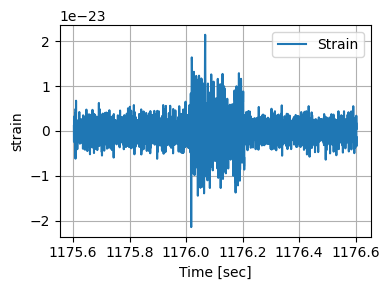

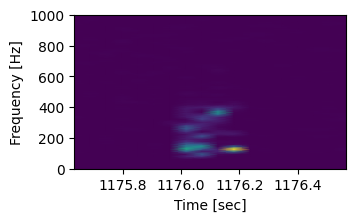

****************************************************************
Window sample No. 147
----------------------
Waveform SNR:  41.240657242619946
Injection location:  1184.0
Window initial time (in seconds):  1183.603271484375
Window end time (in seconds):  1184.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



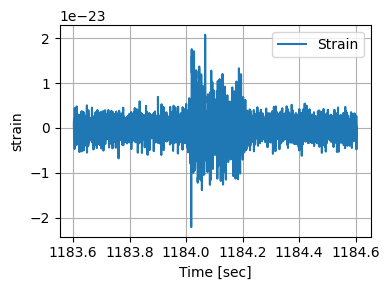

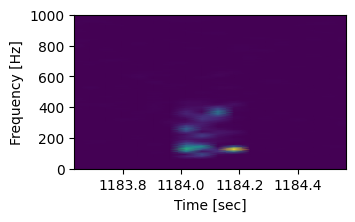

****************************************************************
Window sample No. 148
----------------------
Waveform SNR:  36.00498151400282
Injection location:  1192.0
Window initial time (in seconds):  1191.603271484375
Window end time (in seconds):  1192.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



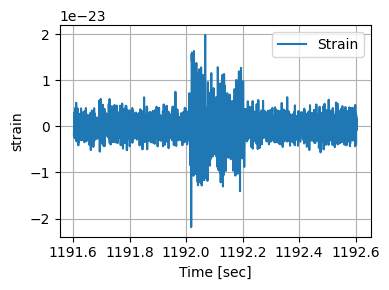

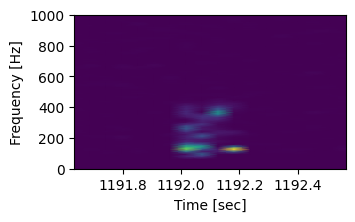

****************************************************************
Window sample No. 149
----------------------
Waveform SNR:  43.7739708953973
Injection location:  1200.0
Window initial time (in seconds):  1199.603271484375
Window end time (in seconds):  1200.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



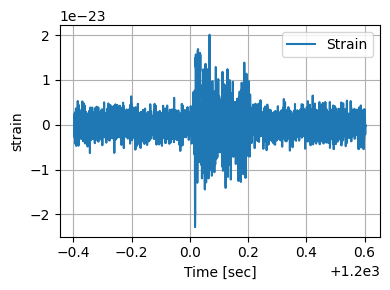

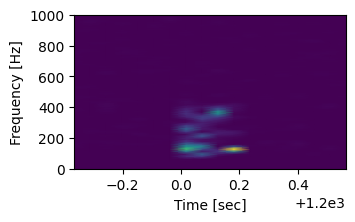

****************************************************************
Window sample No. 150
----------------------
Waveform SNR:  62.07112111110168
Injection location:  1208.0
Window initial time (in seconds):  1207.603271484375
Window end time (in seconds):  1208.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



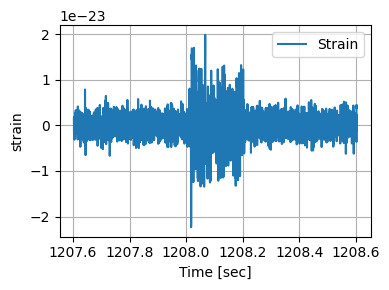

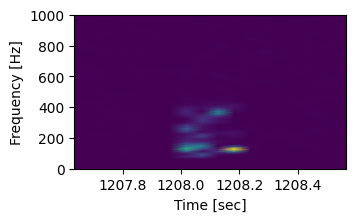

****************************************************************
Window sample No. 151
----------------------
Waveform SNR:  38.605661326553204
Injection location:  1216.0
Window initial time (in seconds):  1215.603271484375
Window end time (in seconds):  1216.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



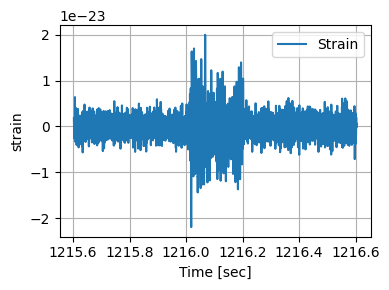

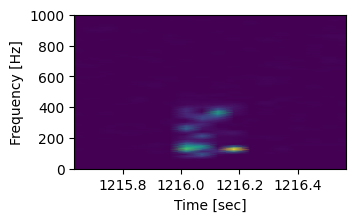

****************************************************************
Window sample No. 152
----------------------
Waveform SNR:  43.233248217387406
Injection location:  1224.0
Window initial time (in seconds):  1223.603271484375
Window end time (in seconds):  1224.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



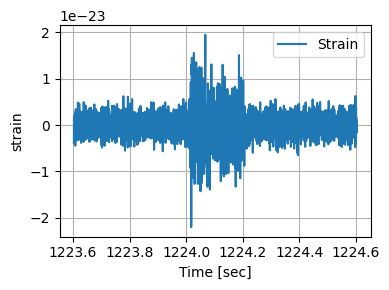

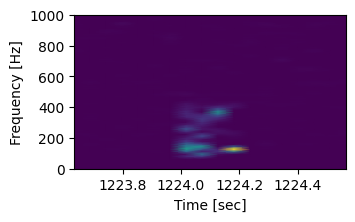

****************************************************************
Window sample No. 153
----------------------
Waveform SNR:  35.93193179819072
Injection location:  1232.0
Window initial time (in seconds):  1231.603271484375
Window end time (in seconds):  1232.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



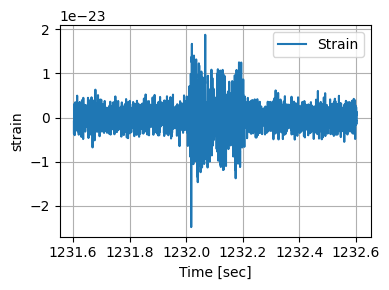

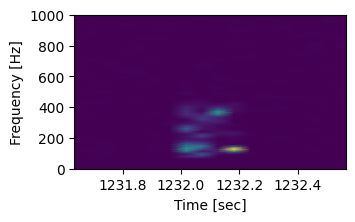

****************************************************************
Window sample No. 154
----------------------
Waveform SNR:  35.55116957450691
Injection location:  1240.0
Window initial time (in seconds):  1239.603271484375
Window end time (in seconds):  1240.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



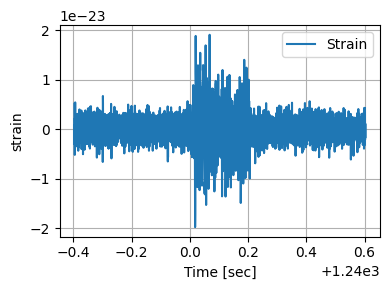

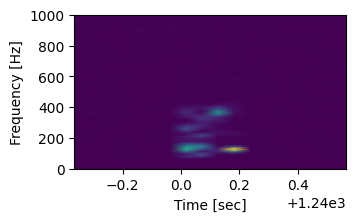

****************************************************************
Window sample No. 155
----------------------
Waveform SNR:  34.647391515377606
Injection location:  1248.0
Window initial time (in seconds):  1247.603271484375
Window end time (in seconds):  1248.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



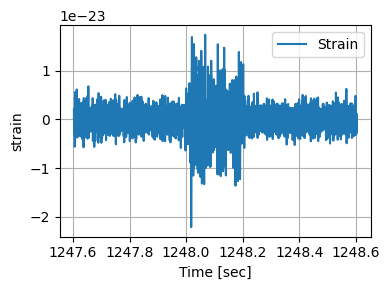

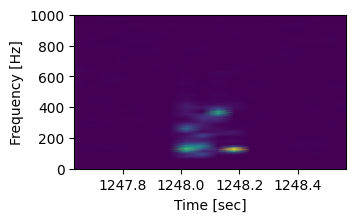

****************************************************************
Window sample No. 156
----------------------
Waveform SNR:  36.59910762454669
Injection location:  1256.0
Window initial time (in seconds):  1255.603271484375
Window end time (in seconds):  1256.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



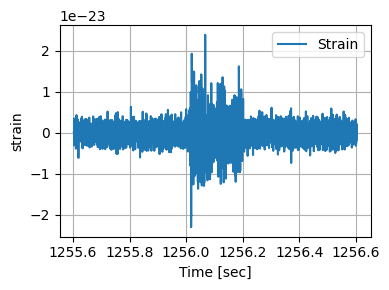

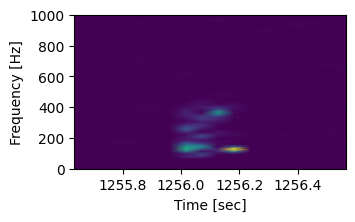

****************************************************************
Window sample No. 157
----------------------
Waveform SNR:  38.09373582951206
Injection location:  1264.0
Window initial time (in seconds):  1263.603271484375
Window end time (in seconds):  1264.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



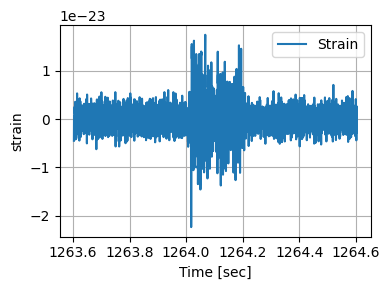

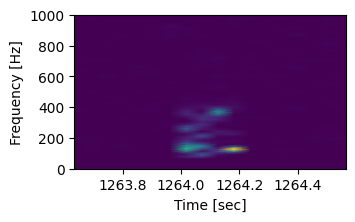

****************************************************************
Window sample No. 158
----------------------
Waveform SNR:  38.285252524782585
Injection location:  1272.0
Window initial time (in seconds):  1271.603271484375
Window end time (in seconds):  1272.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



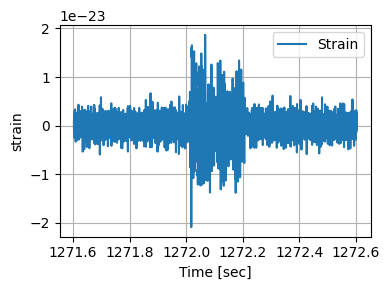

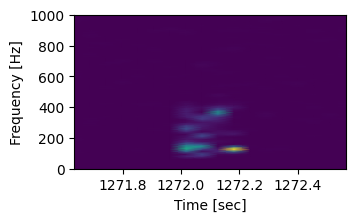

****************************************************************
Window sample No. 159
----------------------
Waveform SNR:  37.76334551757362
Injection location:  1280.0
Window initial time (in seconds):  1279.603271484375
Window end time (in seconds):  1280.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



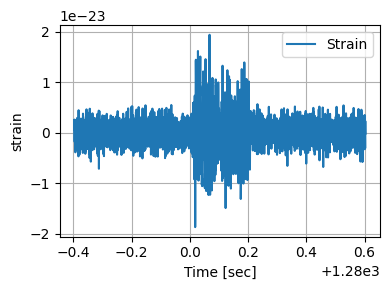

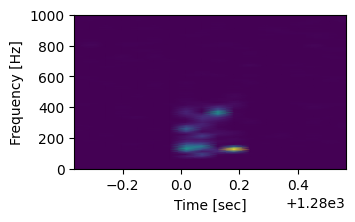

****************************************************************
Window sample No. 160
----------------------
Waveform SNR:  35.090526552709775
Injection location:  1288.0
Window initial time (in seconds):  1287.603271484375
Window end time (in seconds):  1288.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



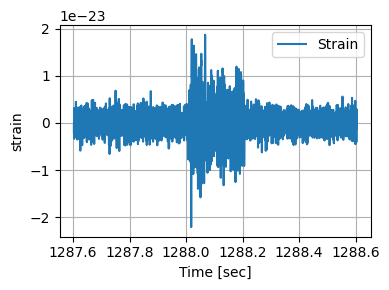

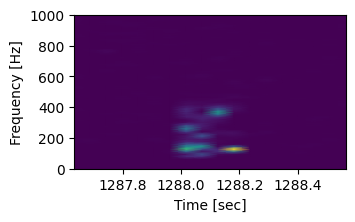

****************************************************************
Window sample No. 161
----------------------
Waveform SNR:  36.525396506875595
Injection location:  1296.0
Window initial time (in seconds):  1295.603271484375
Window end time (in seconds):  1296.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



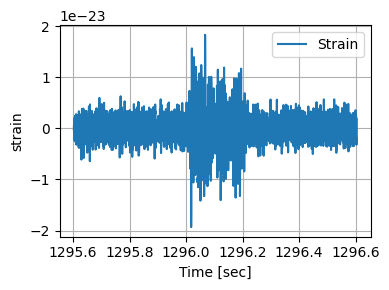

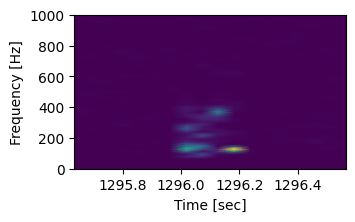

****************************************************************
Window sample No. 162
----------------------
Waveform SNR:  39.65747637118036
Injection location:  1304.0
Window initial time (in seconds):  1303.603271484375
Window end time (in seconds):  1304.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



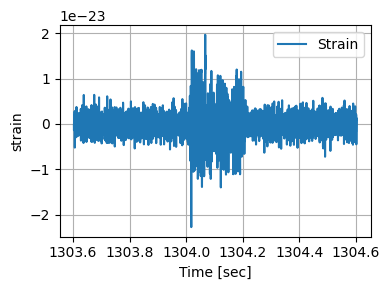

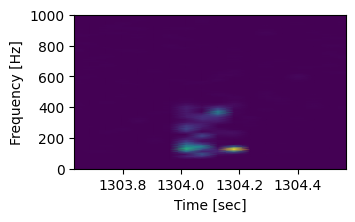

****************************************************************
Window sample No. 163
----------------------
Waveform SNR:  40.18286623212489
Injection location:  1312.0
Window initial time (in seconds):  1311.603271484375
Window end time (in seconds):  1312.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



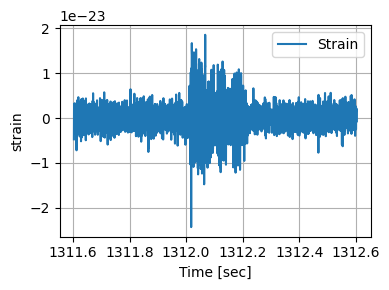

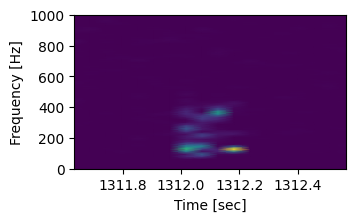

****************************************************************
Window sample No. 164
----------------------
Waveform SNR:  35.74698773457972
Injection location:  1320.0
Window initial time (in seconds):  1319.603271484375
Window end time (in seconds):  1320.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



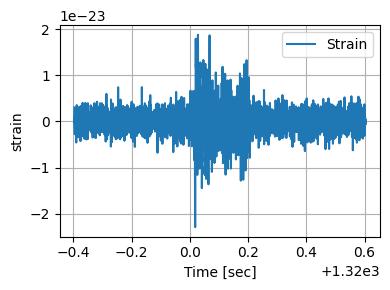

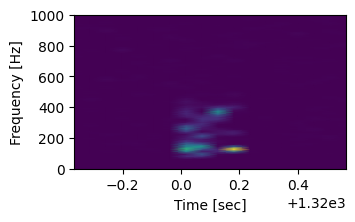

****************************************************************
Window sample No. 165
----------------------
Waveform SNR:  38.86368571964738
Injection location:  1328.0
Window initial time (in seconds):  1327.603271484375
Window end time (in seconds):  1328.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



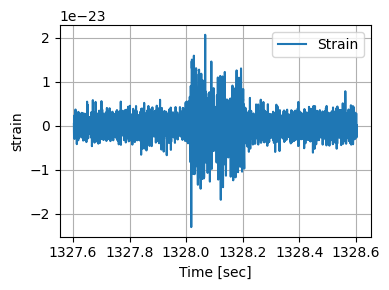

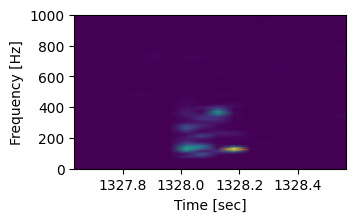

****************************************************************
Window sample No. 166
----------------------
Waveform SNR:  36.13615216068604
Injection location:  1336.0
Window initial time (in seconds):  1335.603271484375
Window end time (in seconds):  1336.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



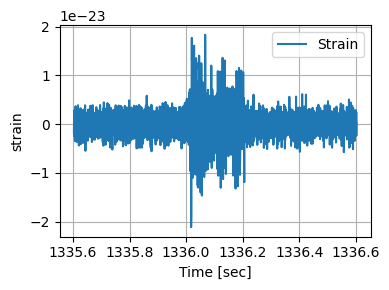

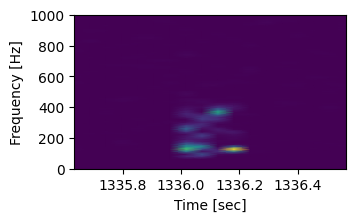

****************************************************************
Window sample No. 167
----------------------
Waveform SNR:  35.12448292281777
Injection location:  1344.0
Window initial time (in seconds):  1343.603271484375
Window end time (in seconds):  1344.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



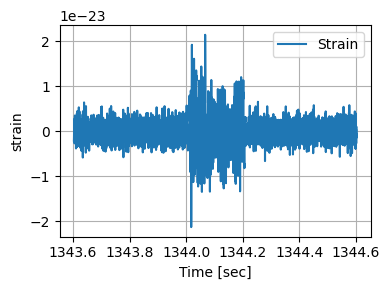

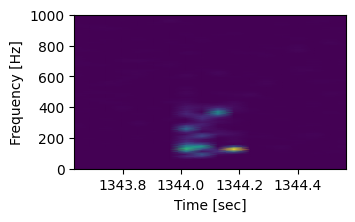

****************************************************************
Window sample No. 168
----------------------
Waveform SNR:  35.39080547371337
Injection location:  1352.0
Window initial time (in seconds):  1351.603271484375
Window end time (in seconds):  1352.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



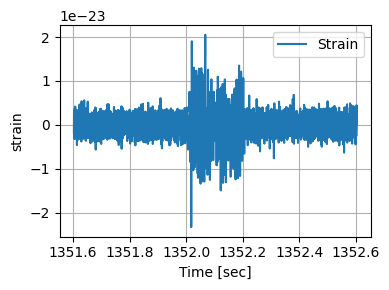

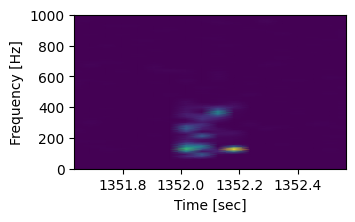

****************************************************************
Window sample No. 169
----------------------
Waveform SNR:  35.11489849466122
Injection location:  1360.0
Window initial time (in seconds):  1359.603271484375
Window end time (in seconds):  1360.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



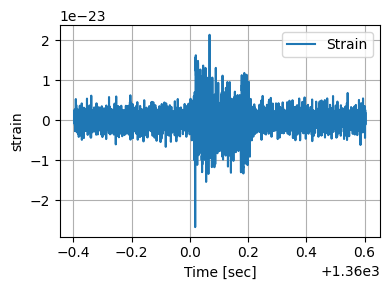

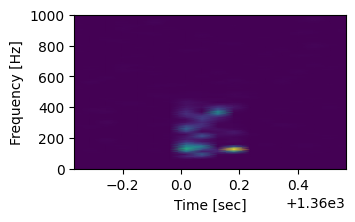

****************************************************************
Window sample No. 170
----------------------
Waveform SNR:  44.45639237252301
Injection location:  1368.0
Window initial time (in seconds):  1367.603271484375
Window end time (in seconds):  1368.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



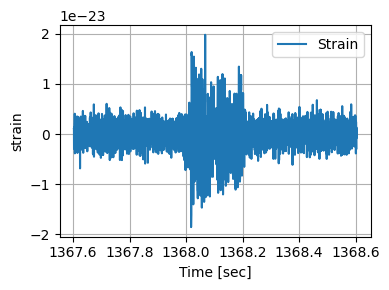

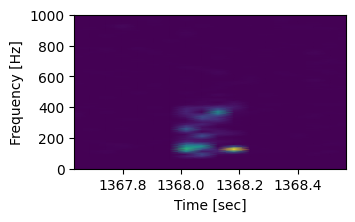

****************************************************************
Window sample No. 171
----------------------
Waveform SNR:  39.50078172810343
Injection location:  1376.0
Window initial time (in seconds):  1375.603271484375
Window end time (in seconds):  1376.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



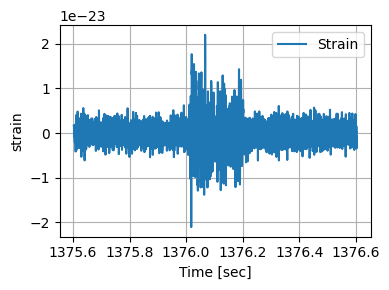

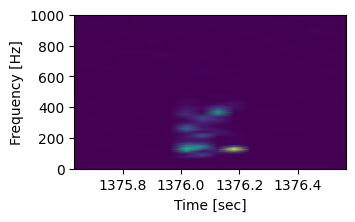

****************************************************************
Window sample No. 172
----------------------
Waveform SNR:  41.0468067293985
Injection location:  1384.0
Window initial time (in seconds):  1383.603271484375
Window end time (in seconds):  1384.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



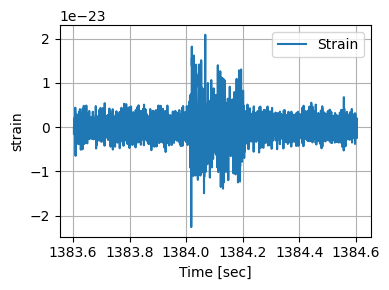

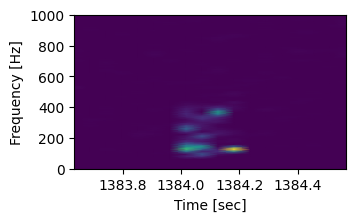

****************************************************************
Window sample No. 173
----------------------
Waveform SNR:  41.54923230890848
Injection location:  1392.0
Window initial time (in seconds):  1391.603271484375
Window end time (in seconds):  1392.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



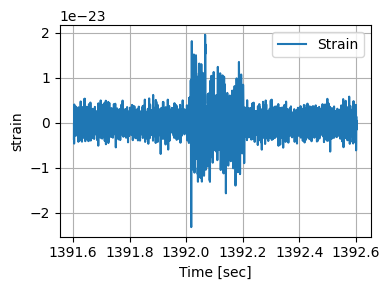

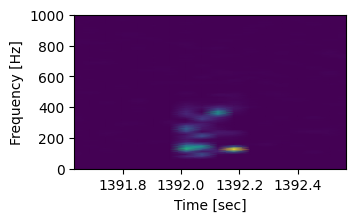

****************************************************************
Window sample No. 174
----------------------
Waveform SNR:  39.48451633819514
Injection location:  1400.0
Window initial time (in seconds):  1399.603271484375
Window end time (in seconds):  1400.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



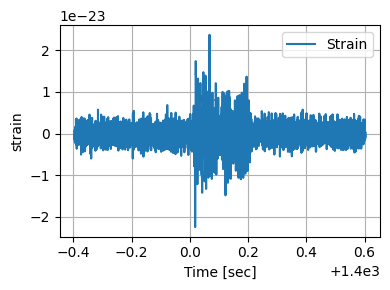

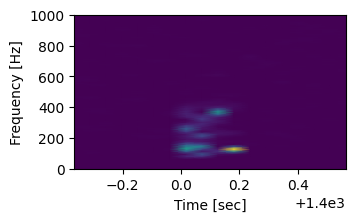

****************************************************************
Window sample No. 175
----------------------
Waveform SNR:  40.32215799656314
Injection location:  1408.0
Window initial time (in seconds):  1407.603271484375
Window end time (in seconds):  1408.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



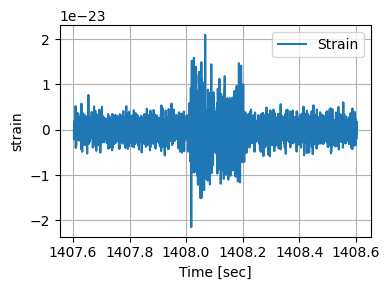

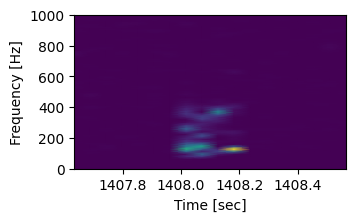

****************************************************************
Window sample No. 176
----------------------
Waveform SNR:  42.130178191421585
Injection location:  1416.0
Window initial time (in seconds):  1415.603271484375
Window end time (in seconds):  1416.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



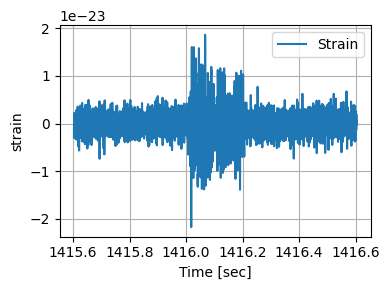

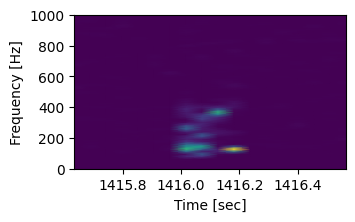

****************************************************************
Window sample No. 177
----------------------
Waveform SNR:  40.99436471796926
Injection location:  1424.0
Window initial time (in seconds):  1423.603271484375
Window end time (in seconds):  1424.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



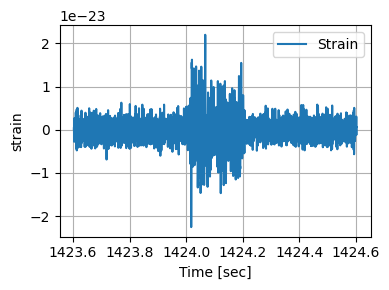

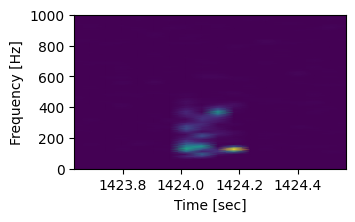

****************************************************************
Window sample No. 178
----------------------
Waveform SNR:  40.63630690227328
Injection location:  1432.0
Window initial time (in seconds):  1431.603271484375
Window end time (in seconds):  1432.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



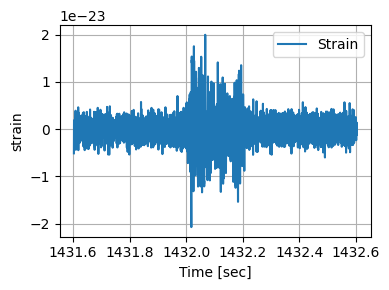

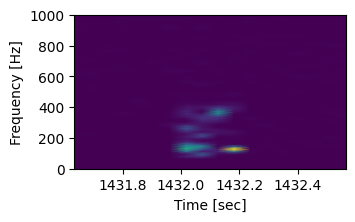

****************************************************************
Window sample No. 179
----------------------
Waveform SNR:  42.26336389614093
Injection location:  1440.0
Window initial time (in seconds):  1439.603271484375
Window end time (in seconds):  1440.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



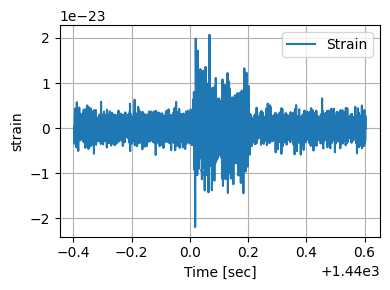

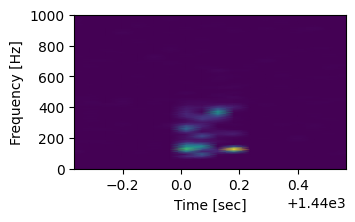

****************************************************************
Window sample No. 180
----------------------
Waveform SNR:  34.56893612140911
Injection location:  1448.0
Window initial time (in seconds):  1447.603271484375
Window end time (in seconds):  1448.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



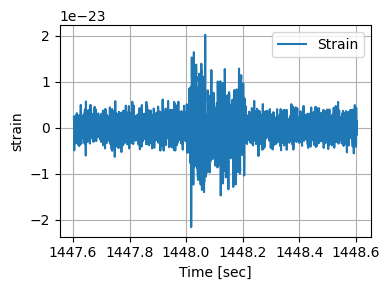

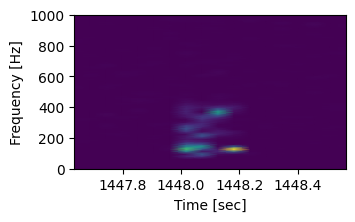

****************************************************************
Window sample No. 181
----------------------
Waveform SNR:  34.11387830841488
Injection location:  1456.0
Window initial time (in seconds):  1455.603271484375
Window end time (in seconds):  1456.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



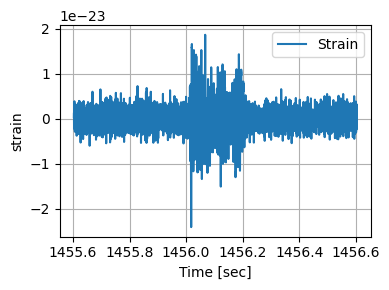

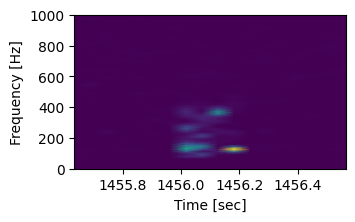

****************************************************************
Window sample No. 182
----------------------
Waveform SNR:  36.94387258932196
Injection location:  1464.0
Window initial time (in seconds):  1463.603271484375
Window end time (in seconds):  1464.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



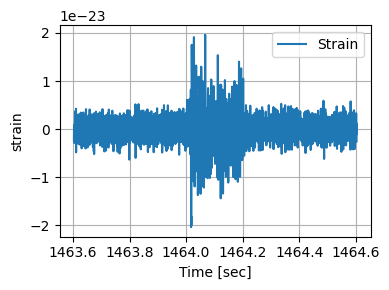

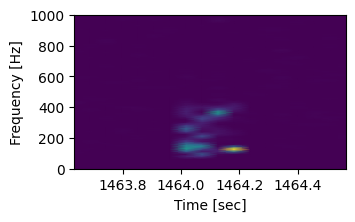

****************************************************************
Window sample No. 183
----------------------
Waveform SNR:  37.237596071691584
Injection location:  1472.0
Window initial time (in seconds):  1471.603271484375
Window end time (in seconds):  1472.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



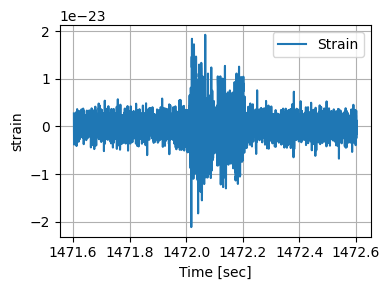

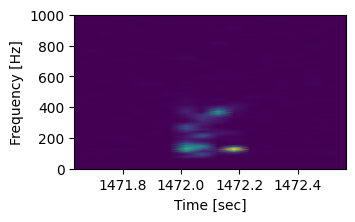

****************************************************************
Window sample No. 184
----------------------
Waveform SNR:  37.22344346288146
Injection location:  1480.0
Window initial time (in seconds):  1479.603271484375
Window end time (in seconds):  1480.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



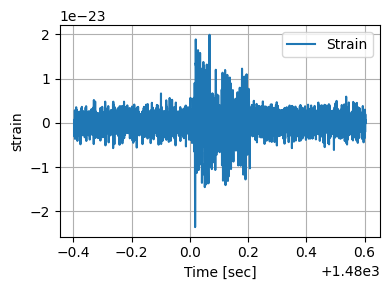

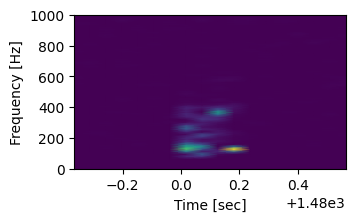

****************************************************************
Window sample No. 185
----------------------
Waveform SNR:  41.90846562315612
Injection location:  1488.0
Window initial time (in seconds):  1487.603271484375
Window end time (in seconds):  1488.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



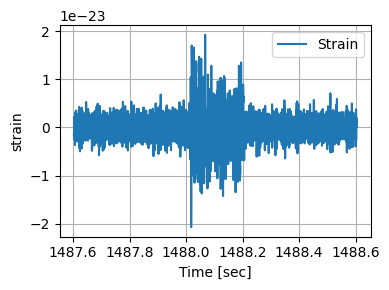

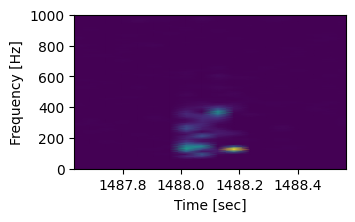

****************************************************************
Window sample No. 186
----------------------
Waveform SNR:  323.22889847095854
Injection location:  1496.0
Window initial time (in seconds):  1495.603271484375
Window end time (in seconds):  1496.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



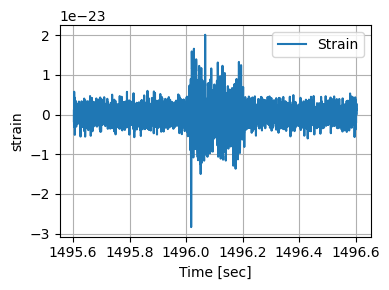

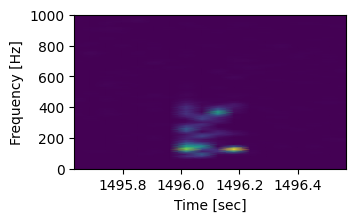

****************************************************************
Window sample No. 187
----------------------
Waveform SNR:  37.864895242182
Injection location:  1504.0
Window initial time (in seconds):  1503.603271484375
Window end time (in seconds):  1504.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



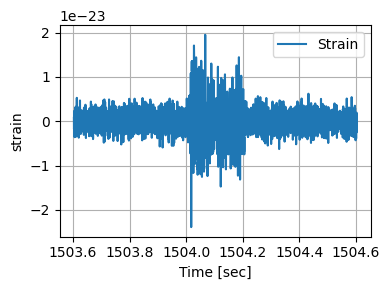

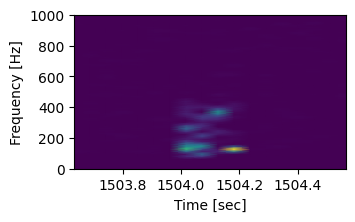

****************************************************************
Window sample No. 188
----------------------
Waveform SNR:  42.79931930004435
Injection location:  1512.0
Window initial time (in seconds):  1511.603271484375
Window end time (in seconds):  1512.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



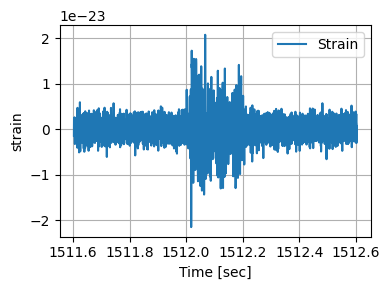

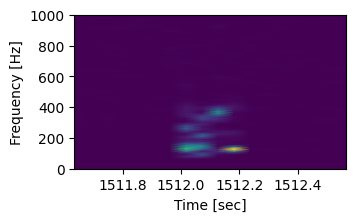

****************************************************************
Window sample No. 189
----------------------
Waveform SNR:  116.29231478467916
Injection location:  1520.0
Window initial time (in seconds):  1519.603271484375
Window end time (in seconds):  1520.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



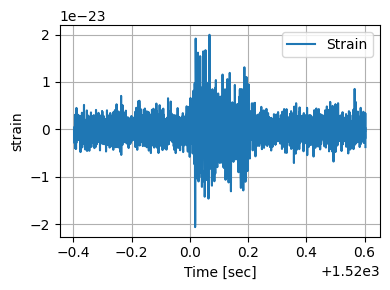

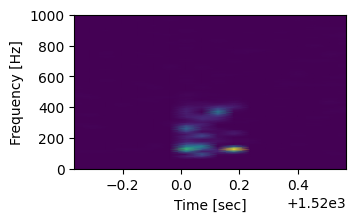

****************************************************************
Window sample No. 190
----------------------
Waveform SNR:  38.6348657422491
Injection location:  1528.0
Window initial time (in seconds):  1527.603271484375
Window end time (in seconds):  1528.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



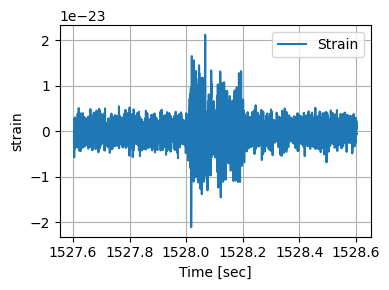

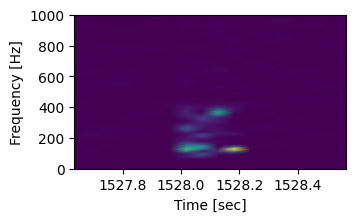

****************************************************************
Window sample No. 191
----------------------
Waveform SNR:  41.95504942526621
Injection location:  1536.0
Window initial time (in seconds):  1535.603271484375
Window end time (in seconds):  1536.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



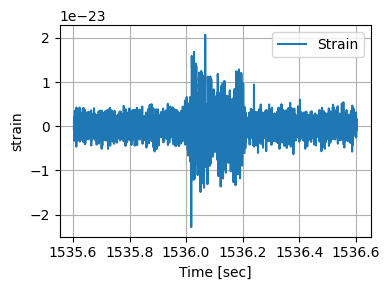

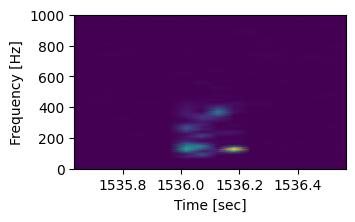

****************************************************************
Window sample No. 192
----------------------
Waveform SNR:  49.33384973214202
Injection location:  1544.0
Window initial time (in seconds):  1543.603271484375
Window end time (in seconds):  1544.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



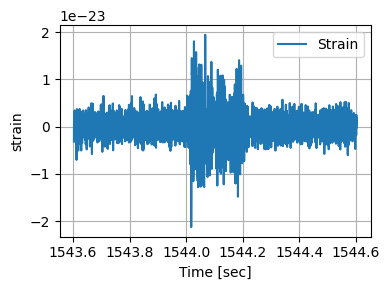

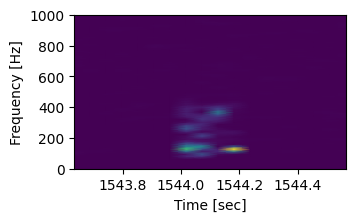

****************************************************************
Window sample No. 193
----------------------
Waveform SNR:  41.70885376452781
Injection location:  1552.0
Window initial time (in seconds):  1551.603271484375
Window end time (in seconds):  1552.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



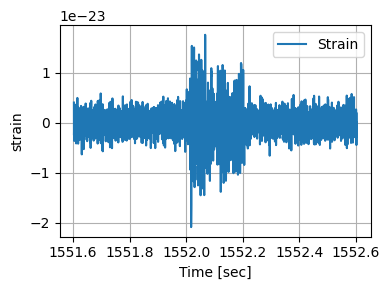

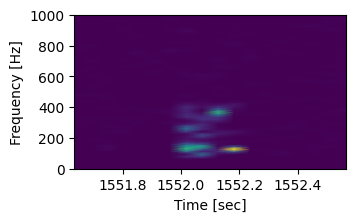

****************************************************************
Window sample No. 194
----------------------
Waveform SNR:  50.18867733379929
Injection location:  1560.0
Window initial time (in seconds):  1559.603271484375
Window end time (in seconds):  1560.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



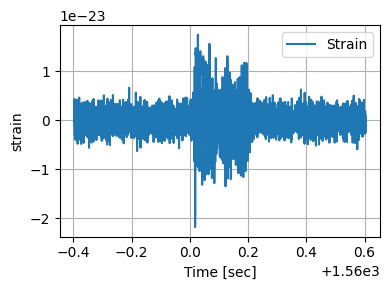

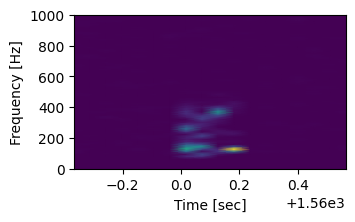

****************************************************************
Window sample No. 195
----------------------
Waveform SNR:  45.497903160607315
Injection location:  1568.0
Window initial time (in seconds):  1567.603271484375
Window end time (in seconds):  1568.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



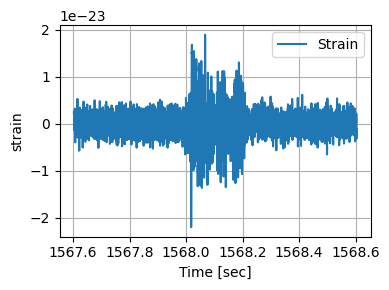

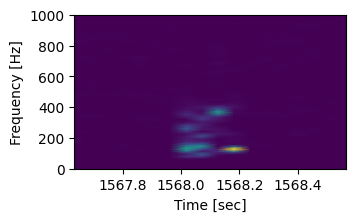

****************************************************************
Window sample No. 196
----------------------
Waveform SNR:  62.25107803053782
Injection location:  1576.0
Window initial time (in seconds):  1575.603271484375
Window end time (in seconds):  1576.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



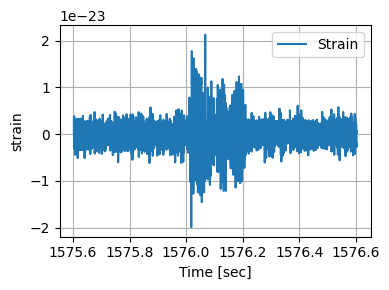

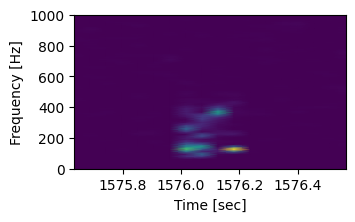

****************************************************************
Window sample No. 197
----------------------
Waveform SNR:  67.1519348543479
Injection location:  1584.0
Window initial time (in seconds):  1583.603271484375
Window end time (in seconds):  1584.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



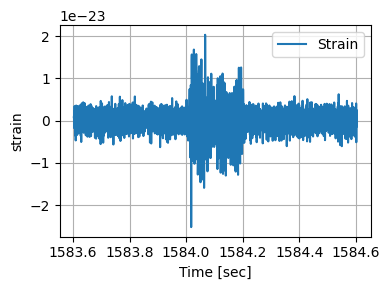

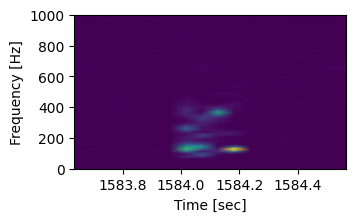

****************************************************************
Window sample No. 198
----------------------
Waveform SNR:  36.22107815927043
Injection location:  1592.0
Window initial time (in seconds):  1591.603271484375
Window end time (in seconds):  1592.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



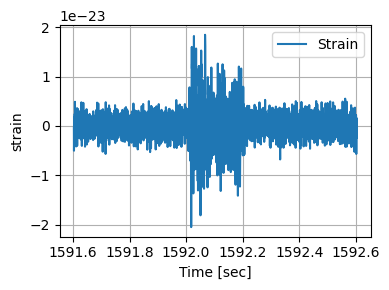

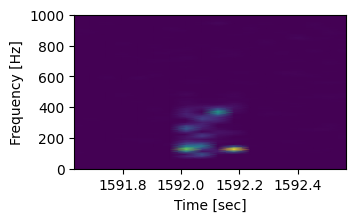

****************************************************************
Window sample No. 199
----------------------
Waveform SNR:  41.03592236232933
Injection location:  1600.0
Window initial time (in seconds):  1599.603271484375
Window end time (in seconds):  1600.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



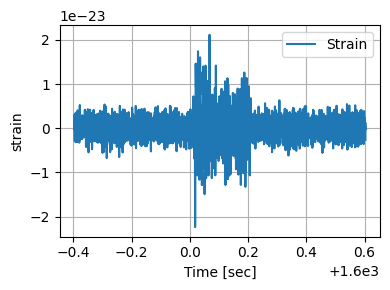

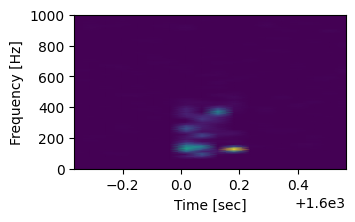

****************************************************************
Window sample No. 200
----------------------
Waveform SNR:  40.03545555115891
Injection location:  1608.0
Window initial time (in seconds):  1607.603271484375
Window end time (in seconds):  1608.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



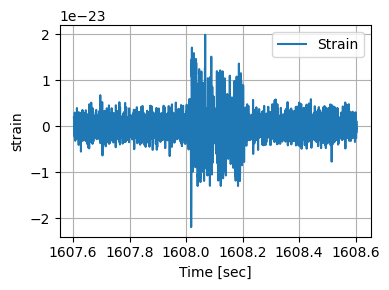

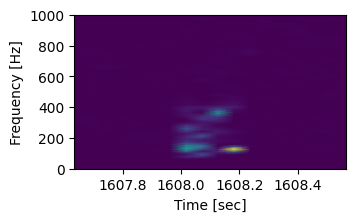

****************************************************************
Window sample No. 201
----------------------
Waveform SNR:  35.73578281436829
Injection location:  1616.0
Window initial time (in seconds):  1615.603271484375
Window end time (in seconds):  1616.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



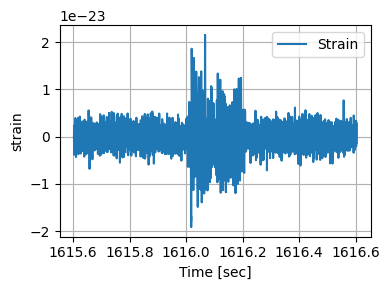

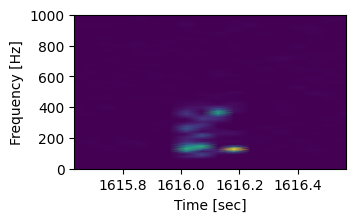

****************************************************************
Window sample No. 202
----------------------
Waveform SNR:  39.075125949826834
Injection location:  1624.0
Window initial time (in seconds):  1623.603271484375
Window end time (in seconds):  1624.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



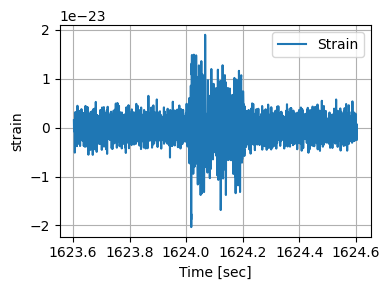

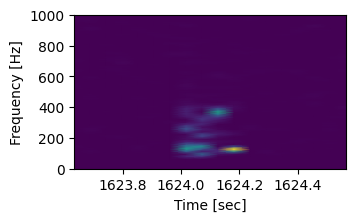

****************************************************************
Window sample No. 203
----------------------
Waveform SNR:  43.636809002192294
Injection location:  1632.0
Window initial time (in seconds):  1631.603271484375
Window end time (in seconds):  1632.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



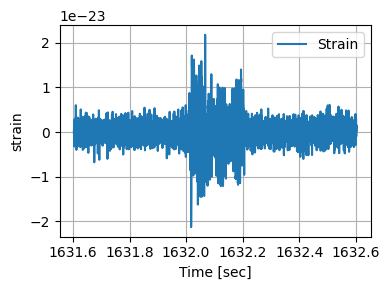

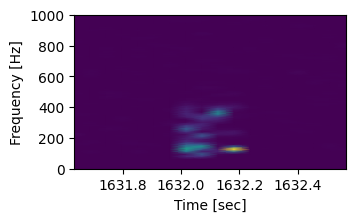

****************************************************************
Window sample No. 204
----------------------
Waveform SNR:  35.02597596990816
Injection location:  1640.0
Window initial time (in seconds):  1639.603271484375
Window end time (in seconds):  1640.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



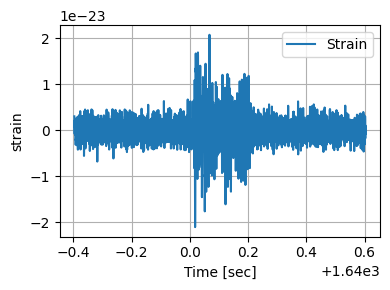

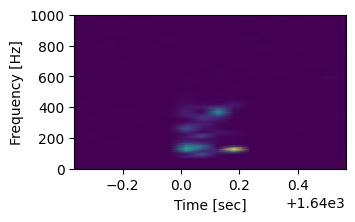

****************************************************************
Window sample No. 205
----------------------
Waveform SNR:  60.54134818791232
Injection location:  1648.0
Window initial time (in seconds):  1647.603271484375
Window end time (in seconds):  1648.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



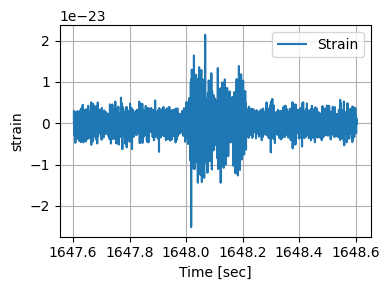

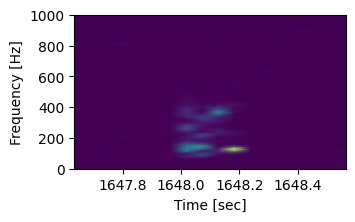

****************************************************************
Window sample No. 206
----------------------
Waveform SNR:  31.98592687173918
Injection location:  1656.0
Window initial time (in seconds):  1655.603271484375
Window end time (in seconds):  1656.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



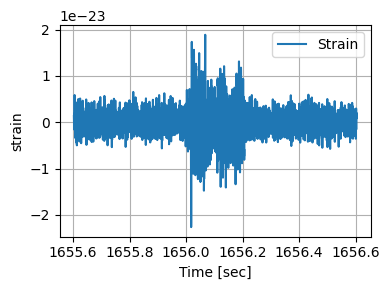

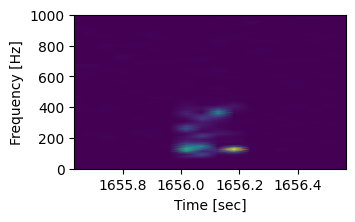

****************************************************************
Window sample No. 207
----------------------
Waveform SNR:  40.6103180258094
Injection location:  1664.0
Window initial time (in seconds):  1663.603271484375
Window end time (in seconds):  1664.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



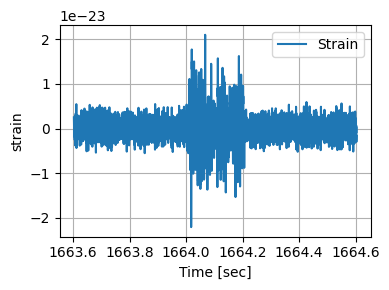

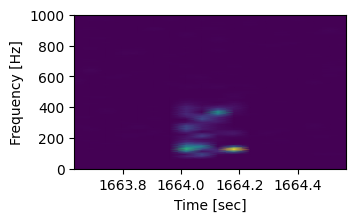

****************************************************************
Window sample No. 208
----------------------
Waveform SNR:  35.21765960266819
Injection location:  1672.0
Window initial time (in seconds):  1671.603271484375
Window end time (in seconds):  1672.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



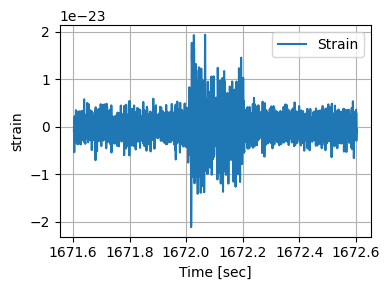

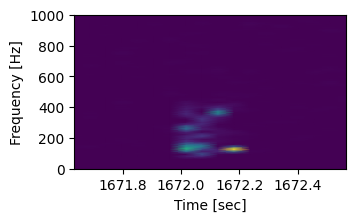

****************************************************************
Window sample No. 209
----------------------
Waveform SNR:  49.939655766478786
Injection location:  1680.0
Window initial time (in seconds):  1679.603271484375
Window end time (in seconds):  1680.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



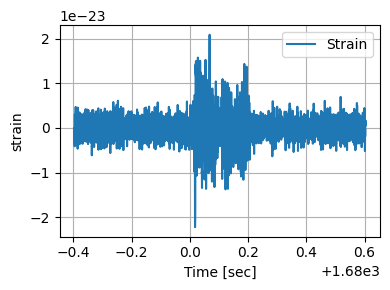

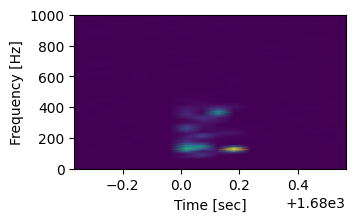

****************************************************************
Window sample No. 210
----------------------
Waveform SNR:  35.616925797716796
Injection location:  1688.0
Window initial time (in seconds):  1687.603271484375
Window end time (in seconds):  1688.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



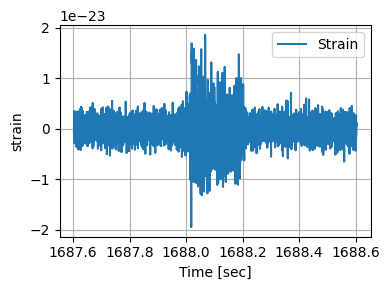

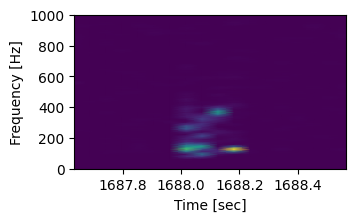

****************************************************************
Window sample No. 211
----------------------
Waveform SNR:  37.234705809882946
Injection location:  1696.0
Window initial time (in seconds):  1695.603271484375
Window end time (in seconds):  1696.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



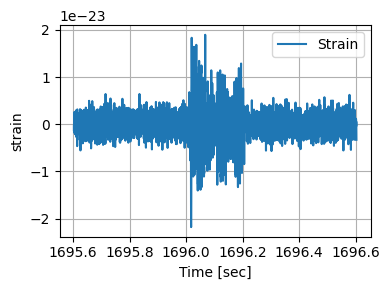

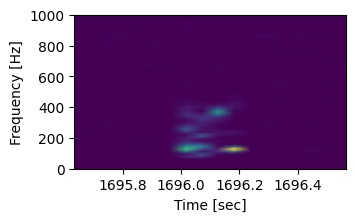

****************************************************************
Window sample No. 212
----------------------
Waveform SNR:  55.27228403613035
Injection location:  1704.0
Window initial time (in seconds):  1703.603271484375
Window end time (in seconds):  1704.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



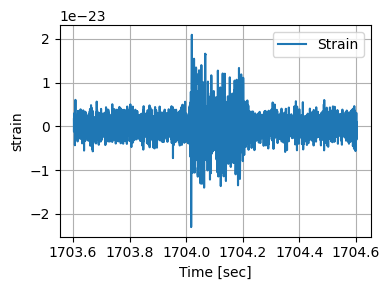

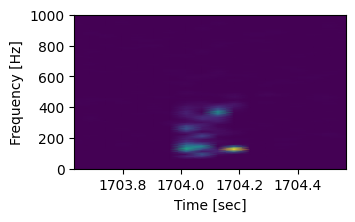

****************************************************************
Window sample No. 213
----------------------
Waveform SNR:  38.257132468041064
Injection location:  1712.0
Window initial time (in seconds):  1711.603271484375
Window end time (in seconds):  1712.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



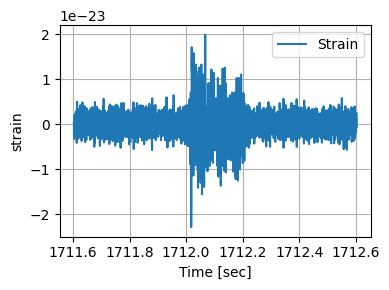

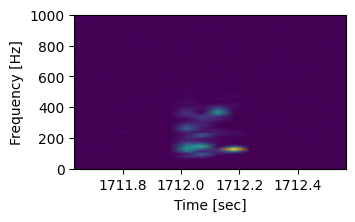

****************************************************************
Window sample No. 214
----------------------
Waveform SNR:  36.0155317978528
Injection location:  1720.0
Window initial time (in seconds):  1719.603271484375
Window end time (in seconds):  1720.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



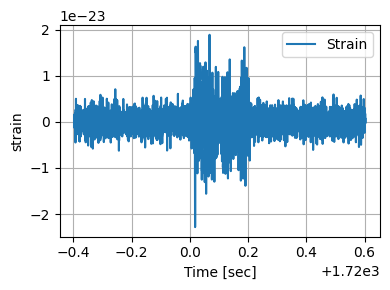

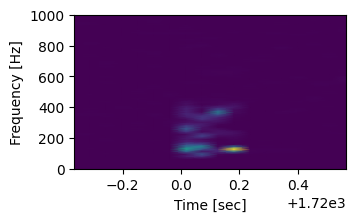

****************************************************************
Window sample No. 215
----------------------
Waveform SNR:  36.47742055397152
Injection location:  1728.0
Window initial time (in seconds):  1727.603271484375
Window end time (in seconds):  1728.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



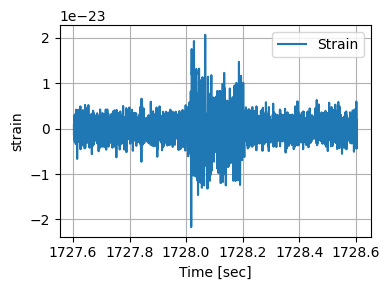

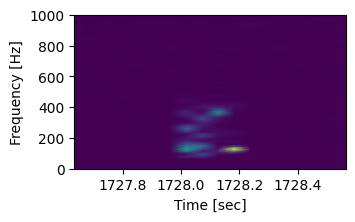

****************************************************************
Window sample No. 216
----------------------
Waveform SNR:  33.83998719987796
Injection location:  1736.0
Window initial time (in seconds):  1735.603271484375
Window end time (in seconds):  1736.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



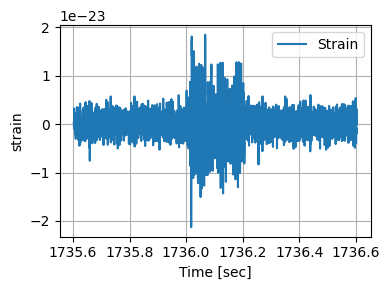

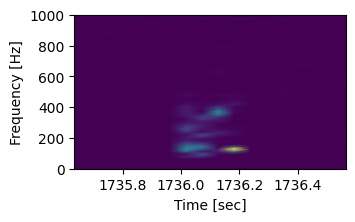

****************************************************************
Window sample No. 217
----------------------
Waveform SNR:  39.17379636847722
Injection location:  1744.0
Window initial time (in seconds):  1743.603271484375
Window end time (in seconds):  1744.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



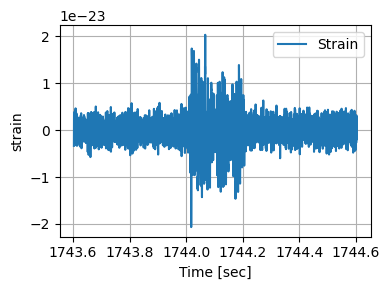

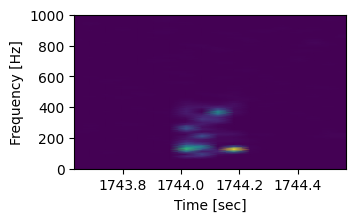

****************************************************************
Window sample No. 218
----------------------
Waveform SNR:  38.03482938307045
Injection location:  1752.0
Window initial time (in seconds):  1751.603271484375
Window end time (in seconds):  1752.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



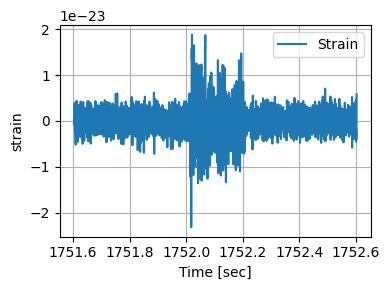

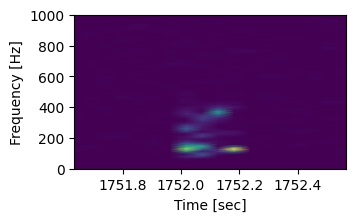

****************************************************************
Window sample No. 219
----------------------
Waveform SNR:  37.10665486936605
Injection location:  1760.0
Window initial time (in seconds):  1759.603271484375
Window end time (in seconds):  1760.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



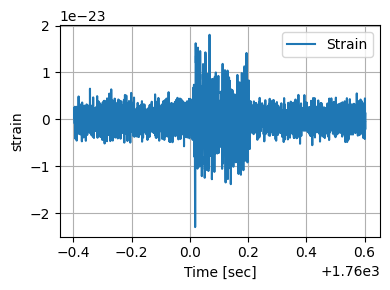

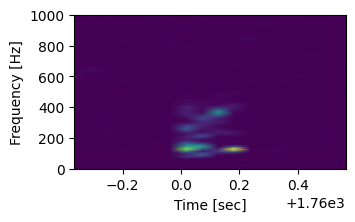

****************************************************************
Window sample No. 220
----------------------
Waveform SNR:  37.581716532435124
Injection location:  1768.0
Window initial time (in seconds):  1767.603271484375
Window end time (in seconds):  1768.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



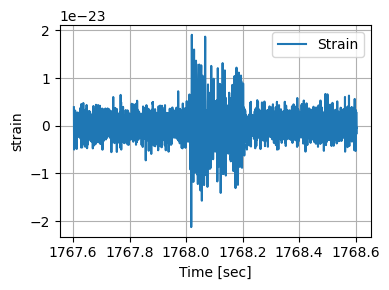

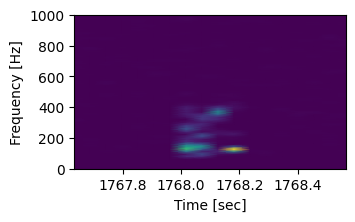

****************************************************************
Window sample No. 221
----------------------
Waveform SNR:  39.0523820471563
Injection location:  1776.0
Window initial time (in seconds):  1775.603271484375
Window end time (in seconds):  1776.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



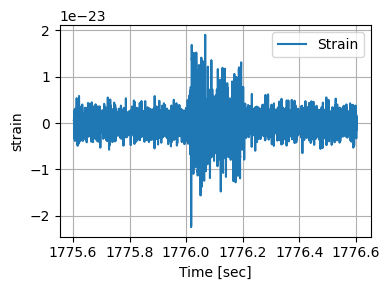

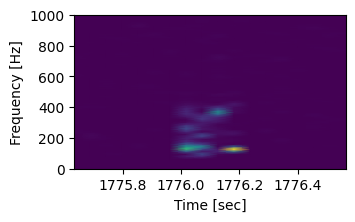

****************************************************************
Window sample No. 222
----------------------
Waveform SNR:  35.18091502807137
Injection location:  1784.0
Window initial time (in seconds):  1783.603271484375
Window end time (in seconds):  1784.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



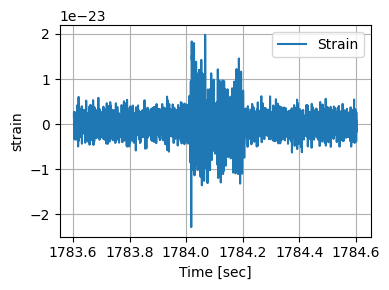

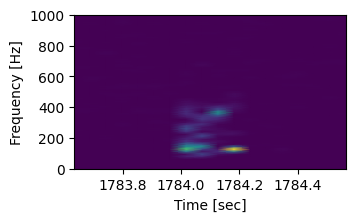

****************************************************************
Window sample No. 223
----------------------
Waveform SNR:  40.41909148071497
Injection location:  1792.0
Window initial time (in seconds):  1791.603271484375
Window end time (in seconds):  1792.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



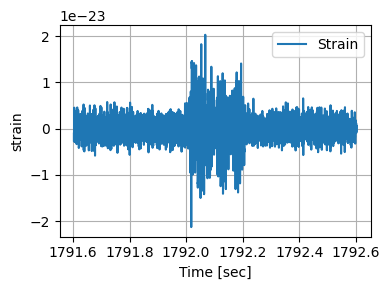

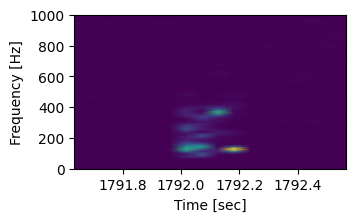

****************************************************************
Window sample No. 224
----------------------
Waveform SNR:  37.002241040885224
Injection location:  1800.0
Window initial time (in seconds):  1799.603271484375
Window end time (in seconds):  1800.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



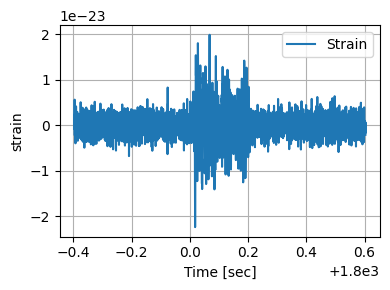

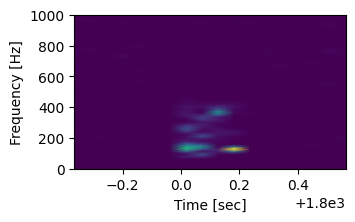

****************************************************************
Window sample No. 225
----------------------
Waveform SNR:  37.400409168434045
Injection location:  1808.0
Window initial time (in seconds):  1807.603271484375
Window end time (in seconds):  1808.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



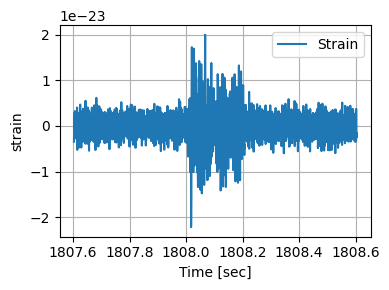

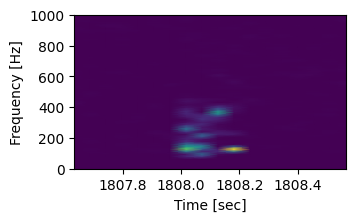

****************************************************************
Window sample No. 226
----------------------
Waveform SNR:  38.56273497212846
Injection location:  1816.0
Window initial time (in seconds):  1815.603271484375
Window end time (in seconds):  1816.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



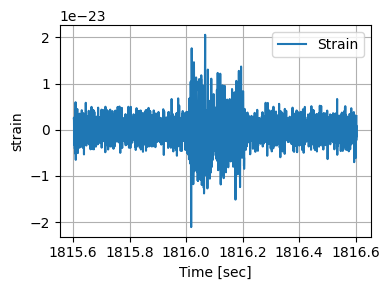

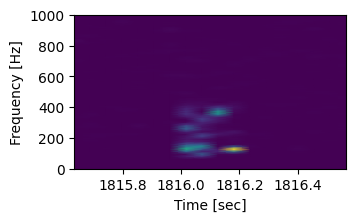

****************************************************************
Window sample No. 227
----------------------
Waveform SNR:  38.75465472014421
Injection location:  1824.0
Window initial time (in seconds):  1823.603271484375
Window end time (in seconds):  1824.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



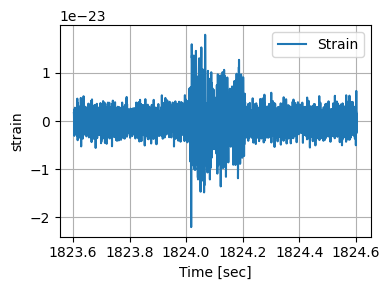

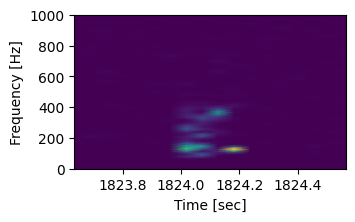

****************************************************************
Window sample No. 228
----------------------
Waveform SNR:  36.25127926144131
Injection location:  1832.0
Window initial time (in seconds):  1831.603271484375
Window end time (in seconds):  1832.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



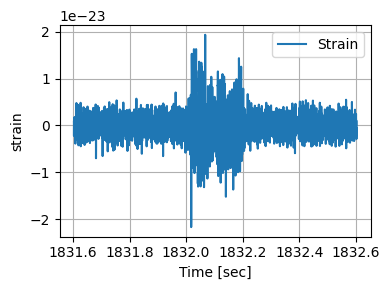

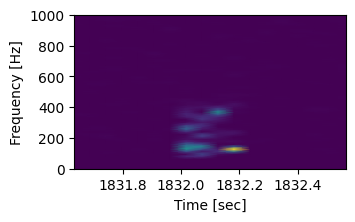

****************************************************************
Window sample No. 229
----------------------
Waveform SNR:  36.28830518328642
Injection location:  1840.0
Window initial time (in seconds):  1839.603271484375
Window end time (in seconds):  1840.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



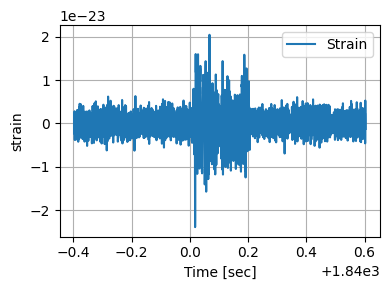

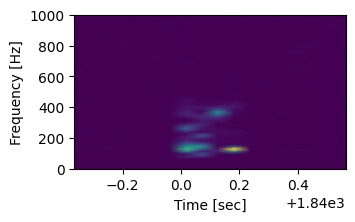

****************************************************************
Window sample No. 230
----------------------
Waveform SNR:  37.79142271702655
Injection location:  1848.0
Window initial time (in seconds):  1847.603271484375
Window end time (in seconds):  1848.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



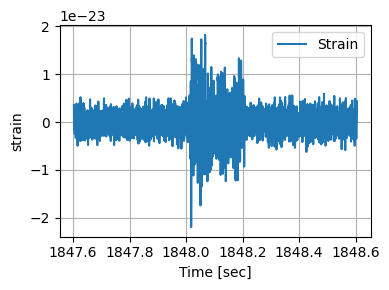

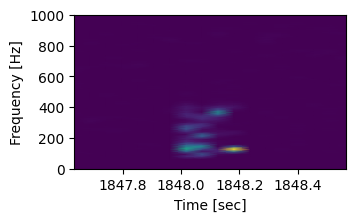

****************************************************************
Window sample No. 231
----------------------
Waveform SNR:  36.28415186606973
Injection location:  1856.0
Window initial time (in seconds):  1855.603271484375
Window end time (in seconds):  1856.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



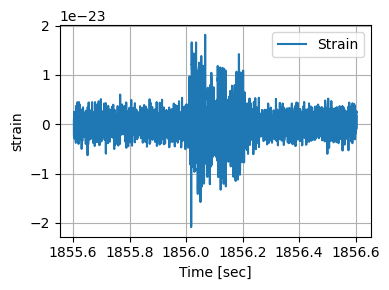

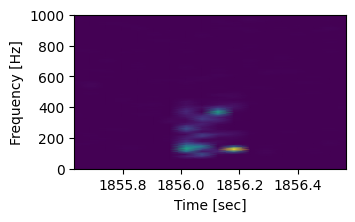

****************************************************************
Window sample No. 232
----------------------
Waveform SNR:  39.00429372708463
Injection location:  1864.0
Window initial time (in seconds):  1863.603271484375
Window end time (in seconds):  1864.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



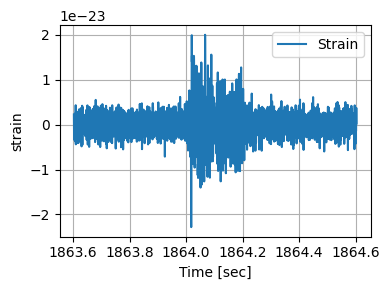

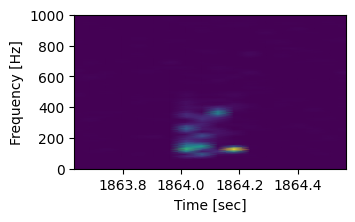

****************************************************************
Window sample No. 233
----------------------
Waveform SNR:  47.01941244996801
Injection location:  1872.0
Window initial time (in seconds):  1871.603271484375
Window end time (in seconds):  1872.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



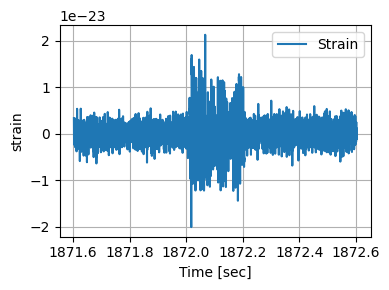

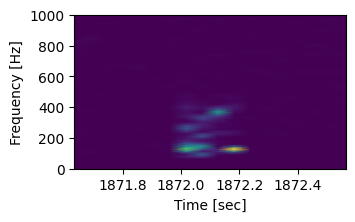

****************************************************************
Window sample No. 234
----------------------
Waveform SNR:  40.834791486074664
Injection location:  1880.0
Window initial time (in seconds):  1879.603271484375
Window end time (in seconds):  1880.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



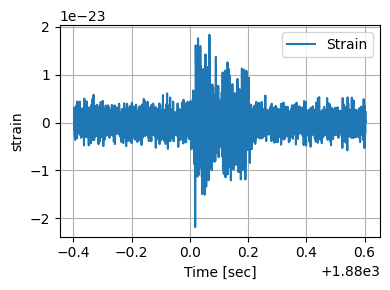

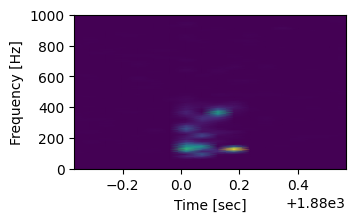

****************************************************************
Window sample No. 235
----------------------
Waveform SNR:  37.630768777636874
Injection location:  1888.0
Window initial time (in seconds):  1887.603271484375
Window end time (in seconds):  1888.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



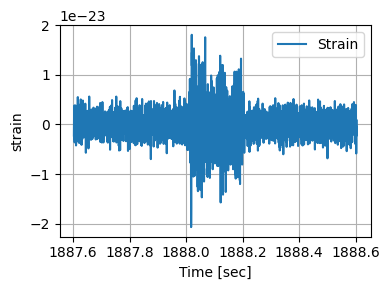

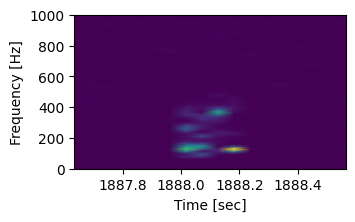

****************************************************************
Window sample No. 236
----------------------
Waveform SNR:  37.241070644028355
Injection location:  1896.0
Window initial time (in seconds):  1895.603271484375
Window end time (in seconds):  1896.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



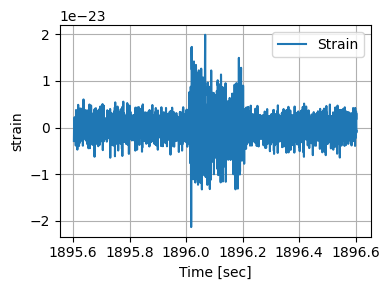

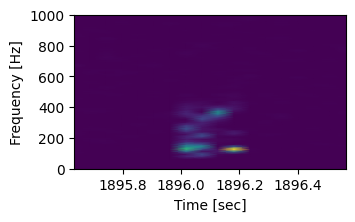

****************************************************************
Window sample No. 237
----------------------
Waveform SNR:  40.07257716613206
Injection location:  1904.0
Window initial time (in seconds):  1903.603271484375
Window end time (in seconds):  1904.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



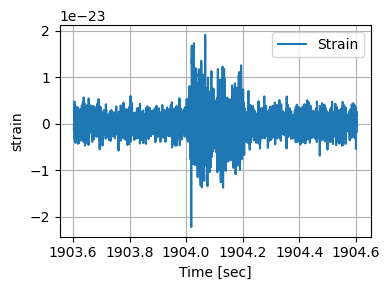

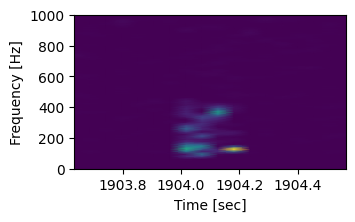

****************************************************************
Window sample No. 238
----------------------
Waveform SNR:  38.48935051822883
Injection location:  1912.0
Window initial time (in seconds):  1911.603271484375
Window end time (in seconds):  1912.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



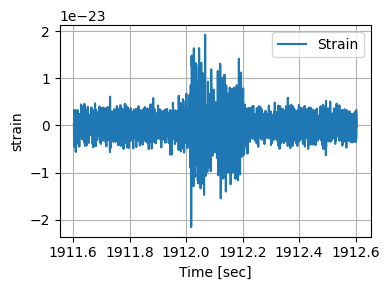

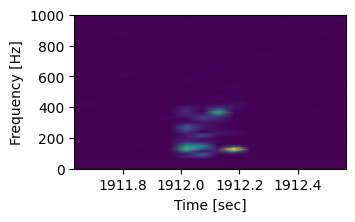

****************************************************************
Window sample No. 239
----------------------
Waveform SNR:  36.59142021451111
Injection location:  1920.0
Window initial time (in seconds):  1919.603271484375
Window end time (in seconds):  1920.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



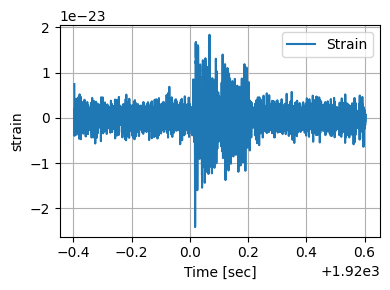

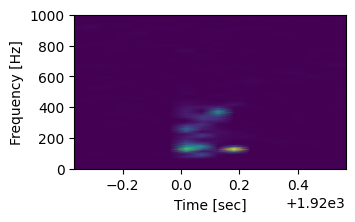

****************************************************************
Window sample No. 240
----------------------
Waveform SNR:  41.074378642713114
Injection location:  1928.0
Window initial time (in seconds):  1927.603271484375
Window end time (in seconds):  1928.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



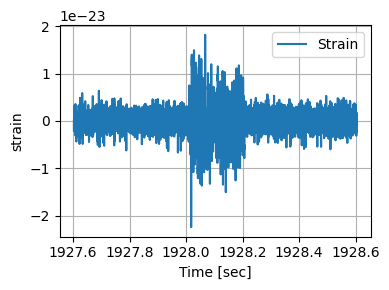

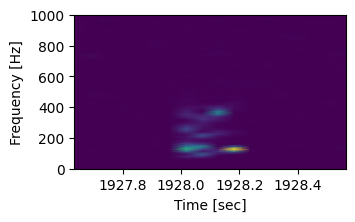

****************************************************************
Window sample No. 241
----------------------
Waveform SNR:  37.98656280159185
Injection location:  1936.0
Window initial time (in seconds):  1935.603271484375
Window end time (in seconds):  1936.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



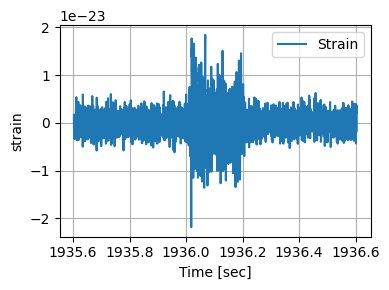

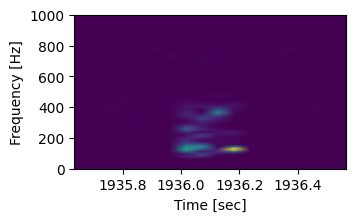

****************************************************************
Window sample No. 242
----------------------
Waveform SNR:  39.7178691882142
Injection location:  1944.0
Window initial time (in seconds):  1943.603271484375
Window end time (in seconds):  1944.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



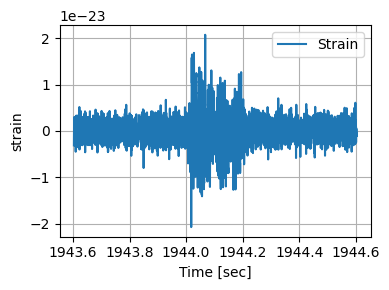

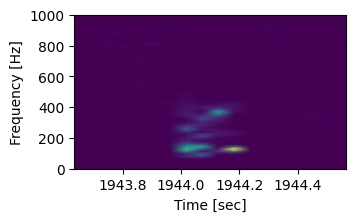

****************************************************************
Window sample No. 243
----------------------
Waveform SNR:  34.9771565349919
Injection location:  1952.0
Window initial time (in seconds):  1951.603271484375
Window end time (in seconds):  1952.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



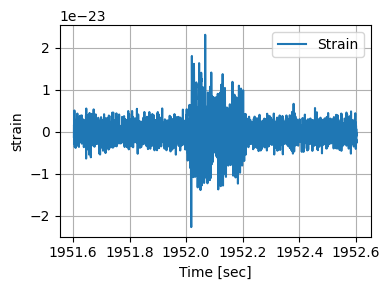

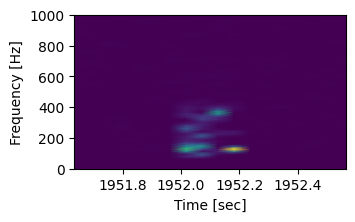

****************************************************************
Window sample No. 244
----------------------
Waveform SNR:  37.75848847066569
Injection location:  1960.0
Window initial time (in seconds):  1959.603271484375
Window end time (in seconds):  1960.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



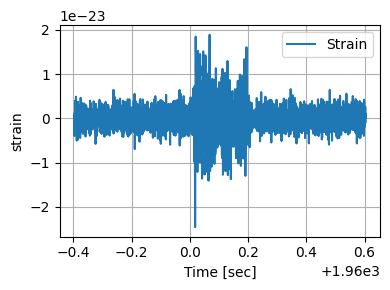

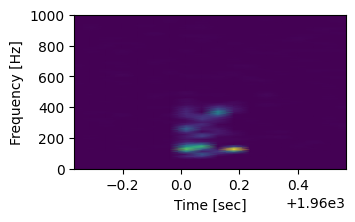

****************************************************************
Window sample No. 245
----------------------
Waveform SNR:  38.978263058943355
Injection location:  1968.0
Window initial time (in seconds):  1967.603271484375
Window end time (in seconds):  1968.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



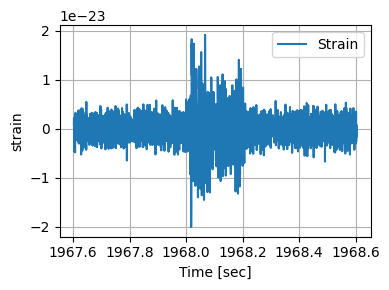

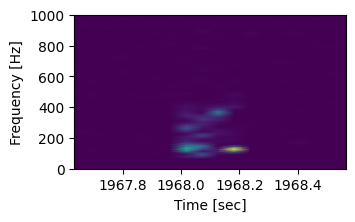

****************************************************************
Window sample No. 246
----------------------
Waveform SNR:  40.91393155104614
Injection location:  1976.0
Window initial time (in seconds):  1975.603271484375
Window end time (in seconds):  1976.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



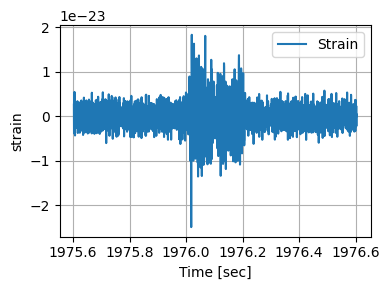

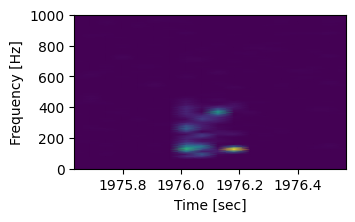

****************************************************************
Window sample No. 247
----------------------
Waveform SNR:  37.38998652350007
Injection location:  1984.0
Window initial time (in seconds):  1983.603271484375
Window end time (in seconds):  1984.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



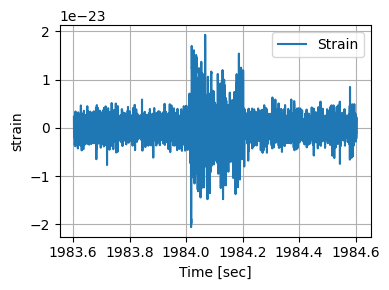

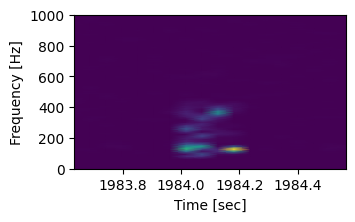

****************************************************************
Window sample No. 248
----------------------
Waveform SNR:  44.44808731974819
Injection location:  1992.0
Window initial time (in seconds):  1991.603271484375
Window end time (in seconds):  1992.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



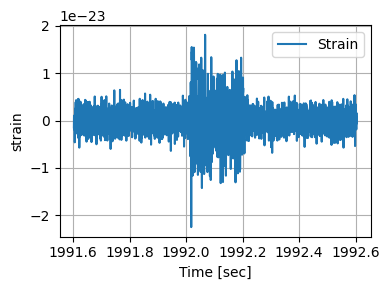

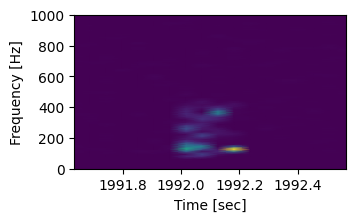

****************************************************************
Window sample No. 249
----------------------
Waveform SNR:  34.41087194185021
Injection location:  2000.0
Window initial time (in seconds):  1999.603271484375
Window end time (in seconds):  2000.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



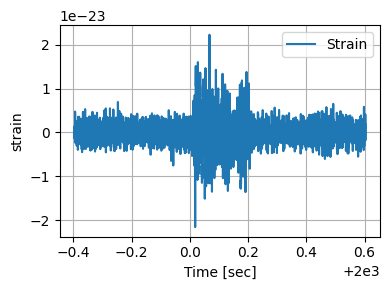

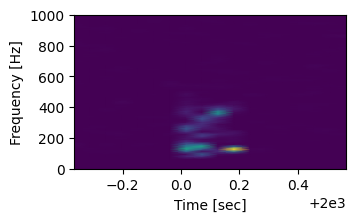

****************************************************************
Window sample No. 250
----------------------
Waveform SNR:  36.489795290557474
Injection location:  2008.0
Window initial time (in seconds):  2007.603271484375
Window end time (in seconds):  2008.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



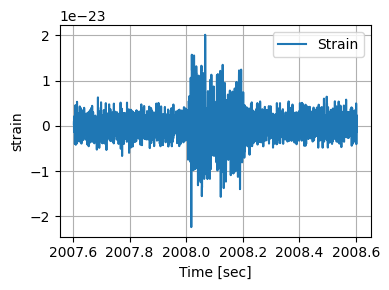

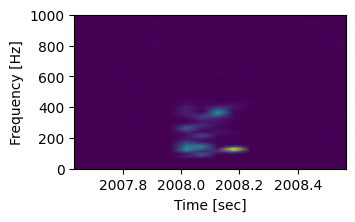

****************************************************************
Window sample No. 251
----------------------
Waveform SNR:  35.99167755005939
Injection location:  2016.0
Window initial time (in seconds):  2015.603271484375
Window end time (in seconds):  2016.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



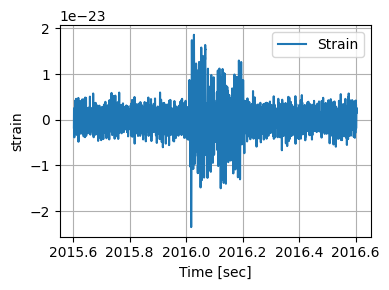

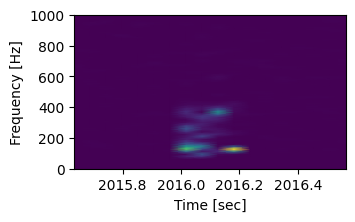

****************************************************************
Window sample No. 252
----------------------
Waveform SNR:  36.34868009163888
Injection location:  2024.0
Window initial time (in seconds):  2023.603271484375
Window end time (in seconds):  2024.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



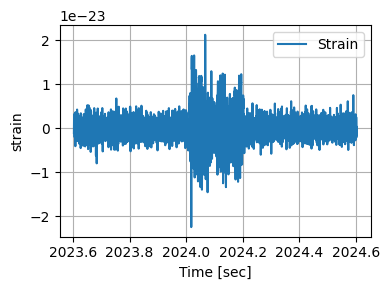

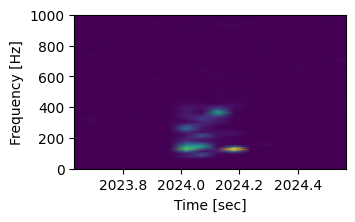

****************************************************************
Window sample No. 253
----------------------
Waveform SNR:  36.541095346877256
Injection location:  2032.0
Window initial time (in seconds):  2031.603271484375
Window end time (in seconds):  2032.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



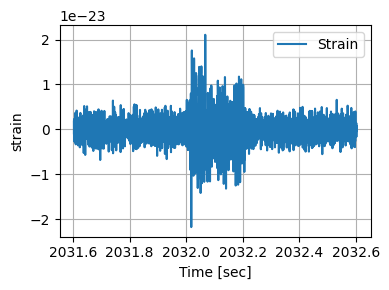

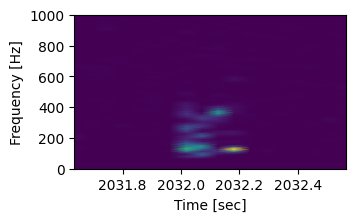

****************************************************************
Window sample No. 254
----------------------
Waveform SNR:  38.614527765306526
Injection location:  2040.0
Window initial time (in seconds):  2039.603271484375
Window end time (in seconds):  2040.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



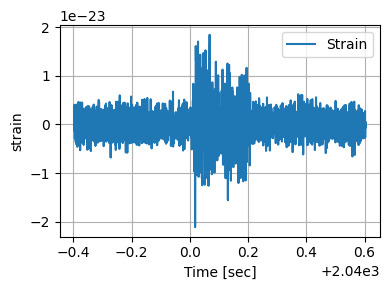

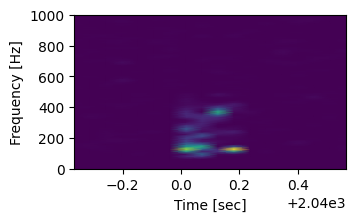

****************************************************************
Window sample No. 255
----------------------
Waveform SNR:  39.14126448024545
Injection location:  2048.0
Window initial time (in seconds):  2047.603271484375
Window end time (in seconds):  2048.60302734375
Window length (in seconds): 0.999755859375
Extracted  4095  data points



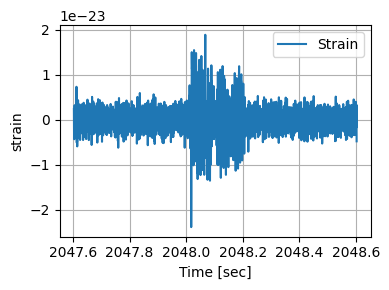

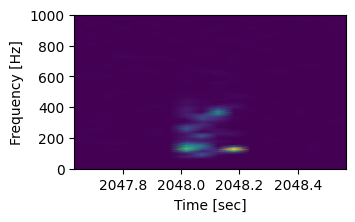

****************************************************************


In [ ]:
# ------> Generate window samples of GW+Noise

# Window for spectrograms
wnd="hamming"

# Initialize list of windows
all_windows = []

# Rename strain data
s = Sf

# FIRST LOOP, j index: window count variable
# --------------------------------------------

for j in range(len(log_data)): # Extract all windows along the strain segment
#for j in range(10): # Extract only a few windows along the strain segment

    print("Window sample No.", j)
    print("----------------------")

    window = np.zeros(int(fs*Twin))

    # SECOND LOOP, k index: Window samples count variable
    # --------------------------------------------------------

    for k in range(len(window)):

        # Extract strain data along the window
        window[k] = s[locate_win[j]+k]

    all_windows.append(window)

    print("Waveform SNR: ", log_data[j][1])
    print("Injection location: ", log_data[j][0])
    print("Window initial time (in seconds): ", time_strain_cut[locate_win[j]])
    print("Window end time (in seconds): ", time_strain_cut[locate_win[j]+k])
    print("Window length (in seconds):", time_strain_cut[locate_win[j]+k]-time_strain_cut[locate_win[j]])
    print("Extracted ", k, " data points")

    # CHECK: To ensure injection location is inside window sample

    if log_data[j][0] < time_strain_cut[locate_win[j]]:
        print("!!!!!!!!!!!!!!!!! ERROR : t_injection is before the sample window")

    elif j < len(log_data)-1:
        if log_data[j][0] > time_strain_cut[locate_win[j+1]]:
            print("!!!!!!!!!!!!!!!!! ERROR : t_injection is after the sample window ")

    print("")

    # Plot the window sample (strain)

    plt.figure(1, figsize=(4,3))
    #plt.plot(np.arange(0, Twin, ts), all_windows[num_win], label='Strain')
    plt.plot(time_strain_cut[locate_win[j]:locate_win[j]+len(window)], all_windows[j], label='Strain')
    #plt.title("Sample", fontsize=15)
    plt.xlabel('Time [sec]', fontsize=10)
    plt.ylabel('strain', fontsize=10)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Plot the window sample (spectrogram)

    freq, time, Sxx = signal.spectrogram(all_windows[j], fs, window=wnd, nperseg=64*4)

    plt.figure(2, figsize=(3.5,2))
    plt.pcolormesh(time+time_strain_cut[locate_win[j]], freq, Sxx, shading='gouraud')
    plt.ylim([0,1000])
    plt.ylabel('Frequency [Hz]', fontsize=10)
    plt.xlabel('Time [sec]', fontsize=10)
    plt.show()

    # Save samples

    #dataset_dir = '/home/manuel/Research Projects/GW Data analysis/GitHub/DL_PE_PhenomCCSNe/Datasets/'
    #sample_number = str(j).zfill(6)

    #df_strain = pd.DataFrame({"time" : time_strain_cut[locate_win[j]:locate_win[j]+len(window)], "strain" : all_windows[j]})
    #df_strain.to_csv(dataset_dir + "sample_strain_" + sample_number + "_" + detector + "_" + rot_prog + ".txt", index=False)

    print("****************************************************************")
    #print("")

###**Generation of samples of Noise only**

In [ ]:
# Noise windows start at the middle of the segment, after the last
# sample window with GW injection

start_segment = Twin_ini[-1] + dt_inj

# ------> Initialize array for initial times of each sample window

Twin_ini_R = np.zeros(len(log_data))

# ------> Populate above array with time values

for i in range(len(log_data)): # Select all windows
#for i in range(10): # Select only a few windows

    # We maintain the same Twin formulation as in samples for Noise + GW

    Twin_ini_R[i] =  log_data[i][0] + 0.5 * ( log_data[i][2] - Twin ) + start_segment
    #print(Twin_ini[i])

In [ ]:
# ------> Check if edge (right) window sample is in the segment

# RIGHT edge of data segment
for i in range(len(Twin_ini_R)):

    if Twin_ini_R[-1] + Twin > time_strain_cut[-1]:
        print("****** WARNING: Sample at RIGHT edge is outside the data segment, it will be removed")
        Twin_ini_R = np.delete(Twin_ini_R,-1)
    else:
        print("End RIGHT segment check")
        break

****** WARNING: Sample at RIGHT edge is outside the data segment, it will be removed
****** WARNING: Sample at RIGHT edge is outside the data segment, it will be removed
End RIGHT segment check


In [ ]:
# ------> Convert Twin_ini values (in seconds) to locating indexes

locate_win_R = np.zeros(len(Twin_ini_R))

for i in range(len(Twin_ini_R)):
    locate_win_R[i] = int(Twin_ini_R[i]/ts) - int(time_strain_cut[0]/ts)

locate_win_R = locate_win_R.astype(int)

Window sample No. 0
----------------------
Window initial time (in seconds):  2063.206787109375
Window end time (in seconds):  2064.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



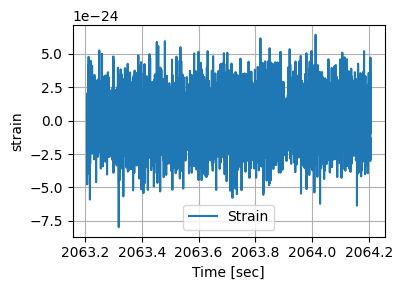

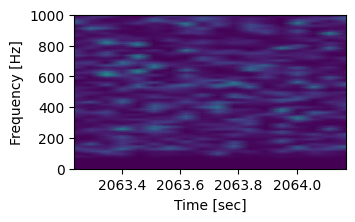

****************************************************************
Window sample No. 1
----------------------
Window initial time (in seconds):  2071.206787109375
Window end time (in seconds):  2072.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



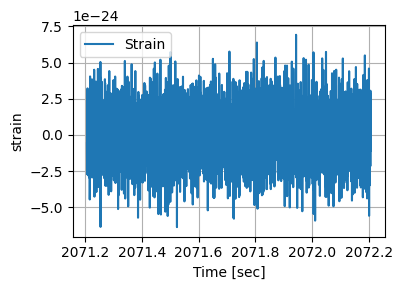

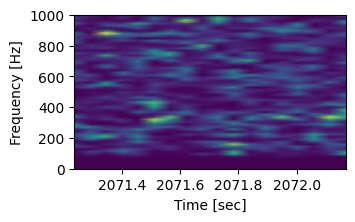

****************************************************************
Window sample No. 2
----------------------
Window initial time (in seconds):  2079.206787109375
Window end time (in seconds):  2080.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



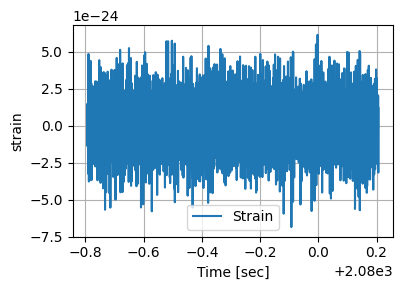

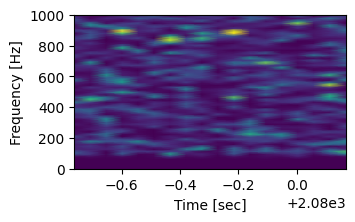

****************************************************************
Window sample No. 3
----------------------
Window initial time (in seconds):  2087.206787109375
Window end time (in seconds):  2088.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



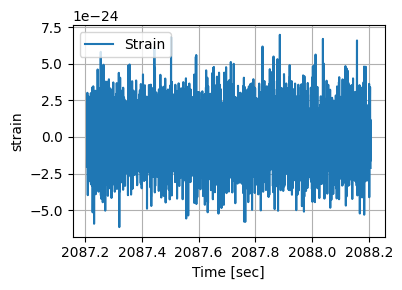

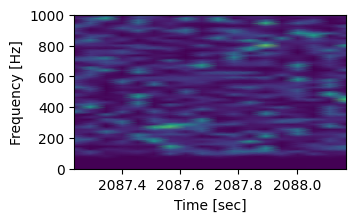

****************************************************************
Window sample No. 4
----------------------
Window initial time (in seconds):  2095.206787109375
Window end time (in seconds):  2096.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



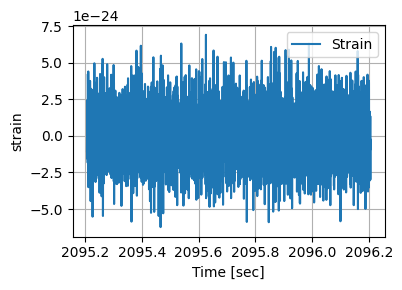

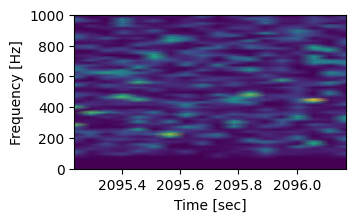

****************************************************************
Window sample No. 5
----------------------
Window initial time (in seconds):  2103.206787109375
Window end time (in seconds):  2104.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



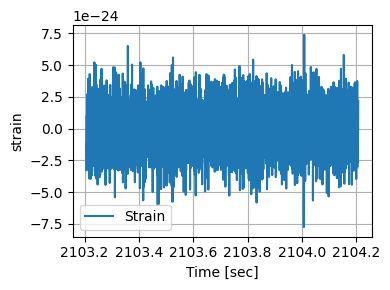

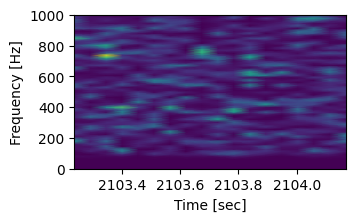

****************************************************************
Window sample No. 6
----------------------
Window initial time (in seconds):  2111.206787109375
Window end time (in seconds):  2112.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



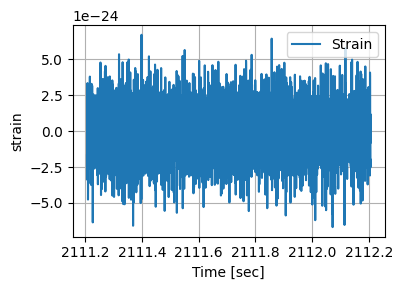

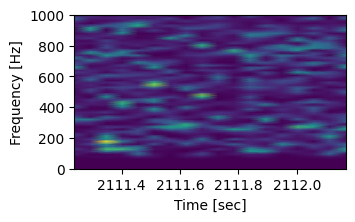

****************************************************************
Window sample No. 7
----------------------
Window initial time (in seconds):  2119.206787109375
Window end time (in seconds):  2120.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



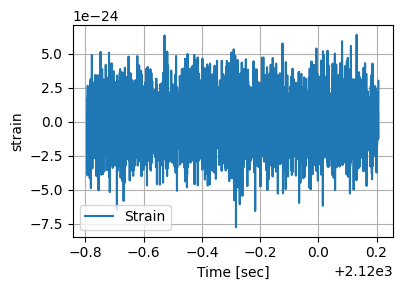

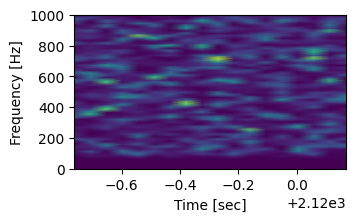

****************************************************************
Window sample No. 8
----------------------
Window initial time (in seconds):  2127.206787109375
Window end time (in seconds):  2128.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



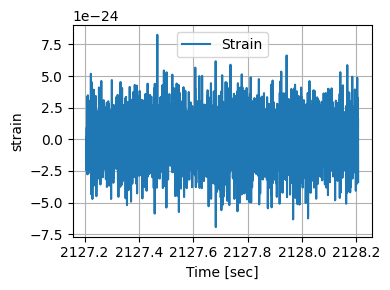

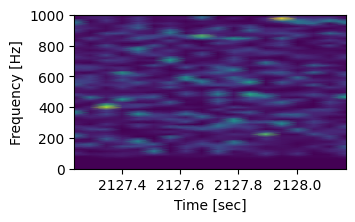

****************************************************************
Window sample No. 9
----------------------
Window initial time (in seconds):  2135.206787109375
Window end time (in seconds):  2136.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



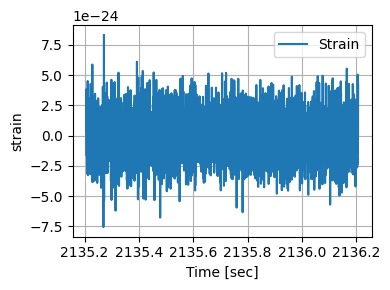

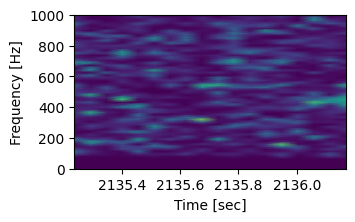

****************************************************************
Window sample No. 10
----------------------
Window initial time (in seconds):  2143.206787109375
Window end time (in seconds):  2144.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



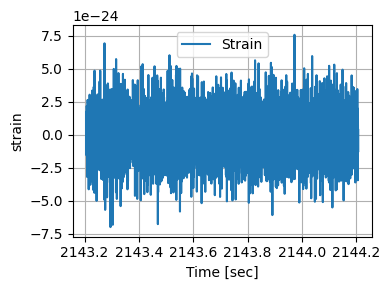

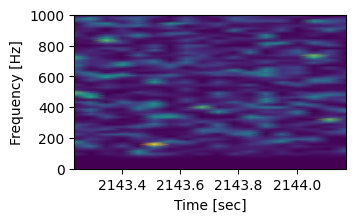

****************************************************************
Window sample No. 11
----------------------
Window initial time (in seconds):  2151.206787109375
Window end time (in seconds):  2152.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



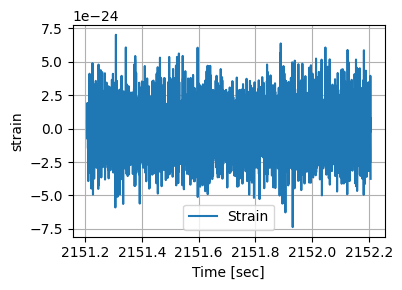

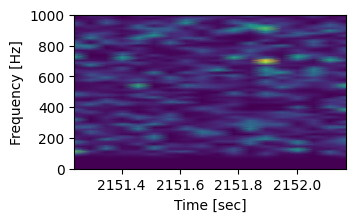

****************************************************************
Window sample No. 12
----------------------
Window initial time (in seconds):  2159.206787109375
Window end time (in seconds):  2160.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



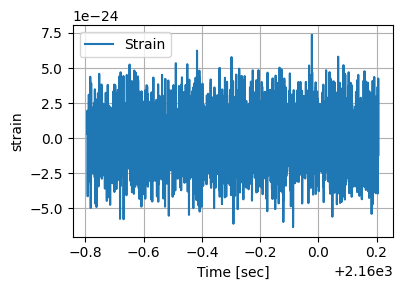

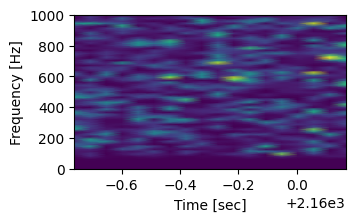

****************************************************************
Window sample No. 13
----------------------
Window initial time (in seconds):  2167.206787109375
Window end time (in seconds):  2168.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



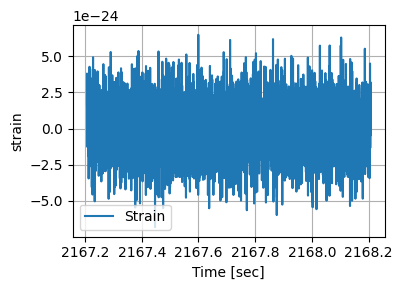

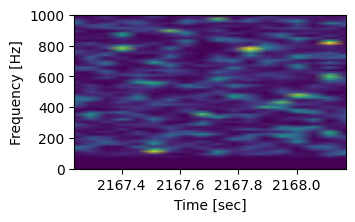

****************************************************************
Window sample No. 14
----------------------
Window initial time (in seconds):  2175.206787109375
Window end time (in seconds):  2176.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



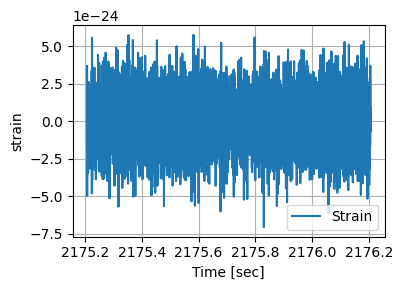

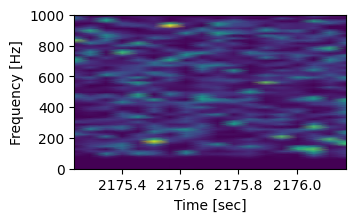

****************************************************************
Window sample No. 15
----------------------
Window initial time (in seconds):  2183.206787109375
Window end time (in seconds):  2184.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



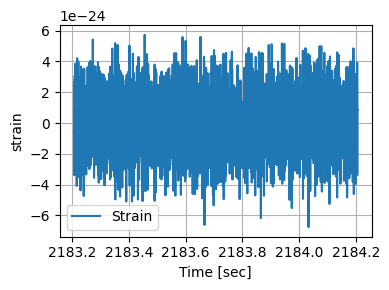

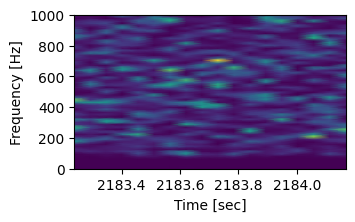

****************************************************************
Window sample No. 16
----------------------
Window initial time (in seconds):  2191.206787109375
Window end time (in seconds):  2192.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



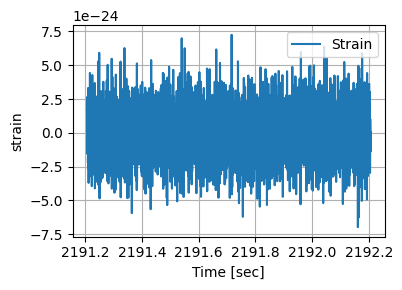

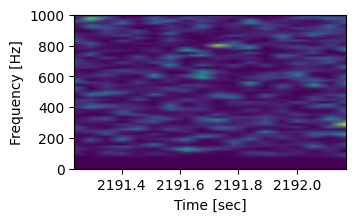

****************************************************************
Window sample No. 17
----------------------
Window initial time (in seconds):  2199.206787109375
Window end time (in seconds):  2200.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



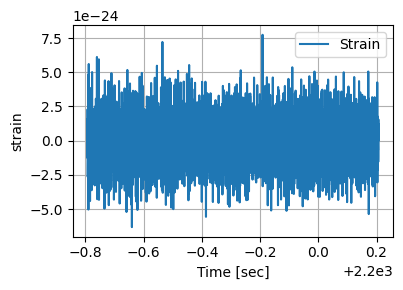

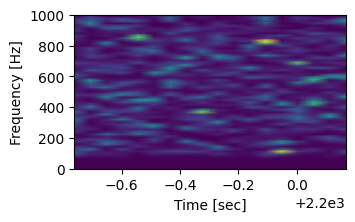

****************************************************************
Window sample No. 18
----------------------
Window initial time (in seconds):  2207.206787109375
Window end time (in seconds):  2208.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



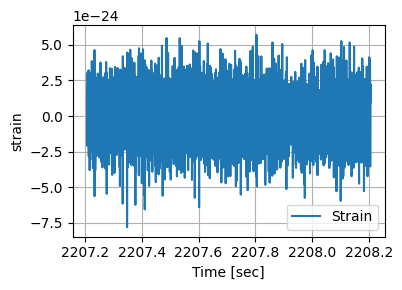

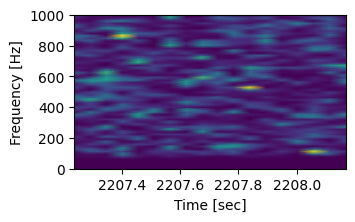

****************************************************************
Window sample No. 19
----------------------
Window initial time (in seconds):  2215.206787109375
Window end time (in seconds):  2216.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



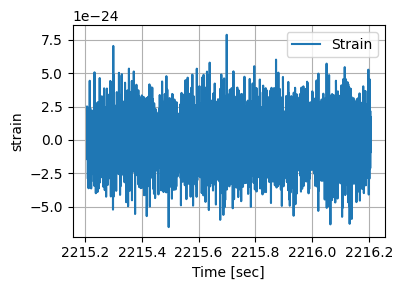

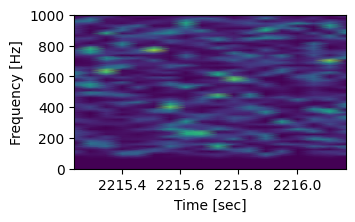

****************************************************************
Window sample No. 20
----------------------
Window initial time (in seconds):  2223.206787109375
Window end time (in seconds):  2224.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



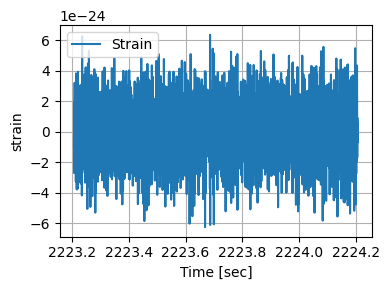

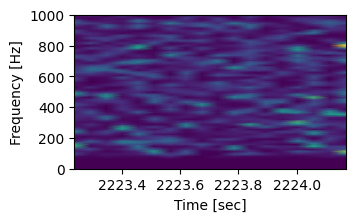

****************************************************************
Window sample No. 21
----------------------
Window initial time (in seconds):  2231.206787109375
Window end time (in seconds):  2232.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



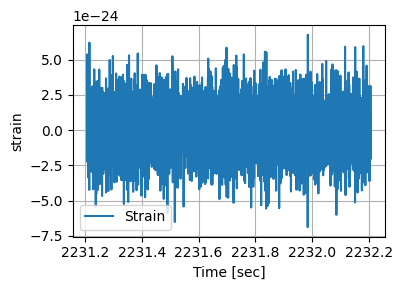

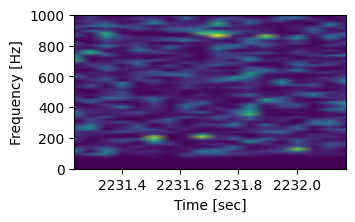

****************************************************************
Window sample No. 22
----------------------
Window initial time (in seconds):  2239.206787109375
Window end time (in seconds):  2240.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



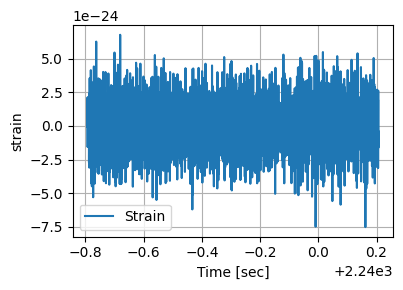

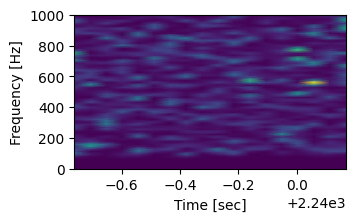

****************************************************************
Window sample No. 23
----------------------
Window initial time (in seconds):  2247.206787109375
Window end time (in seconds):  2248.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



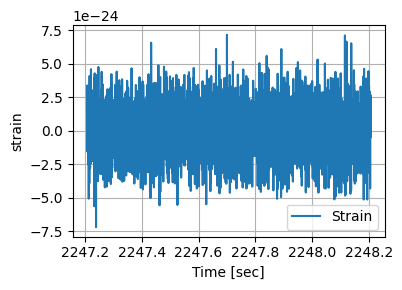

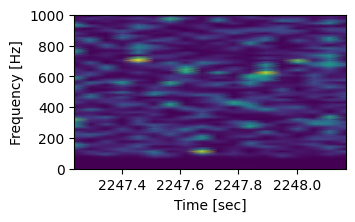

****************************************************************
Window sample No. 24
----------------------
Window initial time (in seconds):  2255.206787109375
Window end time (in seconds):  2256.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



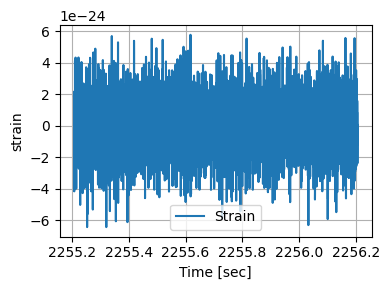

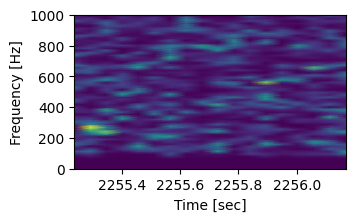

****************************************************************
Window sample No. 25
----------------------
Window initial time (in seconds):  2263.206787109375
Window end time (in seconds):  2264.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



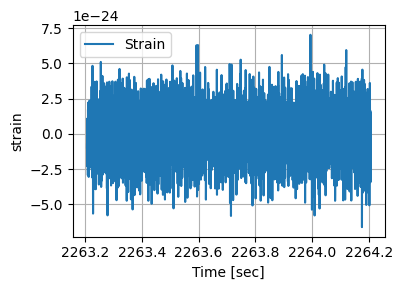

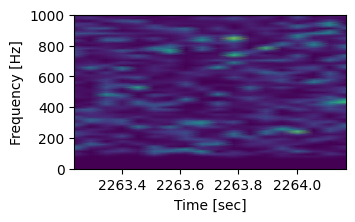

****************************************************************
Window sample No. 26
----------------------
Window initial time (in seconds):  2271.206787109375
Window end time (in seconds):  2272.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



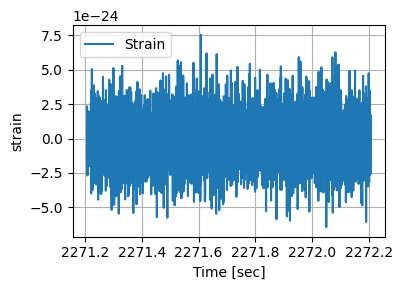

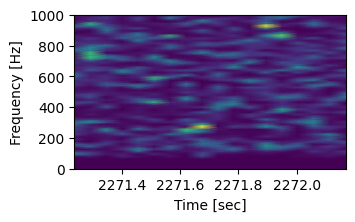

****************************************************************
Window sample No. 27
----------------------
Window initial time (in seconds):  2279.206787109375
Window end time (in seconds):  2280.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



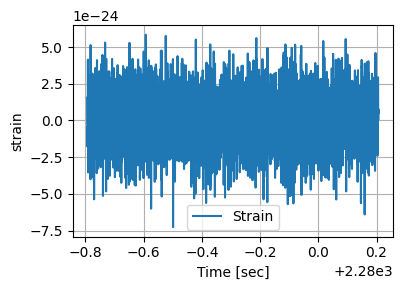

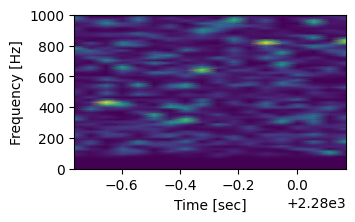

****************************************************************
Window sample No. 28
----------------------
Window initial time (in seconds):  2287.206787109375
Window end time (in seconds):  2288.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



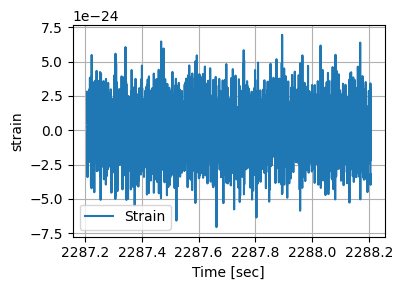

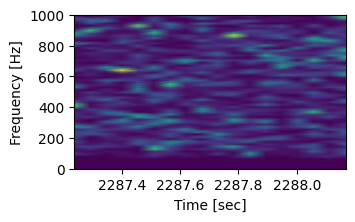

****************************************************************
Window sample No. 29
----------------------
Window initial time (in seconds):  2295.206787109375
Window end time (in seconds):  2296.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



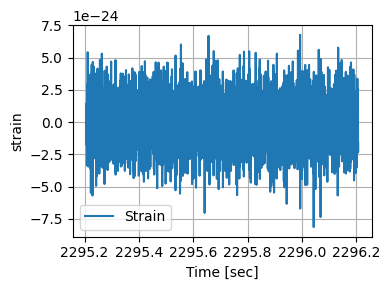

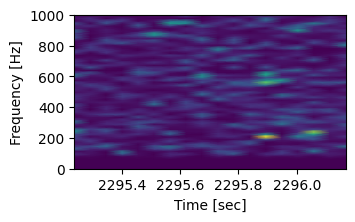

****************************************************************
Window sample No. 30
----------------------
Window initial time (in seconds):  2303.206787109375
Window end time (in seconds):  2304.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



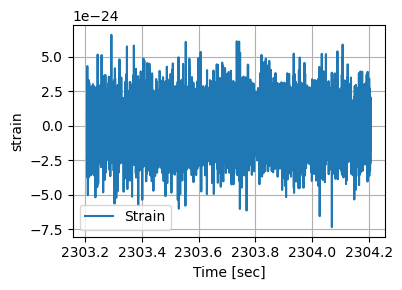

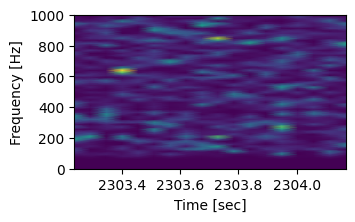

****************************************************************
Window sample No. 31
----------------------
Window initial time (in seconds):  2311.206787109375
Window end time (in seconds):  2312.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



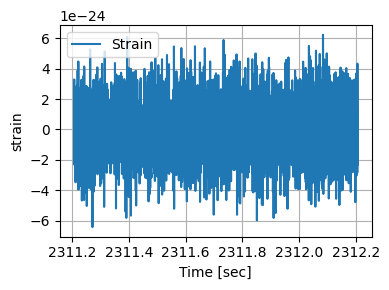

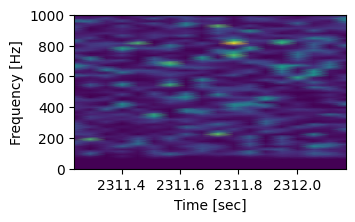

****************************************************************
Window sample No. 32
----------------------
Window initial time (in seconds):  2319.206787109375
Window end time (in seconds):  2320.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



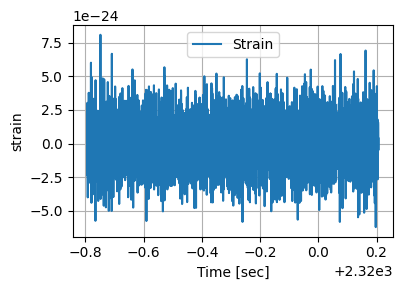

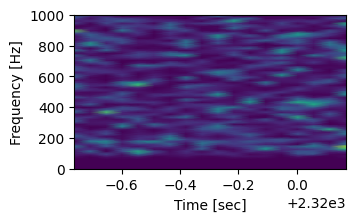

****************************************************************
Window sample No. 33
----------------------
Window initial time (in seconds):  2327.206787109375
Window end time (in seconds):  2328.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



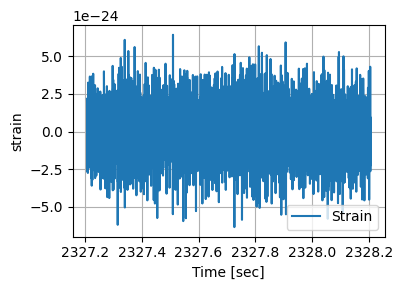

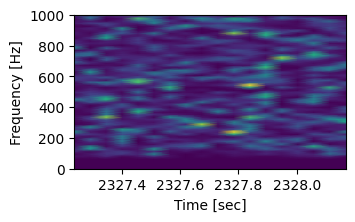

****************************************************************
Window sample No. 34
----------------------
Window initial time (in seconds):  2335.206787109375
Window end time (in seconds):  2336.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



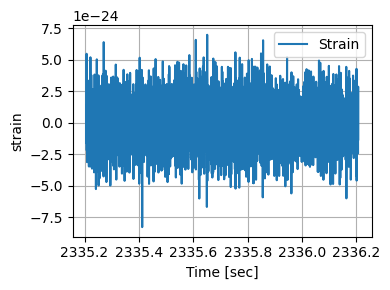

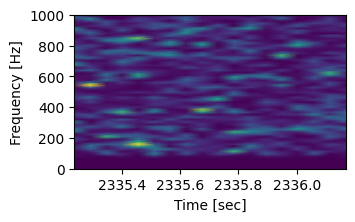

****************************************************************
Window sample No. 35
----------------------
Window initial time (in seconds):  2343.206787109375
Window end time (in seconds):  2344.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



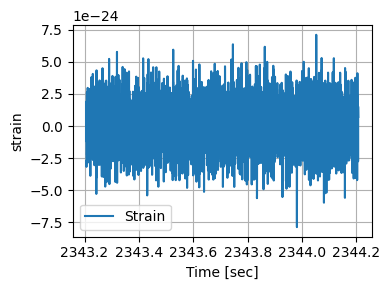

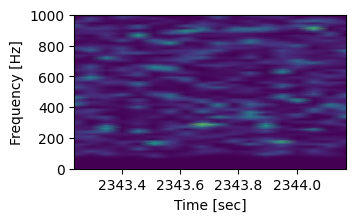

****************************************************************
Window sample No. 36
----------------------
Window initial time (in seconds):  2351.206787109375
Window end time (in seconds):  2352.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



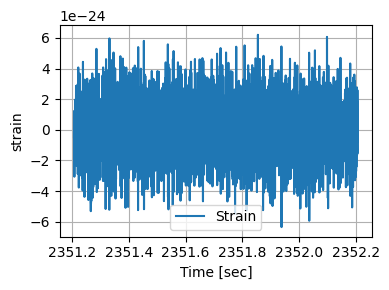

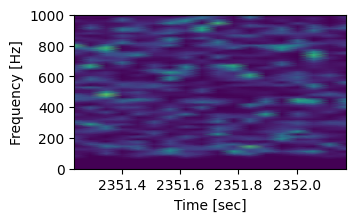

****************************************************************
Window sample No. 37
----------------------
Window initial time (in seconds):  2359.206787109375
Window end time (in seconds):  2360.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



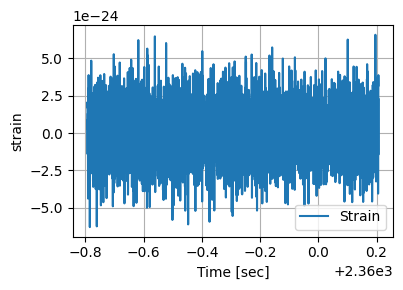

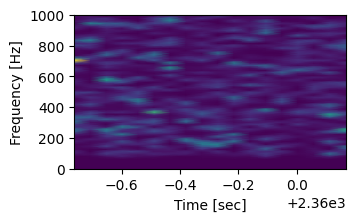

****************************************************************
Window sample No. 38
----------------------
Window initial time (in seconds):  2367.206787109375
Window end time (in seconds):  2368.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



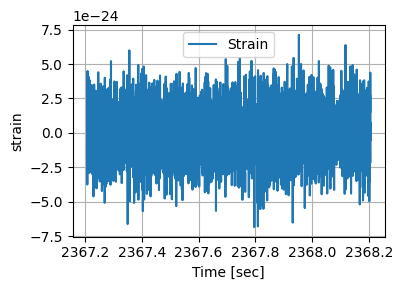

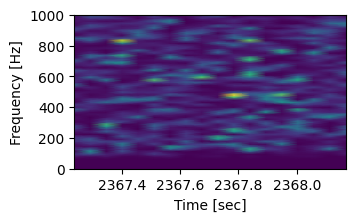

****************************************************************
Window sample No. 39
----------------------
Window initial time (in seconds):  2375.206787109375
Window end time (in seconds):  2376.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



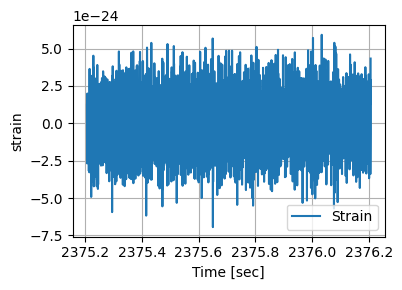

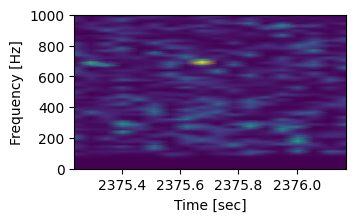

****************************************************************
Window sample No. 40
----------------------
Window initial time (in seconds):  2383.206787109375
Window end time (in seconds):  2384.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



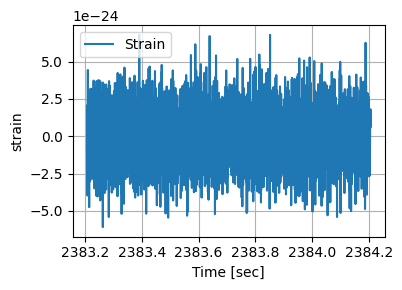

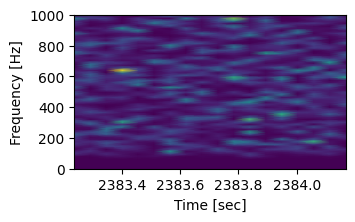

****************************************************************
Window sample No. 41
----------------------
Window initial time (in seconds):  2391.206787109375
Window end time (in seconds):  2392.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



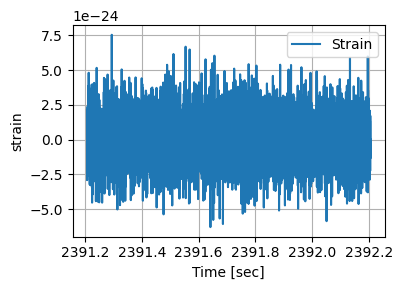

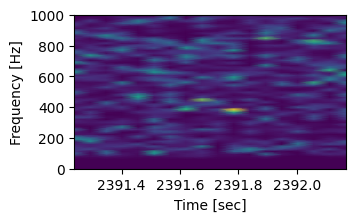

****************************************************************
Window sample No. 42
----------------------
Window initial time (in seconds):  2399.206787109375
Window end time (in seconds):  2400.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



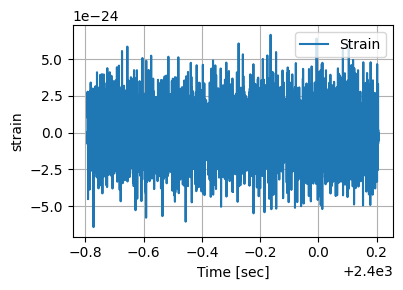

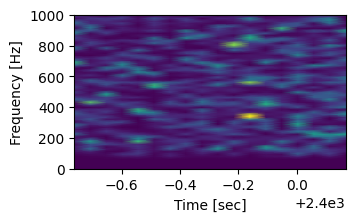

****************************************************************
Window sample No. 43
----------------------
Window initial time (in seconds):  2407.206787109375
Window end time (in seconds):  2408.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



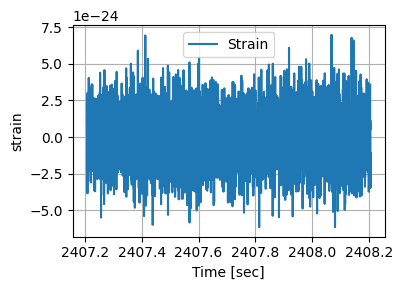

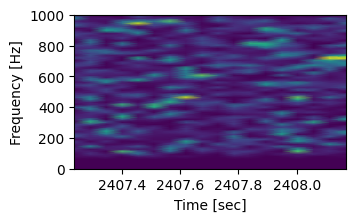

****************************************************************
Window sample No. 44
----------------------
Window initial time (in seconds):  2415.206787109375
Window end time (in seconds):  2416.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



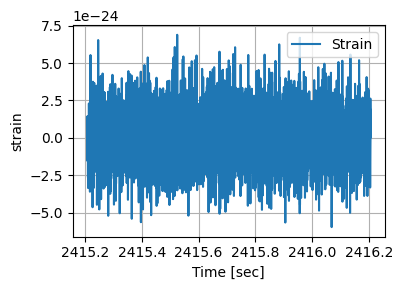

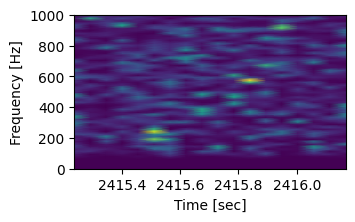

****************************************************************
Window sample No. 45
----------------------
Window initial time (in seconds):  2423.206787109375
Window end time (in seconds):  2424.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



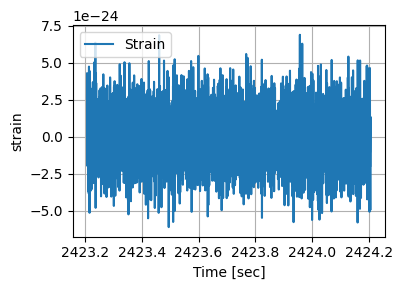

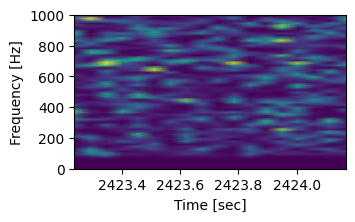

****************************************************************
Window sample No. 46
----------------------
Window initial time (in seconds):  2431.206787109375
Window end time (in seconds):  2432.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



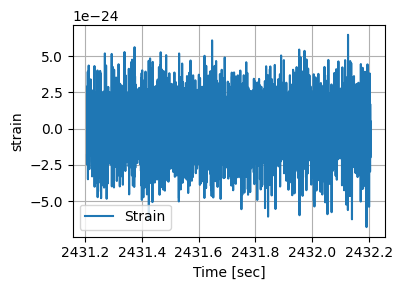

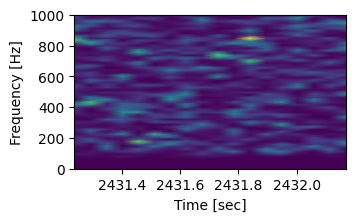

****************************************************************
Window sample No. 47
----------------------
Window initial time (in seconds):  2439.206787109375
Window end time (in seconds):  2440.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



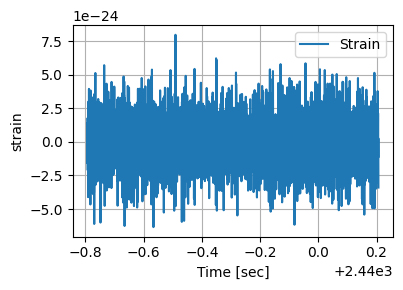

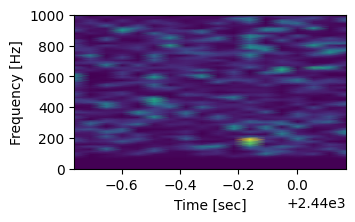

****************************************************************
Window sample No. 48
----------------------
Window initial time (in seconds):  2447.206787109375
Window end time (in seconds):  2448.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



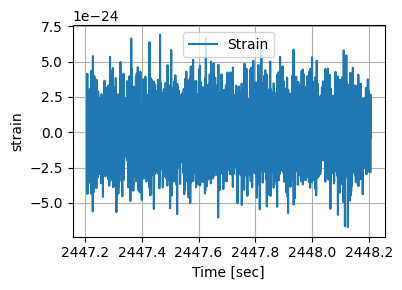

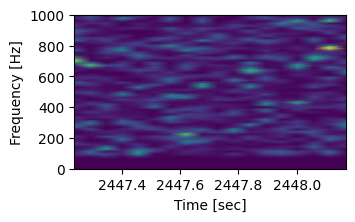

****************************************************************
Window sample No. 49
----------------------
Window initial time (in seconds):  2455.206787109375
Window end time (in seconds):  2456.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



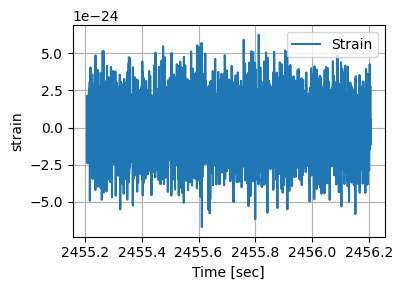

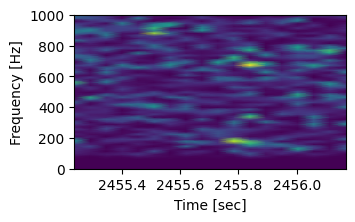

****************************************************************
Window sample No. 50
----------------------
Window initial time (in seconds):  2463.206787109375
Window end time (in seconds):  2464.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



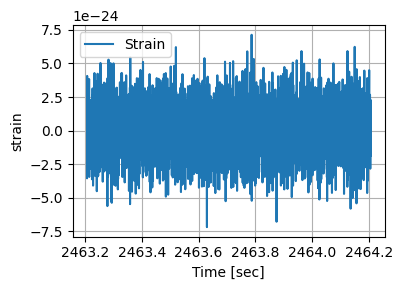

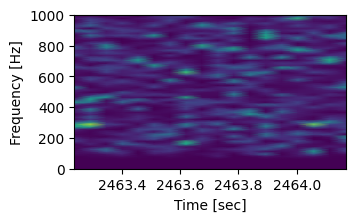

****************************************************************
Window sample No. 51
----------------------
Window initial time (in seconds):  2471.206787109375
Window end time (in seconds):  2472.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



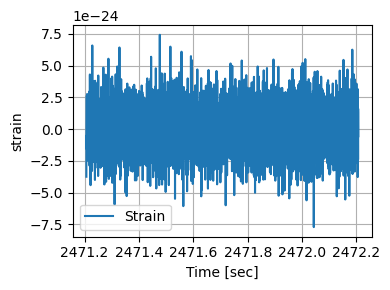

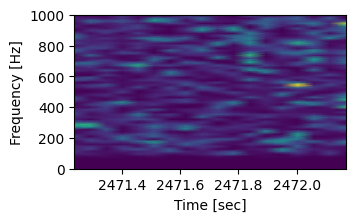

****************************************************************
Window sample No. 52
----------------------
Window initial time (in seconds):  2479.206787109375
Window end time (in seconds):  2480.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



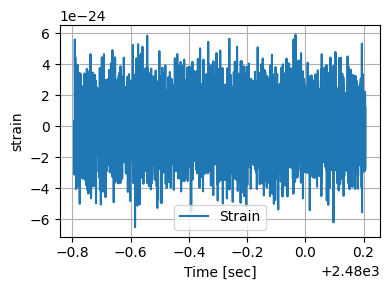

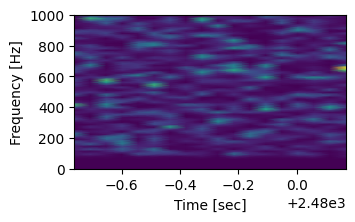

****************************************************************
Window sample No. 53
----------------------
Window initial time (in seconds):  2487.206787109375
Window end time (in seconds):  2488.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



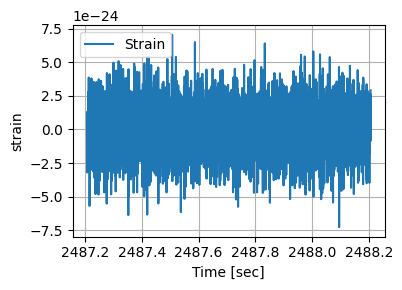

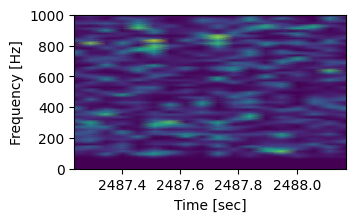

****************************************************************
Window sample No. 54
----------------------
Window initial time (in seconds):  2495.206787109375
Window end time (in seconds):  2496.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



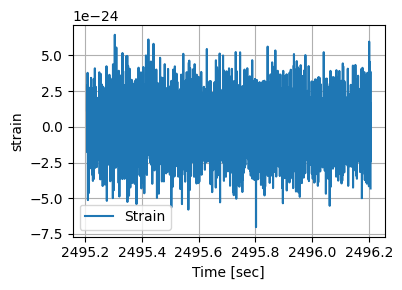

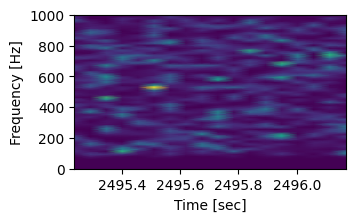

****************************************************************
Window sample No. 55
----------------------
Window initial time (in seconds):  2503.206787109375
Window end time (in seconds):  2504.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



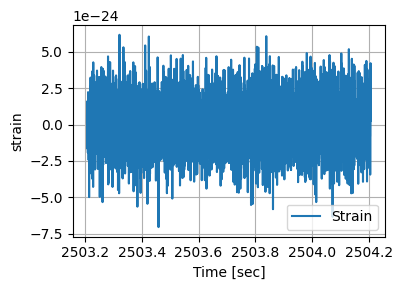

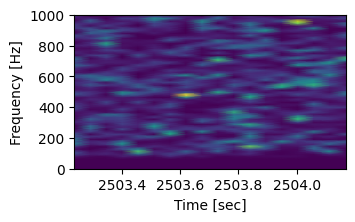

****************************************************************
Window sample No. 56
----------------------
Window initial time (in seconds):  2511.206787109375
Window end time (in seconds):  2512.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



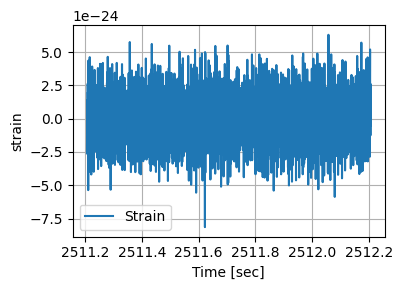

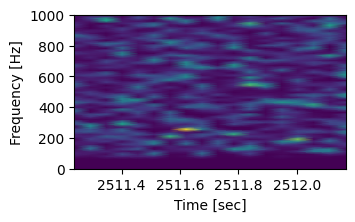

****************************************************************
Window sample No. 57
----------------------
Window initial time (in seconds):  2519.206787109375
Window end time (in seconds):  2520.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



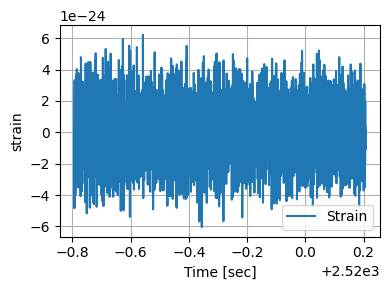

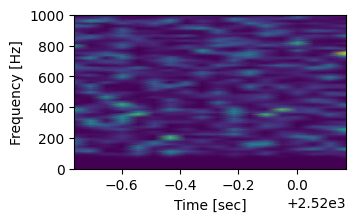

****************************************************************
Window sample No. 58
----------------------
Window initial time (in seconds):  2527.206787109375
Window end time (in seconds):  2528.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



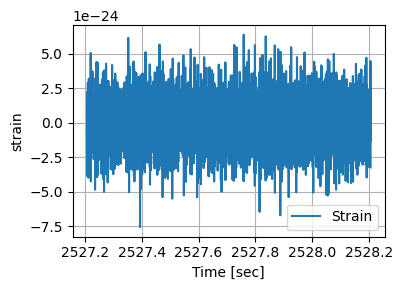

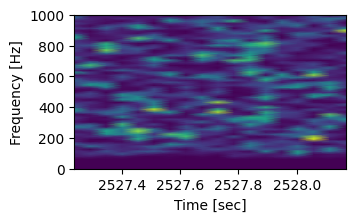

****************************************************************
Window sample No. 59
----------------------
Window initial time (in seconds):  2535.206787109375
Window end time (in seconds):  2536.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



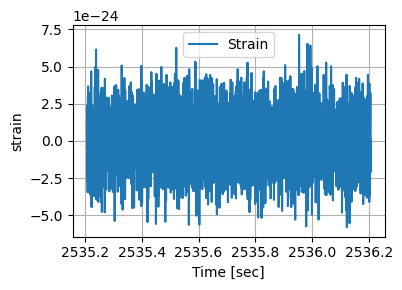

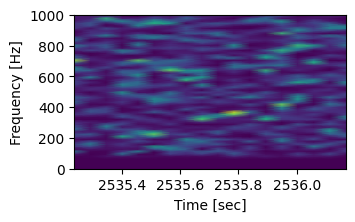

****************************************************************
Window sample No. 60
----------------------
Window initial time (in seconds):  2543.206787109375
Window end time (in seconds):  2544.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



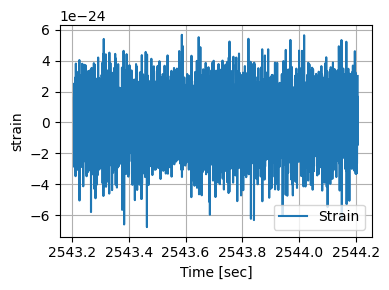

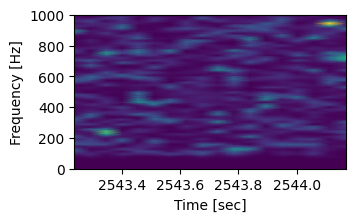

****************************************************************
Window sample No. 61
----------------------
Window initial time (in seconds):  2551.206787109375
Window end time (in seconds):  2552.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



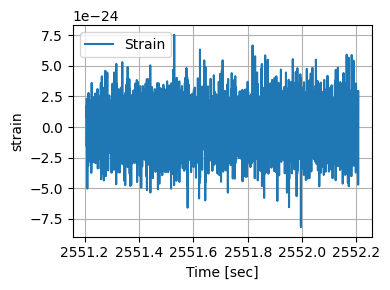

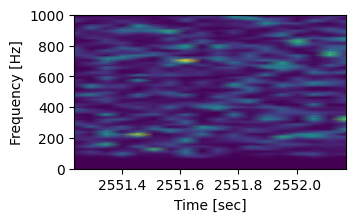

****************************************************************
Window sample No. 62
----------------------
Window initial time (in seconds):  2559.206787109375
Window end time (in seconds):  2560.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



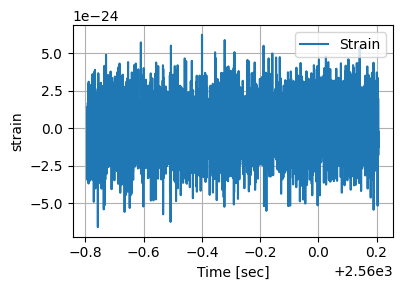

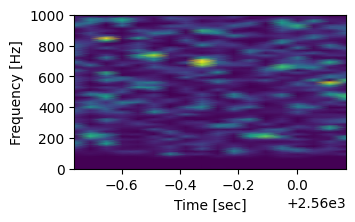

****************************************************************
Window sample No. 63
----------------------
Window initial time (in seconds):  2567.206787109375
Window end time (in seconds):  2568.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



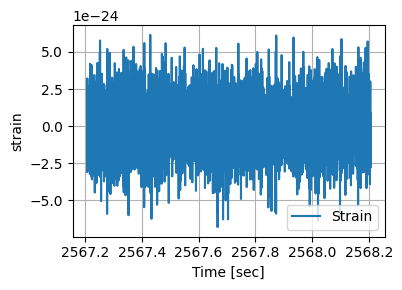

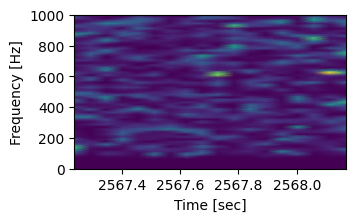

****************************************************************
Window sample No. 64
----------------------
Window initial time (in seconds):  2575.206787109375
Window end time (in seconds):  2576.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



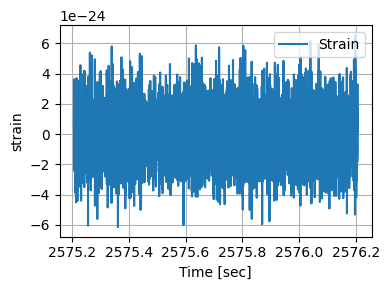

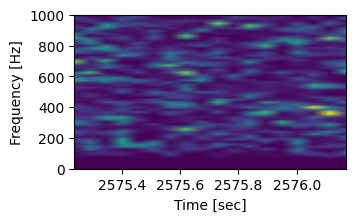

****************************************************************
Window sample No. 65
----------------------
Window initial time (in seconds):  2583.206787109375
Window end time (in seconds):  2584.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



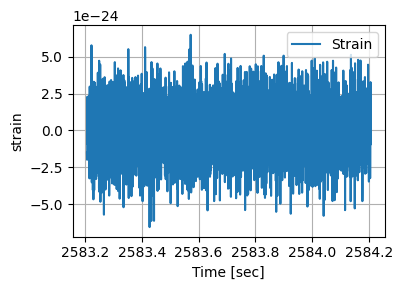

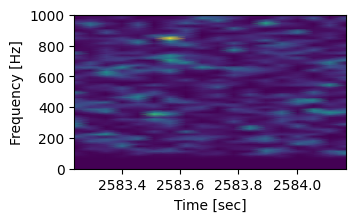

****************************************************************
Window sample No. 66
----------------------
Window initial time (in seconds):  2591.206787109375
Window end time (in seconds):  2592.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



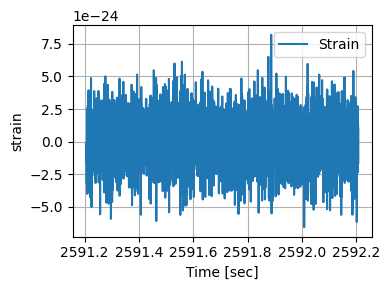

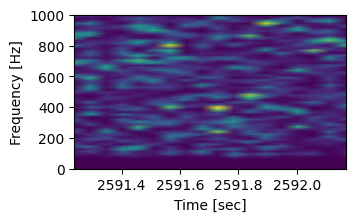

****************************************************************
Window sample No. 67
----------------------
Window initial time (in seconds):  2599.206787109375
Window end time (in seconds):  2600.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



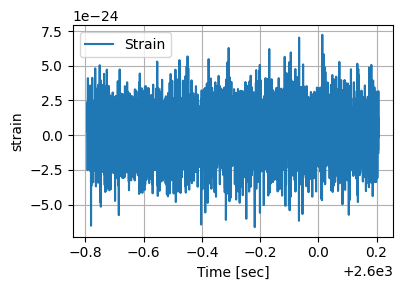

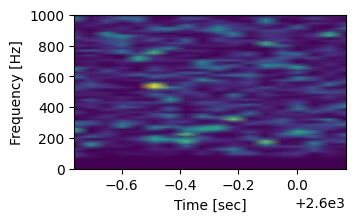

****************************************************************
Window sample No. 68
----------------------
Window initial time (in seconds):  2607.206787109375
Window end time (in seconds):  2608.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



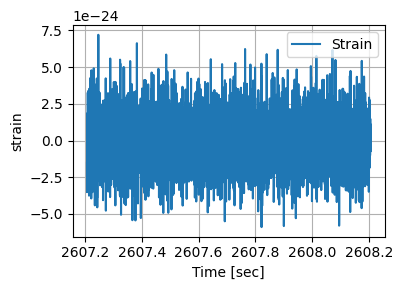

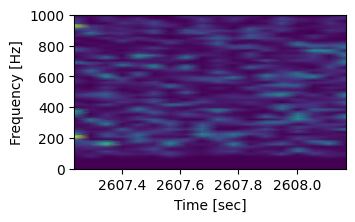

****************************************************************
Window sample No. 69
----------------------
Window initial time (in seconds):  2615.206787109375
Window end time (in seconds):  2616.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



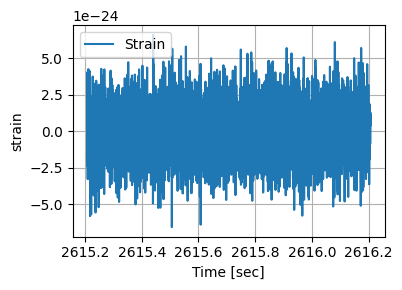

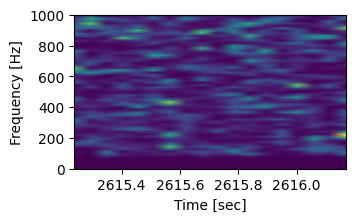

****************************************************************
Window sample No. 70
----------------------
Window initial time (in seconds):  2623.206787109375
Window end time (in seconds):  2624.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



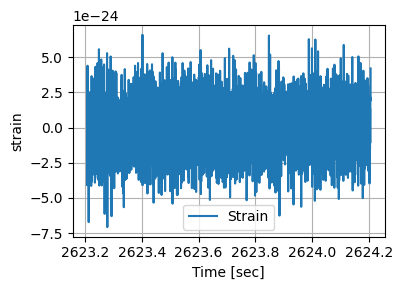

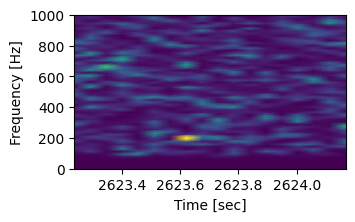

****************************************************************
Window sample No. 71
----------------------
Window initial time (in seconds):  2631.206787109375
Window end time (in seconds):  2632.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



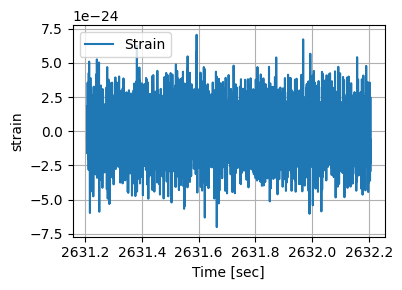

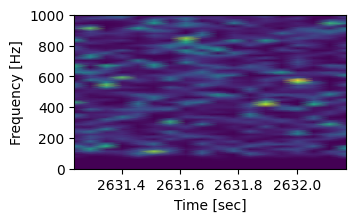

****************************************************************
Window sample No. 72
----------------------
Window initial time (in seconds):  2639.206787109375
Window end time (in seconds):  2640.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



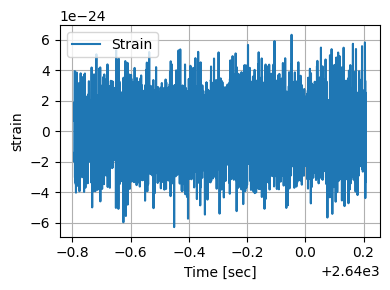

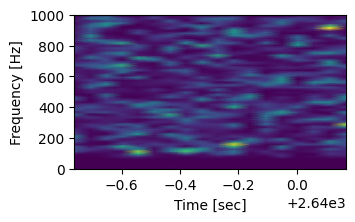

****************************************************************
Window sample No. 73
----------------------
Window initial time (in seconds):  2647.206787109375
Window end time (in seconds):  2648.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



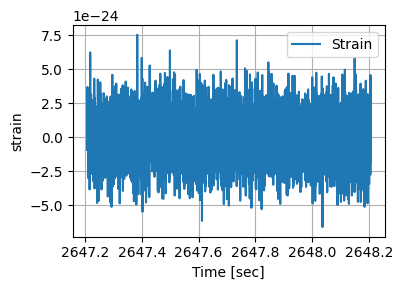

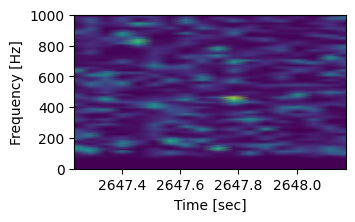

****************************************************************
Window sample No. 74
----------------------
Window initial time (in seconds):  2655.206787109375
Window end time (in seconds):  2656.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



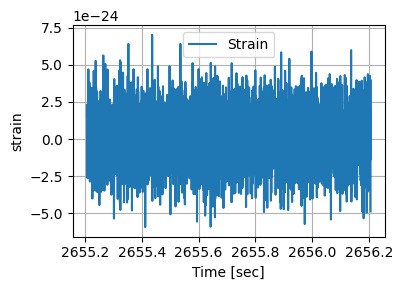

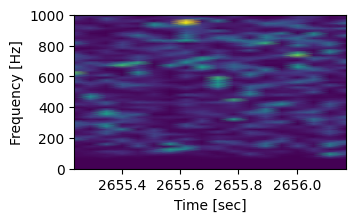

****************************************************************
Window sample No. 75
----------------------
Window initial time (in seconds):  2663.206787109375
Window end time (in seconds):  2664.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



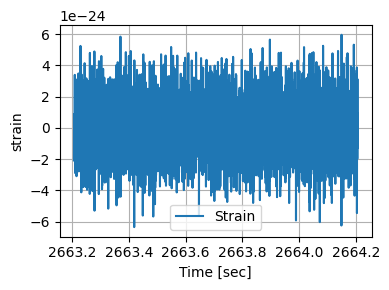

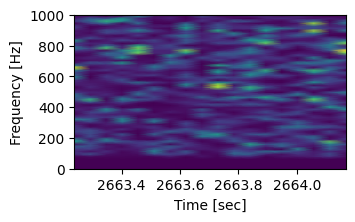

****************************************************************
Window sample No. 76
----------------------
Window initial time (in seconds):  2671.206787109375
Window end time (in seconds):  2672.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



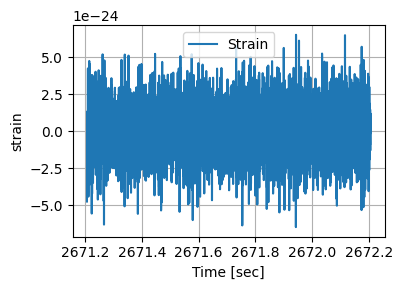

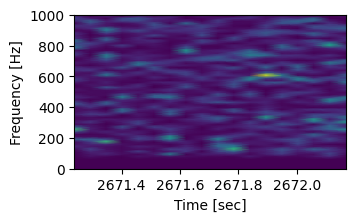

****************************************************************
Window sample No. 77
----------------------
Window initial time (in seconds):  2679.206787109375
Window end time (in seconds):  2680.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



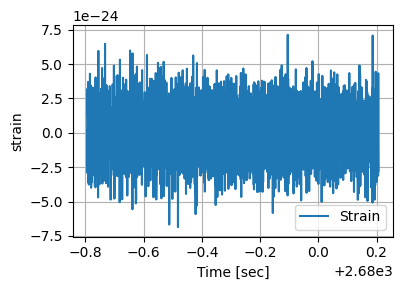

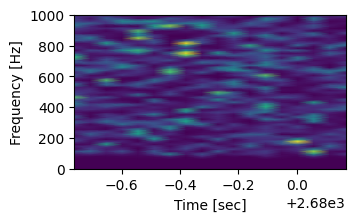

****************************************************************
Window sample No. 78
----------------------
Window initial time (in seconds):  2687.206787109375
Window end time (in seconds):  2688.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



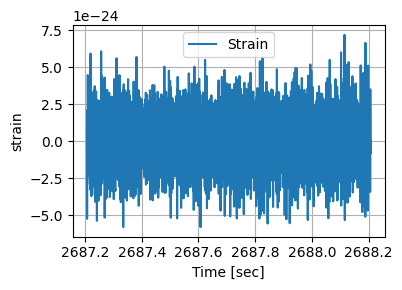

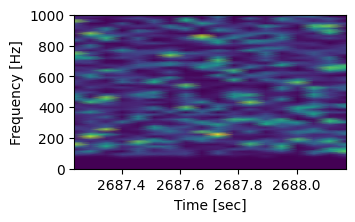

****************************************************************
Window sample No. 79
----------------------
Window initial time (in seconds):  2695.206787109375
Window end time (in seconds):  2696.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



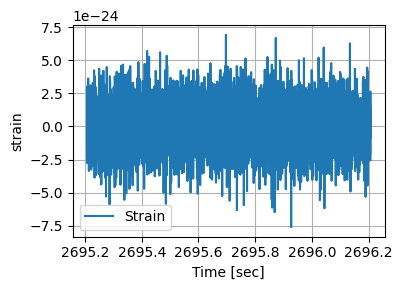

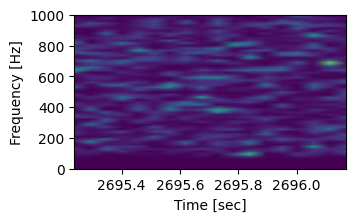

****************************************************************
Window sample No. 80
----------------------
Window initial time (in seconds):  2703.206787109375
Window end time (in seconds):  2704.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



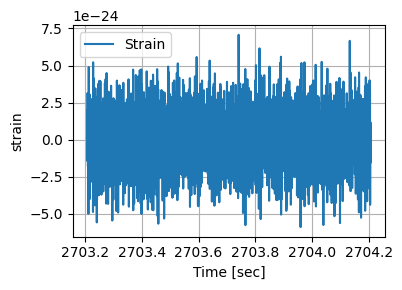

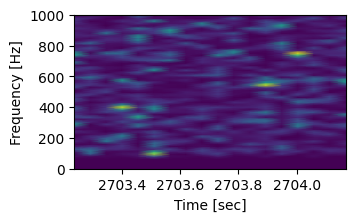

****************************************************************
Window sample No. 81
----------------------
Window initial time (in seconds):  2711.206787109375
Window end time (in seconds):  2712.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



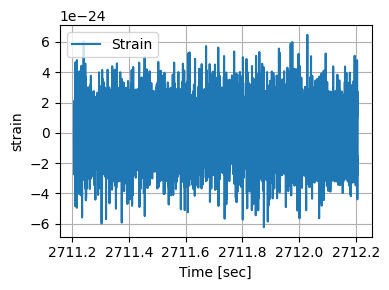

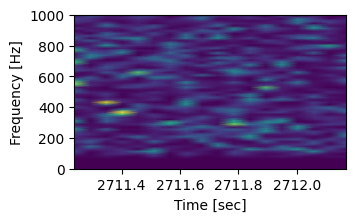

****************************************************************
Window sample No. 82
----------------------
Window initial time (in seconds):  2719.206787109375
Window end time (in seconds):  2720.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



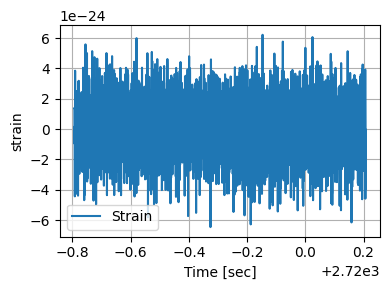

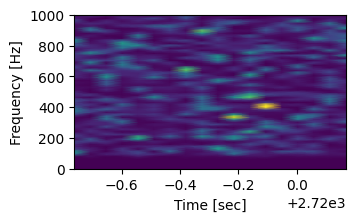

****************************************************************
Window sample No. 83
----------------------
Window initial time (in seconds):  2727.206787109375
Window end time (in seconds):  2728.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



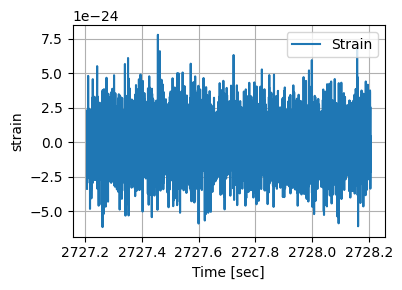

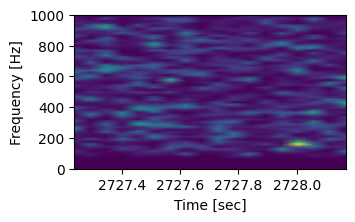

****************************************************************
Window sample No. 84
----------------------
Window initial time (in seconds):  2735.206787109375
Window end time (in seconds):  2736.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



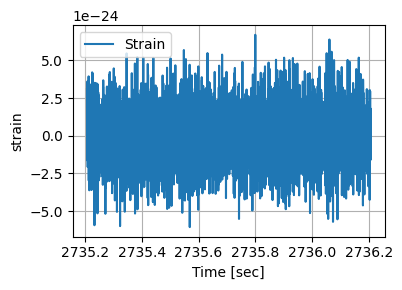

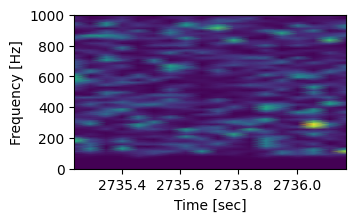

****************************************************************
Window sample No. 85
----------------------
Window initial time (in seconds):  2743.206787109375
Window end time (in seconds):  2744.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



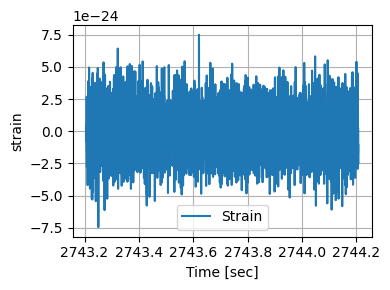

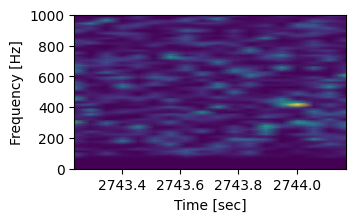

****************************************************************
Window sample No. 86
----------------------
Window initial time (in seconds):  2751.206787109375
Window end time (in seconds):  2752.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



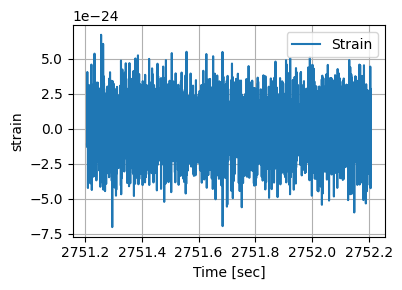

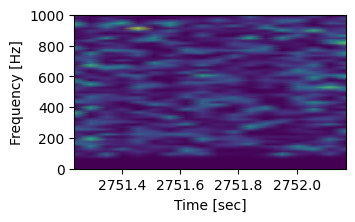

****************************************************************
Window sample No. 87
----------------------
Window initial time (in seconds):  2759.206787109375
Window end time (in seconds):  2760.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



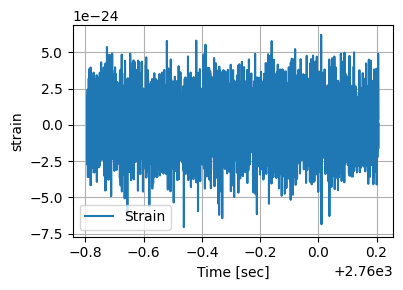

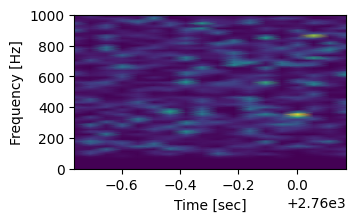

****************************************************************
Window sample No. 88
----------------------
Window initial time (in seconds):  2767.206787109375
Window end time (in seconds):  2768.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



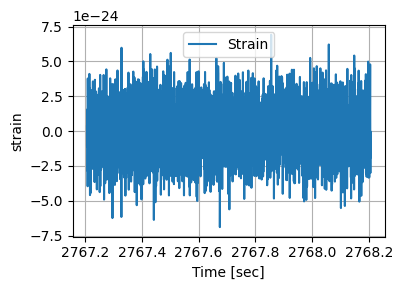

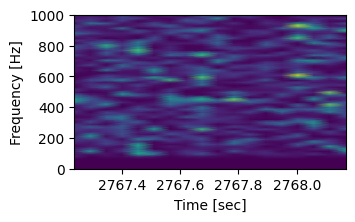

****************************************************************
Window sample No. 89
----------------------
Window initial time (in seconds):  2775.206787109375
Window end time (in seconds):  2776.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



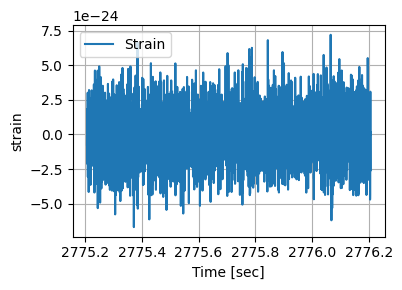

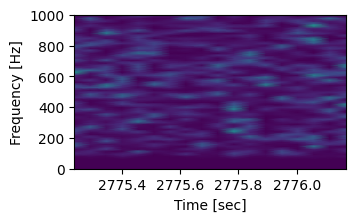

****************************************************************
Window sample No. 90
----------------------
Window initial time (in seconds):  2783.206787109375
Window end time (in seconds):  2784.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



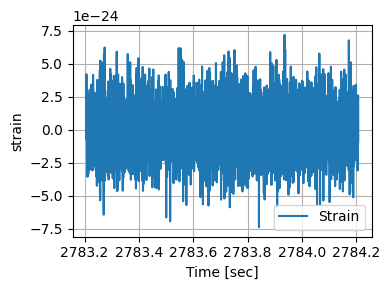

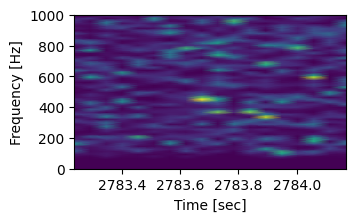

****************************************************************
Window sample No. 91
----------------------
Window initial time (in seconds):  2791.206787109375
Window end time (in seconds):  2792.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



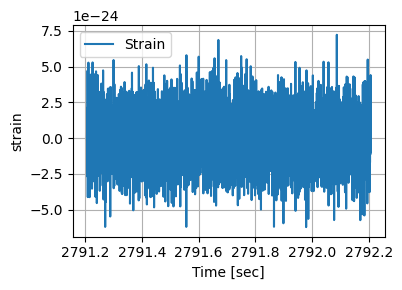

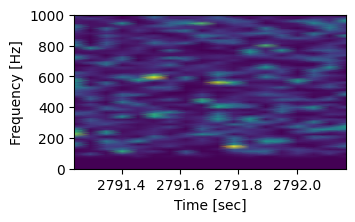

****************************************************************
Window sample No. 92
----------------------
Window initial time (in seconds):  2799.206787109375
Window end time (in seconds):  2800.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



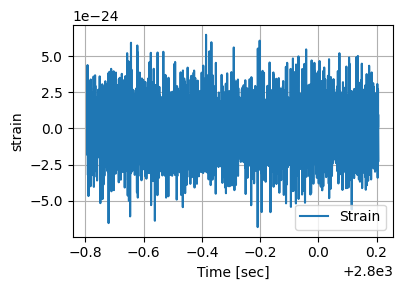

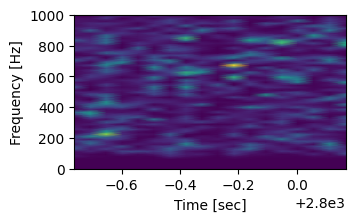

****************************************************************
Window sample No. 93
----------------------
Window initial time (in seconds):  2807.206787109375
Window end time (in seconds):  2808.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



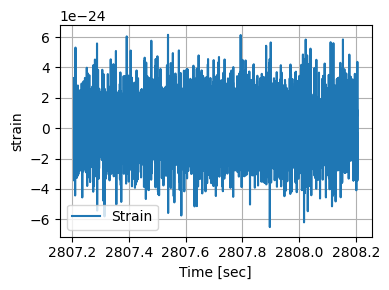

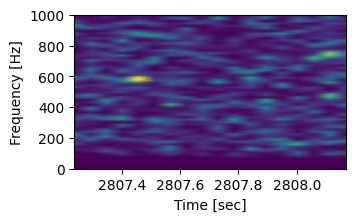

****************************************************************
Window sample No. 94
----------------------
Window initial time (in seconds):  2815.206787109375
Window end time (in seconds):  2816.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



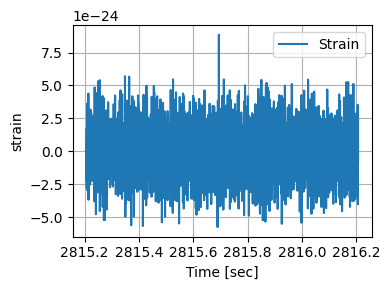

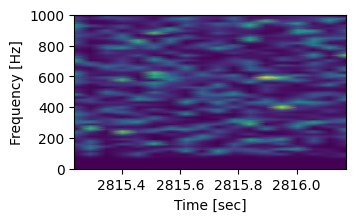

****************************************************************
Window sample No. 95
----------------------
Window initial time (in seconds):  2823.206787109375
Window end time (in seconds):  2824.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



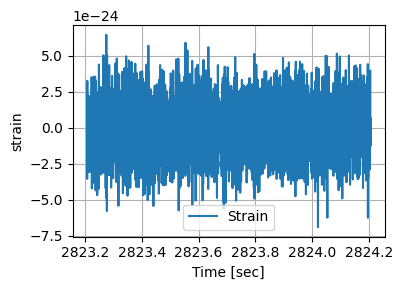

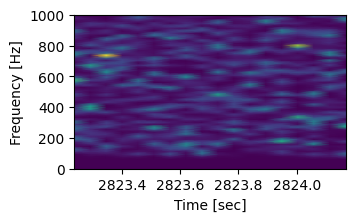

****************************************************************
Window sample No. 96
----------------------
Window initial time (in seconds):  2831.206787109375
Window end time (in seconds):  2832.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



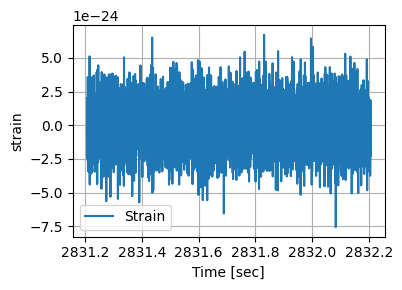

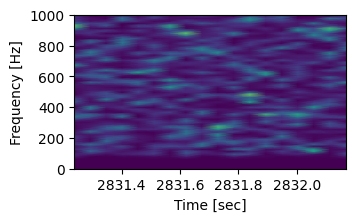

****************************************************************
Window sample No. 97
----------------------
Window initial time (in seconds):  2839.206787109375
Window end time (in seconds):  2840.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



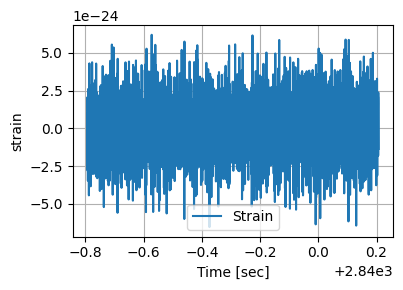

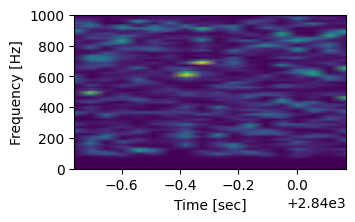

****************************************************************
Window sample No. 98
----------------------
Window initial time (in seconds):  2847.206787109375
Window end time (in seconds):  2848.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



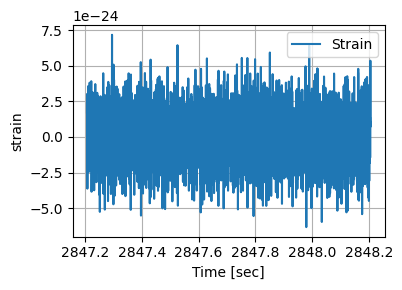

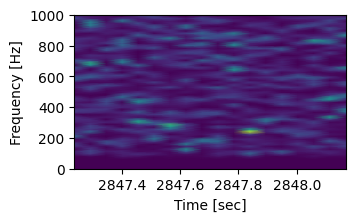

****************************************************************
Window sample No. 99
----------------------
Window initial time (in seconds):  2855.206787109375
Window end time (in seconds):  2856.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



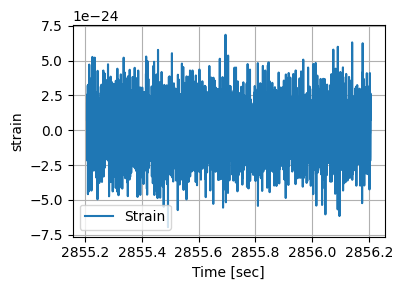

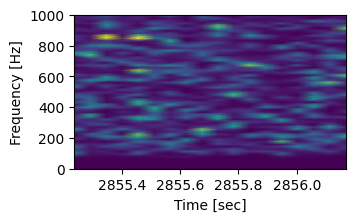

****************************************************************
Window sample No. 100
----------------------
Window initial time (in seconds):  2863.206787109375
Window end time (in seconds):  2864.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



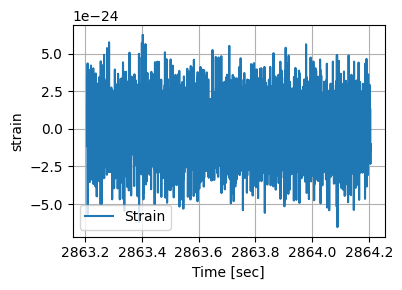

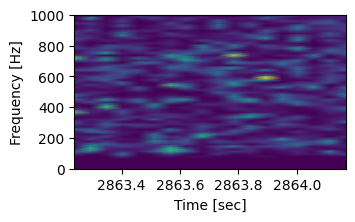

****************************************************************
Window sample No. 101
----------------------
Window initial time (in seconds):  2871.206787109375
Window end time (in seconds):  2872.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



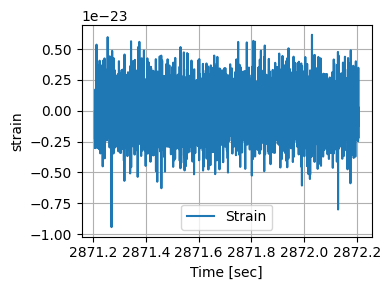

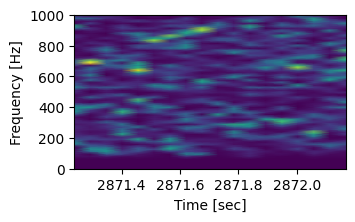

****************************************************************
Window sample No. 102
----------------------
Window initial time (in seconds):  2879.206787109375
Window end time (in seconds):  2880.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



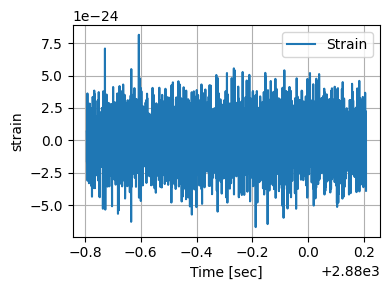

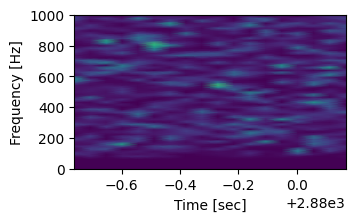

****************************************************************
Window sample No. 103
----------------------
Window initial time (in seconds):  2887.206787109375
Window end time (in seconds):  2888.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



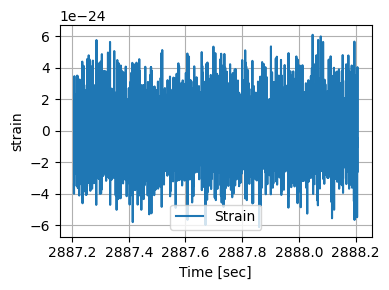

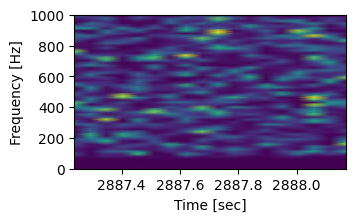

****************************************************************
Window sample No. 104
----------------------
Window initial time (in seconds):  2895.206787109375
Window end time (in seconds):  2896.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



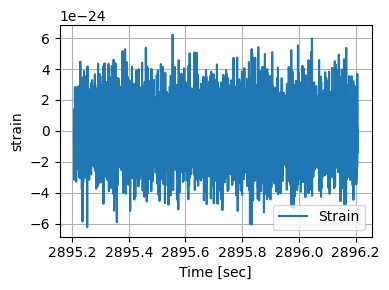

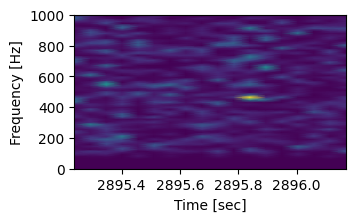

****************************************************************
Window sample No. 105
----------------------
Window initial time (in seconds):  2903.206787109375
Window end time (in seconds):  2904.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



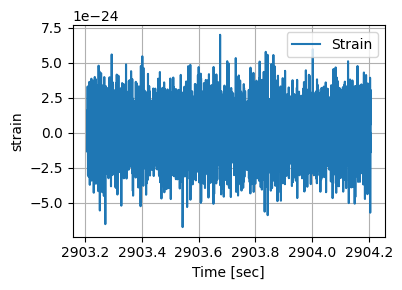

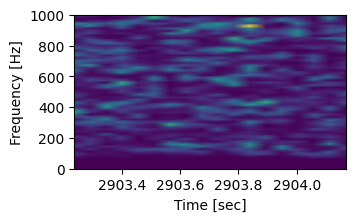

****************************************************************
Window sample No. 106
----------------------
Window initial time (in seconds):  2911.206787109375
Window end time (in seconds):  2912.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



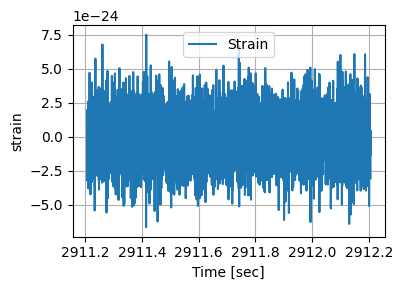

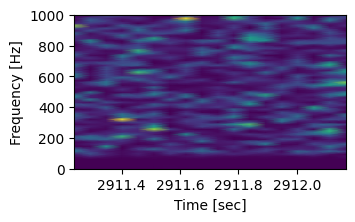

****************************************************************
Window sample No. 107
----------------------
Window initial time (in seconds):  2919.206787109375
Window end time (in seconds):  2920.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



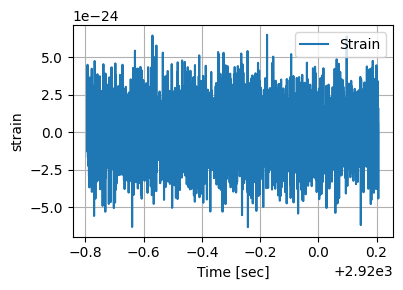

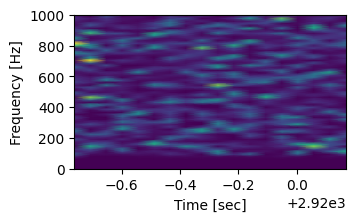

****************************************************************
Window sample No. 108
----------------------
Window initial time (in seconds):  2927.206787109375
Window end time (in seconds):  2928.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



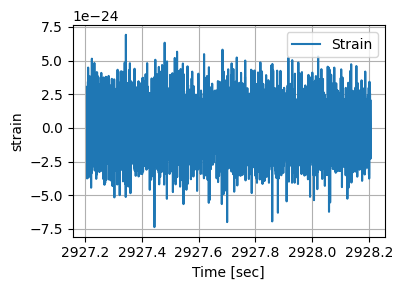

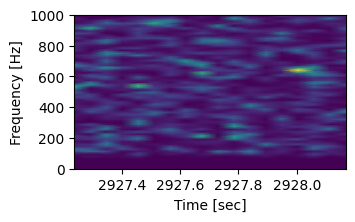

****************************************************************
Window sample No. 109
----------------------
Window initial time (in seconds):  2935.206787109375
Window end time (in seconds):  2936.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



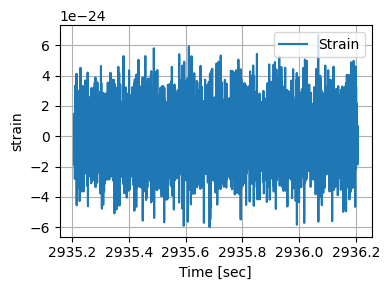

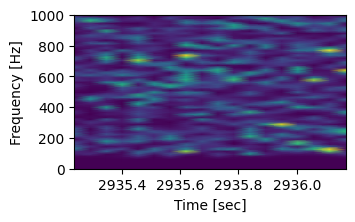

****************************************************************
Window sample No. 110
----------------------
Window initial time (in seconds):  2943.206787109375
Window end time (in seconds):  2944.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



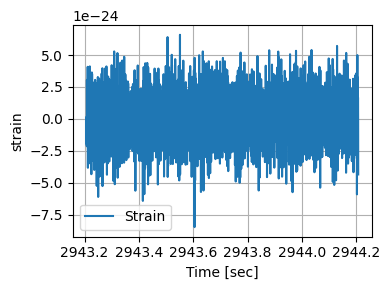

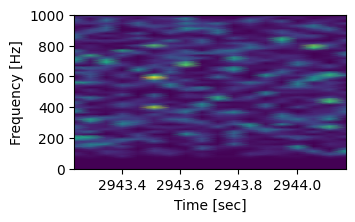

****************************************************************
Window sample No. 111
----------------------
Window initial time (in seconds):  2951.206787109375
Window end time (in seconds):  2952.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



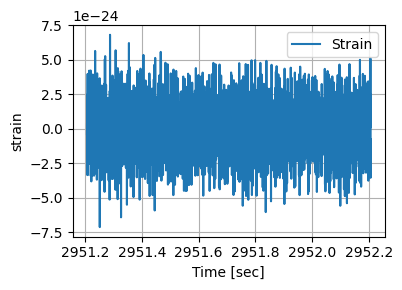

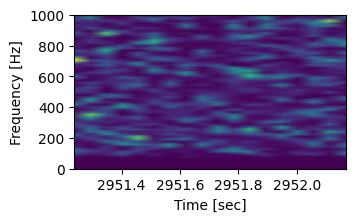

****************************************************************
Window sample No. 112
----------------------
Window initial time (in seconds):  2959.206787109375
Window end time (in seconds):  2960.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



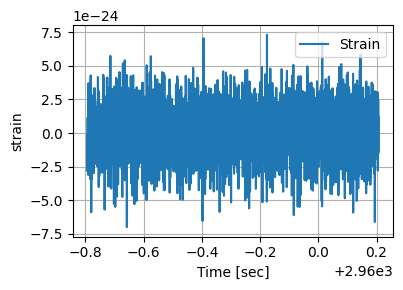

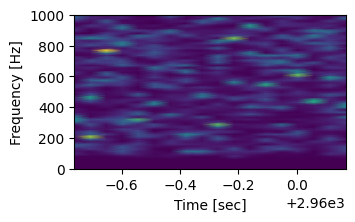

****************************************************************
Window sample No. 113
----------------------
Window initial time (in seconds):  2967.206787109375
Window end time (in seconds):  2968.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



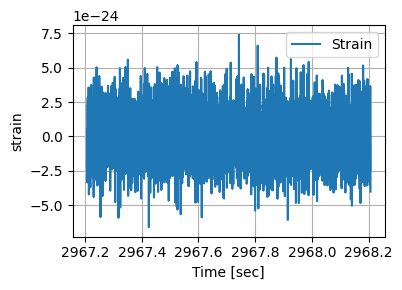

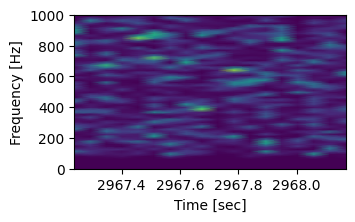

****************************************************************
Window sample No. 114
----------------------
Window initial time (in seconds):  2975.206787109375
Window end time (in seconds):  2976.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



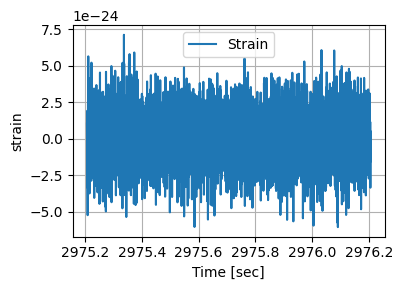

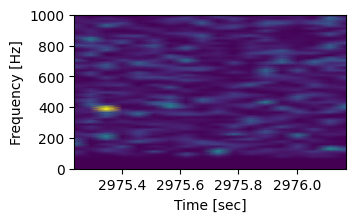

****************************************************************
Window sample No. 115
----------------------
Window initial time (in seconds):  2983.206787109375
Window end time (in seconds):  2984.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



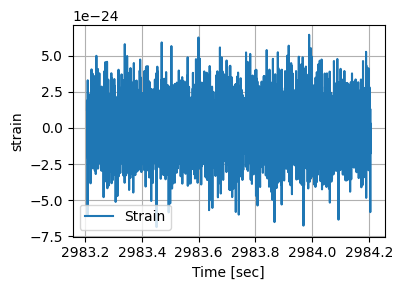

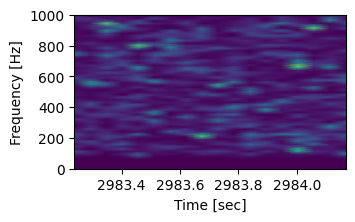

****************************************************************
Window sample No. 116
----------------------
Window initial time (in seconds):  2991.206787109375
Window end time (in seconds):  2992.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



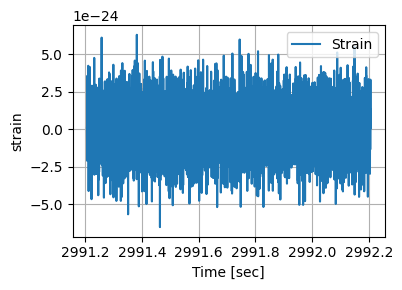

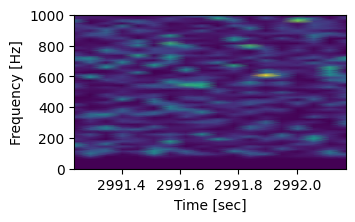

****************************************************************
Window sample No. 117
----------------------
Window initial time (in seconds):  2999.206787109375
Window end time (in seconds):  3000.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



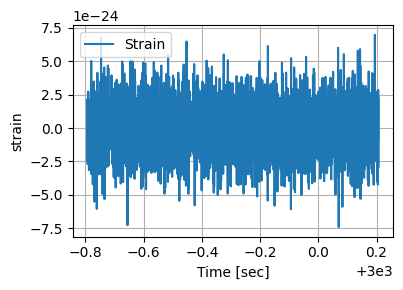

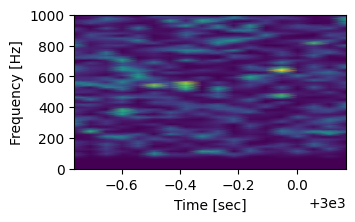

****************************************************************
Window sample No. 118
----------------------
Window initial time (in seconds):  3007.206787109375
Window end time (in seconds):  3008.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



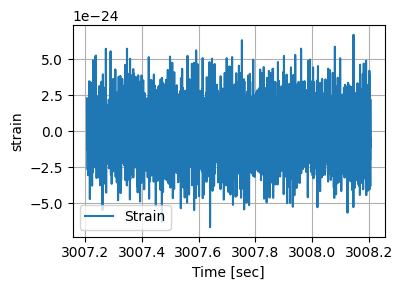

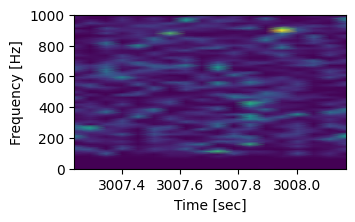

****************************************************************
Window sample No. 119
----------------------
Window initial time (in seconds):  3015.206787109375
Window end time (in seconds):  3016.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



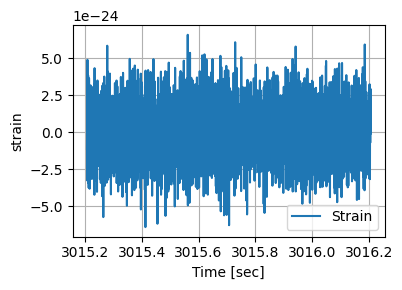

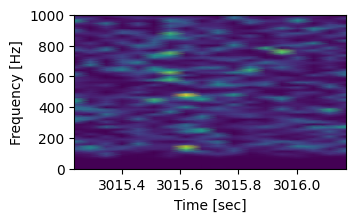

****************************************************************
Window sample No. 120
----------------------
Window initial time (in seconds):  3023.206787109375
Window end time (in seconds):  3024.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



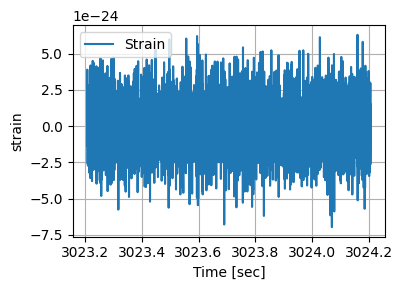

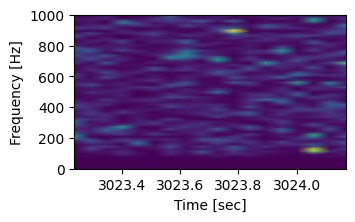

****************************************************************
Window sample No. 121
----------------------
Window initial time (in seconds):  3031.206787109375
Window end time (in seconds):  3032.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



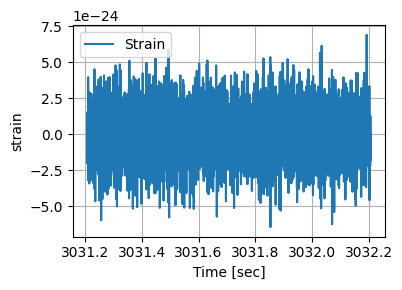

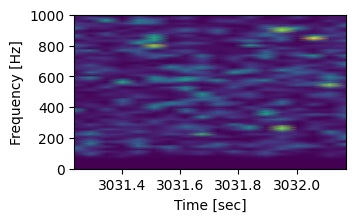

****************************************************************
Window sample No. 122
----------------------
Window initial time (in seconds):  3039.206787109375
Window end time (in seconds):  3040.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



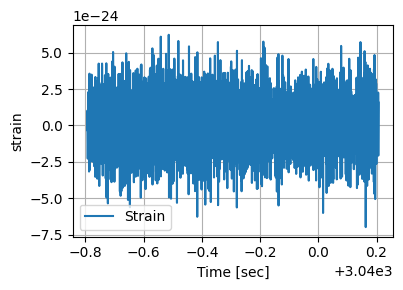

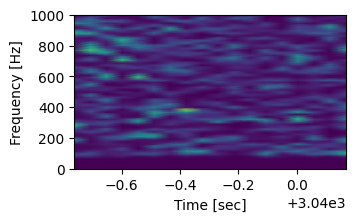

****************************************************************
Window sample No. 123
----------------------
Window initial time (in seconds):  3047.206787109375
Window end time (in seconds):  3048.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



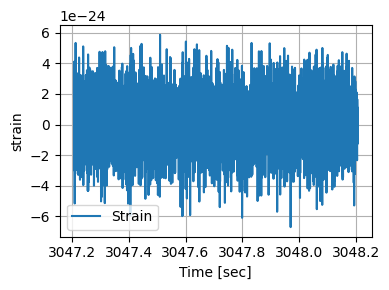

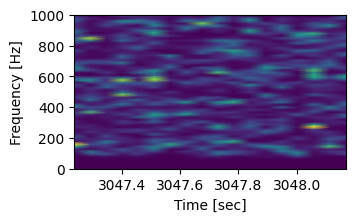

****************************************************************
Window sample No. 124
----------------------
Window initial time (in seconds):  3055.206787109375
Window end time (in seconds):  3056.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



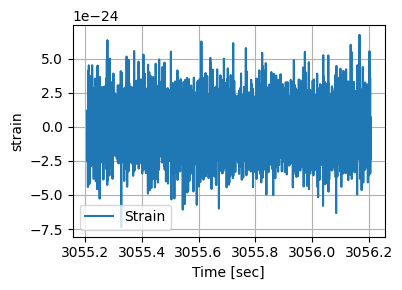

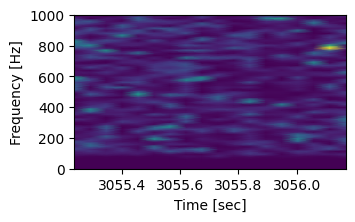

****************************************************************
Window sample No. 125
----------------------
Window initial time (in seconds):  3063.206787109375
Window end time (in seconds):  3064.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



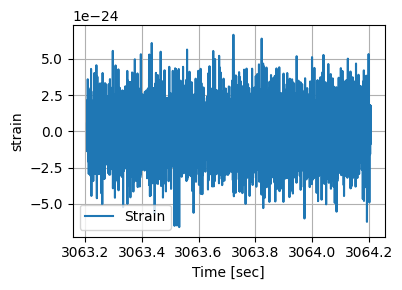

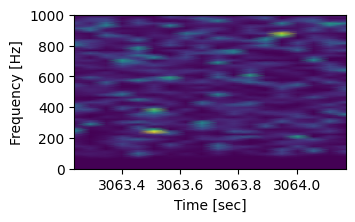

****************************************************************
Window sample No. 126
----------------------
Window initial time (in seconds):  3071.206787109375
Window end time (in seconds):  3072.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



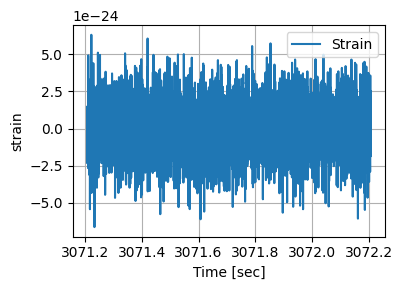

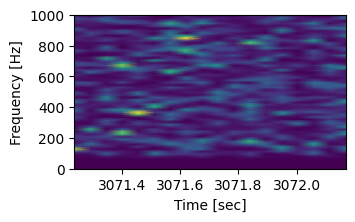

****************************************************************
Window sample No. 127
----------------------
Window initial time (in seconds):  3079.206787109375
Window end time (in seconds):  3080.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



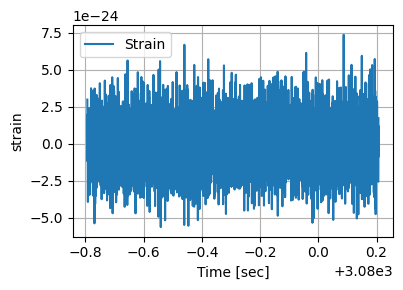

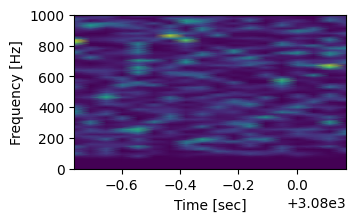

****************************************************************
Window sample No. 128
----------------------
Window initial time (in seconds):  3087.206787109375
Window end time (in seconds):  3088.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



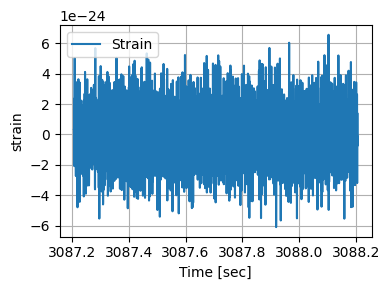

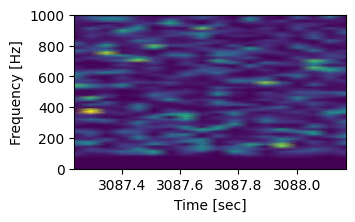

****************************************************************
Window sample No. 129
----------------------
Window initial time (in seconds):  3095.206787109375
Window end time (in seconds):  3096.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



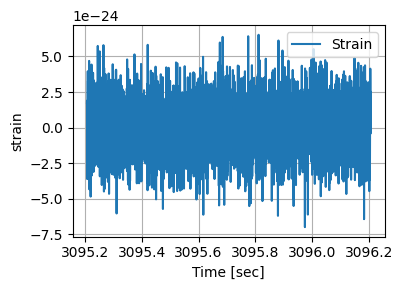

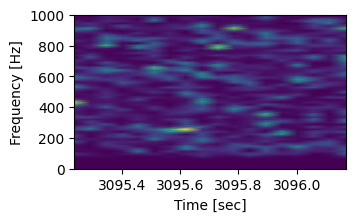

****************************************************************
Window sample No. 130
----------------------
Window initial time (in seconds):  3103.206787109375
Window end time (in seconds):  3104.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



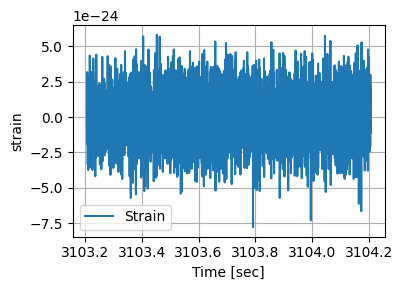

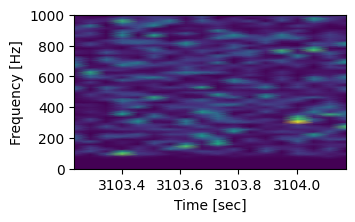

****************************************************************
Window sample No. 131
----------------------
Window initial time (in seconds):  3111.206787109375
Window end time (in seconds):  3112.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



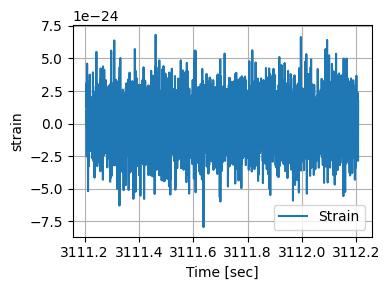

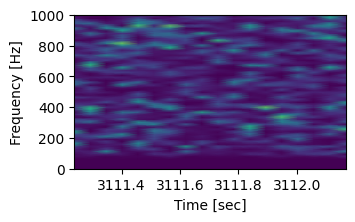

****************************************************************
Window sample No. 132
----------------------
Window initial time (in seconds):  3119.206787109375
Window end time (in seconds):  3120.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



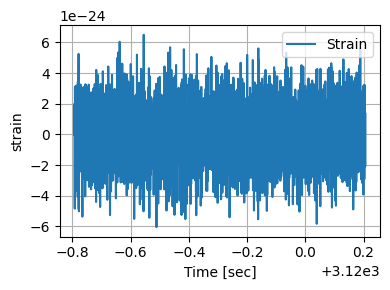

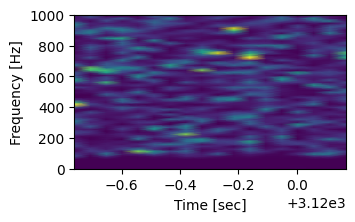

****************************************************************
Window sample No. 133
----------------------
Window initial time (in seconds):  3127.206787109375
Window end time (in seconds):  3128.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



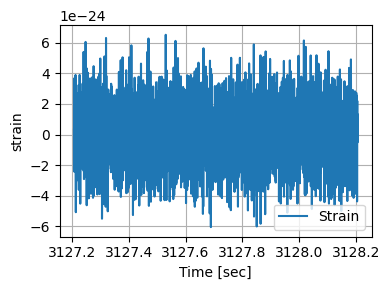

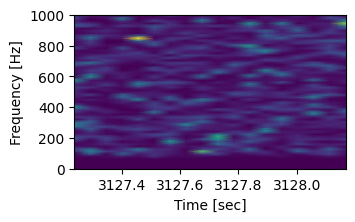

****************************************************************
Window sample No. 134
----------------------
Window initial time (in seconds):  3135.206787109375
Window end time (in seconds):  3136.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



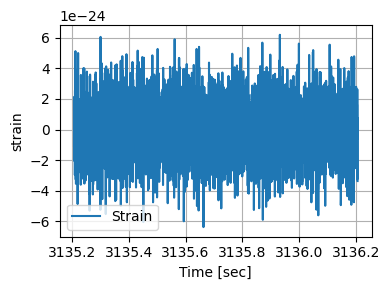

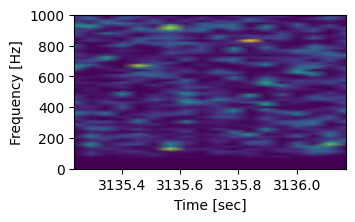

****************************************************************
Window sample No. 135
----------------------
Window initial time (in seconds):  3143.206787109375
Window end time (in seconds):  3144.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



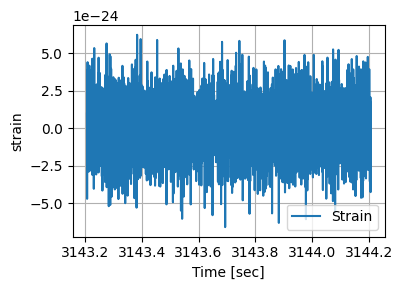

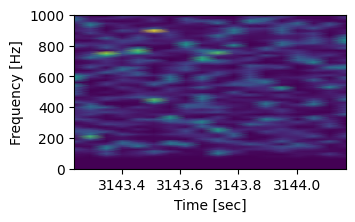

****************************************************************
Window sample No. 136
----------------------
Window initial time (in seconds):  3151.206787109375
Window end time (in seconds):  3152.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



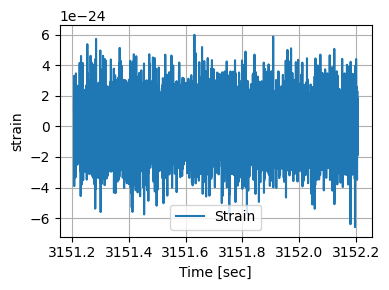

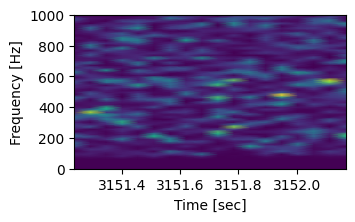

****************************************************************
Window sample No. 137
----------------------
Window initial time (in seconds):  3159.206787109375
Window end time (in seconds):  3160.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



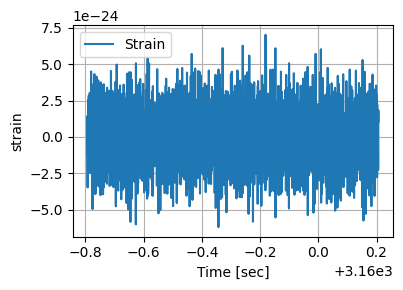

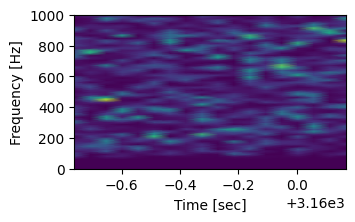

****************************************************************
Window sample No. 138
----------------------
Window initial time (in seconds):  3167.206787109375
Window end time (in seconds):  3168.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



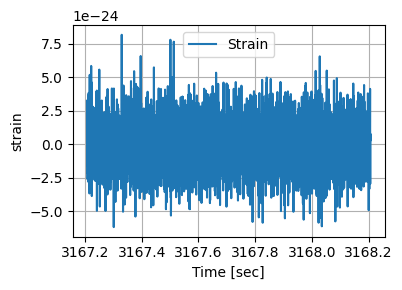

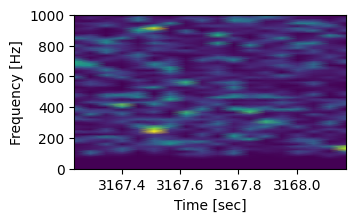

****************************************************************
Window sample No. 139
----------------------
Window initial time (in seconds):  3175.206787109375
Window end time (in seconds):  3176.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



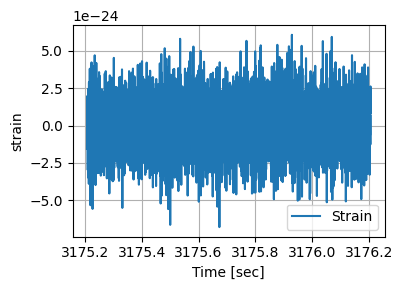

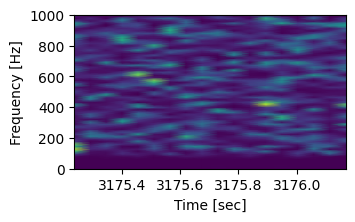

****************************************************************
Window sample No. 140
----------------------
Window initial time (in seconds):  3183.206787109375
Window end time (in seconds):  3184.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



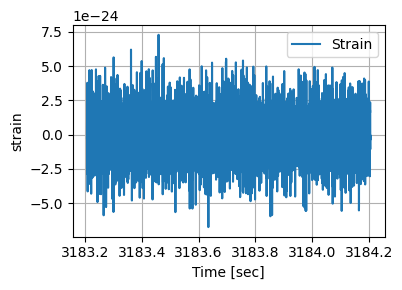

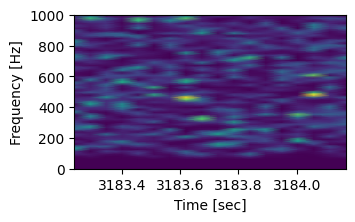

****************************************************************
Window sample No. 141
----------------------
Window initial time (in seconds):  3191.206787109375
Window end time (in seconds):  3192.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



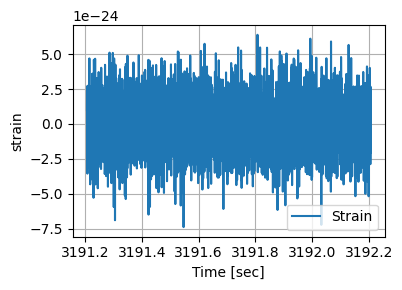

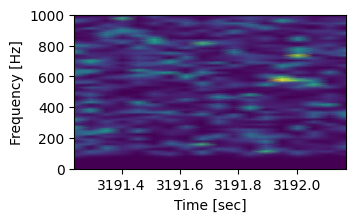

****************************************************************
Window sample No. 142
----------------------
Window initial time (in seconds):  3199.206787109375
Window end time (in seconds):  3200.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



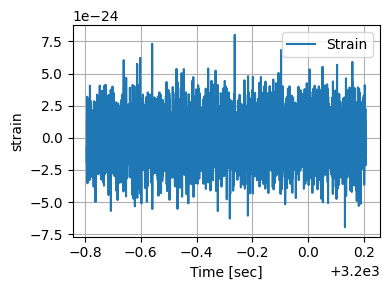

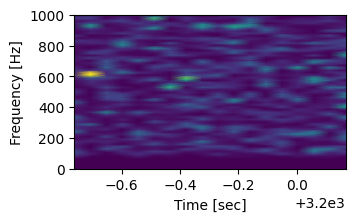

****************************************************************
Window sample No. 143
----------------------
Window initial time (in seconds):  3207.206787109375
Window end time (in seconds):  3208.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



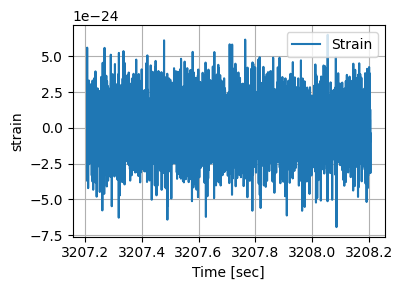

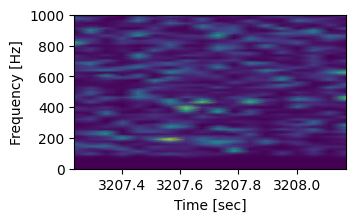

****************************************************************
Window sample No. 144
----------------------
Window initial time (in seconds):  3215.206787109375
Window end time (in seconds):  3216.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



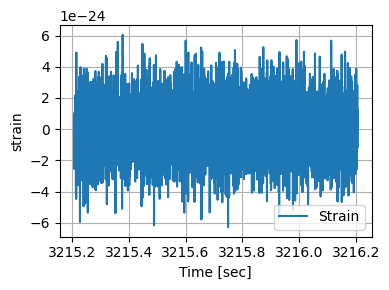

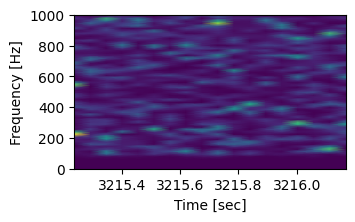

****************************************************************
Window sample No. 145
----------------------
Window initial time (in seconds):  3223.206787109375
Window end time (in seconds):  3224.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



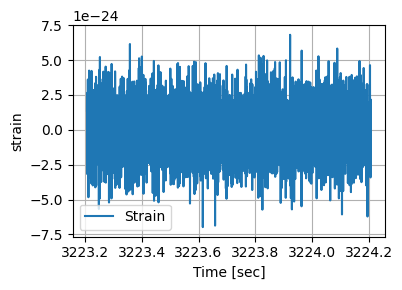

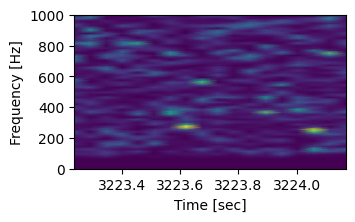

****************************************************************
Window sample No. 146
----------------------
Window initial time (in seconds):  3231.206787109375
Window end time (in seconds):  3232.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



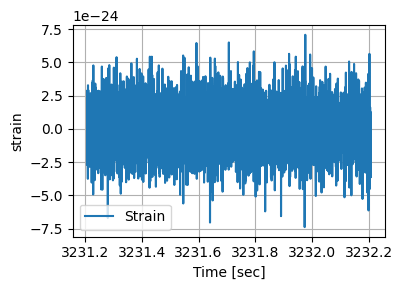

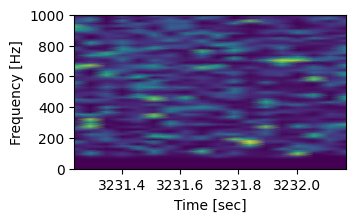

****************************************************************
Window sample No. 147
----------------------
Window initial time (in seconds):  3239.206787109375
Window end time (in seconds):  3240.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



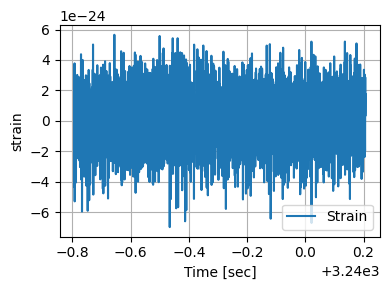

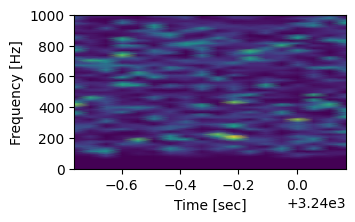

****************************************************************
Window sample No. 148
----------------------
Window initial time (in seconds):  3247.206787109375
Window end time (in seconds):  3248.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



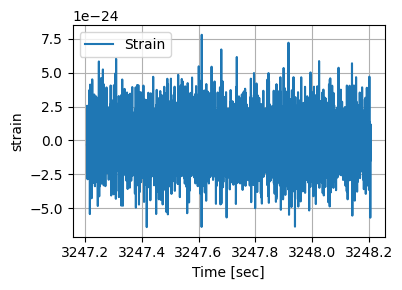

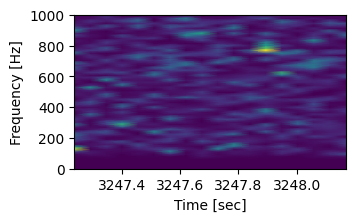

****************************************************************
Window sample No. 149
----------------------
Window initial time (in seconds):  3255.206787109375
Window end time (in seconds):  3256.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



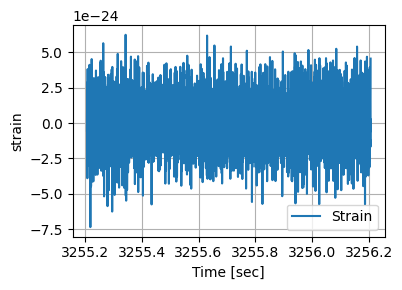

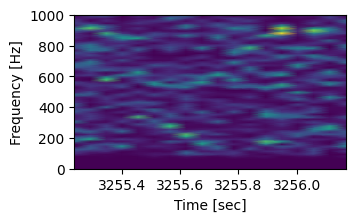

****************************************************************
Window sample No. 150
----------------------
Window initial time (in seconds):  3263.206787109375
Window end time (in seconds):  3264.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



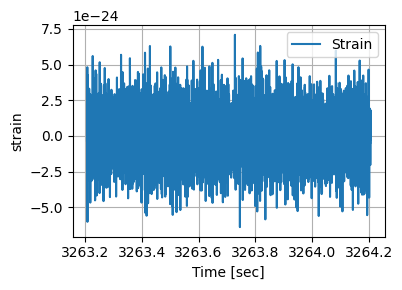

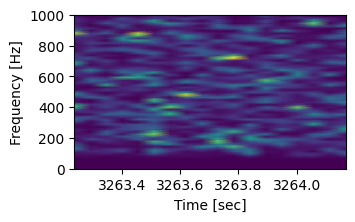

****************************************************************
Window sample No. 151
----------------------
Window initial time (in seconds):  3271.206787109375
Window end time (in seconds):  3272.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



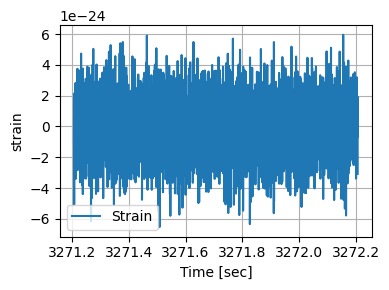

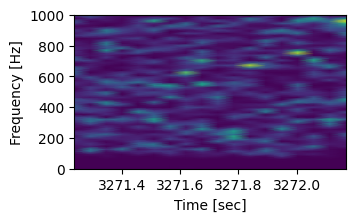

****************************************************************
Window sample No. 152
----------------------
Window initial time (in seconds):  3279.206787109375
Window end time (in seconds):  3280.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



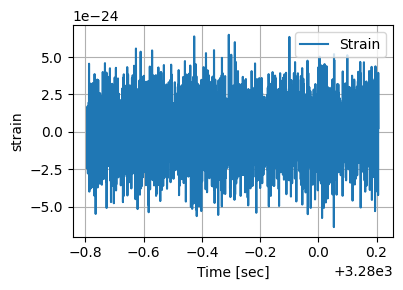

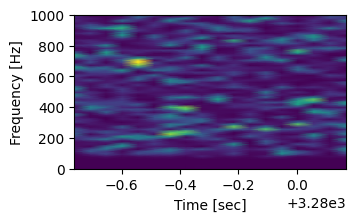

****************************************************************
Window sample No. 153
----------------------
Window initial time (in seconds):  3287.206787109375
Window end time (in seconds):  3288.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



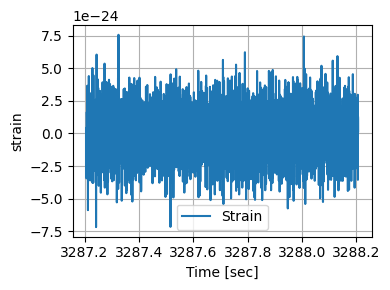

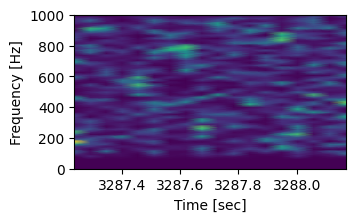

****************************************************************
Window sample No. 154
----------------------
Window initial time (in seconds):  3295.206787109375
Window end time (in seconds):  3296.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



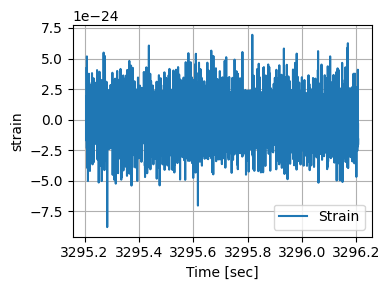

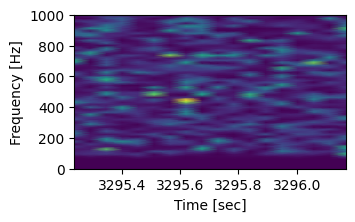

****************************************************************
Window sample No. 155
----------------------
Window initial time (in seconds):  3303.206787109375
Window end time (in seconds):  3304.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



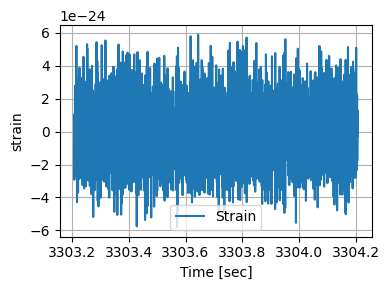

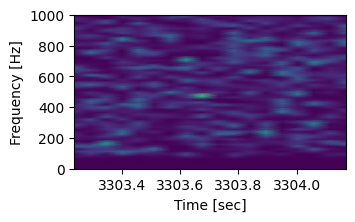

****************************************************************
Window sample No. 156
----------------------
Window initial time (in seconds):  3311.206787109375
Window end time (in seconds):  3312.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



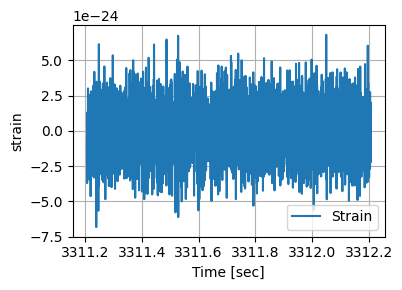

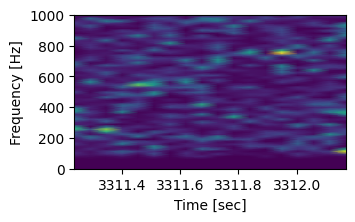

****************************************************************
Window sample No. 157
----------------------
Window initial time (in seconds):  3319.206787109375
Window end time (in seconds):  3320.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



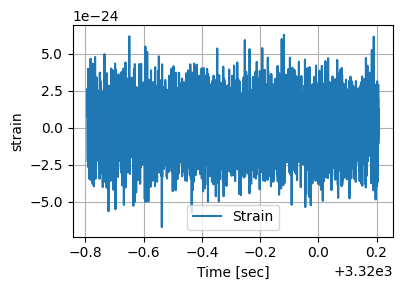

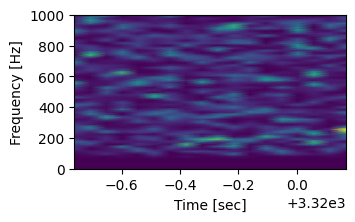

****************************************************************
Window sample No. 158
----------------------
Window initial time (in seconds):  3327.206787109375
Window end time (in seconds):  3328.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



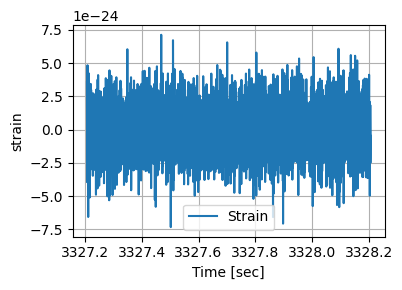

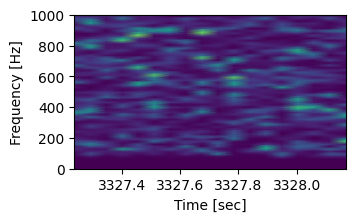

****************************************************************
Window sample No. 159
----------------------
Window initial time (in seconds):  3335.206787109375
Window end time (in seconds):  3336.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



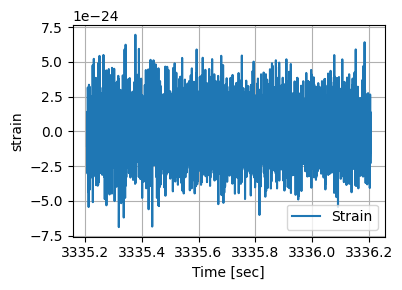

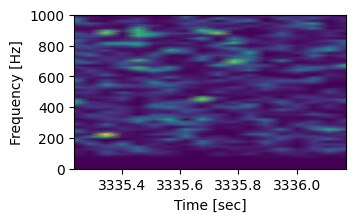

****************************************************************
Window sample No. 160
----------------------
Window initial time (in seconds):  3343.206787109375
Window end time (in seconds):  3344.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



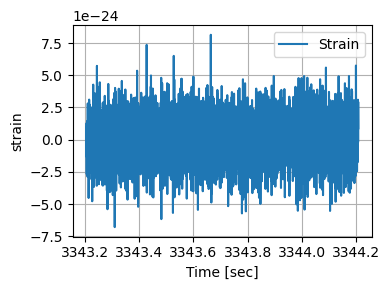

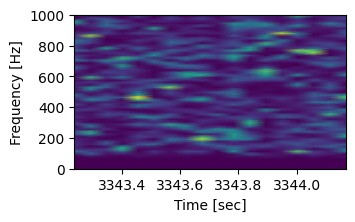

****************************************************************
Window sample No. 161
----------------------
Window initial time (in seconds):  3351.206787109375
Window end time (in seconds):  3352.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



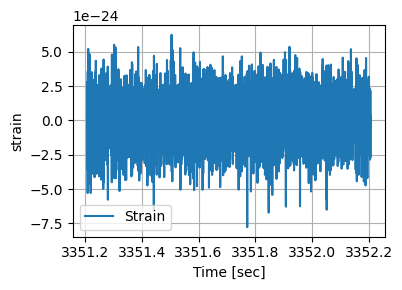

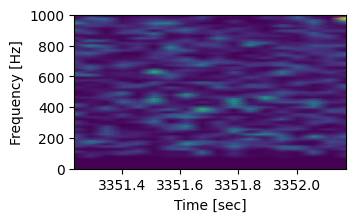

****************************************************************
Window sample No. 162
----------------------
Window initial time (in seconds):  3359.206787109375
Window end time (in seconds):  3360.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



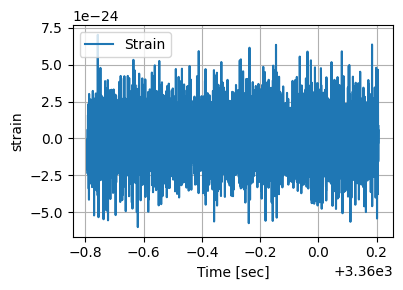

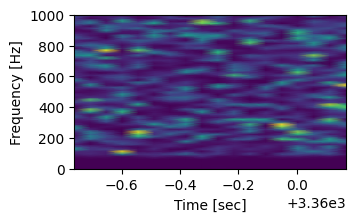

****************************************************************
Window sample No. 163
----------------------
Window initial time (in seconds):  3367.206787109375
Window end time (in seconds):  3368.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



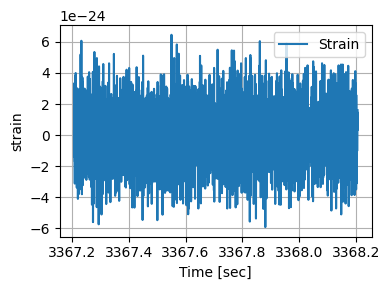

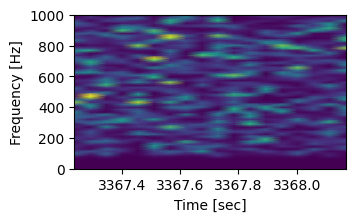

****************************************************************
Window sample No. 164
----------------------
Window initial time (in seconds):  3375.206787109375
Window end time (in seconds):  3376.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



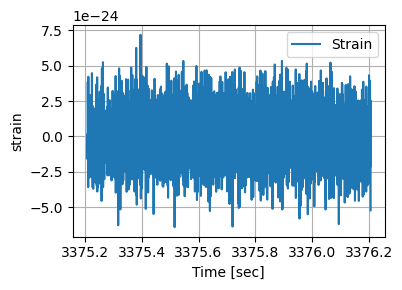

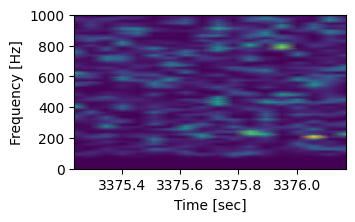

****************************************************************
Window sample No. 165
----------------------
Window initial time (in seconds):  3383.206787109375
Window end time (in seconds):  3384.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



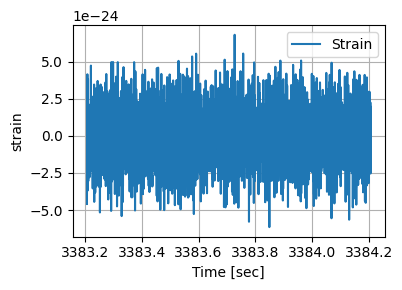

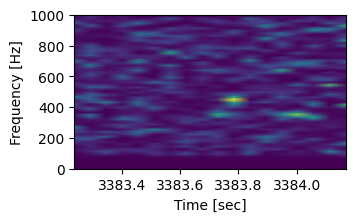

****************************************************************
Window sample No. 166
----------------------
Window initial time (in seconds):  3391.206787109375
Window end time (in seconds):  3392.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



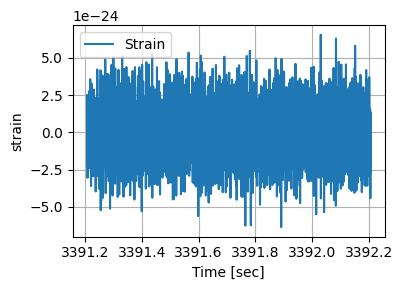

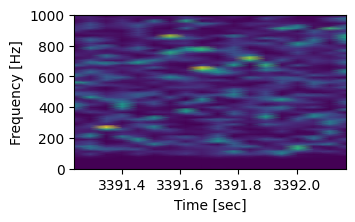

****************************************************************
Window sample No. 167
----------------------
Window initial time (in seconds):  3399.206787109375
Window end time (in seconds):  3400.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



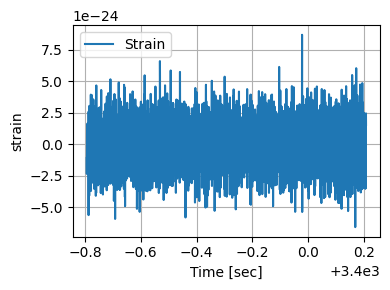

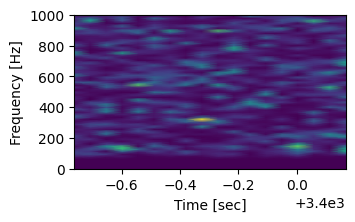

****************************************************************
Window sample No. 168
----------------------
Window initial time (in seconds):  3407.206787109375
Window end time (in seconds):  3408.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



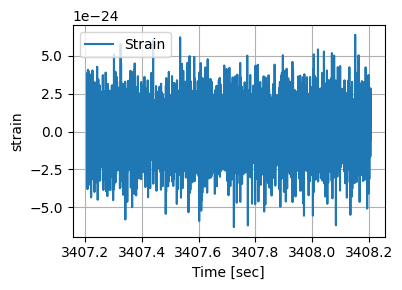

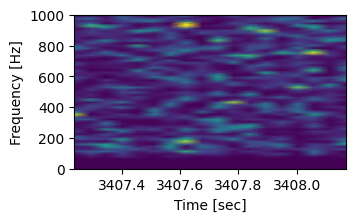

****************************************************************
Window sample No. 169
----------------------
Window initial time (in seconds):  3415.206787109375
Window end time (in seconds):  3416.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



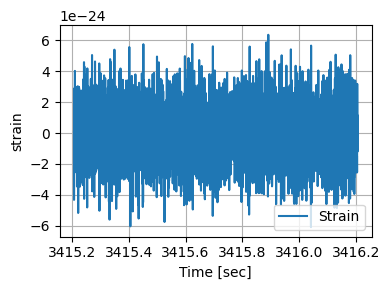

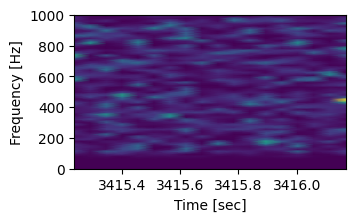

****************************************************************
Window sample No. 170
----------------------
Window initial time (in seconds):  3423.206787109375
Window end time (in seconds):  3424.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



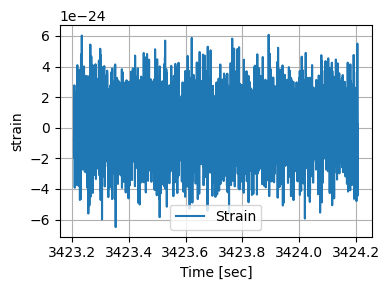

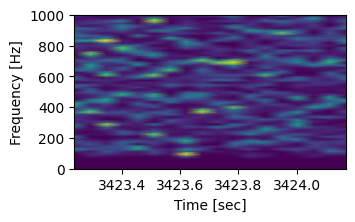

****************************************************************
Window sample No. 171
----------------------
Window initial time (in seconds):  3431.206787109375
Window end time (in seconds):  3432.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



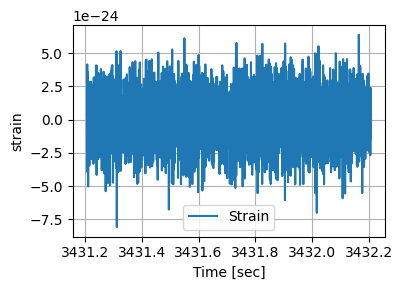

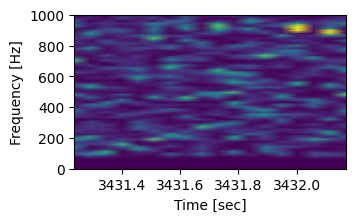

****************************************************************
Window sample No. 172
----------------------
Window initial time (in seconds):  3439.206787109375
Window end time (in seconds):  3440.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



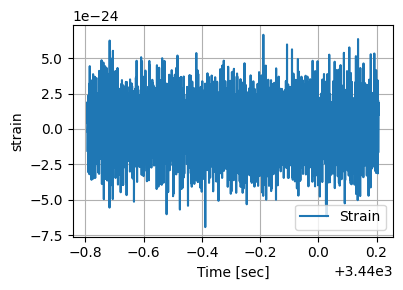

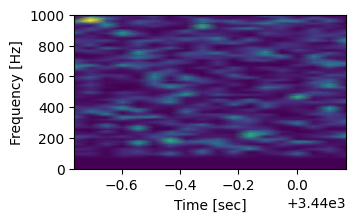

****************************************************************
Window sample No. 173
----------------------
Window initial time (in seconds):  3447.206787109375
Window end time (in seconds):  3448.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



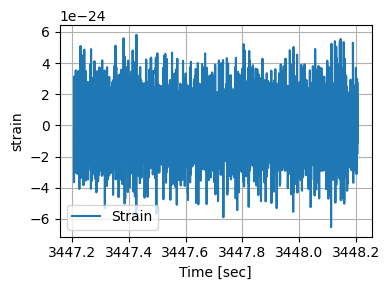

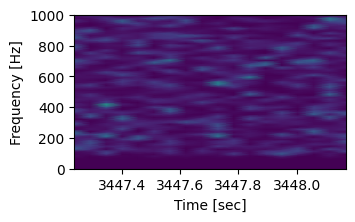

****************************************************************
Window sample No. 174
----------------------
Window initial time (in seconds):  3455.206787109375
Window end time (in seconds):  3456.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



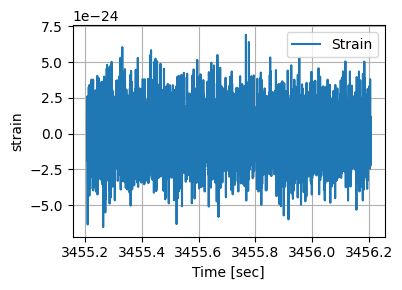

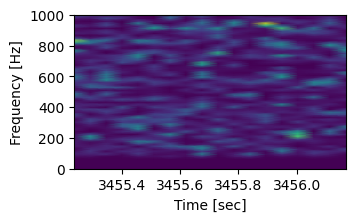

****************************************************************
Window sample No. 175
----------------------
Window initial time (in seconds):  3463.206787109375
Window end time (in seconds):  3464.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



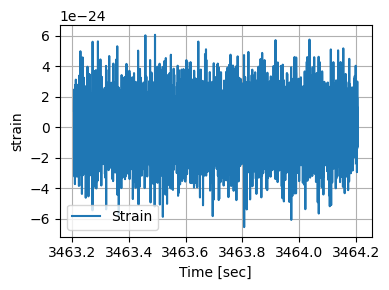

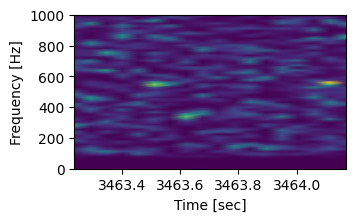

****************************************************************
Window sample No. 176
----------------------
Window initial time (in seconds):  3471.206787109375
Window end time (in seconds):  3472.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



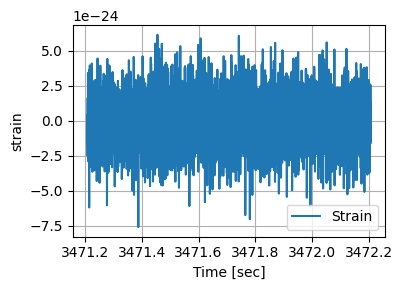

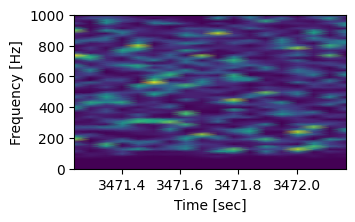

****************************************************************
Window sample No. 177
----------------------
Window initial time (in seconds):  3479.206787109375
Window end time (in seconds):  3480.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



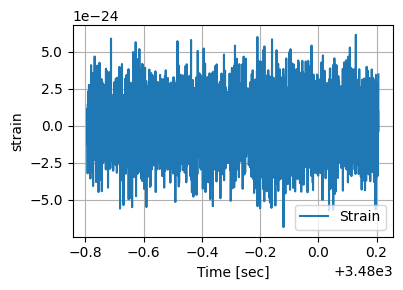

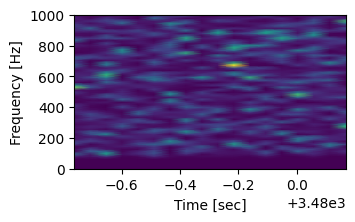

****************************************************************
Window sample No. 178
----------------------
Window initial time (in seconds):  3487.206787109375
Window end time (in seconds):  3488.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



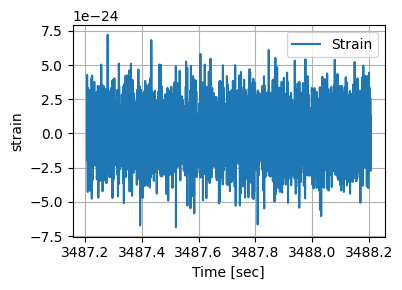

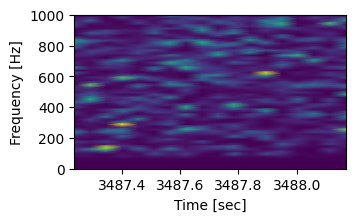

****************************************************************
Window sample No. 179
----------------------
Window initial time (in seconds):  3495.206787109375
Window end time (in seconds):  3496.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



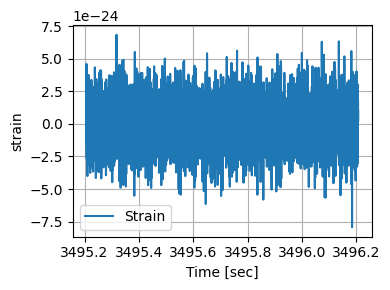

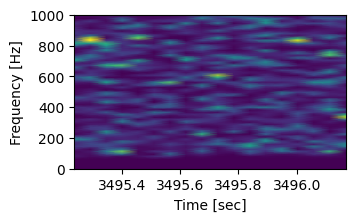

****************************************************************
Window sample No. 180
----------------------
Window initial time (in seconds):  3503.206787109375
Window end time (in seconds):  3504.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



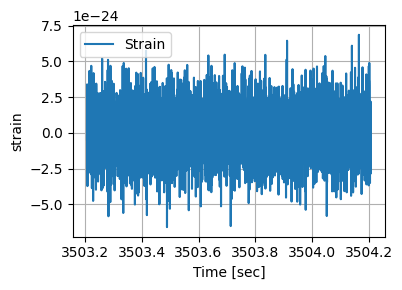

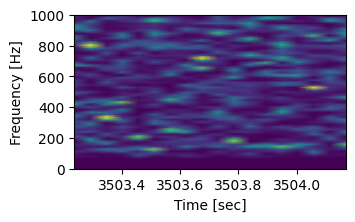

****************************************************************
Window sample No. 181
----------------------
Window initial time (in seconds):  3511.206787109375
Window end time (in seconds):  3512.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



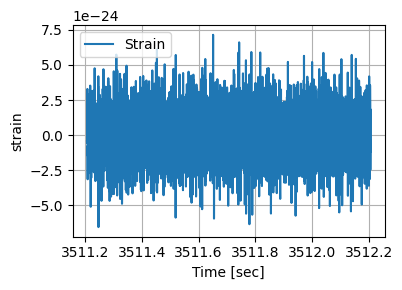

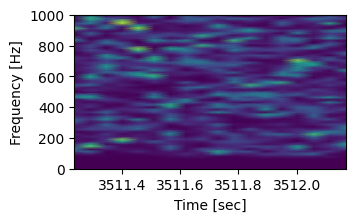

****************************************************************
Window sample No. 182
----------------------
Window initial time (in seconds):  3519.206787109375
Window end time (in seconds):  3520.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



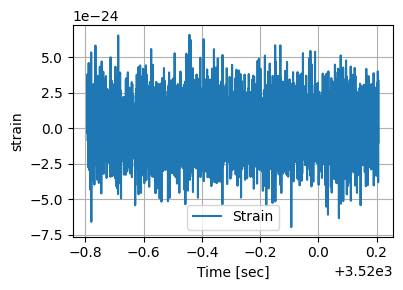

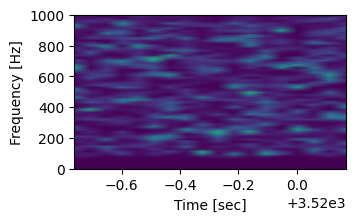

****************************************************************
Window sample No. 183
----------------------
Window initial time (in seconds):  3527.206787109375
Window end time (in seconds):  3528.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



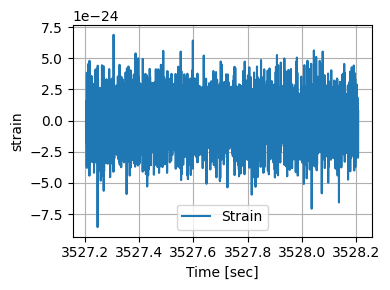

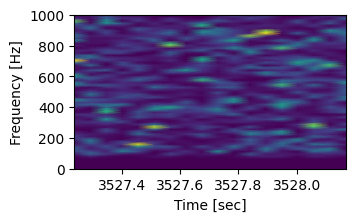

****************************************************************
Window sample No. 184
----------------------
Window initial time (in seconds):  3535.206787109375
Window end time (in seconds):  3536.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



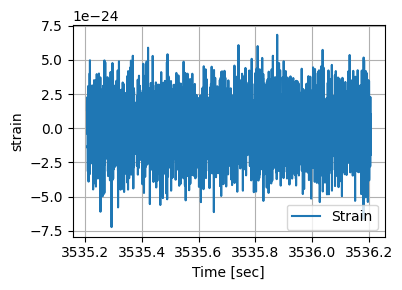

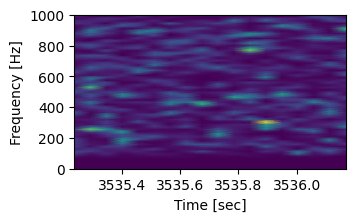

****************************************************************
Window sample No. 185
----------------------
Window initial time (in seconds):  3543.206787109375
Window end time (in seconds):  3544.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



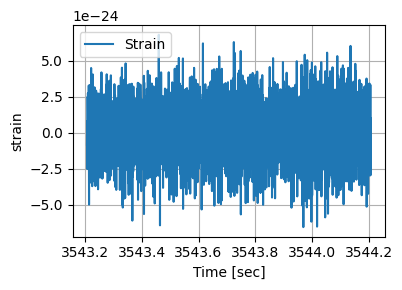

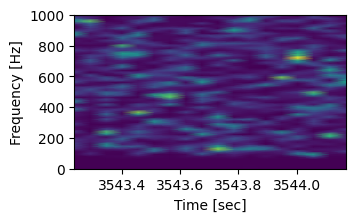

****************************************************************
Window sample No. 186
----------------------
Window initial time (in seconds):  3551.206787109375
Window end time (in seconds):  3552.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



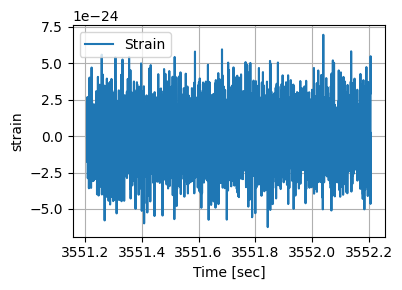

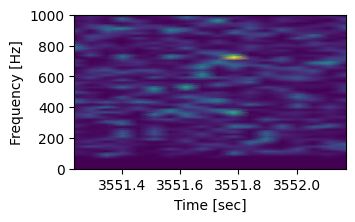

****************************************************************
Window sample No. 187
----------------------
Window initial time (in seconds):  3559.206787109375
Window end time (in seconds):  3560.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



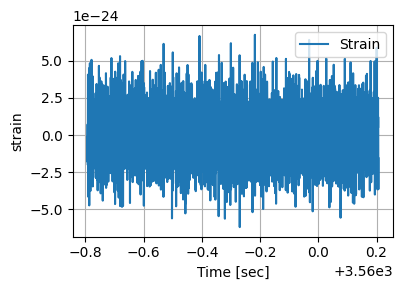

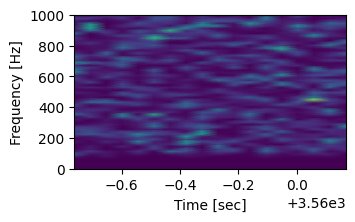

****************************************************************
Window sample No. 188
----------------------
Window initial time (in seconds):  3567.206787109375
Window end time (in seconds):  3568.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



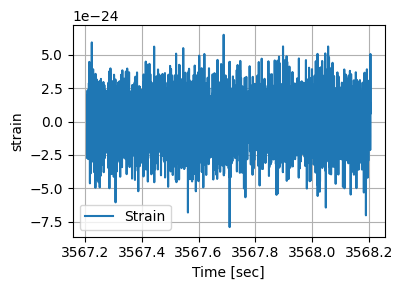

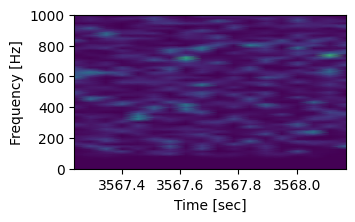

****************************************************************
Window sample No. 189
----------------------
Window initial time (in seconds):  3575.206787109375
Window end time (in seconds):  3576.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



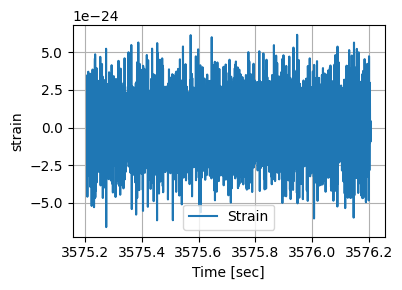

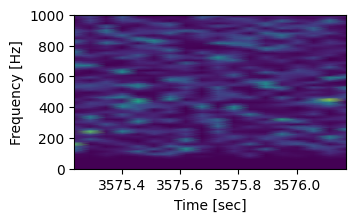

****************************************************************
Window sample No. 190
----------------------
Window initial time (in seconds):  3583.206787109375
Window end time (in seconds):  3584.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



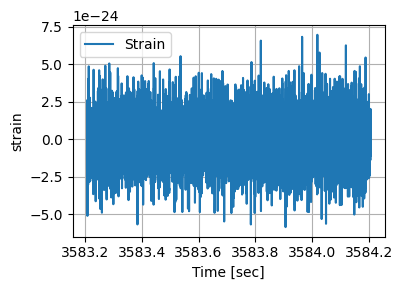

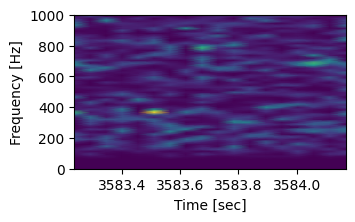

****************************************************************
Window sample No. 191
----------------------
Window initial time (in seconds):  3591.206787109375
Window end time (in seconds):  3592.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



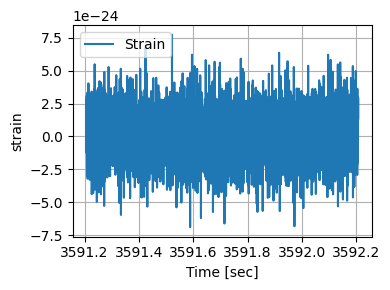

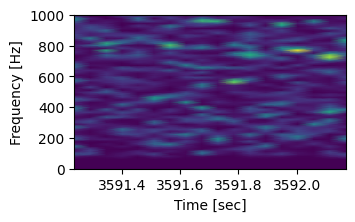

****************************************************************
Window sample No. 192
----------------------
Window initial time (in seconds):  3599.206787109375
Window end time (in seconds):  3600.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



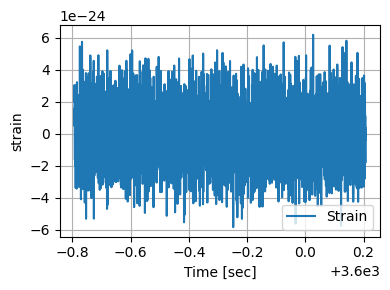

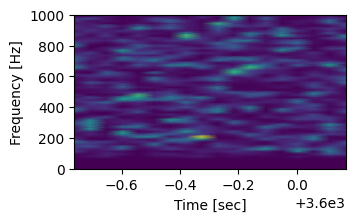

****************************************************************
Window sample No. 193
----------------------
Window initial time (in seconds):  3607.206787109375
Window end time (in seconds):  3608.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



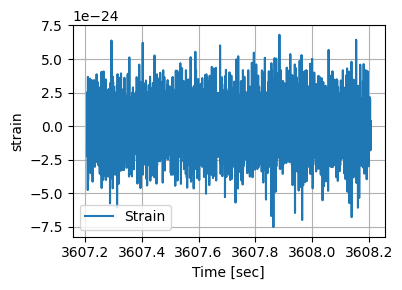

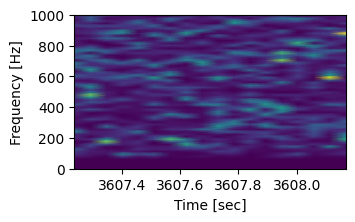

****************************************************************
Window sample No. 194
----------------------
Window initial time (in seconds):  3615.206787109375
Window end time (in seconds):  3616.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



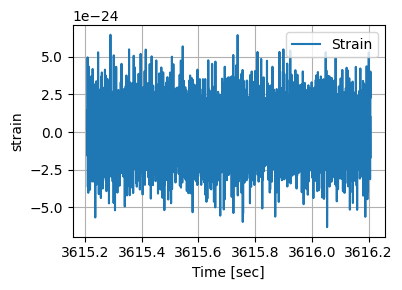

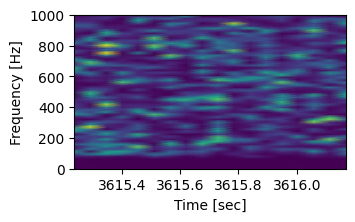

****************************************************************
Window sample No. 195
----------------------
Window initial time (in seconds):  3623.206787109375
Window end time (in seconds):  3624.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



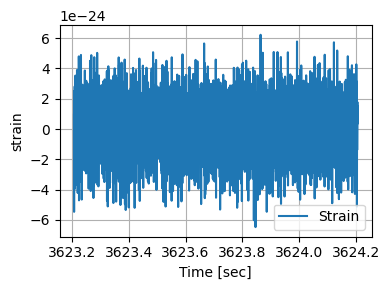

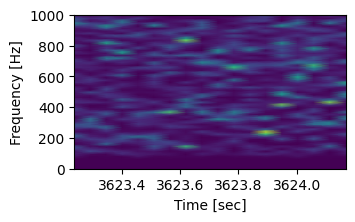

****************************************************************
Window sample No. 196
----------------------
Window initial time (in seconds):  3631.206787109375
Window end time (in seconds):  3632.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



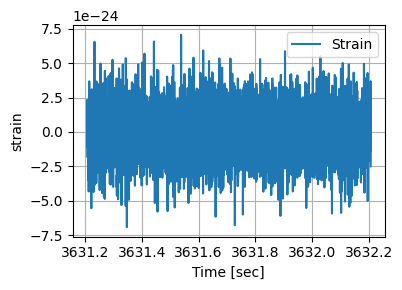

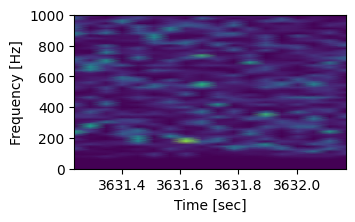

****************************************************************
Window sample No. 197
----------------------
Window initial time (in seconds):  3639.206787109375
Window end time (in seconds):  3640.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



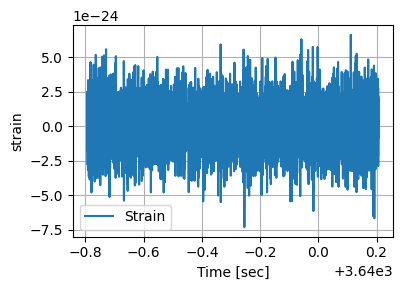

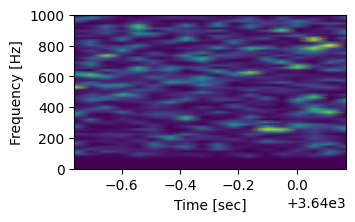

****************************************************************
Window sample No. 198
----------------------
Window initial time (in seconds):  3647.206787109375
Window end time (in seconds):  3648.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



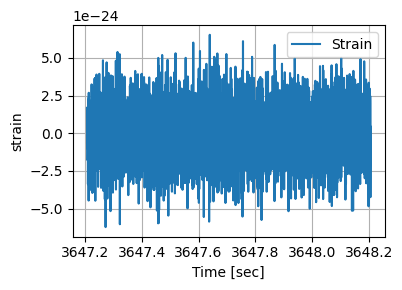

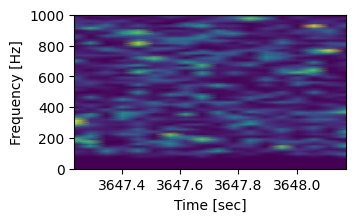

****************************************************************
Window sample No. 199
----------------------
Window initial time (in seconds):  3655.206787109375
Window end time (in seconds):  3656.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



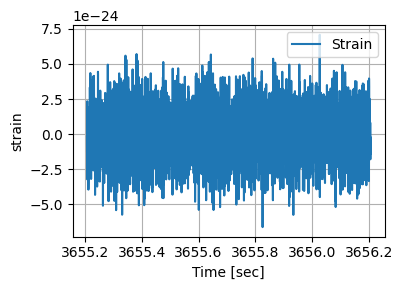

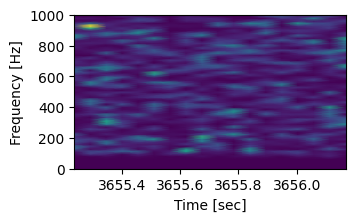

****************************************************************
Window sample No. 200
----------------------
Window initial time (in seconds):  3663.206787109375
Window end time (in seconds):  3664.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



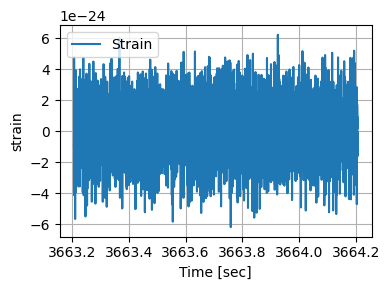

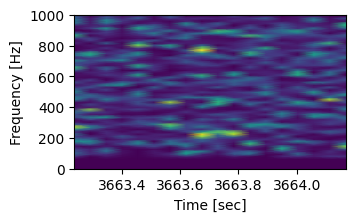

****************************************************************
Window sample No. 201
----------------------
Window initial time (in seconds):  3671.206787109375
Window end time (in seconds):  3672.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



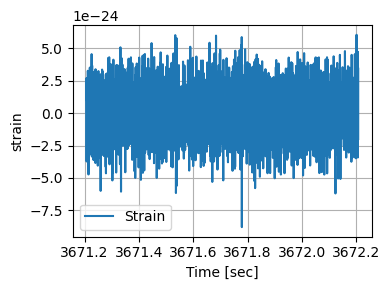

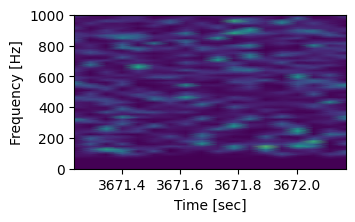

****************************************************************
Window sample No. 202
----------------------
Window initial time (in seconds):  3679.206787109375
Window end time (in seconds):  3680.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



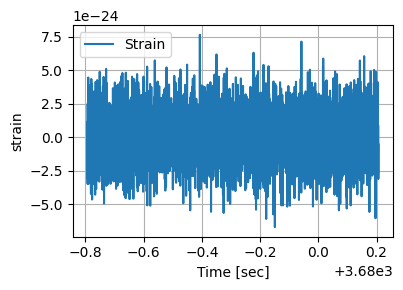

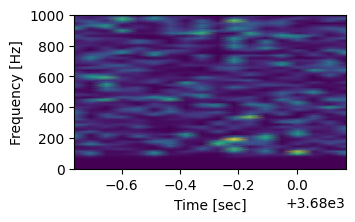

****************************************************************
Window sample No. 203
----------------------
Window initial time (in seconds):  3687.206787109375
Window end time (in seconds):  3688.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



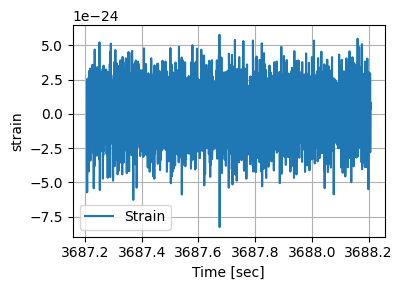

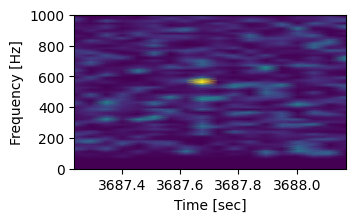

****************************************************************
Window sample No. 204
----------------------
Window initial time (in seconds):  3695.206787109375
Window end time (in seconds):  3696.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



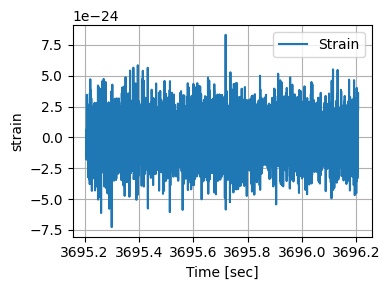

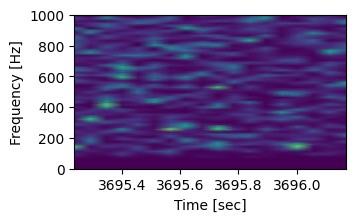

****************************************************************
Window sample No. 205
----------------------
Window initial time (in seconds):  3703.206787109375
Window end time (in seconds):  3704.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



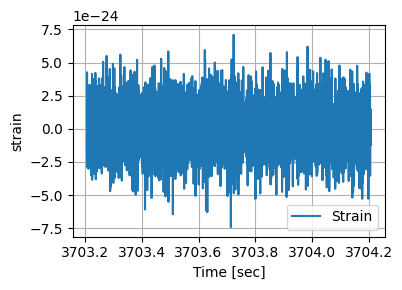

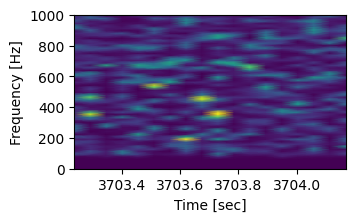

****************************************************************
Window sample No. 206
----------------------
Window initial time (in seconds):  3711.206787109375
Window end time (in seconds):  3712.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



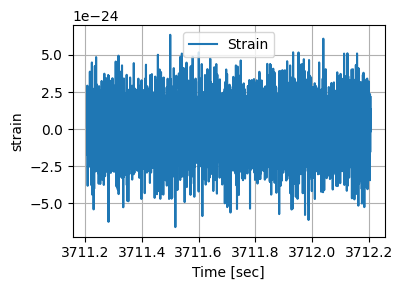

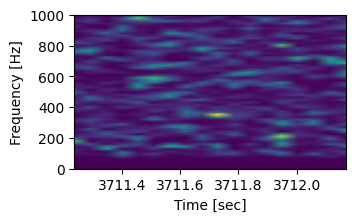

****************************************************************
Window sample No. 207
----------------------
Window initial time (in seconds):  3719.206787109375
Window end time (in seconds):  3720.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



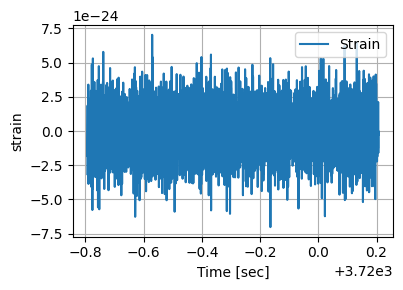

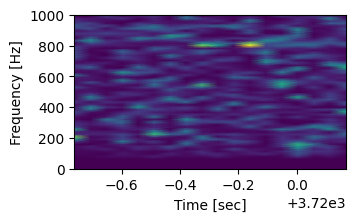

****************************************************************
Window sample No. 208
----------------------
Window initial time (in seconds):  3727.206787109375
Window end time (in seconds):  3728.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



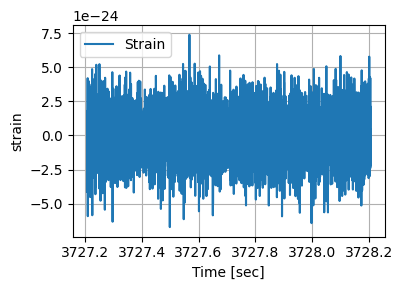

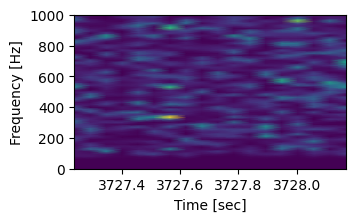

****************************************************************
Window sample No. 209
----------------------
Window initial time (in seconds):  3735.206787109375
Window end time (in seconds):  3736.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



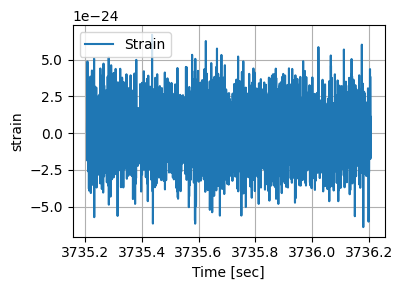

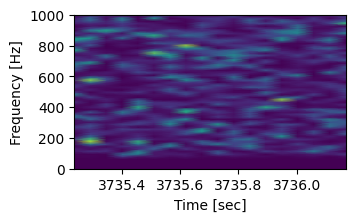

****************************************************************
Window sample No. 210
----------------------
Window initial time (in seconds):  3743.206787109375
Window end time (in seconds):  3744.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



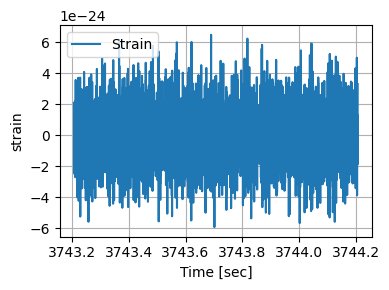

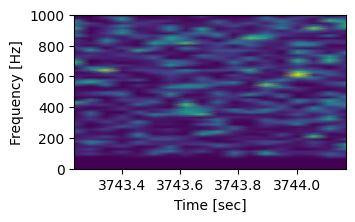

****************************************************************
Window sample No. 211
----------------------
Window initial time (in seconds):  3751.206787109375
Window end time (in seconds):  3752.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



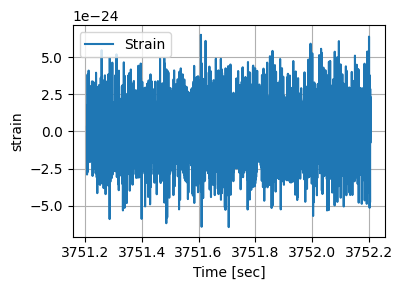

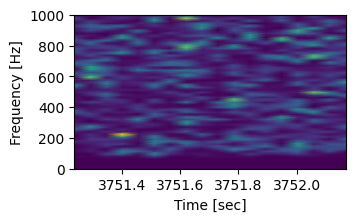

****************************************************************
Window sample No. 212
----------------------
Window initial time (in seconds):  3759.206787109375
Window end time (in seconds):  3760.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



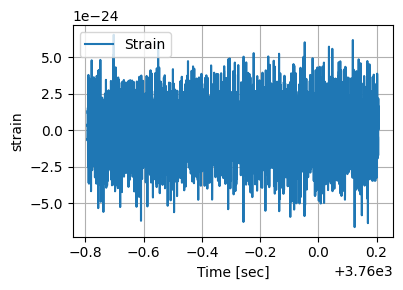

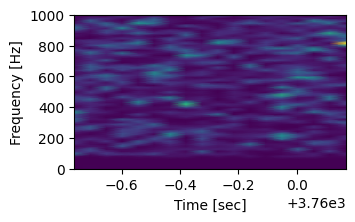

****************************************************************
Window sample No. 213
----------------------
Window initial time (in seconds):  3767.206787109375
Window end time (in seconds):  3768.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



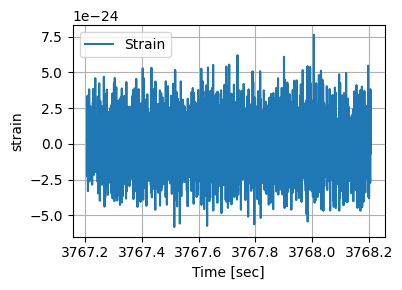

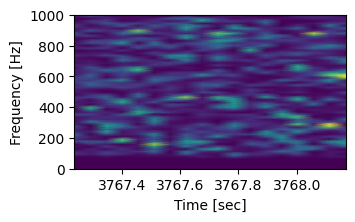

****************************************************************
Window sample No. 214
----------------------
Window initial time (in seconds):  3775.206787109375
Window end time (in seconds):  3776.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



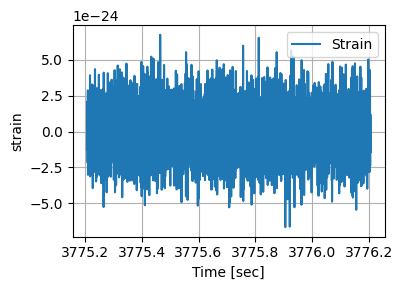

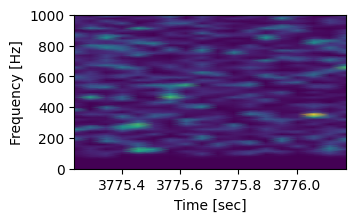

****************************************************************
Window sample No. 215
----------------------
Window initial time (in seconds):  3783.206787109375
Window end time (in seconds):  3784.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



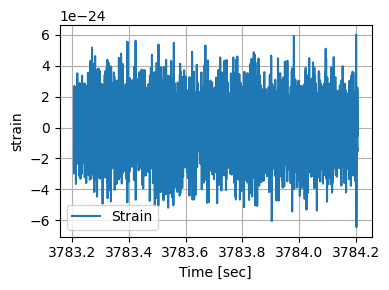

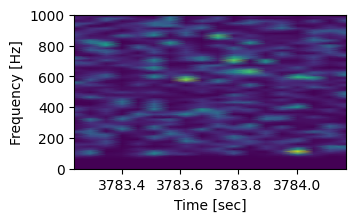

****************************************************************
Window sample No. 216
----------------------
Window initial time (in seconds):  3791.206787109375
Window end time (in seconds):  3792.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



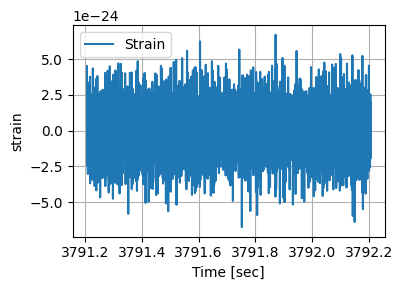

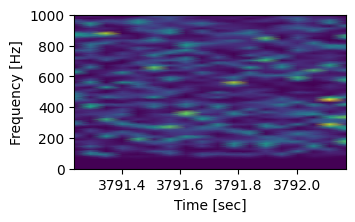

****************************************************************
Window sample No. 217
----------------------
Window initial time (in seconds):  3799.206787109375
Window end time (in seconds):  3800.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



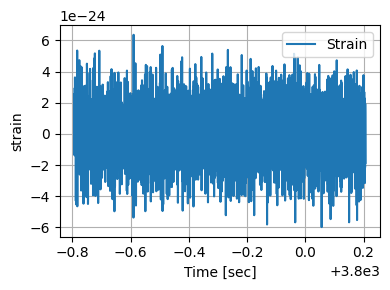

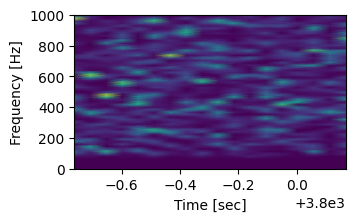

****************************************************************
Window sample No. 218
----------------------
Window initial time (in seconds):  3807.206787109375
Window end time (in seconds):  3808.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



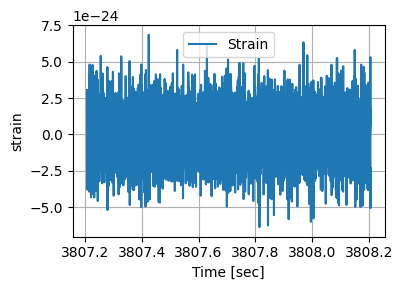

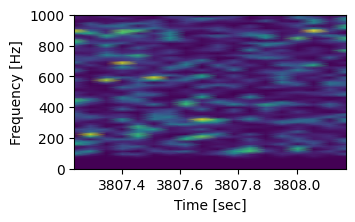

****************************************************************
Window sample No. 219
----------------------
Window initial time (in seconds):  3815.206787109375
Window end time (in seconds):  3816.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



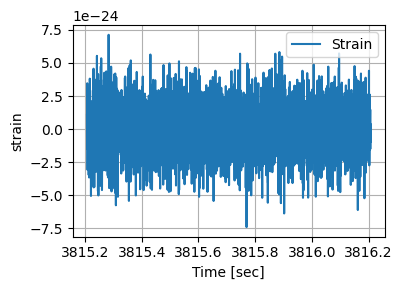

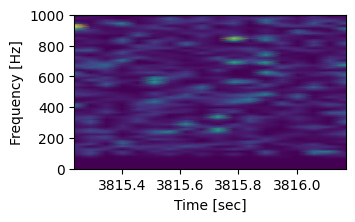

****************************************************************
Window sample No. 220
----------------------
Window initial time (in seconds):  3823.206787109375
Window end time (in seconds):  3824.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



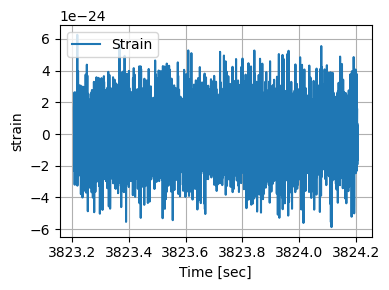

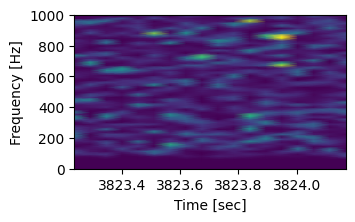

****************************************************************
Window sample No. 221
----------------------
Window initial time (in seconds):  3831.206787109375
Window end time (in seconds):  3832.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



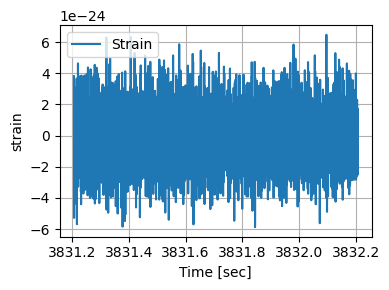

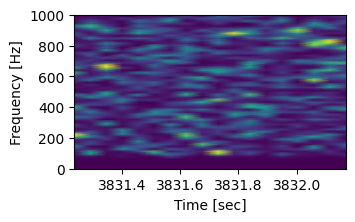

****************************************************************
Window sample No. 222
----------------------
Window initial time (in seconds):  3839.206787109375
Window end time (in seconds):  3840.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



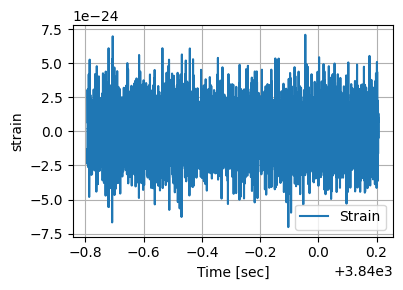

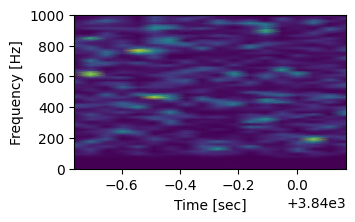

****************************************************************
Window sample No. 223
----------------------
Window initial time (in seconds):  3847.206787109375
Window end time (in seconds):  3848.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



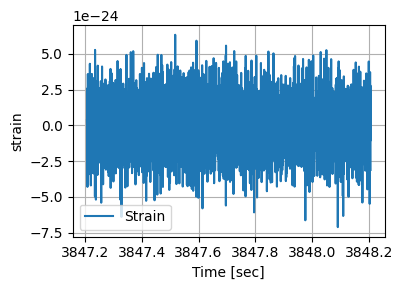

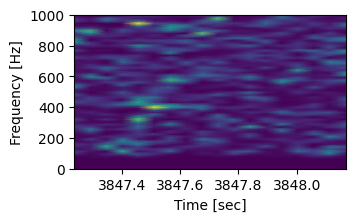

****************************************************************
Window sample No. 224
----------------------
Window initial time (in seconds):  3855.206787109375
Window end time (in seconds):  3856.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



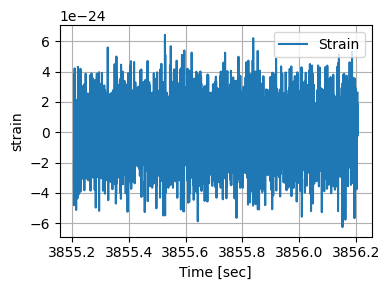

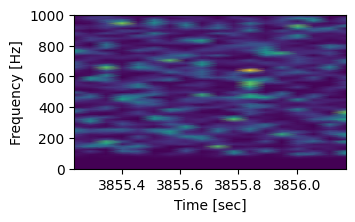

****************************************************************
Window sample No. 225
----------------------
Window initial time (in seconds):  3863.206787109375
Window end time (in seconds):  3864.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



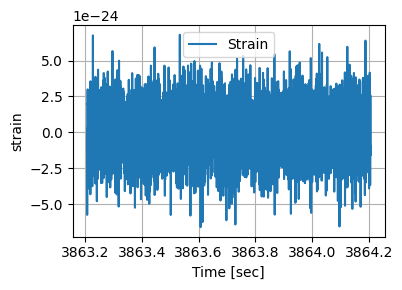

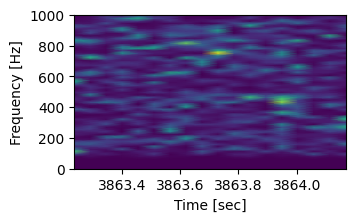

****************************************************************
Window sample No. 226
----------------------
Window initial time (in seconds):  3871.206787109375
Window end time (in seconds):  3872.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



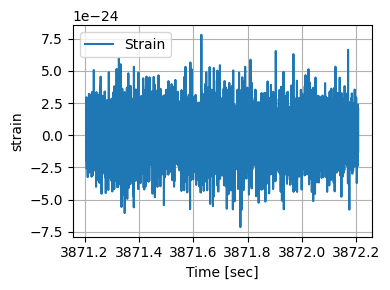

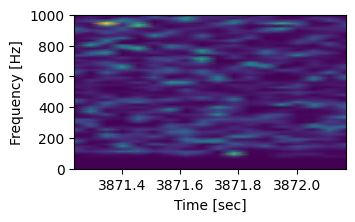

****************************************************************
Window sample No. 227
----------------------
Window initial time (in seconds):  3879.206787109375
Window end time (in seconds):  3880.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



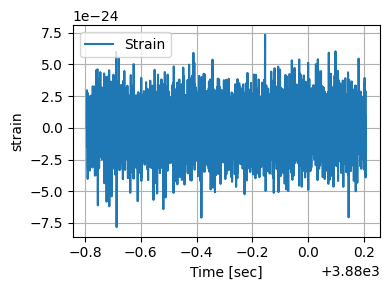

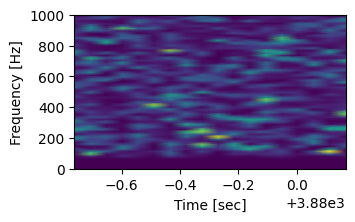

****************************************************************
Window sample No. 228
----------------------
Window initial time (in seconds):  3887.206787109375
Window end time (in seconds):  3888.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



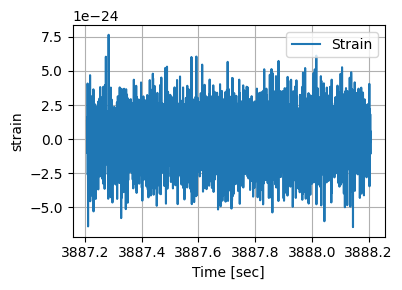

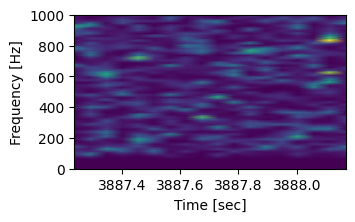

****************************************************************
Window sample No. 229
----------------------
Window initial time (in seconds):  3895.206787109375
Window end time (in seconds):  3896.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



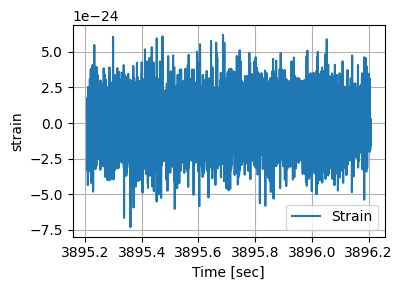

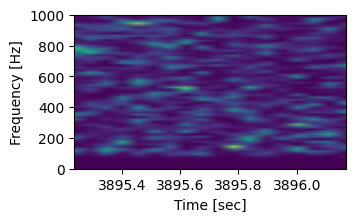

****************************************************************
Window sample No. 230
----------------------
Window initial time (in seconds):  3903.206787109375
Window end time (in seconds):  3904.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



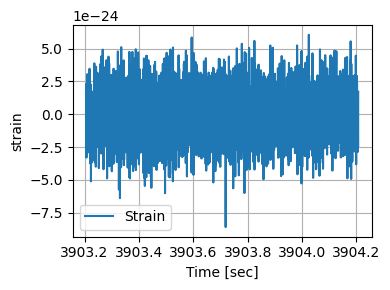

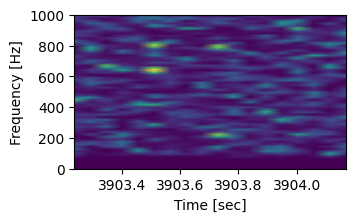

****************************************************************
Window sample No. 231
----------------------
Window initial time (in seconds):  3911.206787109375
Window end time (in seconds):  3912.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



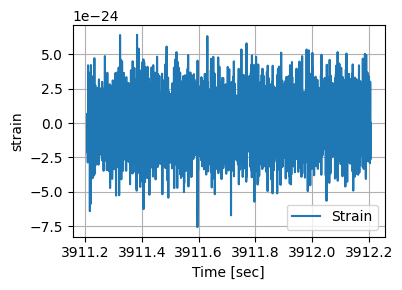

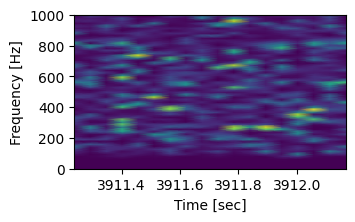

****************************************************************
Window sample No. 232
----------------------
Window initial time (in seconds):  3919.206787109375
Window end time (in seconds):  3920.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



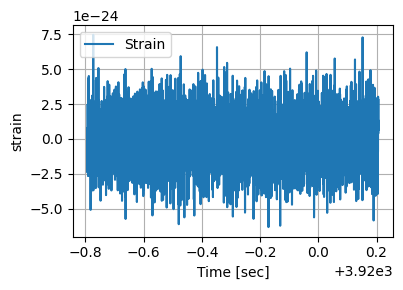

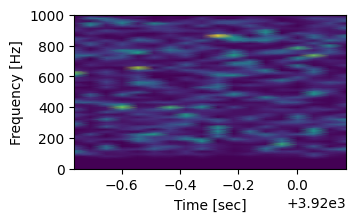

****************************************************************
Window sample No. 233
----------------------
Window initial time (in seconds):  3927.206787109375
Window end time (in seconds):  3928.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



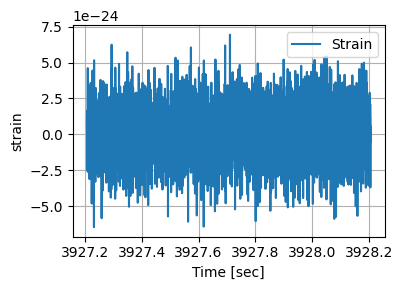

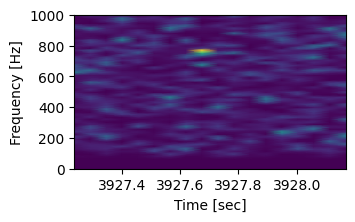

****************************************************************
Window sample No. 234
----------------------
Window initial time (in seconds):  3935.206787109375
Window end time (in seconds):  3936.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



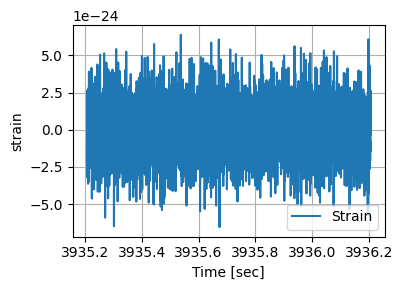

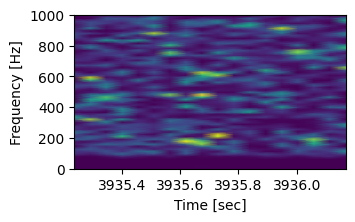

****************************************************************
Window sample No. 235
----------------------
Window initial time (in seconds):  3943.206787109375
Window end time (in seconds):  3944.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



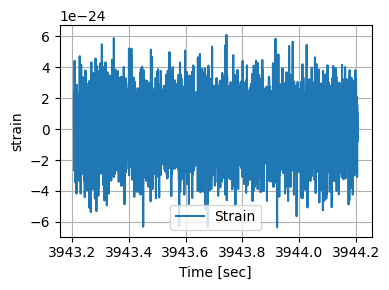

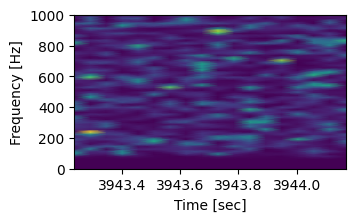

****************************************************************
Window sample No. 236
----------------------
Window initial time (in seconds):  3951.206787109375
Window end time (in seconds):  3952.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



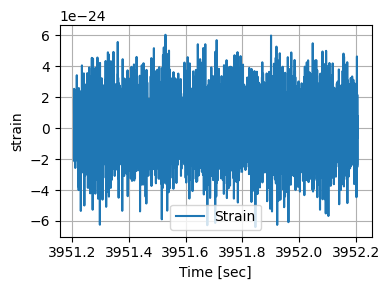

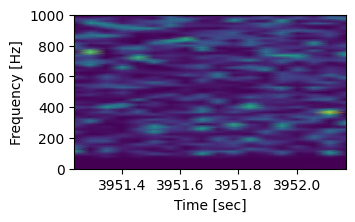

****************************************************************
Window sample No. 237
----------------------
Window initial time (in seconds):  3959.206787109375
Window end time (in seconds):  3960.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



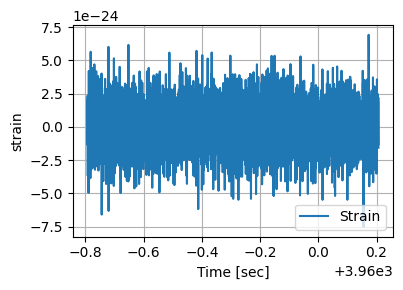

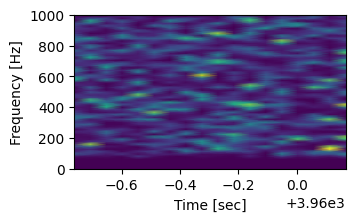

****************************************************************
Window sample No. 238
----------------------
Window initial time (in seconds):  3967.206787109375
Window end time (in seconds):  3968.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



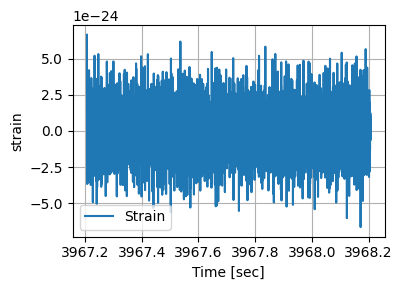

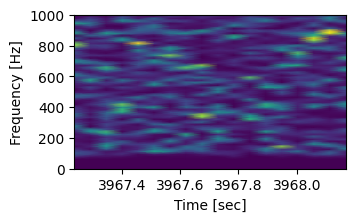

****************************************************************
Window sample No. 239
----------------------
Window initial time (in seconds):  3975.206787109375
Window end time (in seconds):  3976.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



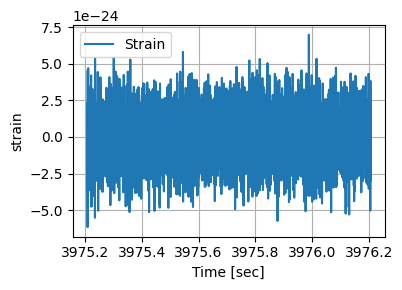

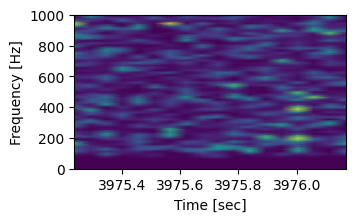

****************************************************************
Window sample No. 240
----------------------
Window initial time (in seconds):  3983.206787109375
Window end time (in seconds):  3984.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



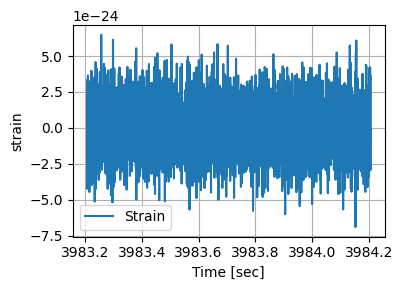

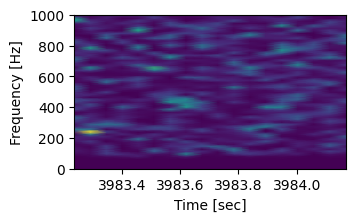

****************************************************************
Window sample No. 241
----------------------
Window initial time (in seconds):  3991.206787109375
Window end time (in seconds):  3992.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



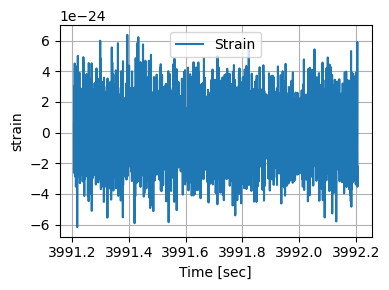

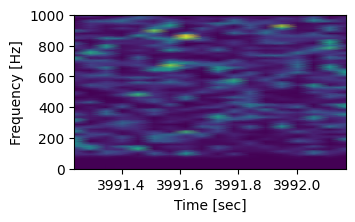

****************************************************************
Window sample No. 242
----------------------
Window initial time (in seconds):  3999.206787109375
Window end time (in seconds):  4000.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



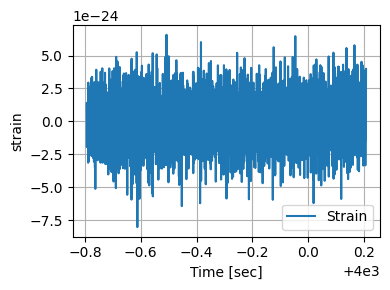

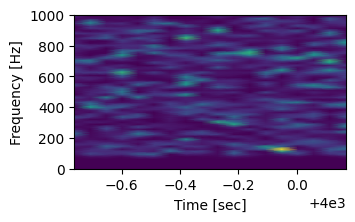

****************************************************************
Window sample No. 243
----------------------
Window initial time (in seconds):  4007.206787109375
Window end time (in seconds):  4008.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



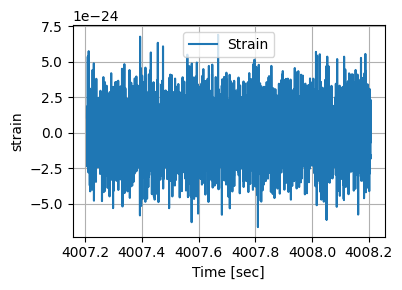

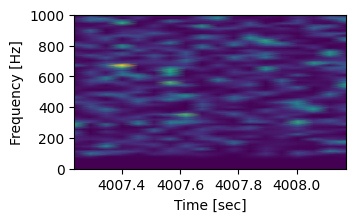

****************************************************************
Window sample No. 244
----------------------
Window initial time (in seconds):  4015.206787109375
Window end time (in seconds):  4016.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



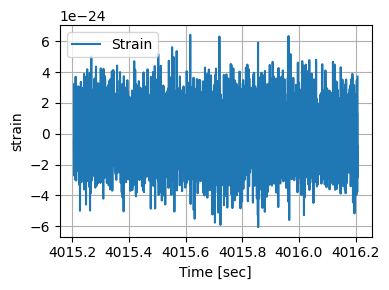

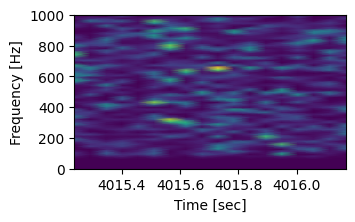

****************************************************************
Window sample No. 245
----------------------
Window initial time (in seconds):  4023.206787109375
Window end time (in seconds):  4024.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



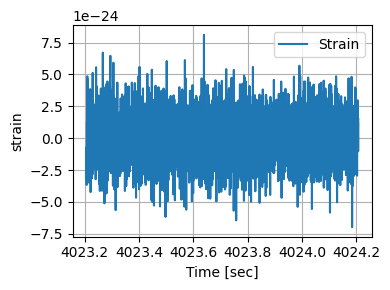

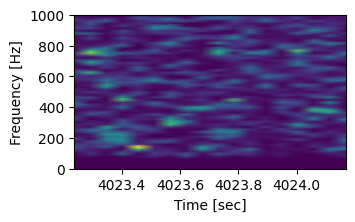

****************************************************************
Window sample No. 246
----------------------
Window initial time (in seconds):  4031.206787109375
Window end time (in seconds):  4032.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



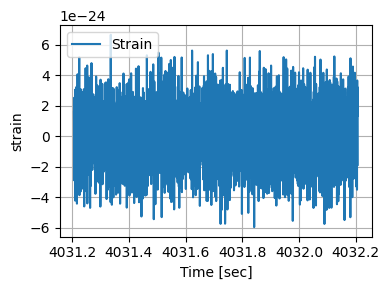

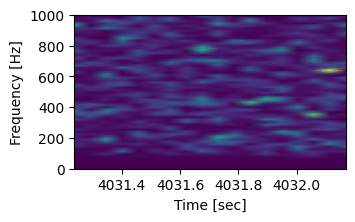

****************************************************************
Window sample No. 247
----------------------
Window initial time (in seconds):  4039.206787109375
Window end time (in seconds):  4040.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



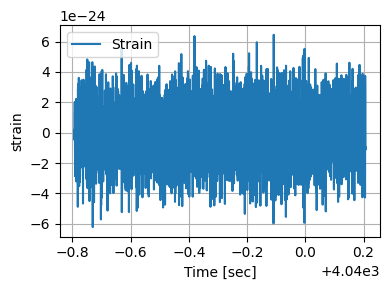

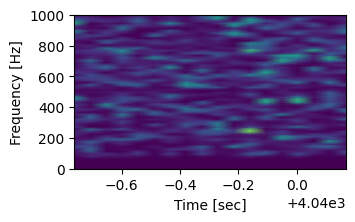

****************************************************************
Window sample No. 248
----------------------
Window initial time (in seconds):  4047.206787109375
Window end time (in seconds):  4048.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



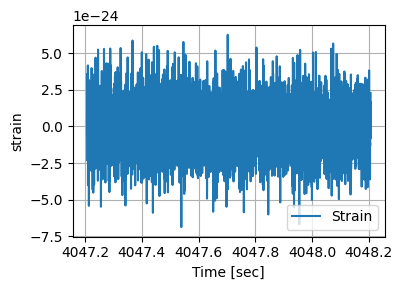

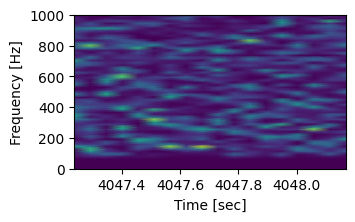

****************************************************************
Window sample No. 249
----------------------
Window initial time (in seconds):  4055.206787109375
Window end time (in seconds):  4056.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



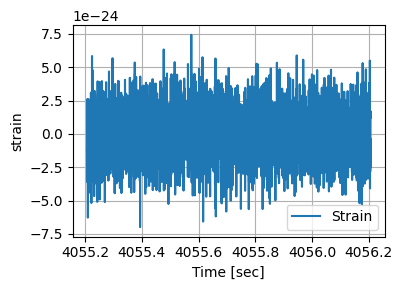

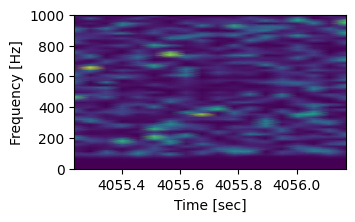

****************************************************************
Window sample No. 250
----------------------
Window initial time (in seconds):  4063.206787109375
Window end time (in seconds):  4064.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



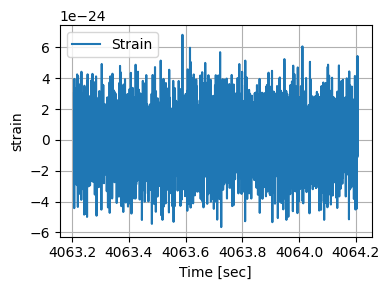

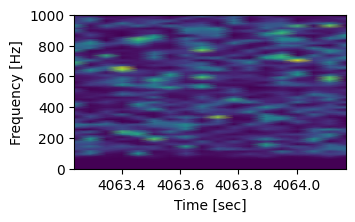

****************************************************************
Window sample No. 251
----------------------
Window initial time (in seconds):  4071.206787109375
Window end time (in seconds):  4072.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



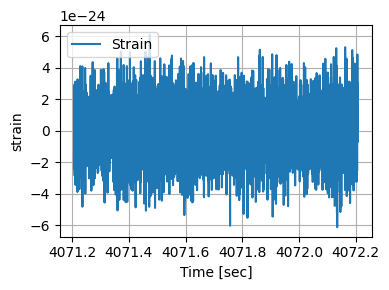

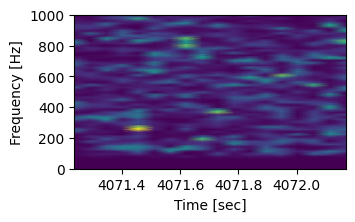

****************************************************************
Window sample No. 252
----------------------
Window initial time (in seconds):  4079.206787109375
Window end time (in seconds):  4080.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



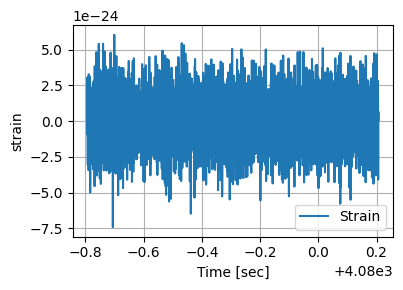

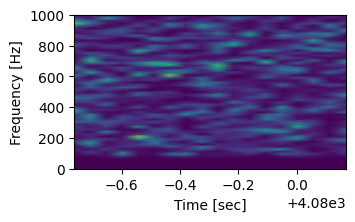

****************************************************************
Window sample No. 253
----------------------
Window initial time (in seconds):  4087.206787109375
Window end time (in seconds):  4088.20654296875
Window length (in seconds): 0.999755859375
Extracted  4095  data points



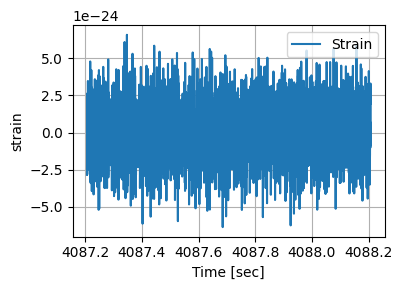

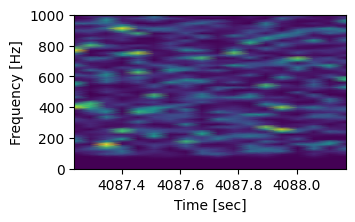

****************************************************************


In [ ]:
# ------> Generate window samples of Noise only

# Window for spectrograms
wnd="hamming"

# Initialize list of windows
all_windows = []

# FIRST LOOP, j index: window count variable
# --------------------------------------------

for j in range(len(Twin_ini_R)): # Extract all windows along the strain segment
#for j in range(10): # Extract only a few windows along the strain segment

    print("Window sample No.", j)
    print("----------------------")

    window = np.zeros(int(fs*Twin))

    # SECOND LOOP, k index: Window samples count variable
    # --------------------------------------------------------

    for k in range(len(window)):

        # Extract strain data along the window
        window[k] = s[locate_win_R[j]+k]

    all_windows.append(window)

    print("Window initial time (in seconds): ", time_strain_cut[locate_win_R[j]])
    print("Window end time (in seconds): ", time_strain_cut[locate_win_R[j]+k])
    print("Window length (in seconds):", time_strain_cut[locate_win_R[j]+k]-time_strain_cut[locate_win_R[j]])
    print("Extracted ", k, " data points")
    print("")

    # Plot the window sample (strain)

    plt.figure(1, figsize=(4,3))
    #plt.plot(np.arange(0, Twin, ts), all_windows[num_win], label='Strain')
    plt.plot(time_strain_cut[locate_win_R[j]:locate_win_R[j]+len(window)], all_windows[j], label='Strain')
    #plt.title("Sample", fontsize=15)
    plt.xlabel('Time [sec]', fontsize=10)
    plt.ylabel('strain', fontsize=10)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Plot the window sample (spectrogram)

    freq, time, Sxx = signal.spectrogram(all_windows[j], fs, window=wnd, nperseg=64*4)

    plt.figure(2, figsize=(3.5,2))
    plt.pcolormesh(time+time_strain_cut[locate_win_R[j]], freq, Sxx, shading='gouraud')
    plt.ylim([0,1000])
    plt.ylabel('Frequency [Hz]', fontsize=10)
    plt.xlabel('Time [sec]', fontsize=10)
    plt.show()

    # Save samples

    #dataset_dir = '/home/manuel/Research Projects/GW Data analysis/GitHub/DL_PE_PhenomCCSNe/Datasets/'
    #sample_number = str(j).zfill(6)

    #df_strain = pd.DataFrame({"time" : time_strain_cut[locate_win_R[j]:locate_win_R[j]+len(window)], "strain" : all_windows[j]})
    #df_strain.to_csv(dataset_dir + "sample_strain_" + sample_number + "_" + detector + "_" + rot_prog + ".txt", index=False)

    print("****************************************************************")
    #print("")